In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('../')

import os
import json
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from rxnscribe.data import ImageData, CorefImageData

/Mounts/rbg-storage1/users/urop/vincentf/miniconda3/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: libtorch_cuda_cu.so: cannot open shared object file: No such file or directory
  warn(f"Failed to load image Python extension: {e}")
/afs/csail.mit.edu/u/v/vincentf/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [17]:
pred_path_new = '../output/experiment_coref_filtered_hf_1e-4_200ep_both_augment/prediction_full_coref_val_filtered.json'#'../output/coref_augment/prediction_coref_redo_test.json'
image_base = '../data/detect/images/'
groundtruth_path = '../data/coref/splits/annotations/full_coref_val_filtered.json'
csr_path = '../output/csr_predictions.json'

    
with open(pred_path_new) as h:
    predictions_new = json.load(h)
    
with open (groundtruth_path) as g:
    groundtruth = json.load(g)
    
with open(csr_path) as h:
    csr_pred = json.load(h)

In [18]:
l = [i['id'] for i in groundtruth['images']]
print(len(l))
print(len(set(l)))

170
170


In [19]:
print(len(groundtruth['images']))

170


In [20]:
print(groundtruth['annotations'][0])

{'id': 9329, 'image_id': 1186, 'category_id': 1, 'segmentation': [], 'area': 57215.6592, 'bbox': [737.09, 5.48, 269.58, 212.24], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}


In [21]:
def prepare_for_coco_detection(predictions):
        img_ids = []
        coco_results = []
        for idx, prediction in enumerate(predictions):
            if len(prediction) == 0:
                continue

            image = coco_gt.dataset['images'][idx]
            img_ids.append(image['id'])
            width = image['width']
            height = image['height']

            coco_results.extend(
                [
                    {
                        "image_id": image['id'],
                        "category_id": pred['category_id'],
                        "bbox": convert_to_xywh(pred['bbox'], width, height),
                        "score": pred['score'],
                    }
                    for pred in prediction
                ]
            )
        return img_ids, coco_results
def convert_to_xywh(box, width, height):
    xmin, ymin, xmax, ymax = box
    return [xmin * width, ymin * height, (xmax - xmin) * width, (ymax - ymin) * height]

In [22]:
print(predictions_new['coref'][0])


[{'category': '[Mol]', 'bbox': [0.26013006503251623, 0.0046960099768193955, 0.3601800900450225, 0.18666639657857098], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2696348174087044, 0.1925364090495952, 0.35167583791895946, 0.2711945761613201], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5137568784392196, 0.25475854124245223, 0.6213106553276638, 0.4355549253499989], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5492746373186593, 0.4472949502920474, 0.5707853926963482, 0.4860370326008074], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5147573786893447, 0.010566022447843638, 0.6218109054527263, 0.1725783666481128], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5482741370685342, 0.19371041154380006, 0.5797898949474737, 0.23832250632358432], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6323161580790395, 0.008218017459433942, 0.7403701850925463, 0.1725783666481128]

In [23]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from rxnscribe.evaluate import CorefEvaluator
ap = 0
bad = set()
def evaluate_single_image(num, ap):
    file_name = predictions_new['file_name'][num]
    #print(file_name)
    
    print("the prediction is")
    print(predictions_new['coref'][predictions_new['file_name'].index(file_name)])
    
    single_gt = {}
    single_gt['categories'] = groundtruth['categories']
    single_gt['images'] = []
    single_gt['annotations'] = []
    
    single_pred = []
    '''
    single_pred['categories'] = groundtruth['categories']
    single_pred['images'] = []
    single_pred['annotations'] = predictions_new['bbox'][num]
    '''

    
    for image in groundtruth['images']:
        if image['file_name'] == file_name:
            #print("the ground truth is")
            #print(image)
            single_gt['images'].append(image)
            #single_pred['images'].append(image)
            gt_num = image['id']
            
            width = image['width']
            height = image['height']
            single_pred.extend(
                [
                    {
                        "image_id": image['id'],
                        "category_id": pred['category_id'],
                        "bbox": convert_to_xywh(pred['bbox'], width, height),
                        "score": pred['score'],
                    }

                    for pred in predictions_new['coref'][num]
                ]
            )
            print("-------")
            #print(single_pred)
    #print("gt_num")
    #print(gt_num)
    for annotation in groundtruth['annotations']:
        if annotation['image_id'] == gt_num:
            single_gt['annotations'].append(annotation)
    print("the ground truth annotations are")
    print(single_gt['annotations'])
    with open("gt_holder.json", "w") as f:
        json.dump(single_gt, f)

    gt_coco = COCO("gt_holder.json")
    pred_coco = gt_coco.loadRes(single_pred)
    
    cocoEval = COCOeval(gt_coco, pred_coco, 'bbox')
    
    cocoEval.params.catIds = [1]
    
    cocoEval.evaluate()
    cocoEval.accumulate()
    cocoEval.summarize()
    
    '''
    evaluator = CorefEvaluator()
    print(evaluator.evaluate_image(groundtruth['images'][num], predictions_new['coref'][num]))
    '''
    ap+=cocoEval.stats[0]
    

    if ap < 0.5:
        bad.add(image['file_name'])
    image_file = image_base + file_name
    img = cv2.imread(image_file)
    #d = ImageData(predictions=predictions['bbox'][i], image_file=image_file)
    #ig, ax = plt.subplots(figsize=(10, 10))
    #d.draw_prediction(ax, img)
    #plt.show()
    ddd = ImageData(predictions=predictions_new['coref'][predictions_new['file_name'].index(file_name)], image_file=image_file)
    ig, ax = plt.subplots(figsize=(10, 10))
    ddd.draw_prediction(ax, img)
    plt.show()
    save = None
    for image in groundtruth['images']:
        if image['file_name'] == file_name:
            save = image
            break
            
    dd = ImageData(save)

    ig, ax = plt.subplots(figsize=(10, 10))
    dd.draw_gold(ax, img)
    plt.show()
    print(num)
    return ap
            

the prediction is
[{'category': '[Mol]', 'bbox': [0.26013006503251623, 0.0046960099768193955, 0.3601800900450225, 0.18666639657857098], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2696348174087044, 0.1925364090495952, 0.35167583791895946, 0.2711945761613201], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5137568784392196, 0.25475854124245223, 0.6213106553276638, 0.4355549253499989], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5492746373186593, 0.4472949502920474, 0.5707853926963482, 0.4860370326008074], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5147573786893447, 0.010566022447843638, 0.6218109054527263, 0.1725783666481128], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5482741370685342, 0.19371041154380006, 0.5797898949474737, 0.23832250632358432], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6323161580790395, 0.008218017459433942, 0.7403701850925463, 0

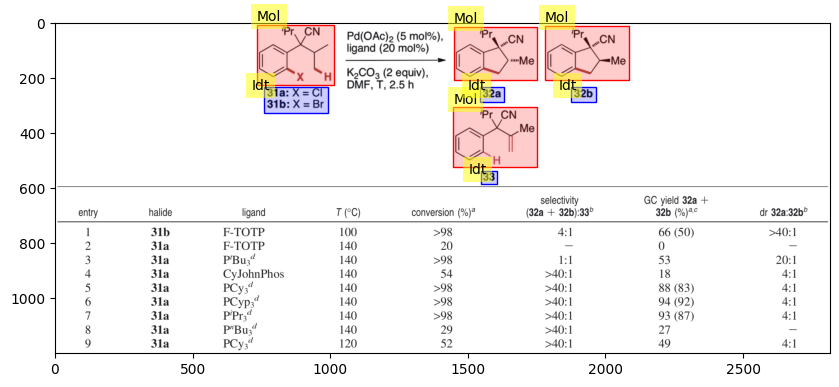

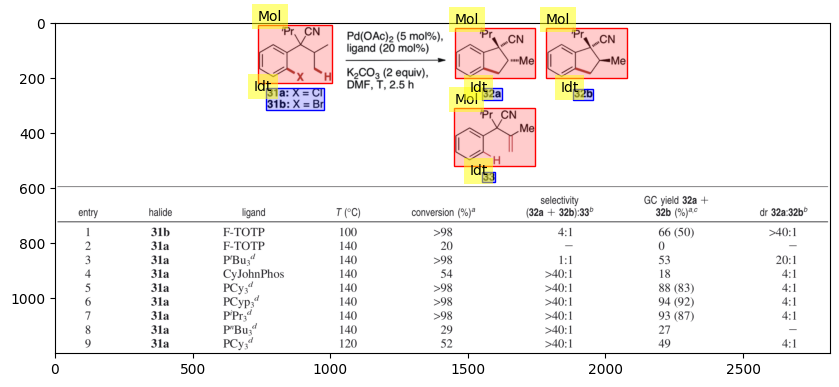

0
the prediction is
[{'category': '[Mol]', 'bbox': [0.10729218678562856, 0.13806903451725863, 0.37053231948060095, 0.28864432216108055], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3455806481351059, 0.26113056528264134, 0.3736512783987878, 0.2876438219109555], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.14222452666932156, 0.3886943471735868, 0.35805648380785343, 0.5042521260630315], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.32561931105870995, 0.4897448724362181, 0.352442357755117, 0.5152576288144072], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4160691196861293, 0.4102051025512756, 0.533341975009956, 0.4947473736868434], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5882356519700449, 0.14157078539269635, 0.9063694616251062, 0.2891445722861431], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.875803664226875, 0.26113056528264134, 0.9057456698414689, 0.287

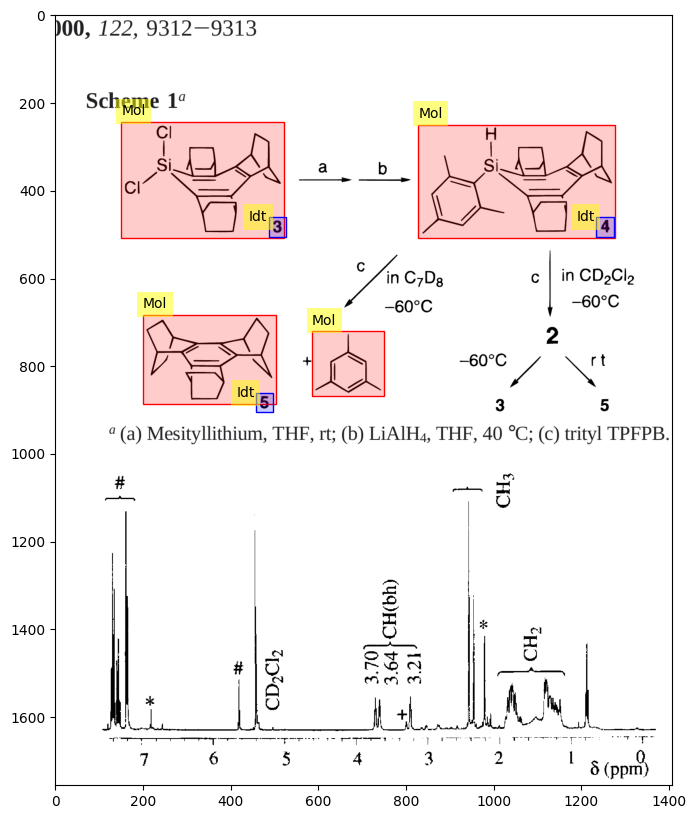

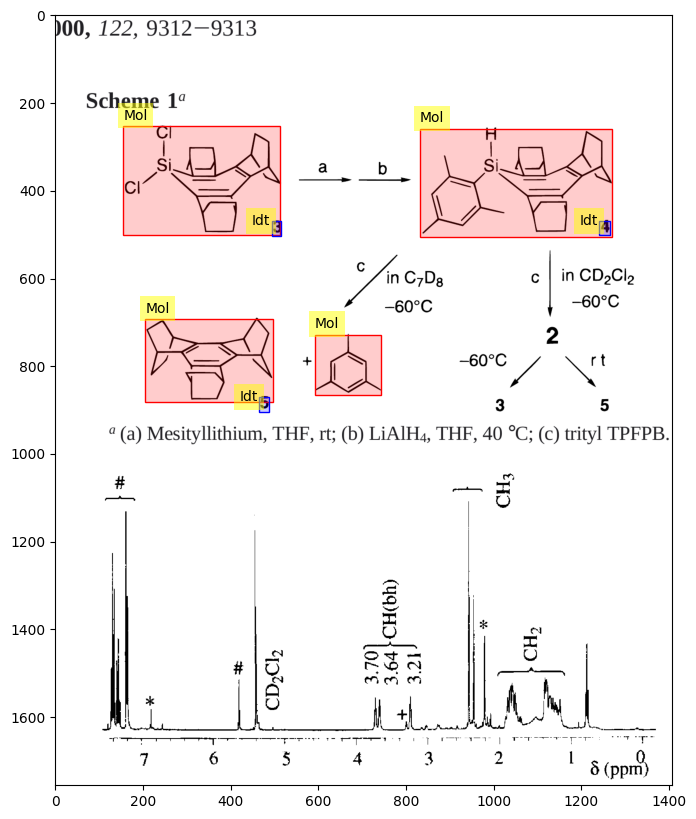

1
the prediction is
[{'category': '[Mol]', 'bbox': [0.16858429214607304, 0.03902587426028536, 0.3891945972986493, 0.1804239694062468], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2541270635317659, 0.19739174082376218, 0.28114057028514255, 0.2369832074646314], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.655327663831916, 0.0016967771417515374, 0.8364182091045522, 0.17985837702566296], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7133566783391696, 0.19852292558492987, 0.7573786893446723, 0.23754879984521524], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9344, 'image_id': 1188, 'category_id': 1, 'segmentation': [], 'area': 59092.0, 'bbox': [221.0, 31.0, 316.0, 187.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9345, 'image_id': 1188, 'category_id': 1, 'segmentation': [], 'area': 55660.0, 'bbox': [885.0, 0.0, 253.0, 220.0], 'iscrowd': 0, 'attributes': {'oc

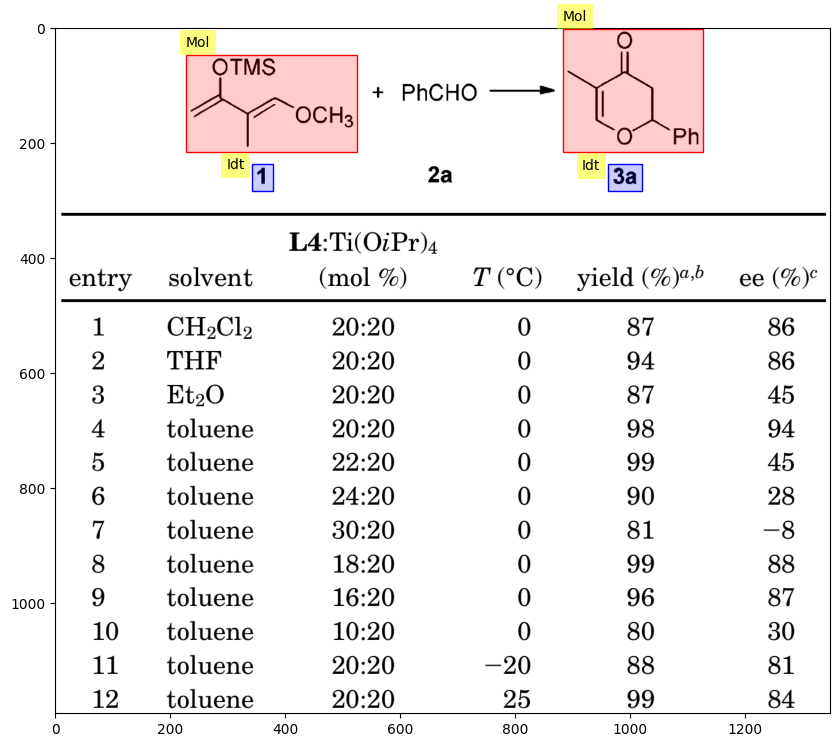

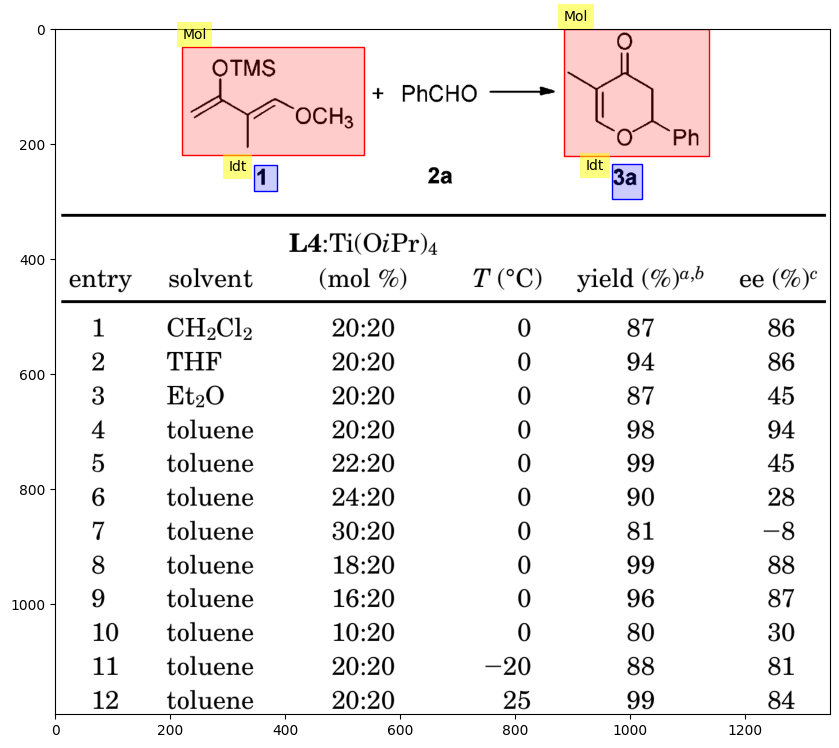

2
the prediction is
[{'category': '[Mol]', 'bbox': [0.02301150575287644, 0.07428455160222598, 0.23761880940470234, 0.2470393227701934], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11005502751375688, 0.39560842597464535, 0.17508754377188596, 0.5269020520623006], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3341670835417709, 0.08637738558398368, 0.4427213606803402, 0.2591321567519511], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.34817408704352176, 0.39388087826296564, 0.4117058529264632, 0.5165367657922224], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7688844422211105, 0.0, 0.9739869934967483, 0.3455095423359347], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8479239619809905, 0.4422522141899965, 0.9084542271135568, 0.5649081017192533], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9348, 'image_id': 1189, 'category_id': 3, 'segmentation': []

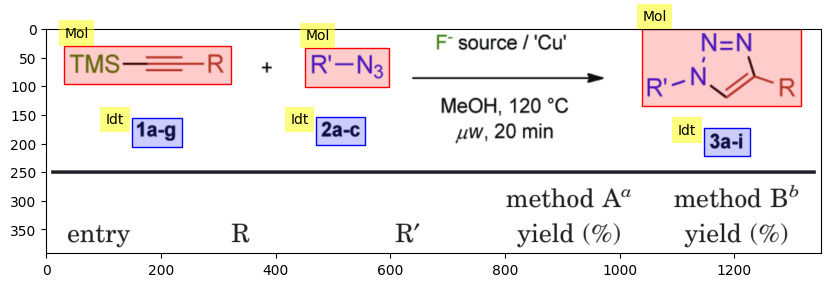

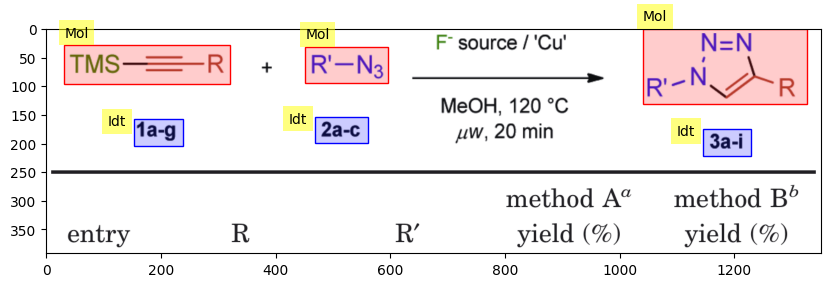

3
the prediction is
[{'category': '[Mol]', 'bbox': [0.02751375687843922, 0.021666067690885152, 0.19559779889944973, 0.469431466635845], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0815407703851926, 0.5007268977449013, 0.11905952976488245, 0.6499820307265546], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23711855927963982, 0.03611011281814192, 0.30815407703851927, 0.46220944407221665], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.25212606303151575, 0.4790608300540162, 0.2891445722861431, 0.6235012813265839], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5012506253126563, 0.01444404512725677, 0.752376188094047, 0.46220944407221665], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5592796398199099, 0.49350487518127295, 0.5977988994497249, 0.6403526673083835], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7668834417208604, 0.016851385981799565, 0.9739869934967483,

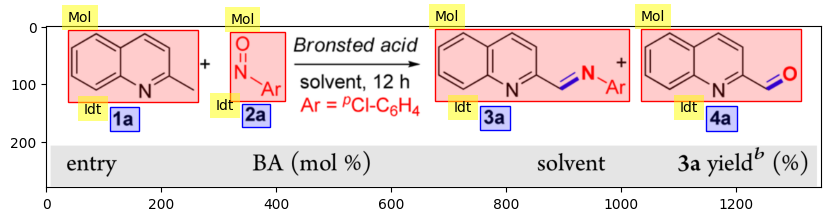

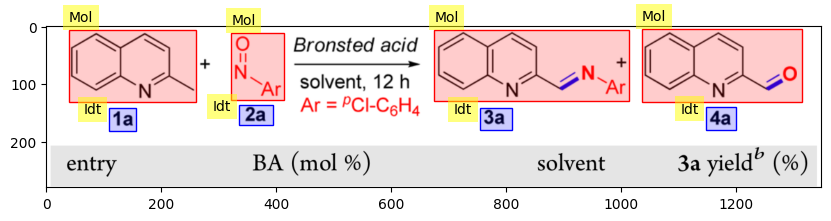

4
the prediction is
[{'category': '[Mol]', 'bbox': [0.018509254627313655, 0.5700907448542923, 0.19809904952476237, 0.963971623117258], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11455727863931967, 0.8274953538945637, 0.14107053526763383, 0.943241050577102], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.47723861930965483, 0.5303571474856599, 0.7783891945972986, 1.000250125062531], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7073536768384192, 0.8257678061828841, 0.7368684342171086, 0.948423693712141], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9362, 'image_id': 1191, 'category_id': 3, 'segmentation': [], 'area': 2579.64, 'bbox': [951.06, 323.14, 51.8, 49.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9363, 'image_id': 1191, 'category_id': 1, 'segmentation': [], 'area': 75382.02, 'bbox': [642.3, 207.3, 412.6, 182.7], 'iscrowd': 0, 'attributes': {'occlu

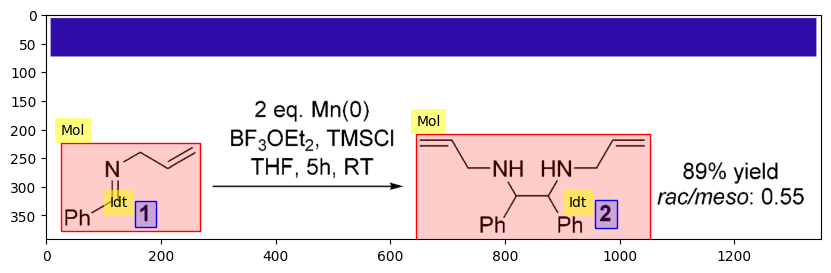

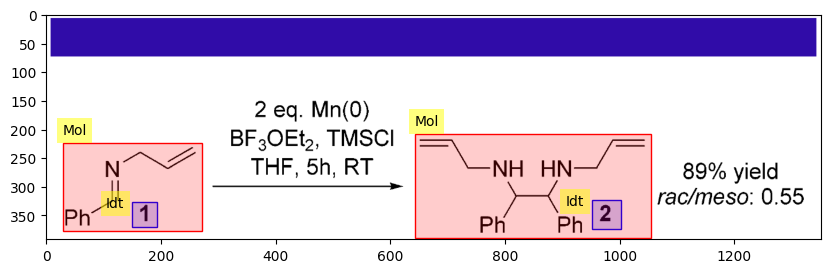

5
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0115706254953961, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0115706254953961, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0066987831815451095, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'categor

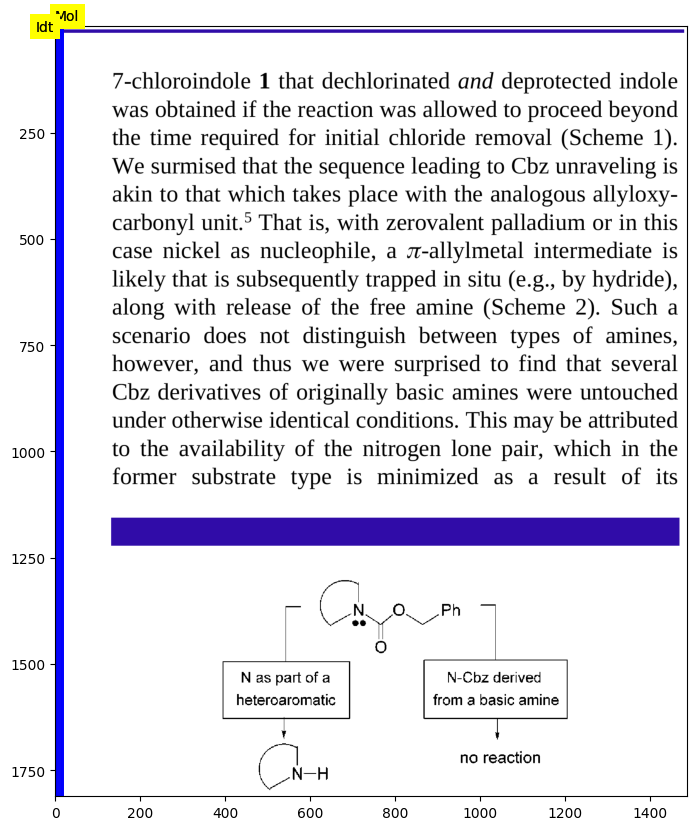

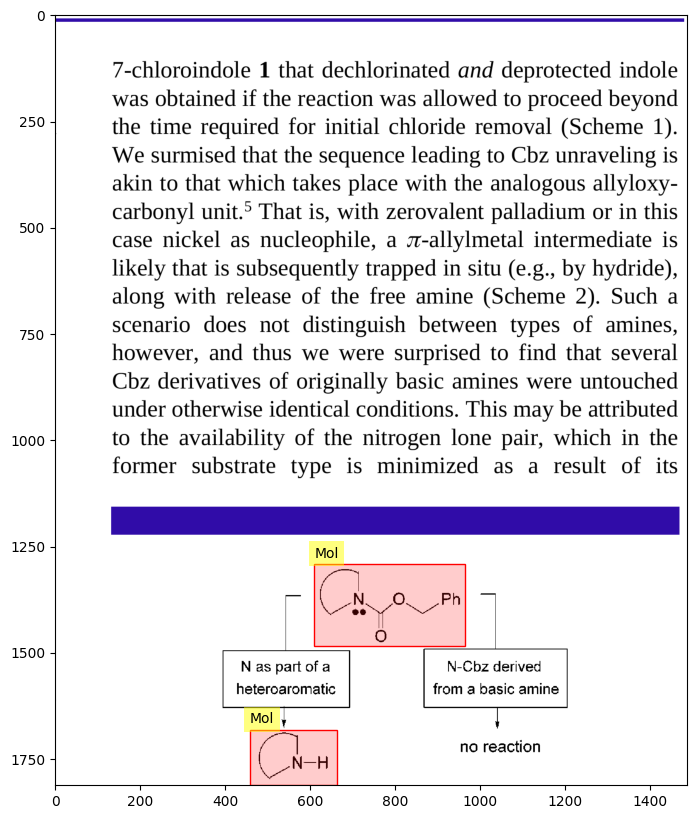

6
the prediction is
[{'category': '[Mol]', 'bbox': [0.12056028014007003, 0.21287374456459, 0.28564282141070535, 0.5475728248739754], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1485742871435718, 0.5629612883364759, 0.25662831415707854, 0.6052795628583523], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23261630815407705, 0.7925058683187747, 0.3141570785392696, 0.886119021048986], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.22611305652826413, 0.9566494785854466, 0.3216608304152076, 0.9976853811521144], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4222111055527764, 0.2398035556239658, 0.5637818909454727, 0.5232077577250164], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4837418709354677, 0.5270548735906415, 0.5017508754377189, 0.5591141724708507], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.44172086043021513, 0.7245401546927309, 0.5447723861930965, 0.9374138

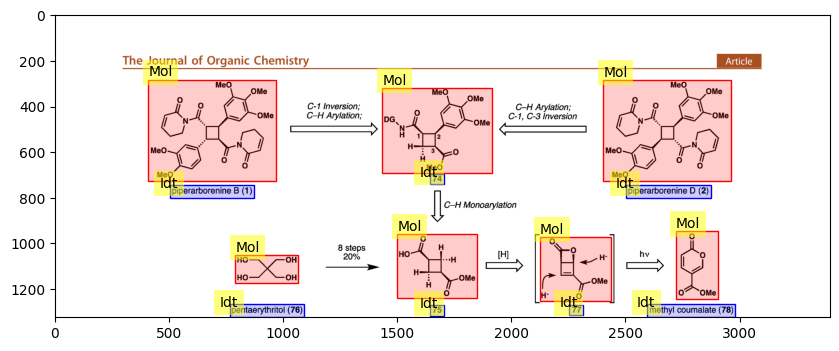

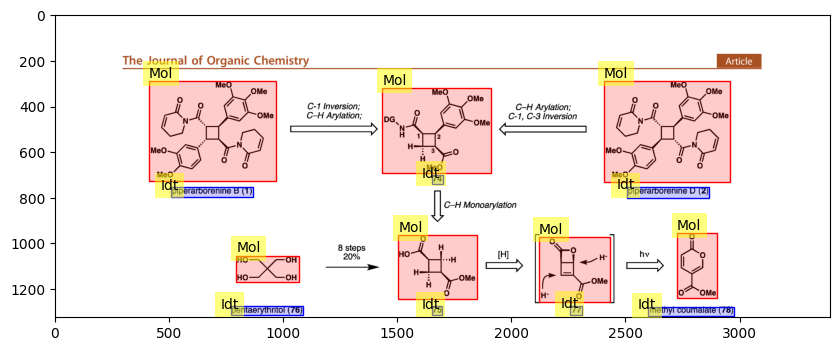

7
the prediction is
[{'category': '[Mol]', 'bbox': [0.17408704352176088, 0.0, 0.3141570785392696, 0.17770722359886282], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2656328164082041, 0.18547113142599758, 0.2801400700350175, 0.21480144988406233], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.17558779389694848, 0.2639728661225826, 0.27163581790895447, 0.43046555619336185], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2226113056528264, 0.7427471821292275, 0.3416708354177089, 0.9368448778075971], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.27463731865932967, 0.26224755327210825, 0.37018509254627313, 0.43046555619336185], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.39119559779889945, 0.7453351514049391, 0.49824912456228115, 0.9394328470833087], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4177088544272136, 0.43305352546907344, 0.536768384192096, 0.646129662502

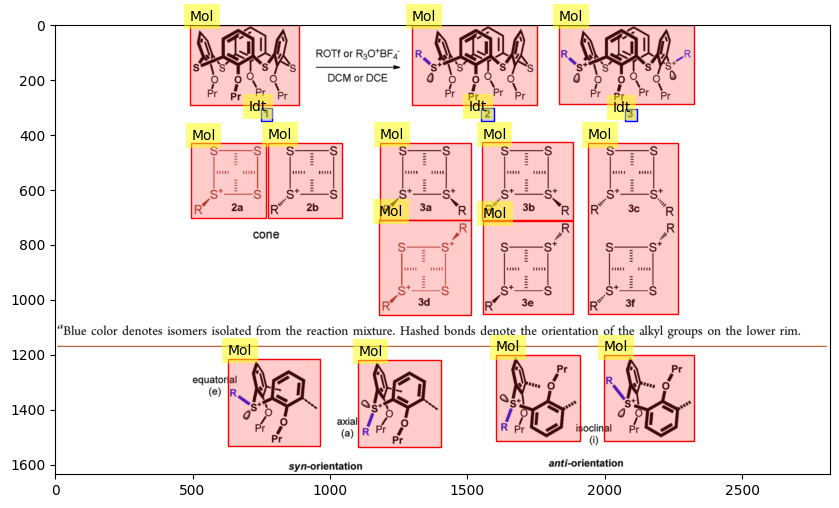

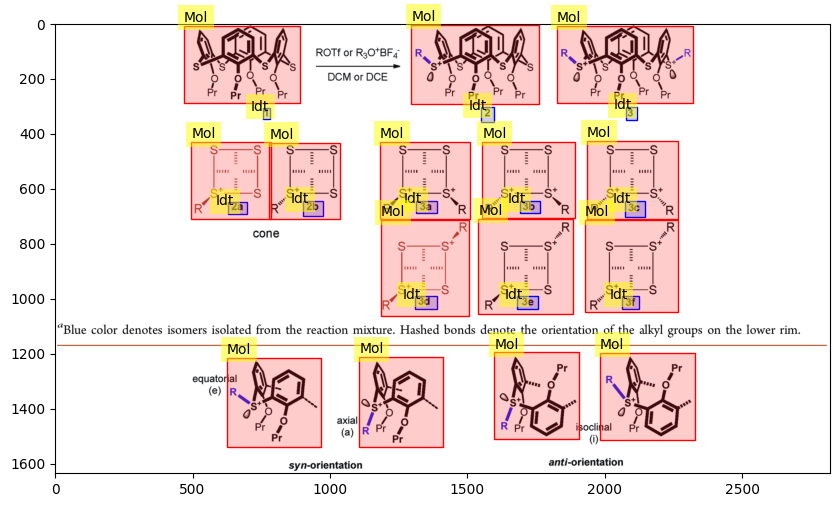

8
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.9734867433716858, 0.014935662824824798, 1.0], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.5412706353176588, 0.01229995762044395, 0.6908454227113556], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.3156578289144572, 0.009664252416063104, 0.5107553776888444], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.743871935967984, 0.009664252416063104, 0.7883941970985493], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.8089044522261131, 0.009664252416063104, 0.9129564782391195], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.8909454727363681, 0.009664252416063104, 0.9314657328664332], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.005271410408761693, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.003514273605841128, 0.001000500250

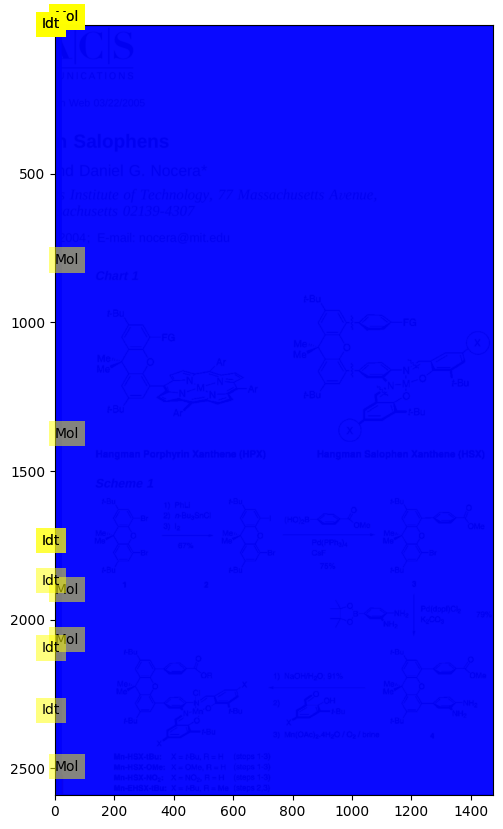

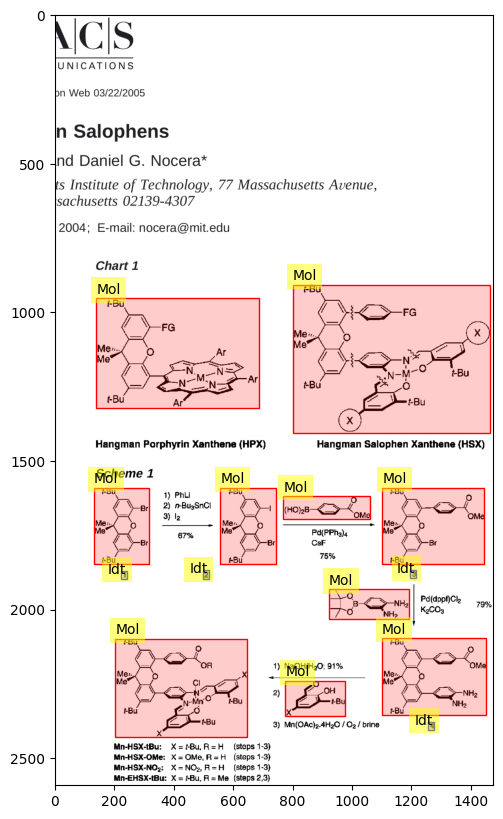

9
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.24312156078039018, 0.005989521706961265], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11305652826413207, 0.06588473877657393, 0.15457728864432216, 0.1377589992601091], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5297648824412207, 0.0069877753247881425, 0.8884442221110556, 0.26453720872412256], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9422, 'image_id': 1196, 'category_id': 1, 'segmentation': [], 'area': 82593.0, 'bbox': [719.0, 9.0, 483.0, 171.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.5

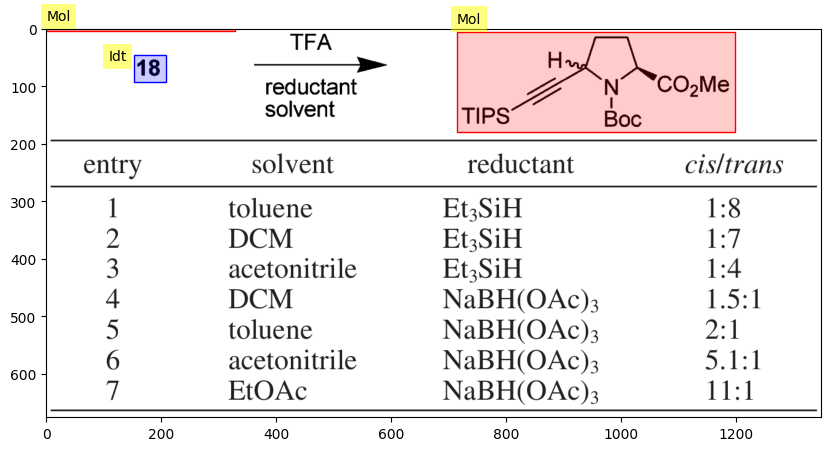

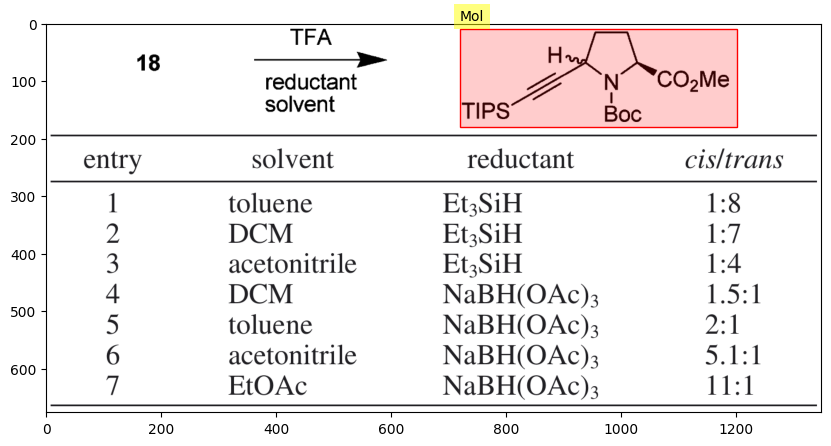

10
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.020920264053595424, 0.24712356178089045, 0.16370106621938418], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09854927463731866, 0.21286368674533343, 0.13356678339169584, 0.2547042148525243], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7498749374687343, 0.0, 1.0, 0.18619035007699927], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8369184592296148, 0.24476708942706646, 0.8764382191095548, 0.2892226505409568], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9423, 'image_id': 1197, 'category_id': 1, 'segmentation': [], 'area': 70540.87, 'bbox': [969.0, 0.0, 307.1, 229.7], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9424, 'image_id': 1197, 'category_id': 3, 'segmentation': [], 'area': 4208.94, 'bbox': [119.5, 251.2, 60.3, 69.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 94

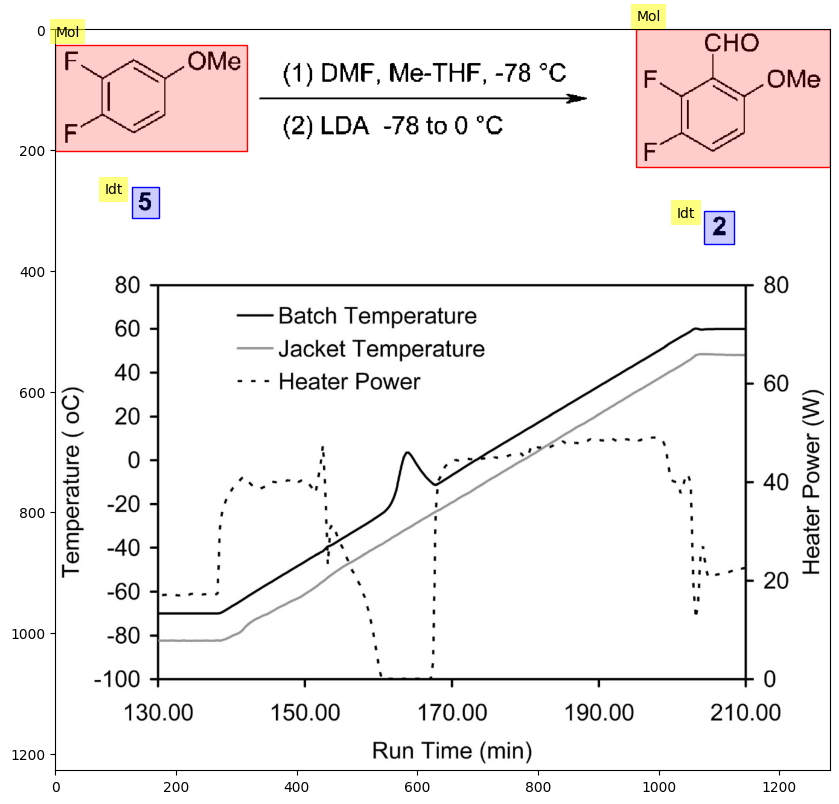

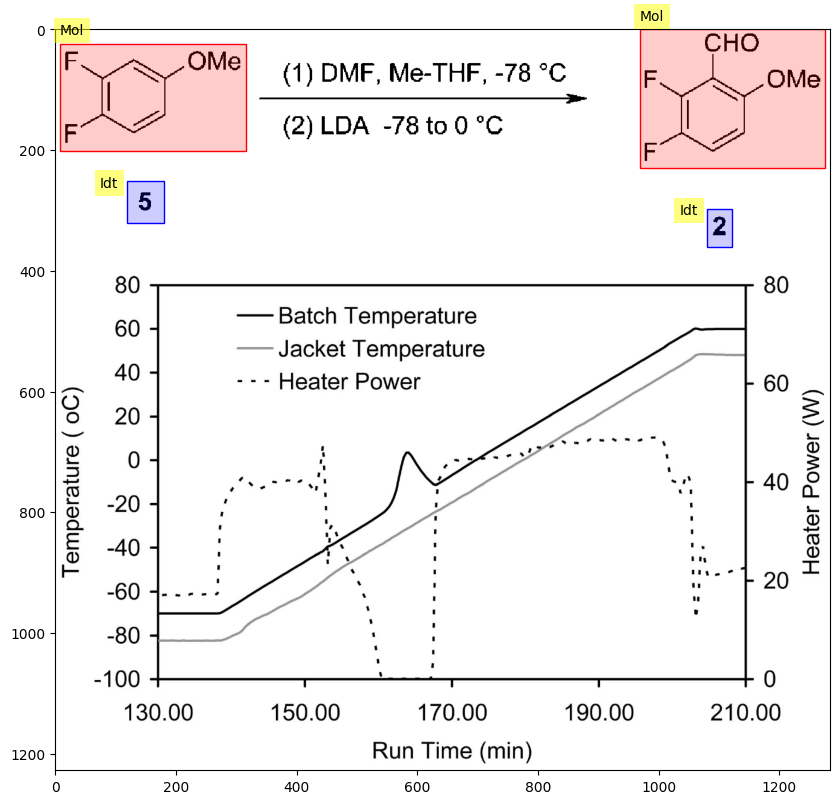

11
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.1317813438665841, 0.2061030515257629, 0.3031961746103364], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.13356678339169584, 0.7005218805539472, 0.29814907453726863, 0.860046665234549], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.35167583791895946, 0.1288088323507965, 0.5567783891945973, 0.30022366309454873], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4337168584292146, 0.5647771879996462, 0.6543271635817909, 0.9502128478801065], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5352676338169085, 0.9462494991923898, 0.5587793896948474, 0.9987638693046375], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5947973986993497, 0.05945023031575224, 0.6828414207103551, 0.19816743438584078], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7603801900950475, 0.6113465350803188, 0.9654827413706853, 0.9145427096906552], 

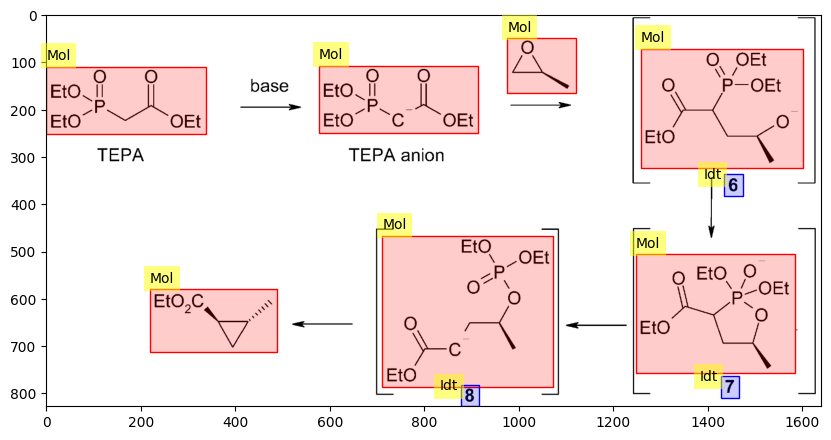

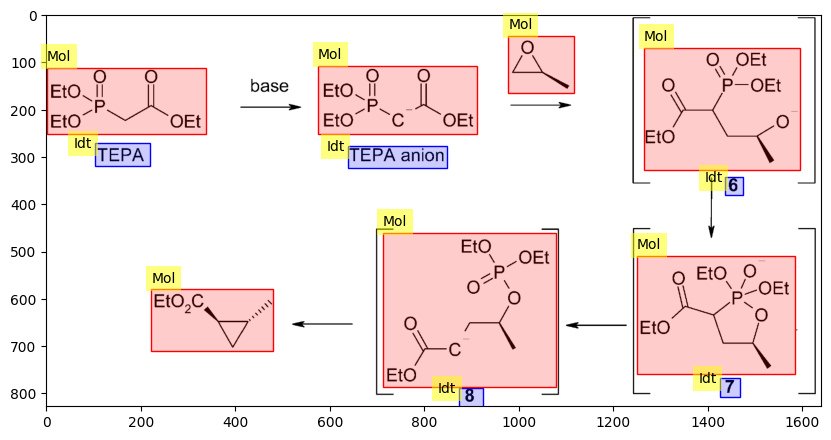

12
the prediction is
[{'category': '[Mol]', 'bbox': [0.23161580790395198, 0.7850867475260122, 0.3231615807903952, 0.8785357211477711], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2691345672836418, 0.8987253142142005, 0.3026513256628314, 0.922375980377732], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23561780890445222, 0.5491569314068799, 0.3261630815407704, 0.6437595960610063], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2696348174087044, 0.657603888449415, 0.3026513256628314, 0.682408245645314], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5307653826913457, 0.5497337769230636, 0.6228114057028514, 0.6437595960610063], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5737868934467234, 0.6570270429332313, 0.6053026513256629, 0.6812545546129466], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5642821410705353, 0.7822025199450936, 0.655327663831916, 0.87680518459

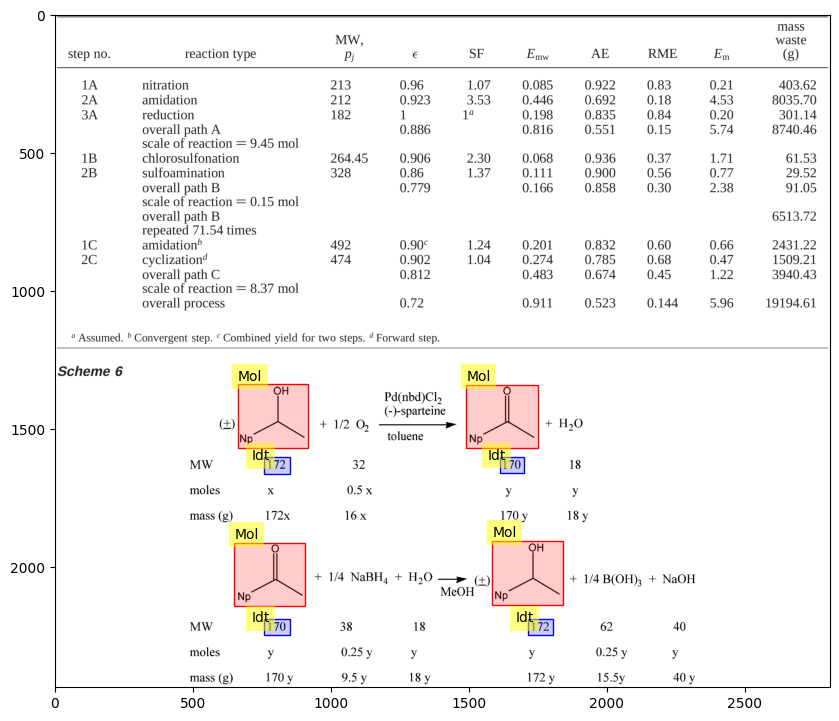

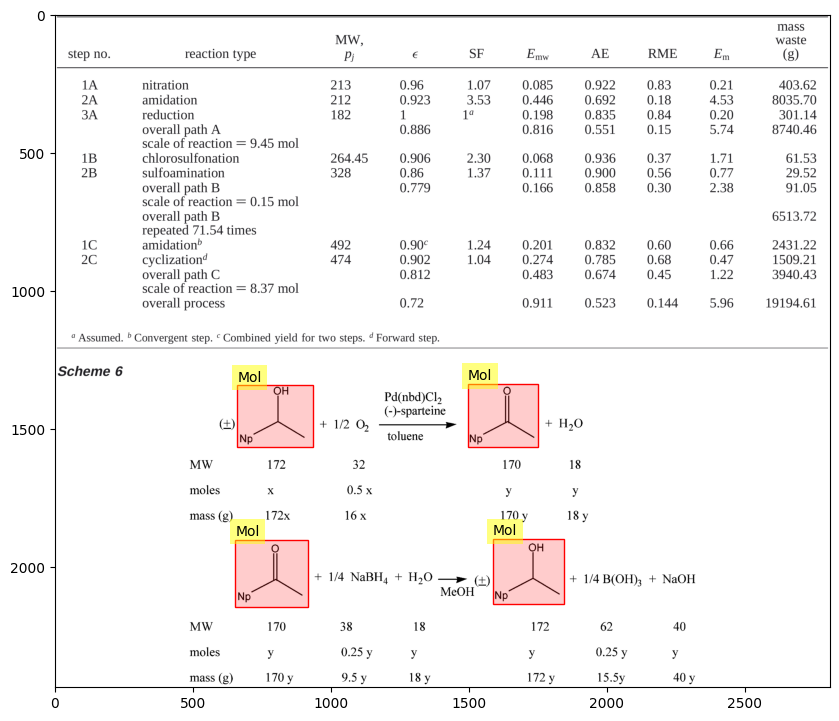

13
the prediction is
[{'category': '[Idt]', 'bbox': [0.0, 0.0, 0.2001000500250125, 0.08752752560312632], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.20060030015007504, 0.08752752560312632], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.04202101050525263, 0.5964504579759433, 0.32266133066533265, 0.9970919153758204], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.16508254127063532, 0.9005409335249491, 0.19459729864932465, 0.9655098185087131], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10055027513756878, 0.22648875181839903, 0.33166583291645824, 0.33206318991701533], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1730865432716358, 0.38169219927961273, 0.2061030515257629, 0.4466610842633766], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.46173086543271635, 0.11098851184726327, 0.6643321660830416, 0.45297750363679806], 'category_id': 1, 'score': 2011}, {

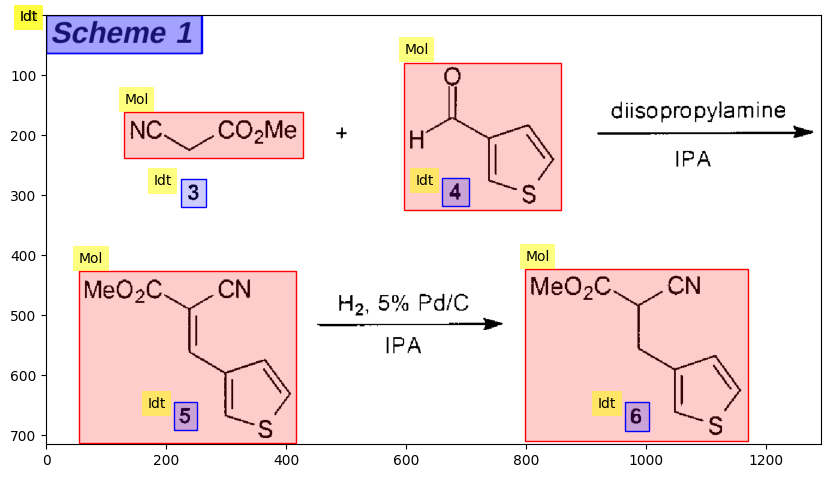

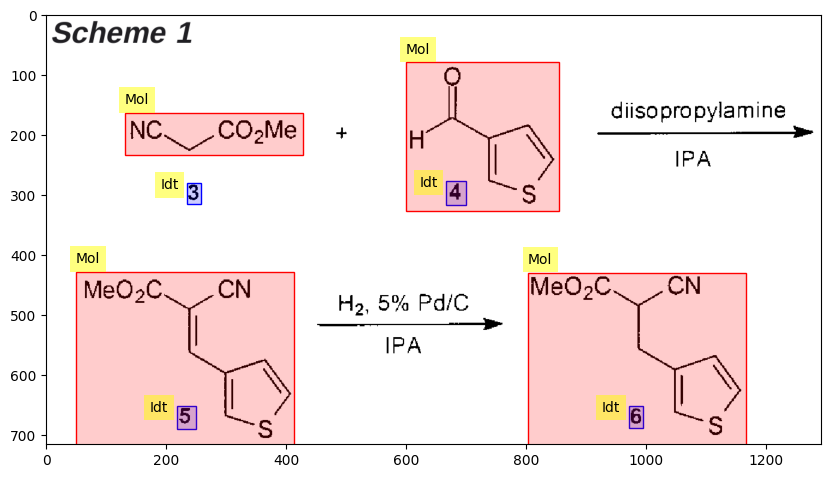

14
the prediction is
[{'category': '[Mol]', 'bbox': [0.11105552776388194, 0.022027530281657343, 0.3711855927963982, 0.16921148261818597], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.583791895947974, 0.019023776152340435, 0.8899449724862432, 0.1722152367475029], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9451, 'image_id': 1201, 'category_id': 1, 'segmentation': [], 'area': 37557.0, 'bbox': [152.0, 11.1, 351.0, 107.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9452, 'image_id': 1201, 'category_id': 1, 'segmentation': [], 'area': 46261.96, 'bbox': [781.1, 9.9, 419.8, 110.2], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating ev

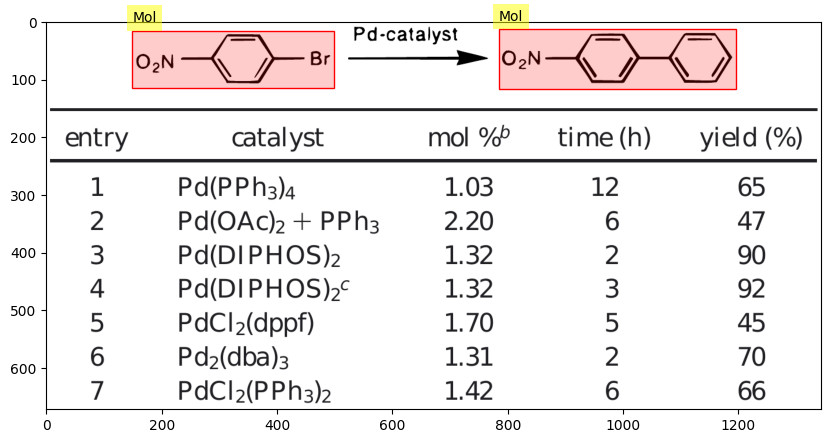

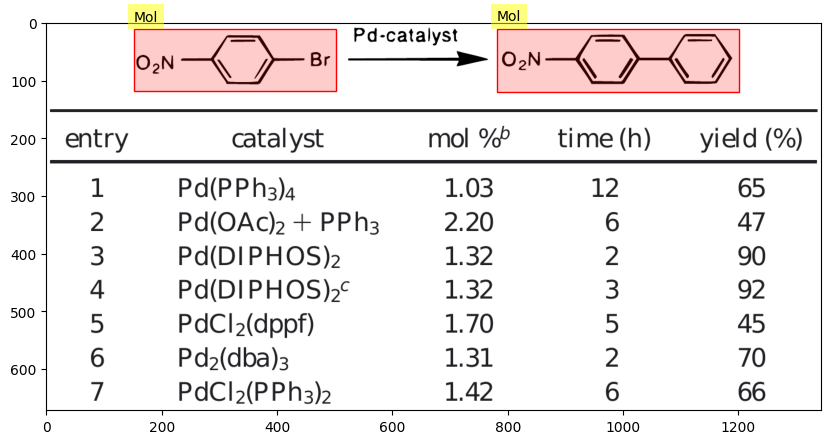

15
the prediction is
[{'category': '[Mol]', 'bbox': [0.2656328164082041, 0.007093972518173981, 0.32066033016508255, 0.08670410855545978], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.28714357178589295, 0.08591588938677376, 0.3006503251625813, 0.1119271219534117], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.45222611305652827, 0.010246849192917972, 0.5292646323161581, 0.08670410855545978], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4732366183091546, 0.08749232772414577, 0.48724362181090547, 0.1127153411220977], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5592796398199099, 0.007093972518173981, 0.6408204102051025, 0.08039835520597179], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5817908954477239, 0.08276301271202978, 0.5942971485742872, 0.10640958777260971], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6798399199599799, 0.0, 0.7348674337168585, 0.0772454

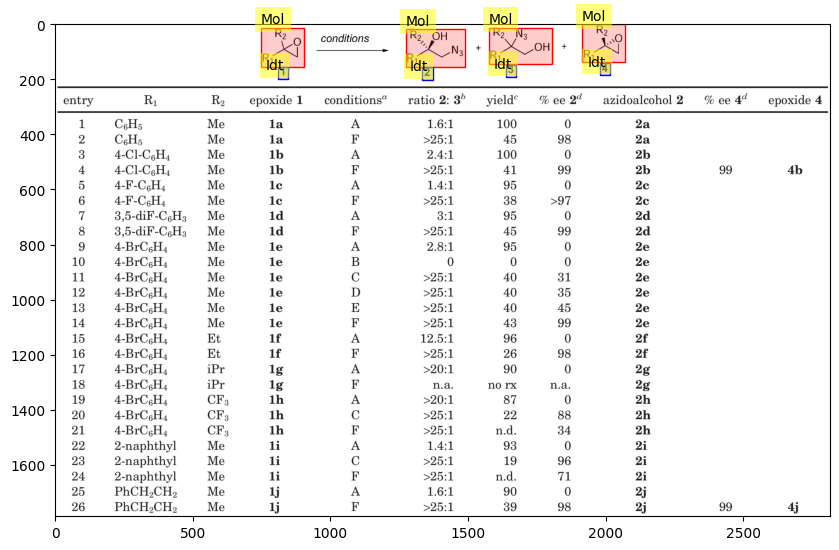

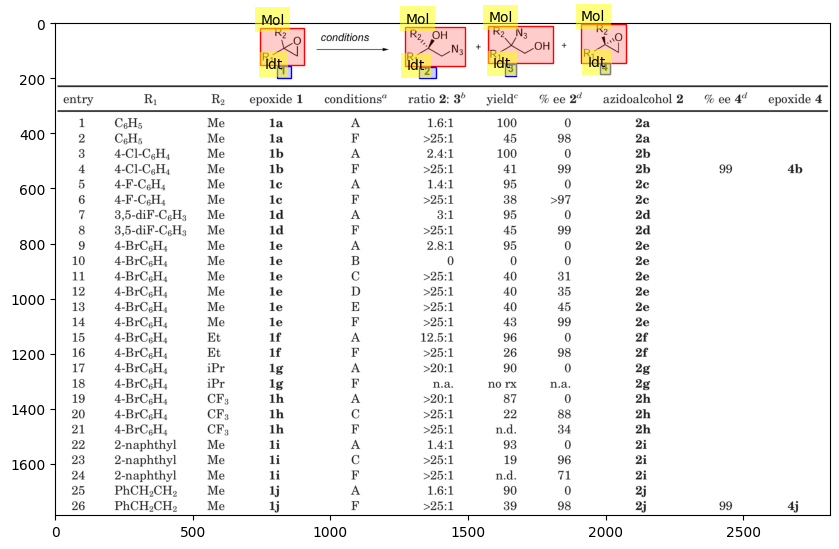

16
the prediction is
[{'category': '[Mol]', 'bbox': [0.029014507253626812, 0.2863363969350488, 0.4042021010505253, 0.4465746498352396], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.17808904452226113, 0.44327076833214296, 0.22761380690345173, 0.4856705809552175], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.03801900950475238, 0.03689334345124668, 0.16558279139569784, 0.2004354778545342], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.08604302151075538, 0.6508646561100534, 0.3181590795397699, 0.8105522620930614], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1775887943971986, 0.8402871956209318, 0.22611305652826413, 0.881035067492458], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.22961480740370185, 0.04019722495434339, 0.3581790895447724, 0.20649259394354483], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.34067033516758377, 0.4614421165991749, 0.6878439219609805

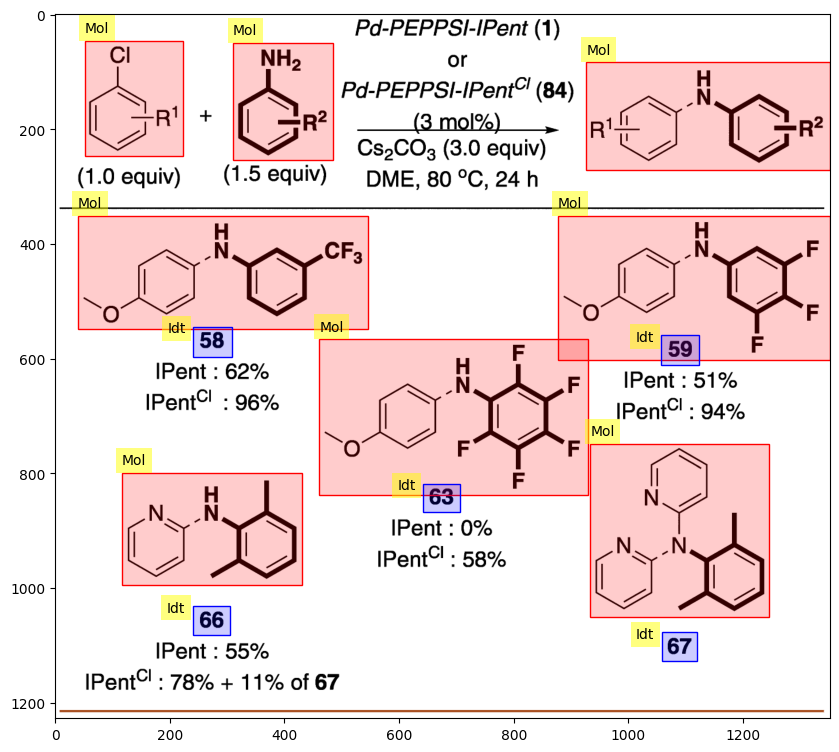

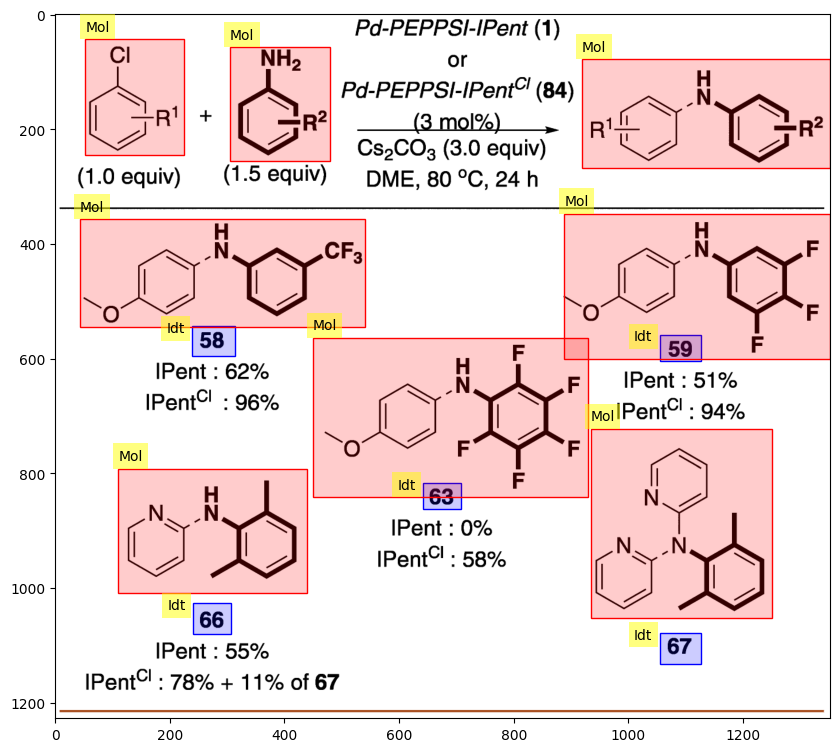

17
the prediction is
[{'category': '[Mol]', 'bbox': [0.015007503751875938, 0.0600493214016957, 0.26113056528264134, 0.2550666413824408], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.08204102051025512, 0.25621043798056836, 0.11405702851425713, 0.29853091211128724], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.026013006503251626, 0.3688744028961307, 0.18209104552276137, 0.5061299946714353], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.47073536768384194, 0.30939697979349884, 0.9889944972486243, 0.5936304344281919], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7618809404702351, 0.5821924684469164, 0.8089044522261131, 0.6262286374748266], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5477738869434717, 0.0, 0.8784392196098049, 0.19959250637325524], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6843421710855427, 0.21789325194329584, 0.7303651825912957, 0.2602137260

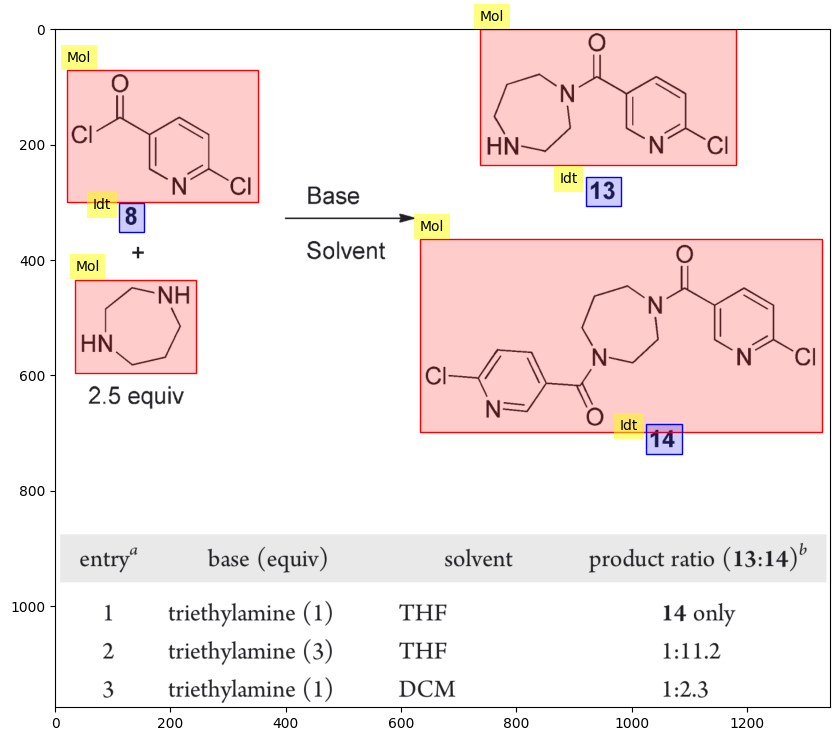

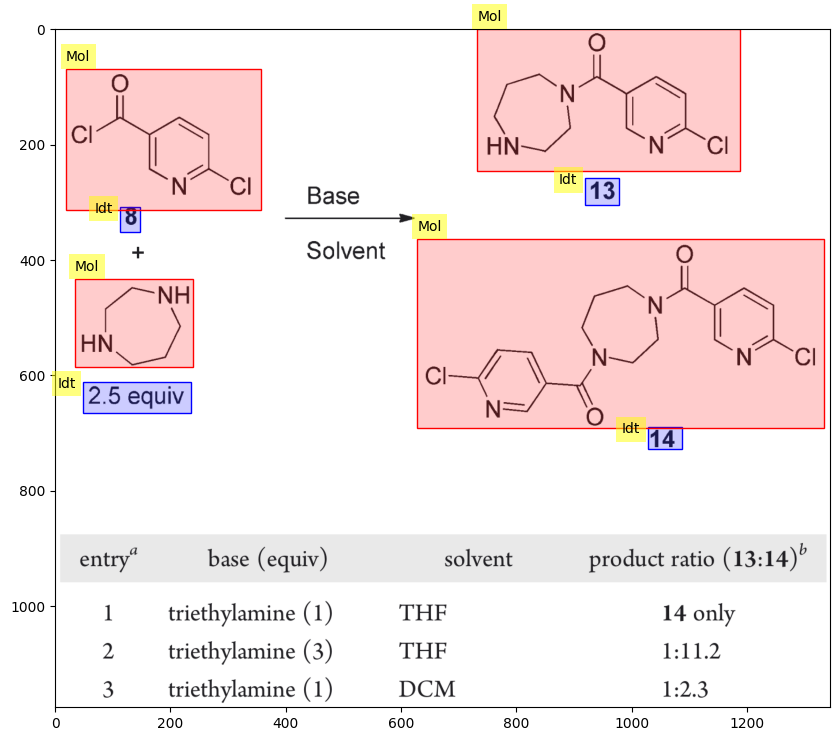

18
the prediction is
[{'category': '[Idt]', 'bbox': [0.0, 0.0, 0.14623539840095484, 0.04352176088044022], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.8599299649824912, 0.027784725696181425, 0.9389694847423712], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.14623539840095484, 0.04452226113056528], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.007311769920047743, 0.0010005002501250625], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0065805929280429686, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.007311769920047743, 0.0010005002501250625], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.004387061952028645, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.0065805929280429686, 0.0010005002501250625], 'category_id': 3, 'score': 2010}, {'

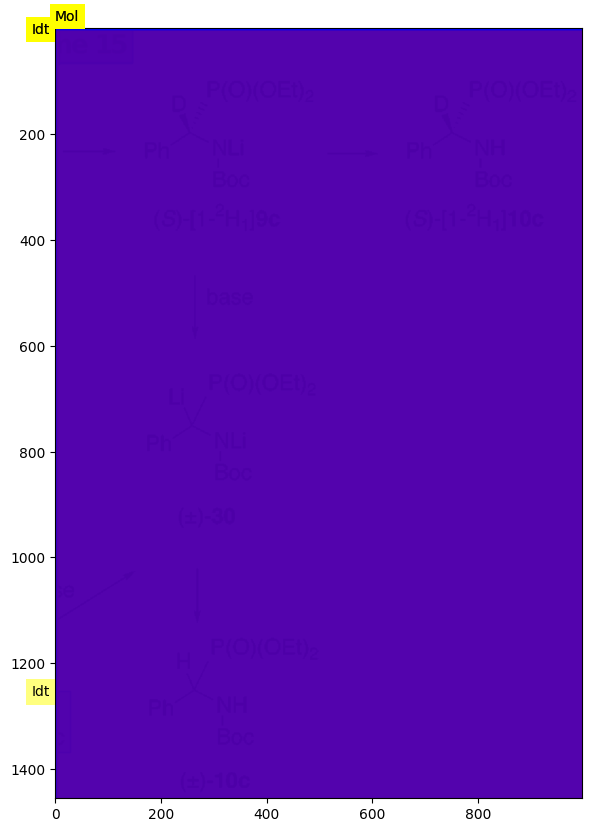

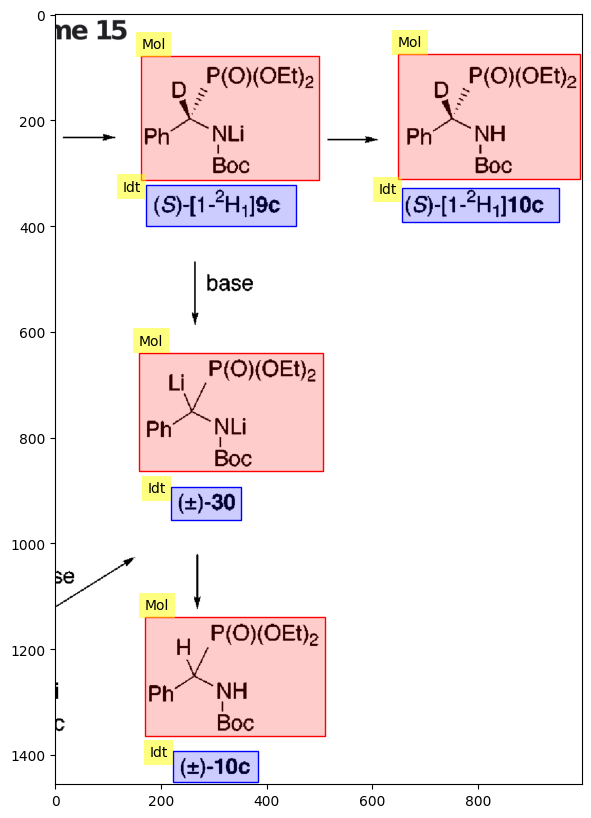

19
the prediction is
[{'category': '[Mol]', 'bbox': [0.011005502751375688, 0.042563835109043886, 0.23711855927963982, 0.5454476647307105], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13356678339169584, 0.5517534180801986, 0.18009004502251125, 0.6636805400336102], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.33366683341670833, 0.34996931089658306, 0.46823411705852924, 0.5454476647307105], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.680840420210105, 0.0, 0.9879939969984992, 0.5454476647307105], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7713856928464232, 0.5517534180801986, 0.8194097048524263, 0.6636805400336102], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9490, 'image_id': 1206, 'category_id': 3, 'segmentation': [], 'area': 3528.0, 'bbox': [1036.05, 235.0, 72.0, 49.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9491, 'image_id

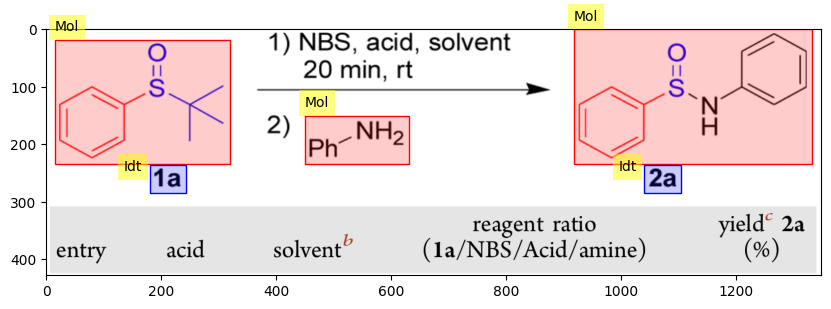

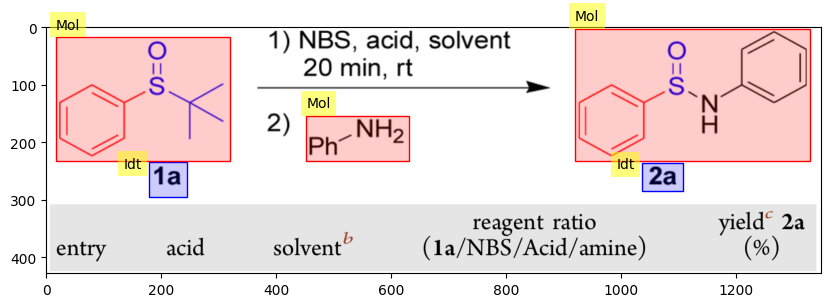

20
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0828832495343717, 0.19759879939969985, 0.29668435912871693], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09554777388694347, 0.28161467739519475, 0.12406203101550775, 0.34283525943762844], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2676338169084542, 0.1026622068096195, 0.45372686343171587, 0.2891495182619559], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7493746873436719, 0.002825565325035399, 0.9964982491245623, 0.3079866204288585], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.9024512256128064, 0.28255653250353996, 0.9314657328664332, 0.3475445349793541], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9495, 'image_id': 1207, 'category_id': 1, 'segmentation': [], 'area': 33350.0, 'bbox': [361.0, 72.6, 250.0, 133.4], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9496, 'image_i

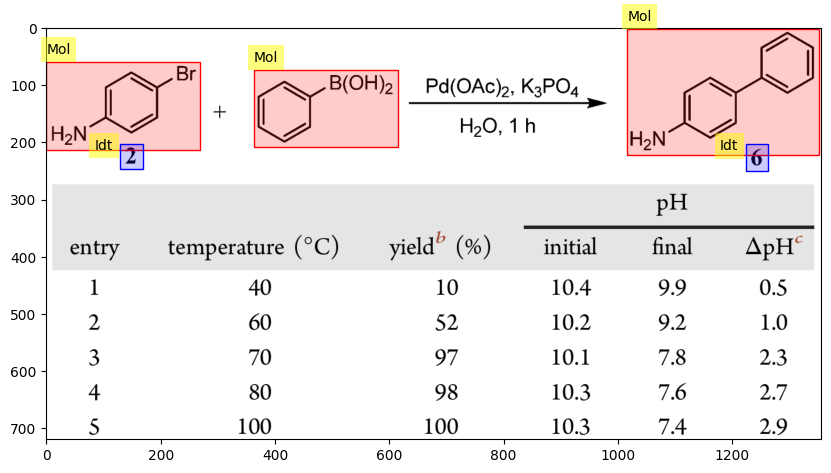

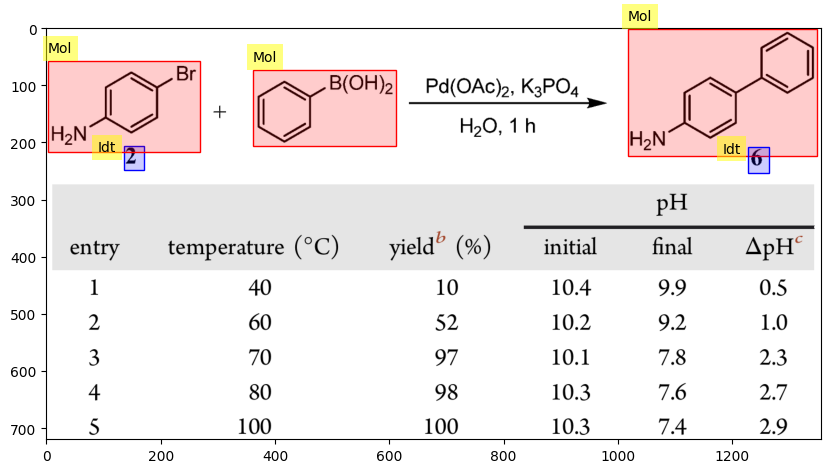

21
the prediction is
[{'category': '[Mol]', 'bbox': [0.18609304652326164, 0.11484353287754989, 0.31615807903951976, 0.3568793656087303], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6283141570785392, 0.11113890278472568, 0.759879939969985, 0.3630537490967706], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9500, 'image_id': 1208, 'category_id': 1, 'segmentation': [], 'area': 23939.44, 'bbox': [251.3, 59.1, 173.6, 137.9], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9501, 'image_id': 1208, 'category_id': 1, 'segmentation': [], 'area': 24348.940000000002, 'bbox': [844.4, 60.0, 179.3, 135.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accum

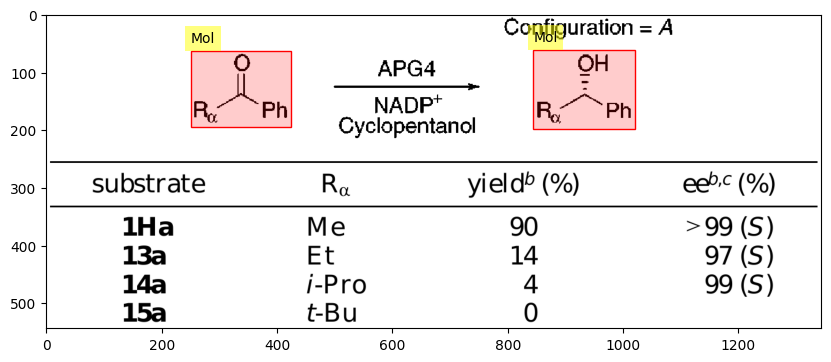

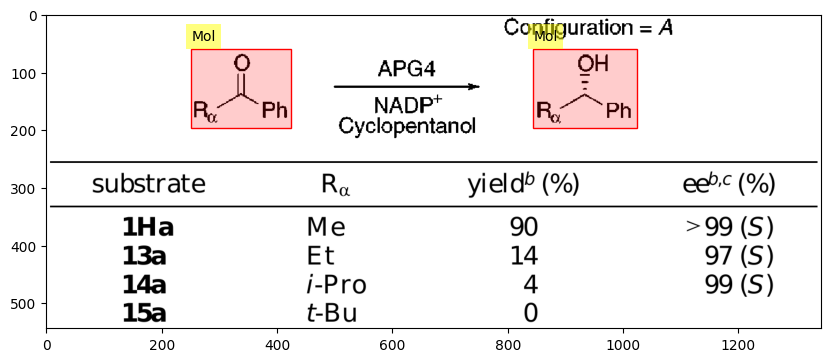

22
the prediction is
[{'category': '[Idt]', 'bbox': [0.0, 0.060530265132566284, 0.04996446349976141, 0.08354177088544272], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2536657377680195, 0.0, 0.5313528522186166, 0.15107553776888444], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3987548529307882, 0.13356678339169584, 0.442954186026731, 0.15307653826913456], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.25654830296992875, 0.32066033016508255, 0.8907126473899776, 0.5832916458229115], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.29402165059474983, 0.17108554277138568, 0.5275094319494041, 0.3121560780390195], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3516729546329361, 0.29164582291145574, 0.38530288198854473, 0.31115557778889447], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6543423008334138, 0.31915957978989495, 0.7129544599389032, 0.3491745872936468], 'categ

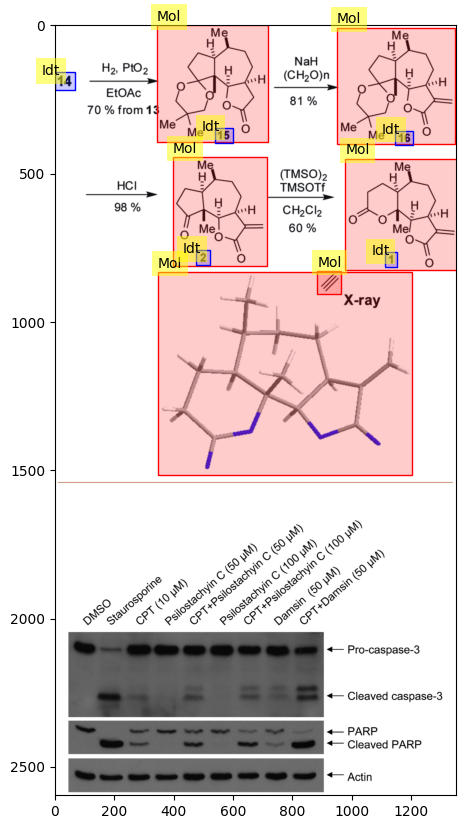

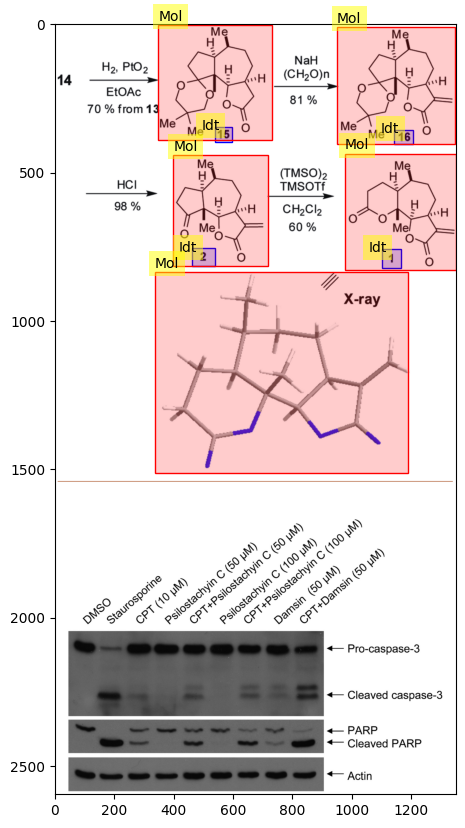

23
the prediction is
[{'category': '[Mol]', 'bbox': [0.20588026253563943, 0.23161580790395198, 0.4472885349778715, 0.33516758379189593], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2186339071174932, 0.4257128564282141, 0.5948664222821793, 0.5672836418209104], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.46004217955972526, 0.5302651325662832, 0.6231066352848555, 0.5537768884442221], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.4673299764636417, 0.5592796398199099, 0.6130859145419705, 0.5832916458229115], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.25962776470202314, 0.0, 0.538385996276827, 0.12106053026513257], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.35528009906592645, 0.11105552776388194, 0.3908081089725191, 0.1310655327663832], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4044727281673624, 0.2416208104052026, 0.8481173646932757, 0.38469234617308656

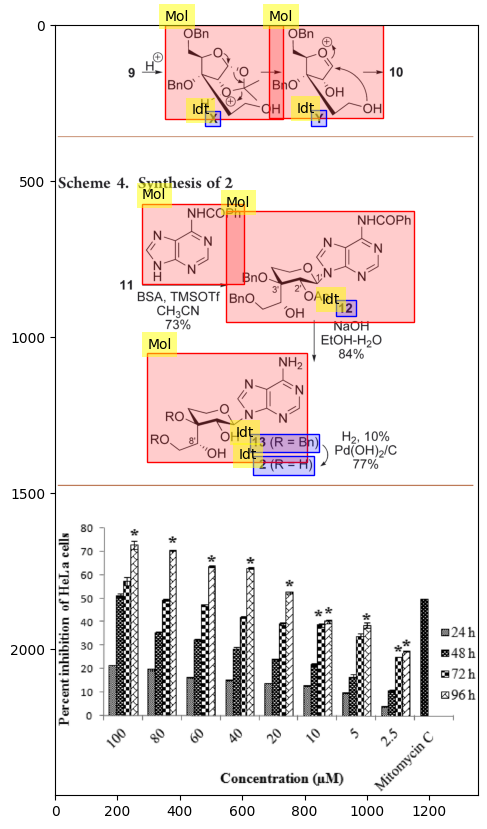

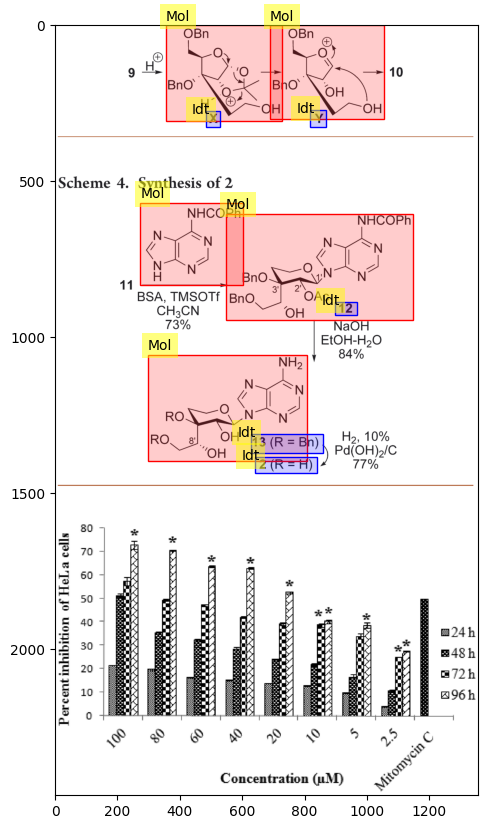

24
the prediction is
[{'category': '[Mol]', 'bbox': [0.08854427213606804, 0.015793423027303126, 0.43721860930465234, 0.5527698059556094], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.27463731865932967, 0.6282272715305021, 0.3156578289144572, 0.7493101814064927], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6593296648324162, 0.0070192991232458325, 0.9129564782391195, 0.5352215581474948], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.775887943971986, 0.6387562202153708, 0.8054027013506754, 0.7528198309681157], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9521, 'image_id': 1211, 'category_id': 1, 'segmentation': [], 'area': 89672.8, 'bbox': [119.0, 27.4, 478.0, 187.6], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9522, 'image_id': 1211, 'category_id': 3, 'segmentation': [], 'area': 1645.0, 'bbox': [1048.0, 242.0, 35.0, 47.0], 'iscrowd': 0, 'attributes': {'occ

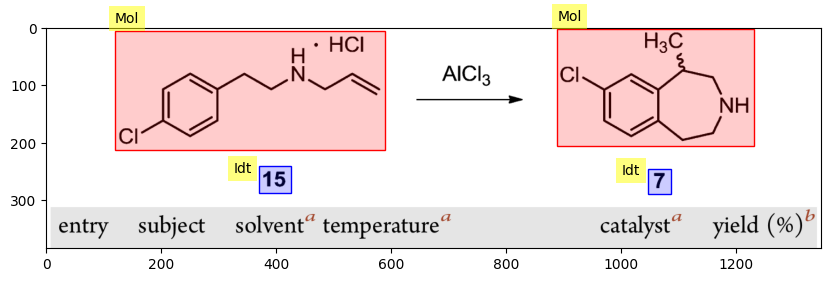

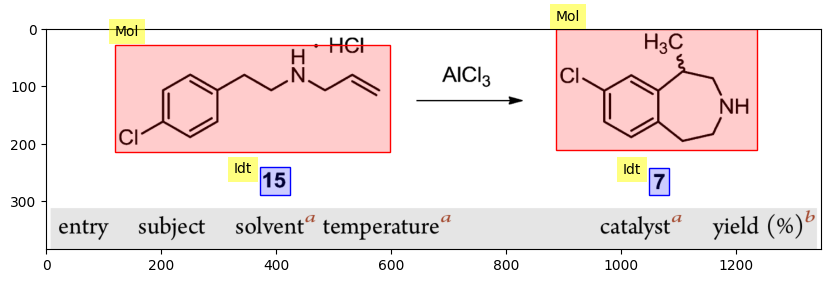

25
the prediction is
[{'category': '[Mol]', 'bbox': [0.009504752376188095, 0.3815983136076709, 0.1805902951475738, 0.5695065740962968], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.08904452226113056, 0.5791428951469955, 0.13206603301650827, 0.6456335103968169], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.011005502751375688, 0.6967060119655204, 0.22311155577788894, 0.949177623493828], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.08754377188594298, 0.9318322456025702, 0.128064032016008, 0.9925410682219723], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.40670335167583793, 0.37678015308232155, 0.5397698849424712, 0.6176881793497906], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.45522761380690346, 0.5993791693534629, 0.49524762381190596, 0.6620152561830048], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7503751875937968, 0.6967060119655204, 0.9889944972486243, 0

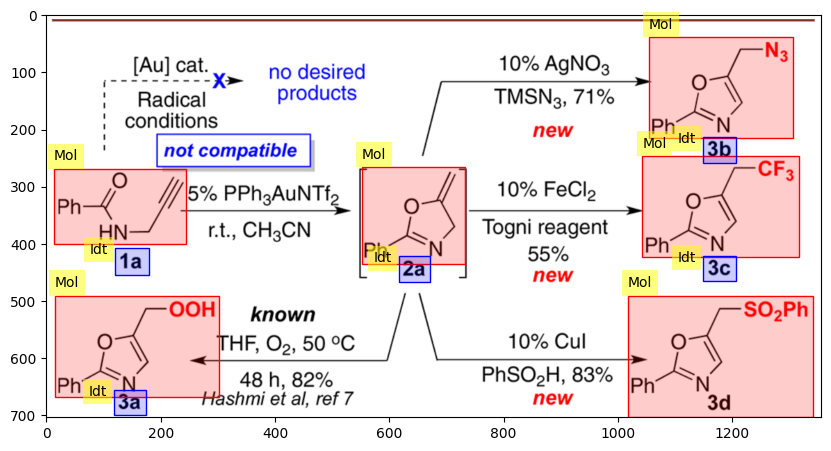

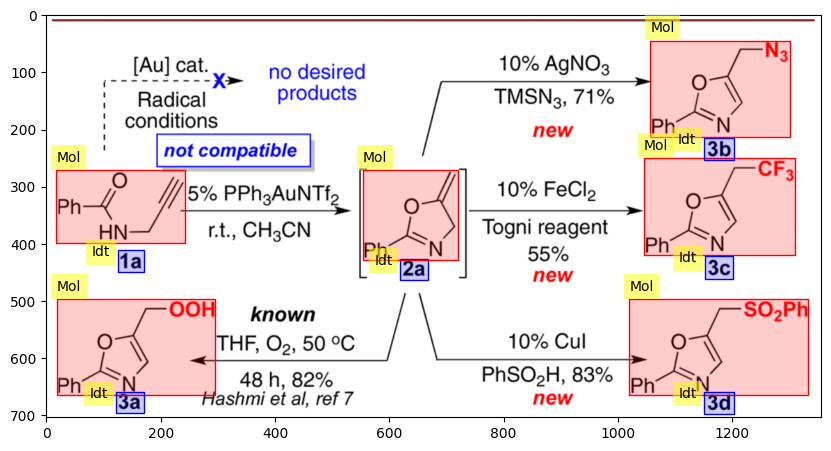

26
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.05432906185235475, 0.3121560780390195, 0.43314402737082824], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2511255627813907, 0.3773264980704638, 0.30965482741370687, 0.44951716929893515], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4072036018009004, 0.6214351595440578, 0.9169584792396198, 1.0047155274065604], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7158579289644822, 0.9295479212820695, 0.7718859429714857, 0.9980174238905167], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6768384192096047, 0.043165555992281855, 1.0, 0.43314402737082824], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.9694847423711856, 0.3803034329664833, 1.0, 0.44951716929893515], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9537, 'image_id': 1213, 'category_id': 1, 'segmentation': [], 'area': 83435.68, 'bbox': [6

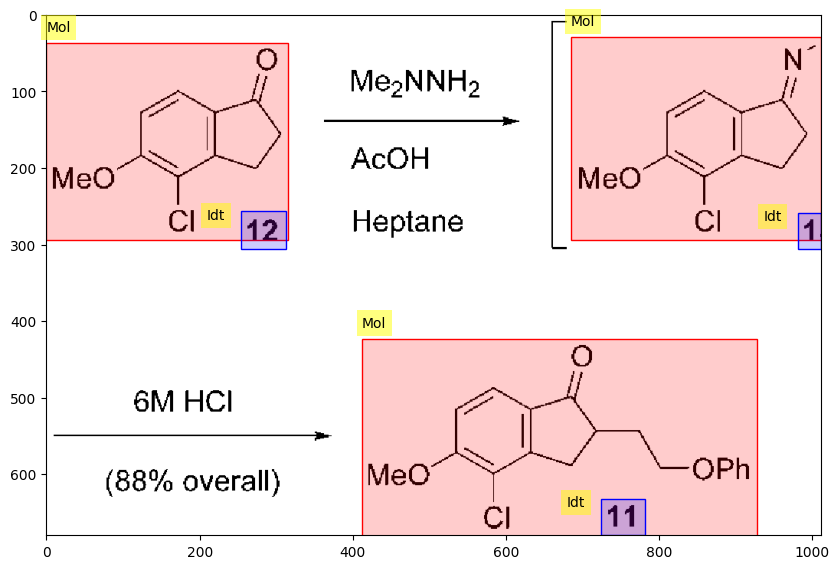

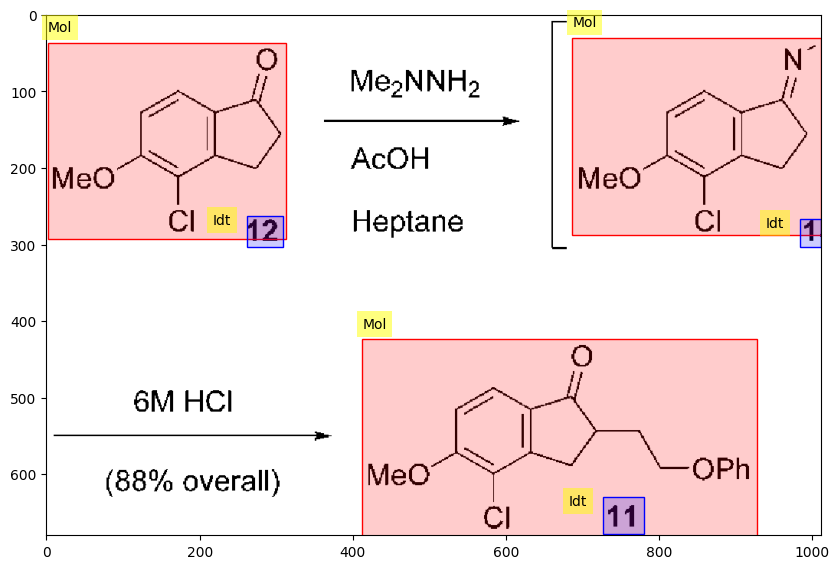

27
the prediction is
[{'category': '[Mol]', 'bbox': [0.096048024012006, 0.0, 0.2416208104052026, 0.41266564759896013], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12356178089044523, 0.4897727236209111, 0.1485742871435718, 0.5825867966102967], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.29364682341170584, 0.00571163526088526, 0.45522761380690346, 0.416949374044624], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3631815907953977, 0.494056450066575, 0.39119559779889945, 0.5868705230559605], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6493246623311656, 0.0, 0.9079539769884942, 0.41409355641418144], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7383691845922962, 0.4854889971752472, 0.8139069534767384, 0.5925821583168458], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9543, 'image_id': 1214, 'category_id': 3, 'segmentation': [], 'area': 950.0, 'b

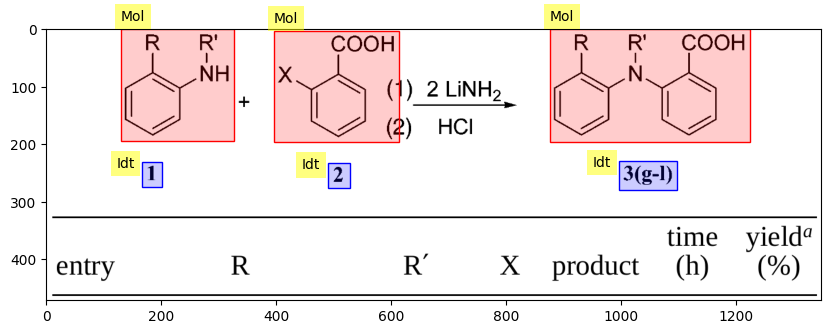

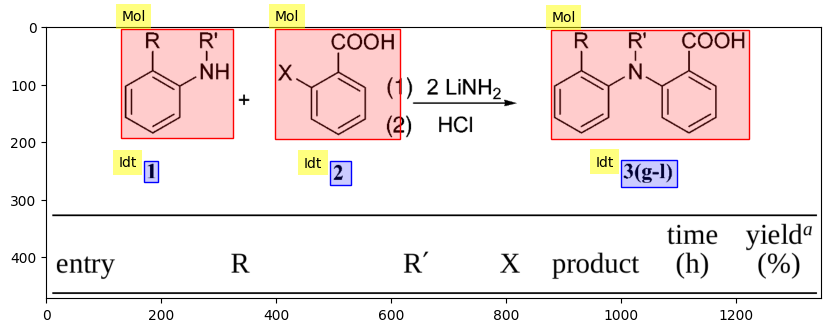

28
the prediction is
[{'category': '[Mol]', 'bbox': [0.11555777888944473, 0.37143791193842535, 0.2206103051525763, 0.5147486023713611], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3166583291645823, 0.3590079030743442, 0.42971485742871435, 0.5176733103393802], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.46973486743371684, 0.4079967615386641, 0.7273636818409205, 0.8079505761652755], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5247623811905953, 0.6646398857323398, 0.5492746373186593, 0.7085105052526264], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9549, 'image_id': 1215, 'category_id': 1, 'segmentation': [], 'area': 78702.8, 'bbox': [794.5, 612.5, 288.5, 272.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9550, 'image_id': 1215, 'category_id': 1, 'segmentation': [], 'area': 64144.32, 'bbox': [290.1, 637.9, 261.6, 245.2], 'iscrowd': 0, 'attributes': {'oc

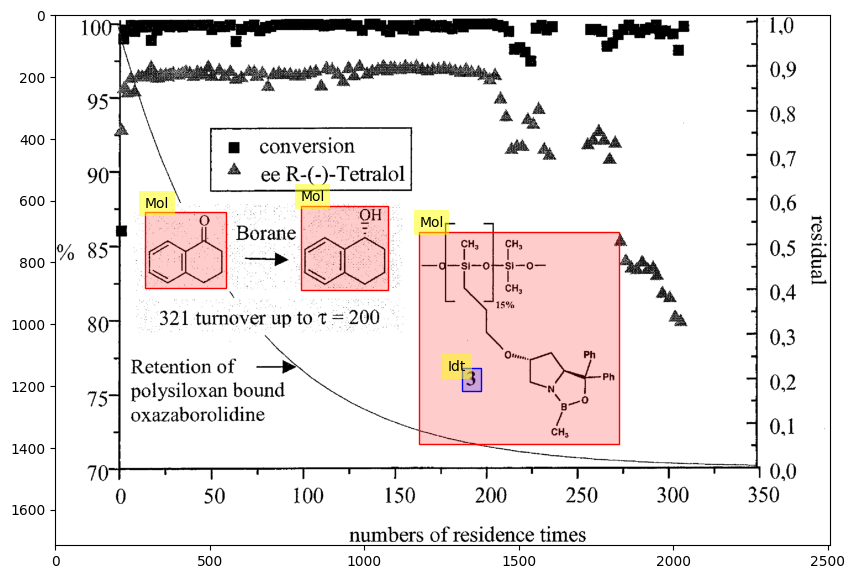

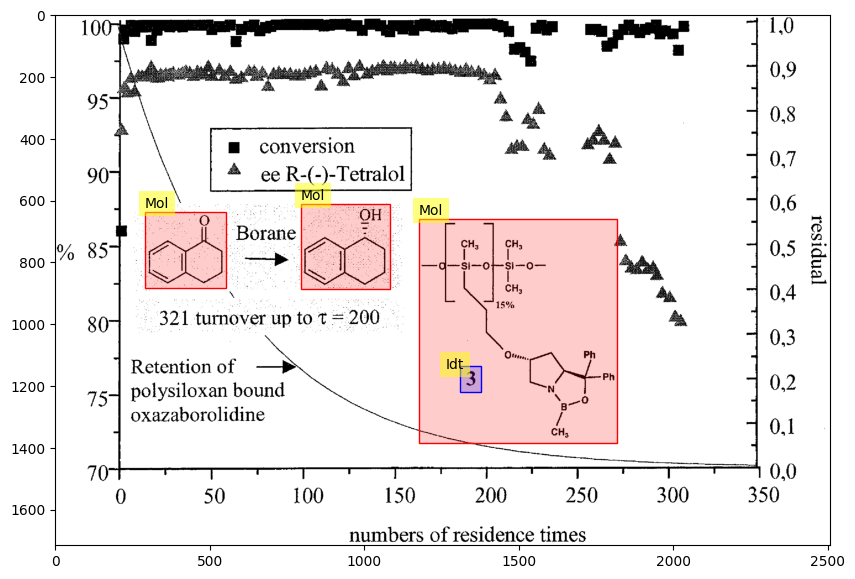

29
the prediction is
[{'category': '[Mol]', 'bbox': [0.013506753376688344, 0.04450265386930753, 0.144072036018009, 0.20979822538387838], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.04902451225612806, 0.2168621386964669, 0.07553776888444222, 0.2712542712033983], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6028014007003502, 0.03178760990664824, 0.8124062031015508, 0.20979822538387838], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6353176588294147, 0.21827492135898455, 0.6658329164582291, 0.2698414885408806], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.8024012006003002, 0.03178760990664824, 0.9864932466233116, 0.20979822538387838], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8344172086043021, 0.2168621386964669, 0.8639319659829915, 0.2698414885408806], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9553, 'image_id': 1216, 'category_id': 3, '

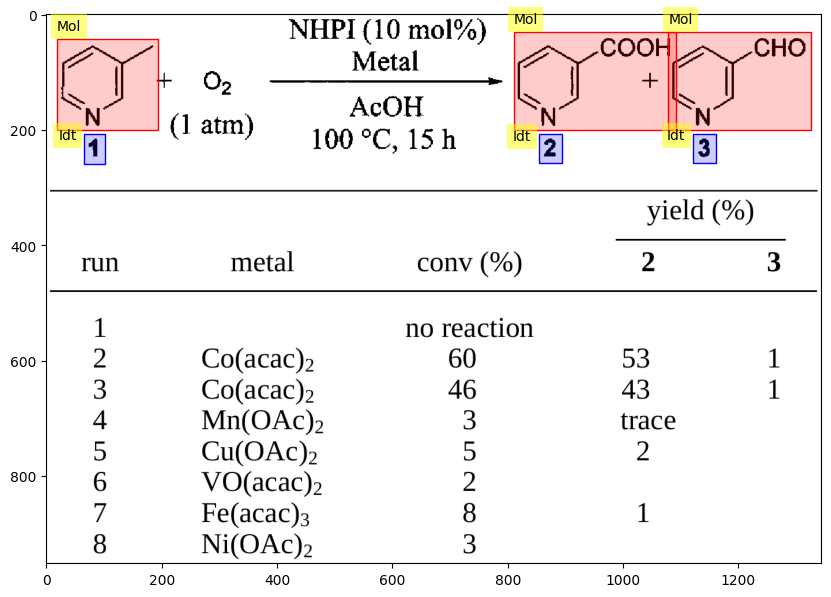

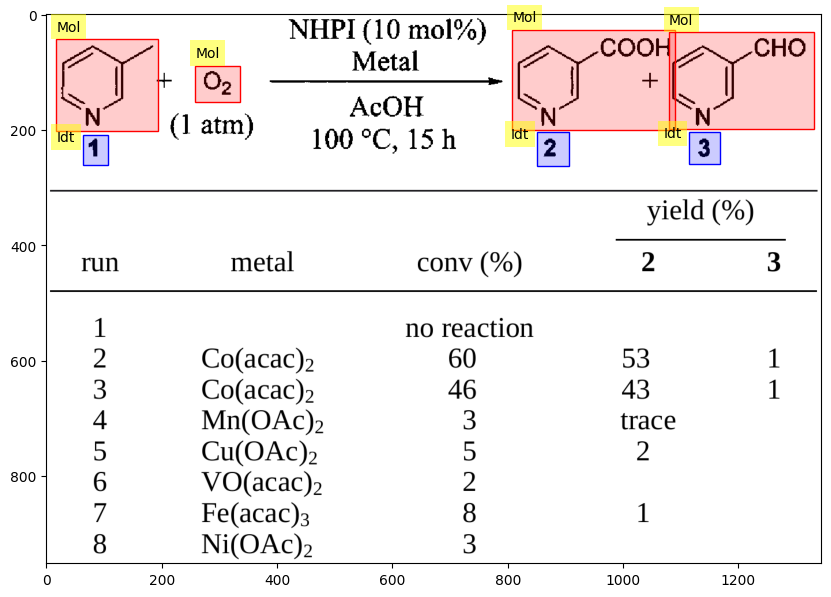

30
the prediction is
[{'category': '[Mol]', 'bbox': [0.02001000500250125, 0.07110327498042969, 0.17258629314657328, 0.20434184431312677], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.08504252126063032, 0.21459096503102654, 0.11305652826413207, 0.2594308681718381], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2096048024012006, 0.1101780477174226, 0.39869934967483744, 0.16526707157613388], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2766383191595798, 0.21715324521050147, 0.3216608304152076, 0.261993148351313], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6763381690845423, 0.07110327498042969, 0.9799899949974987, 0.20177956413365183], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8269134567283641, 0.21587210512076402, 0.871935967983992, 0.261993148351313], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9560, 'image_id': 1217, 'category_id': 3, '

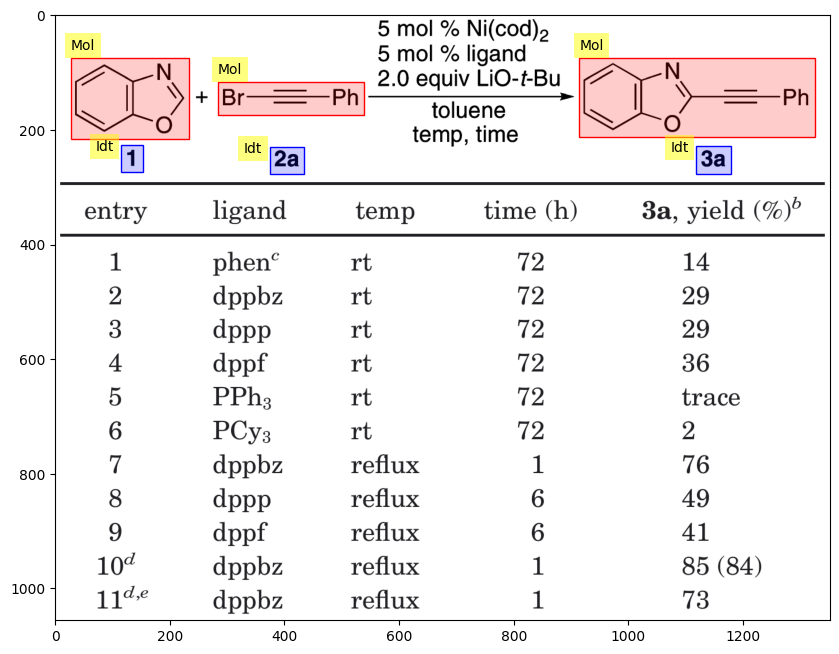

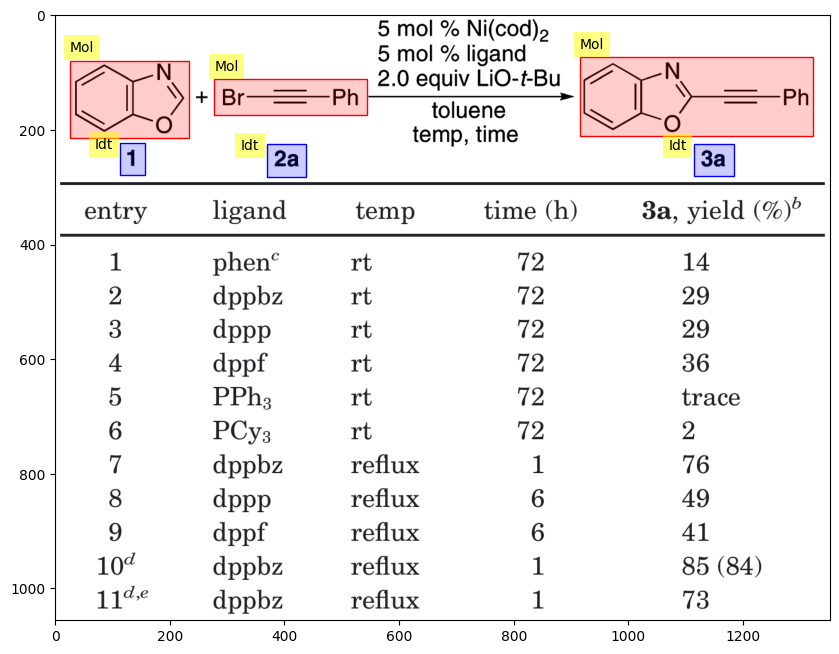

31
the prediction is
[{'category': '[Mol]', 'bbox': [0.1017907707747955, 0.02501250625312656, 0.23543443580564943, 0.1040520260130065], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13572102769972733, 0.10705352676338169, 0.15787956283437668, 0.1265632816408204], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23474198158269163, 0.0065032516258129065, 0.4182423506665066, 0.06353176588294147], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3399950234722761, 0.05552776388194097, 0.37461773462016573, 0.07753876938469234], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4182423506665066, 0.011005502751375688, 0.6509069695803249, 0.12906453226613307], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4667141462735521, 0.10455227613806903, 0.4930274067459482, 0.1265632816408204], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5387293854611624, 0.12756378189094547, 0.67375795893

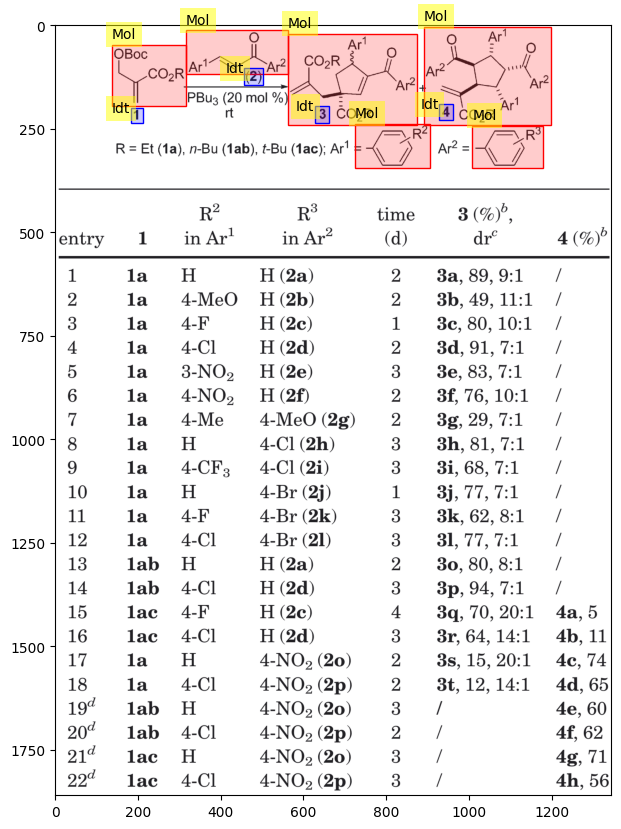

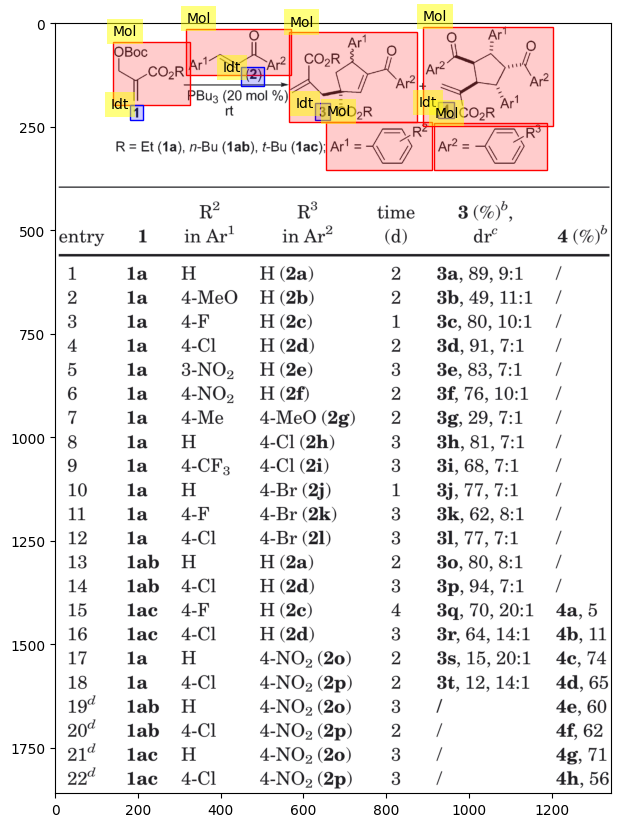

32
the prediction is
[{'category': '[Mol]', 'bbox': [0.11705852926463231, 0.7100718947369938, 0.23011505752876438, 0.9032037632649178], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.11855927963981991, 0.03459078242291175, 0.2511255627813907, 0.22772265095083566], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.31015507753876936, 0.12683286888400974, 0.4612306153076538, 0.23733120162386673], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3506753376688344, 0.6889330832563256, 0.5017508754377189, 0.7965488507942733], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6863431715857929, 0.7071893295350846, 0.886943471735868, 0.905125473399524], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6943471735867934, 0.03459078242291175, 0.8924462231115557, 0.3036302012677809], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9576, 'image_id': 1219, 'category_id': 1, 'seg

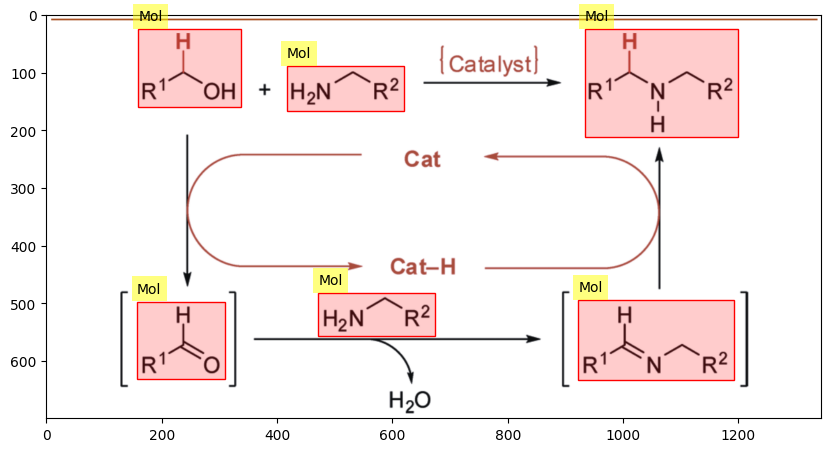

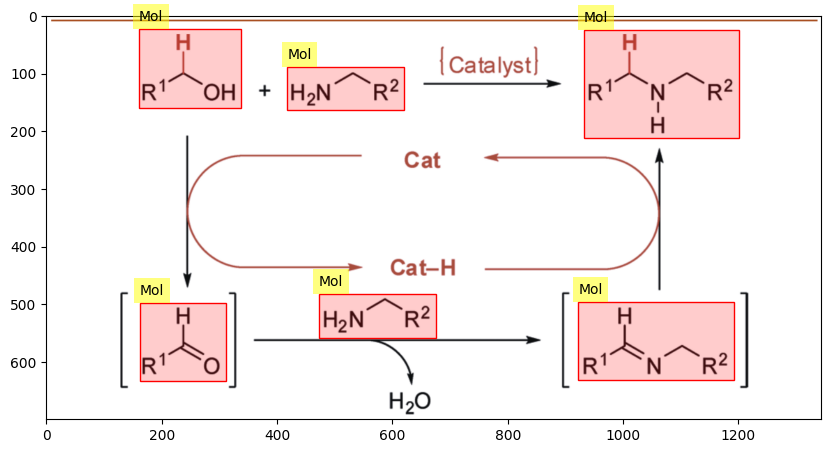

33
the prediction is
[{'category': '[Mol]', 'bbox': [0.057528764382191094, 0.015661106202050346, 0.23261630815407705, 0.24480781800047122], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11105552776388194, 0.2596446554550452, 0.13656828414207103, 0.3140463927884833], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2801400700350175, 0.05275319983848537, 0.42521260630315155, 0.27365722416214294], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3261630815407704, 0.2909668678591459, 0.37018509254627313, 0.3486656801824893], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7113556778389195, 0.0, 0.9459729864932466, 0.24315928050551852], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7673836918459229, 0.26129319294999787, 0.7958979489744873, 0.3148706615359596], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9582, 'image_id': 1220, 'category_id': 3, 'segmentatio

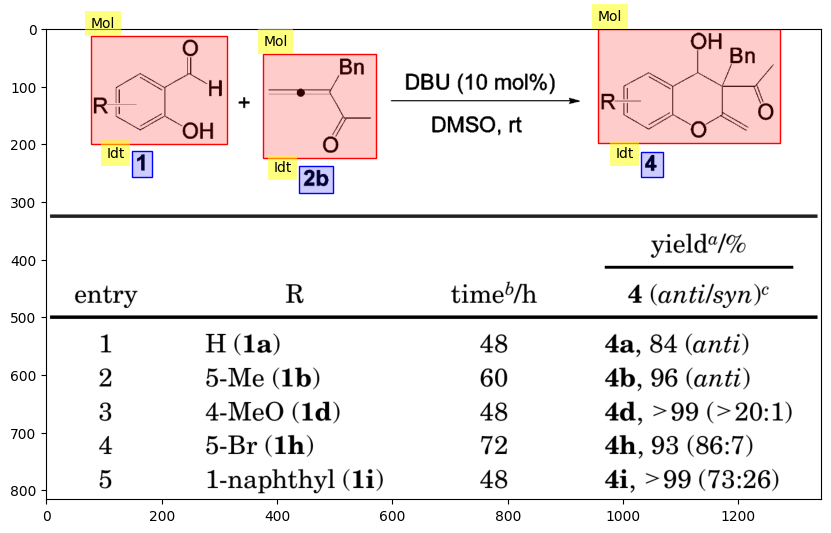

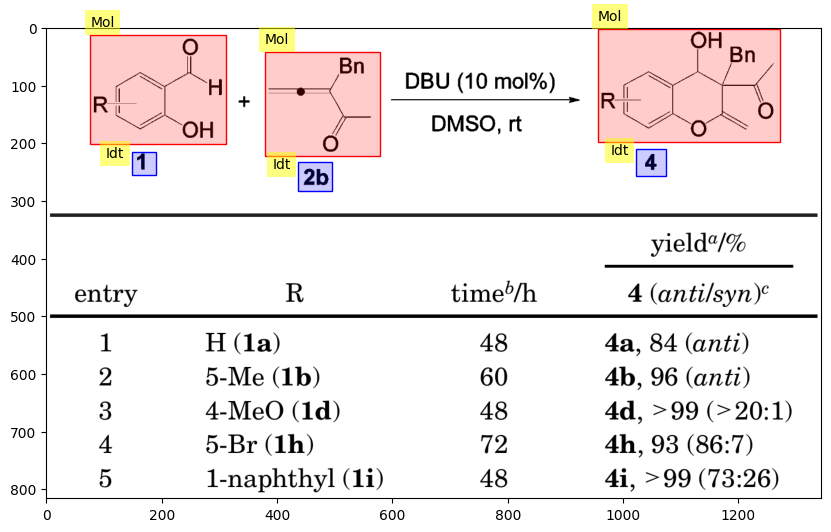

34
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.4609577901758343, 0.256128064032016, 0.6566527538578449], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09854927463731866, 0.660046308141348, 0.15757878939469736, 0.7233926547667388], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.2239745827112029, 0.25662831415707854, 0.4015705902145305], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09954977488744372, 0.3896931502222697, 0.1585792896448224, 0.4507771273253251], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.04702351175587794, 0.7420572033260056, 0.21260630315157578, 0.9224811727322524], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11155577788894447, 0.9287026889186748, 0.14607303651825912, 0.9643350088954571], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.16858429214607304, 0.002262369522335383, 0.41420710355177587, 0.1889078551150045], 'category_

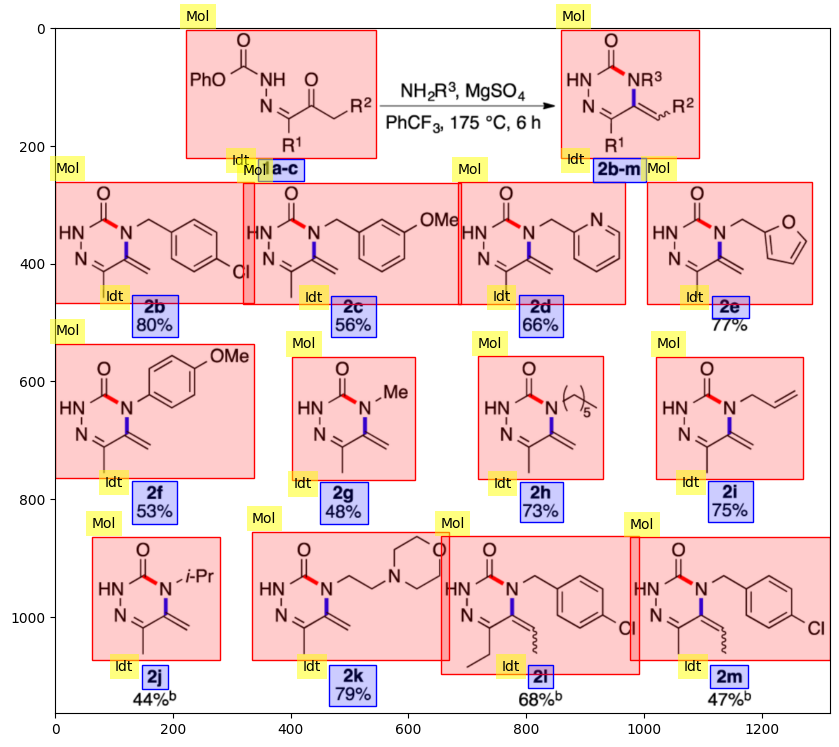

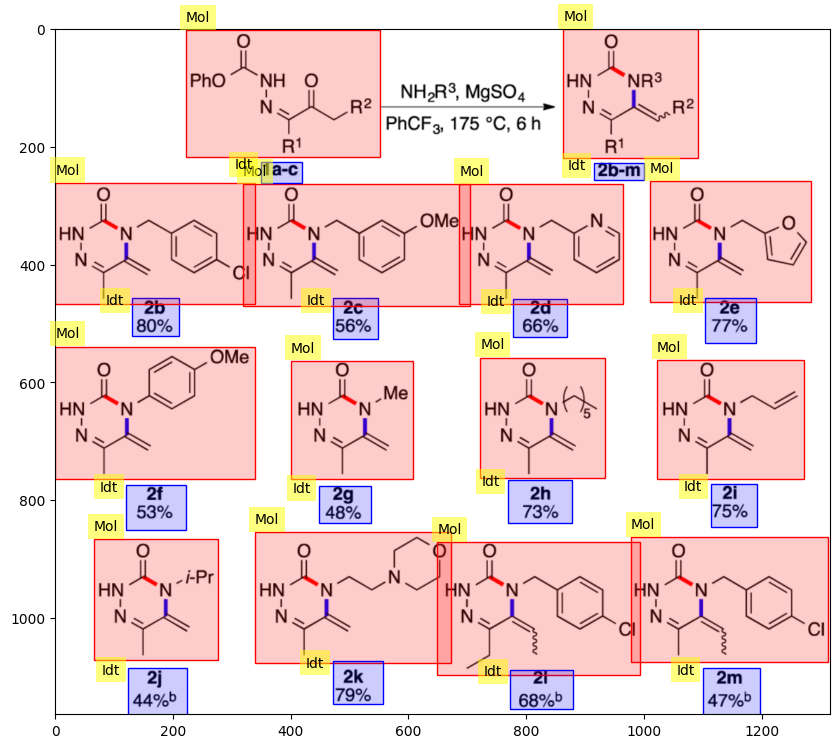

35
the prediction is
[{'category': '[Mol]', 'bbox': [0.018009004502251125, 0.08335417708854427, 0.2671335667833917, 0.58347923961981], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11605802901450725, 0.5678503314157078, 0.15457728864432216, 0.6789892342004336], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.28414207103551775, 0.13718708312489578, 0.49074537268634316, 0.5487483324995831], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.36668334167083544, 0.5661137860596965, 0.40820410205102553, 0.6789892342004336], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7238619309654828, 0.010419272136068034, 0.984992496248124, 0.6477314177922295], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8264132066033016, 0.6407852363681842, 0.8839419709854928, 0.7536606845089212], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9616, 'image_id': 1222, 'category_id': 3, 's

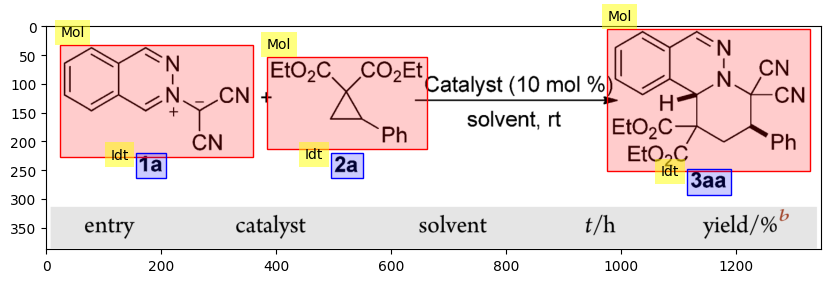

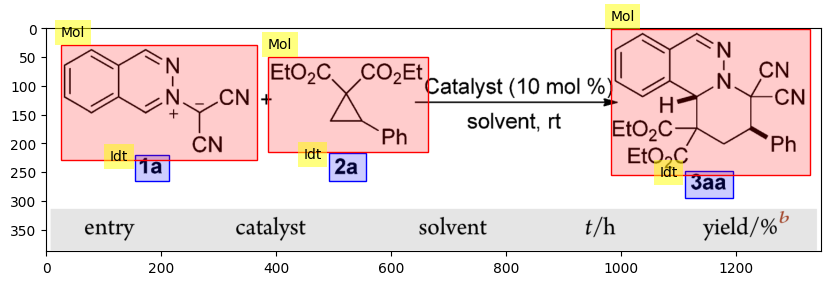

36
the prediction is
[{'category': '[Mol]', 'bbox': [0.08754377188594298, 0.23300335691972443, 0.4457228614307154, 0.6590666381443634], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.23561780890445222, 0.6684977264006379, 0.28064032016008006, 0.7112150085025875], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5982991495747874, 0.2435439849708548, 0.959479739869935, 0.6684977264006379], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7553776888444222, 0.6712715758877775, 0.8024012006003002, 0.713434088092299], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9622, 'image_id': 1223, 'category_id': 1, 'segmentation': [], 'area': 249472.84, 'bbox': [804.6, 294.6, 483.1, 516.4], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9623, 'image_id': 1223, 'category_id': 1, 'segmentation': [], 'area': 249223.8, 'bbox': [118.1, 279.0, 480.2, 519.0], 'iscrowd': 0, 'attributes': {'oc

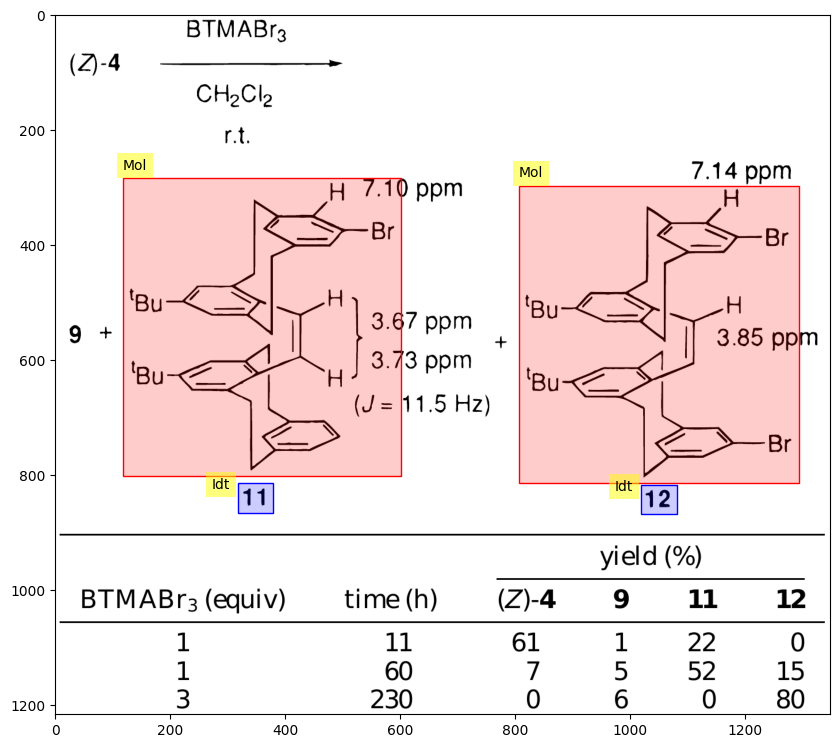

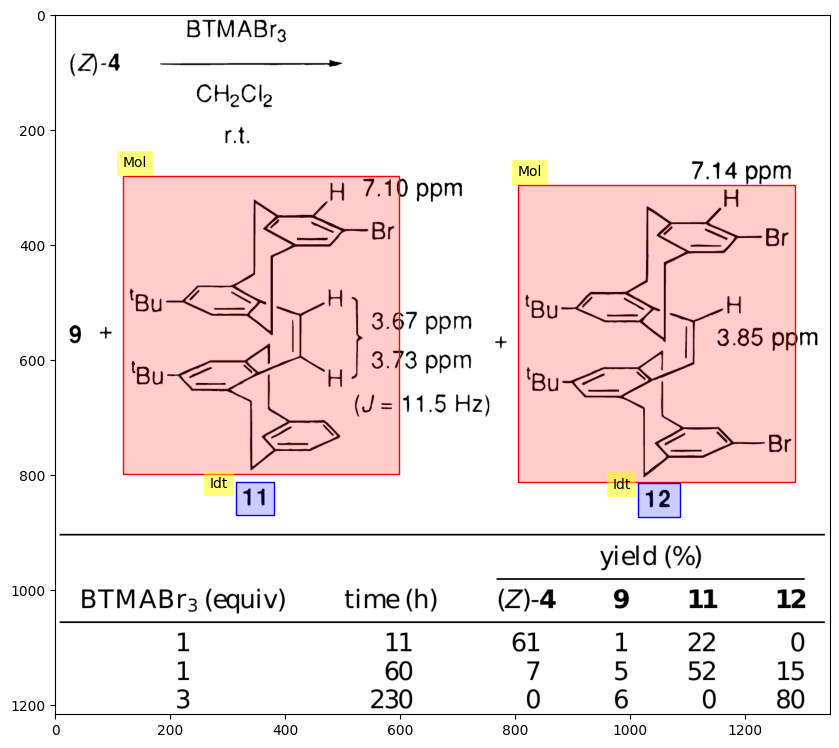

37
the prediction is
[{'category': '[Mol]', 'bbox': [0.060030015007503754, 0.0744867114408268, 0.2591295647823912, 0.4192537758240823], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14107053526763383, 0.4852277202431003, 0.1805902951475738, 0.5320479388630486], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.34217108554277137, 0.004965780762721787, 0.48774387193596797, 0.22700712058156738], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.39269634817408705, 0.22771651783338479, 0.4352176088044022, 0.27595553095696784], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5842921460730365, 0.004256383510904389, 0.9339669834917459, 0.5050908432939875], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7398699349674838, 0.48664651474673515, 0.7793896948474237, 0.5320479388630486], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9626, 'image_id': 1224, 'category_id': 

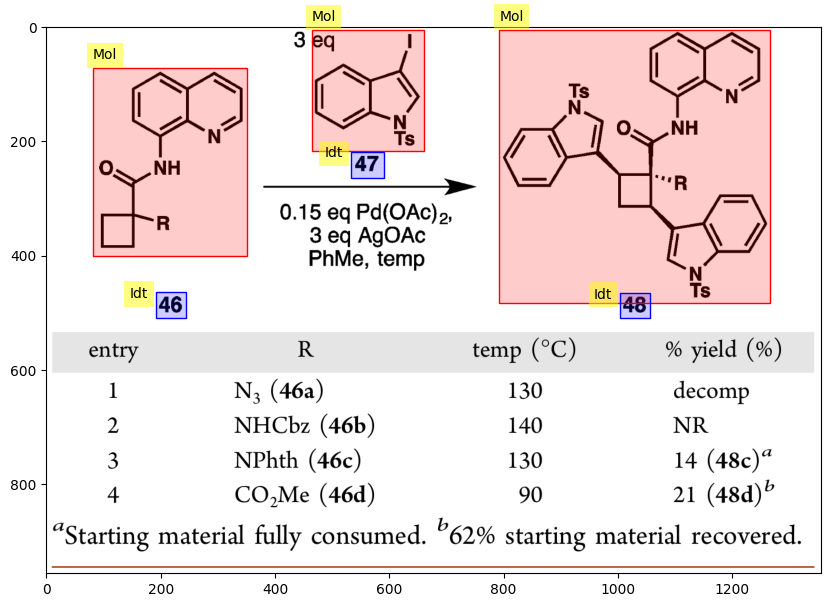

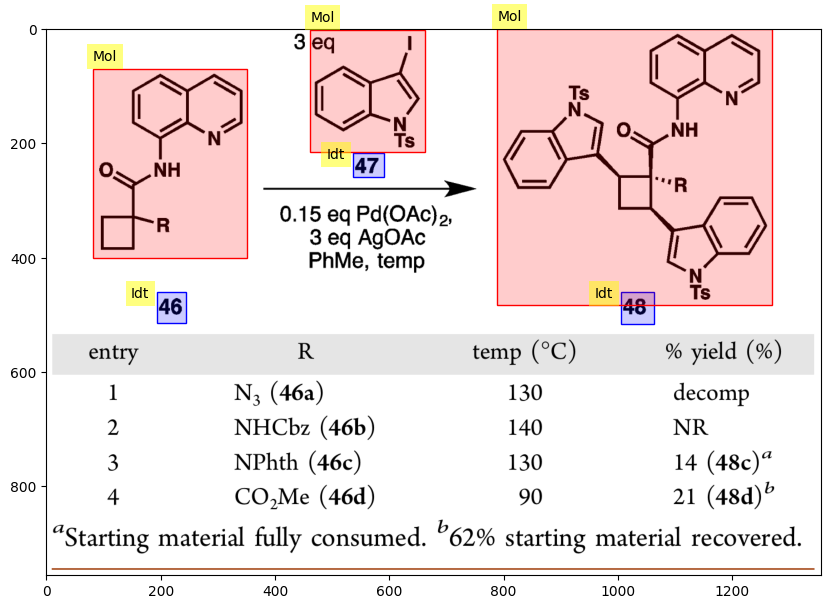

38
the prediction is
[{'category': '[Mol]', 'bbox': [0.0785392696348174, 0.067083842221411, 0.352176088044022, 0.3734667634117359], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1950975487743872, 0.404505556081344, 0.2656328164082041, 0.46858564417343807], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6508254127063532, 0.003003754129316911, 0.9234617308654327, 0.41952432672792855], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6673336668334167, 0.40851056158709986, 0.7303651825912957, 0.46858564417343807], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9632, 'image_id': 1225, 'category_id': 1, 'segmentation': [], 'area': 101936.0, 'bbox': [879.0, 4.0, 368.0, 277.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9633, 'image_id': 1225, 'category_id': 1, 'segmentation': [], 'area': 74095.0, 'bbox': [108.0, 47.0, 365.0, 203.0], 'iscrowd': 0, 'attributes': {'occlud

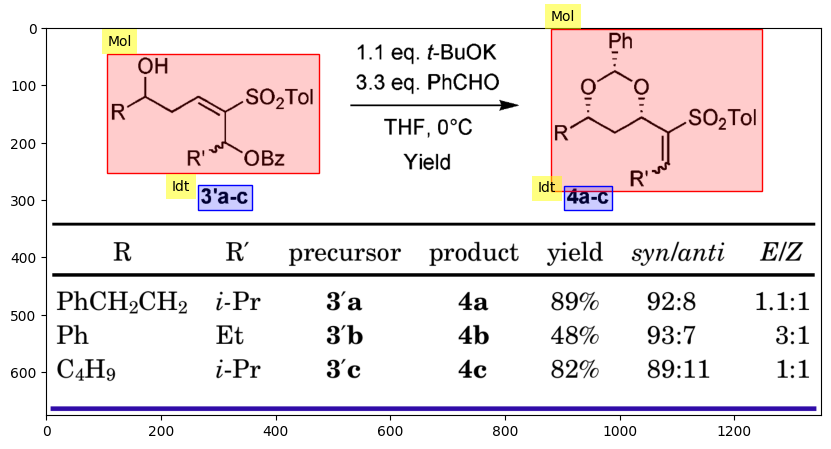

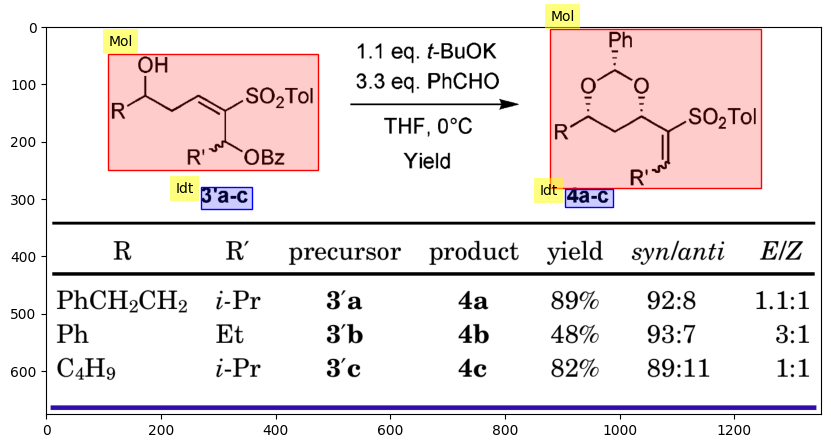

39
the prediction is
[{'category': '[Mol]', 'bbox': [0.07403701850925462, 0.0630340045644713, 0.34817408704352176, 0.26651219473750143], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.16208104052026012, 0.2797825114879164, 0.23311655827913957, 0.3549809730736015], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6313156578289144, 0.06635158375207505, 0.9279639819909955, 0.405850520616859], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7713856928464232, 0.41912083736727407, 0.8424212106053026, 0.49100171976535534], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9636, 'image_id': 1226, 'category_id': 1, 'segmentation': [], 'area': 80760.0, 'bbox': [845.0, 46.0, 400.0, 201.9], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9637, 'image_id': 1226, 'category_id': 3, 'segmentation': [], 'area': 4264.0, 'bbox': [212.71, 171.85, 104.0, 41.0], 'iscrowd': 0, 'attributes': {'o

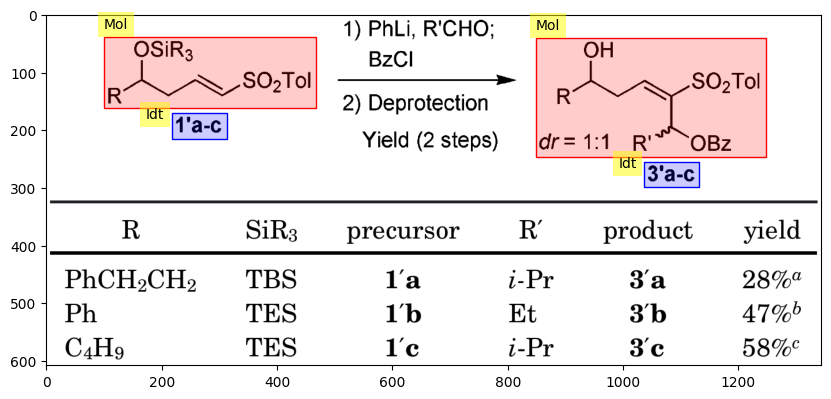

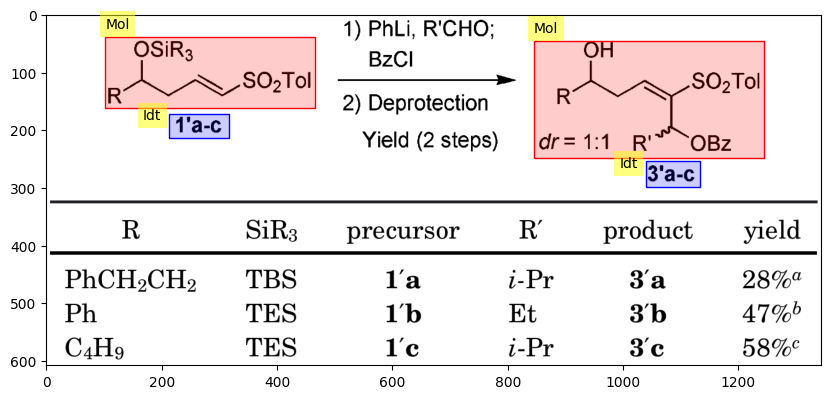

40
the prediction is
[{'category': '[Mol]', 'bbox': [0.09154577288644322, 0.13583643673688697, 0.32066033016508255, 0.6071477096572978], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1935967983991996, 0.5680432808997091, 0.2191095547773887, 0.6997634619779025], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6743371685842922, 0.008232511317387088, 0.9129564782391195, 0.6133220931453381], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7798899449724862, 0.5577526417529753, 0.8124062031015508, 0.6997634619779025], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9640, 'image_id': 1227, 'category_id': 3, 'segmentation': [], 'area': 1300.0, 'bbox': [263.0, 182.0, 26.0, 50.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9641, 'image_id': 1227, 'category_id': 3, 'segmentation': [], 'area': 1800.0, 'bbox': [1057.0, 178.0, 36.0, 50.0], 'iscrowd': 0, 'attributes': {'occlude

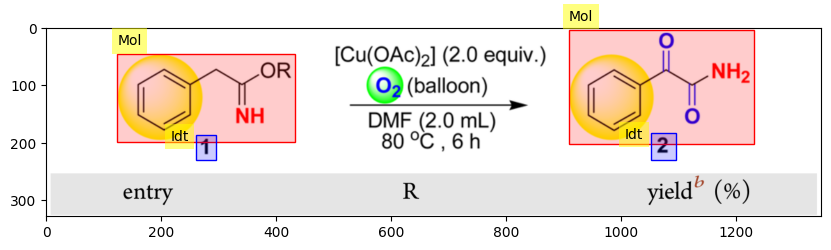

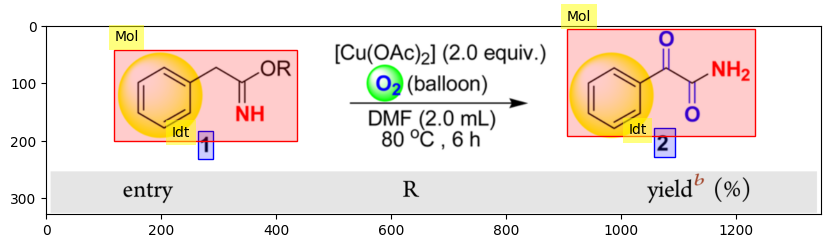

41
the prediction is
[{'category': '[Mol]', 'bbox': [0.018009004502251125, 0.07980719082945728, 0.24412206103051526, 0.4699756793290263], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.07253626813406704, 0.5160865006971571, 0.10955477738869435, 0.6224960884697669], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5107553776888444, 0.012414451906804468, 0.7408704352176088, 0.5249539663448746], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6113056528264132, 0.4841636243653742, 0.6518259129564783, 0.597667184656158], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7583791895947974, 0.010640958777260972, 0.984992496248124, 0.5160865006971571], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8589294647323662, 0.47884314497674374, 0.8989494747373686, 0.5887997190084405], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9644, 'image_id': 1228, 'category_id': 1, 's

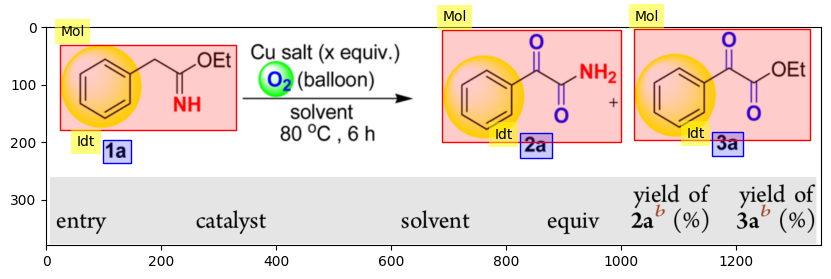

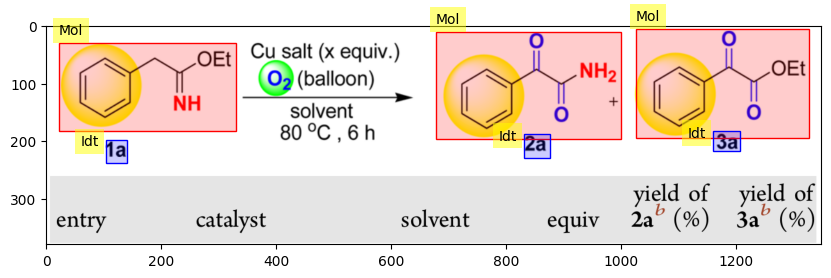

42
the prediction is
[{'category': '[Mol]', 'bbox': [0.057028514257128564, 0.09212830099260155, 0.17858929464732365, 0.43285677926682636], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.34667333666833416, 0.1052894868486875, 0.5697848924462231, 0.7297146380207647], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5387693846923461, 0.6858440185004783, 0.5662831415707854, 0.7794346734770895], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7038519259629815, 0.10090242489665886, 0.9744872436218109, 0.6960804963885452], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.9419709854927464, 0.6799946025644401, 0.9684842421210605, 0.7706605495730321], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9650, 'image_id': 1229, 'category_id': 1, 'segmentation': [], 'area': 22484.1078, 'bbox': [79.38, 47.68, 156.99, 143.22], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'i

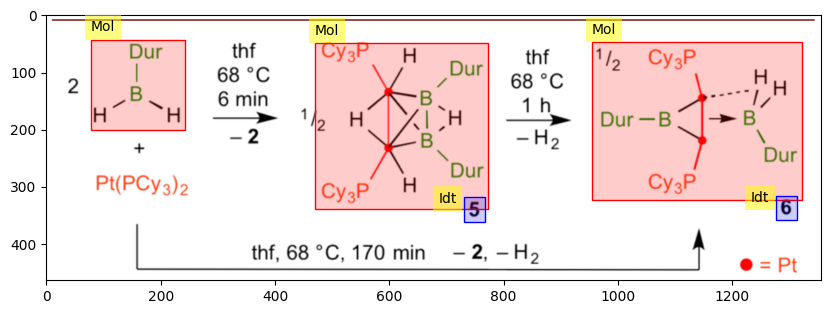

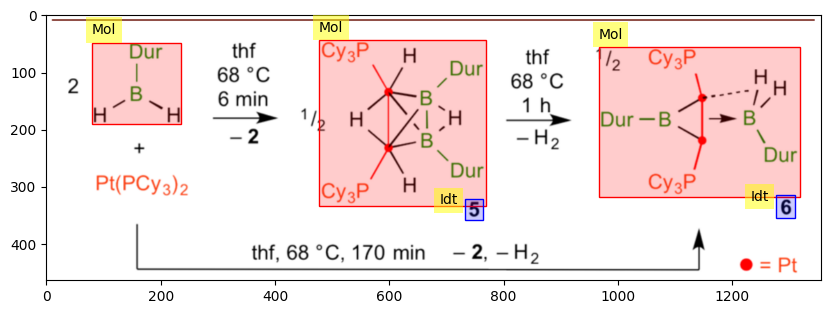

43
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0046960099768193955, 0.2621310655327664, 0.3173161027193678], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.16358179089544772, 0.225408478887331, 0.19259629814907453, 0.2703560029511738], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4432216108054027, 0.00402515140870234, 0.7073536768384192, 0.31798696128748477], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6063031515757878, 0.2287627717279163, 0.6588294147073537, 0.2737102957917591], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6848424212106053, 0.010062878521755848, 0.9784892446223111, 0.31262009274254837], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9655, 'image_id': 1230, 'category_id': 3, 'segmentation': [], 'area': 5041.0, 'bbox': [816.0, 218.0, 71.0, 71.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9656, 'image_id':

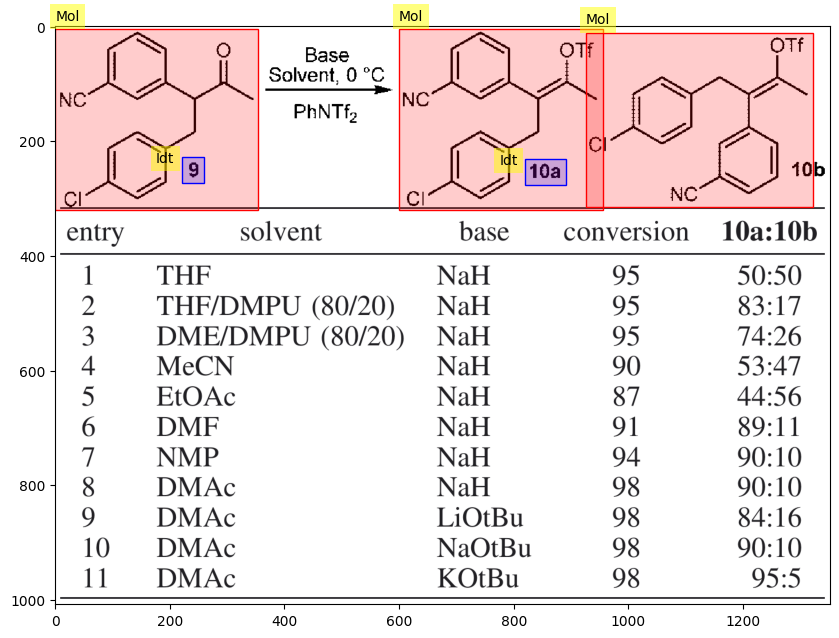

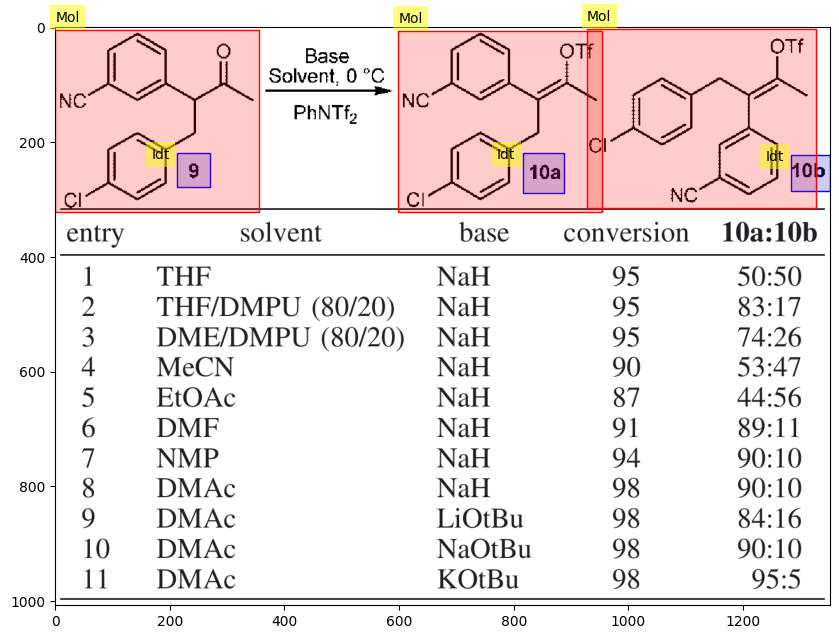

44
the prediction is
[{'category': '[Mol]', 'bbox': [0.013506753376688344, 0.20364373803668298, 0.08904452226113056, 0.3833293892455209], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.04552276138069034, 0.399301447130751, 0.06503251625812906, 0.4392315918438261], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.017008504252126064, 0.6788124601222767, 0.11055527763881941, 0.8664841402737296], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.05652826413206603, 0.8478500727409612, 0.07453726863431716, 0.8891112222778055], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.1500750375187594, 0.20098172838914466, 0.23561780890445222, 0.38066737959798264], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.18959479739869936, 0.399301447130751, 0.208104052026013, 0.4379005870200569], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.15657828914457228, 0.6801434649460459, 0.2526263131565783

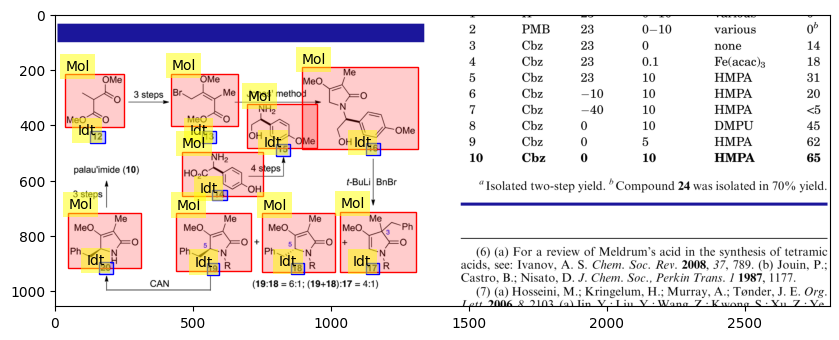

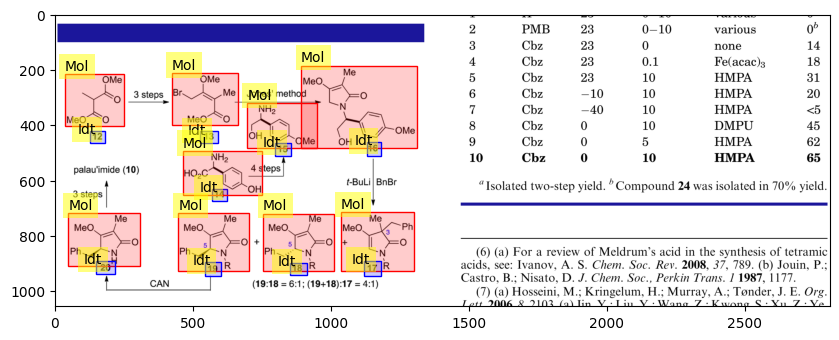

45
the prediction is
[{'category': '[Mol]', 'bbox': [0.0065032516258129065, 0.028353546852166237, 0.2046023011505753, 0.13231655197677578], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.05002501250625312, 0.1260157637874055, 0.11455727863931967, 0.15541944200446678], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2671335667833917, 0.037804729136221654, 0.408704352176088, 0.08086011509691854], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4912456228114057, 0.0036754597771326606, 0.7053526763381691, 0.16539568997096973], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5512756378189094, 0.17642206930236773, 0.6198099049524762, 0.20425055047208643], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7783891945972986, 0.0036754597771326606, 0.9949974987493747, 0.16329542724117965], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8344172086043021, 0.1722215438427875, 0.90595297

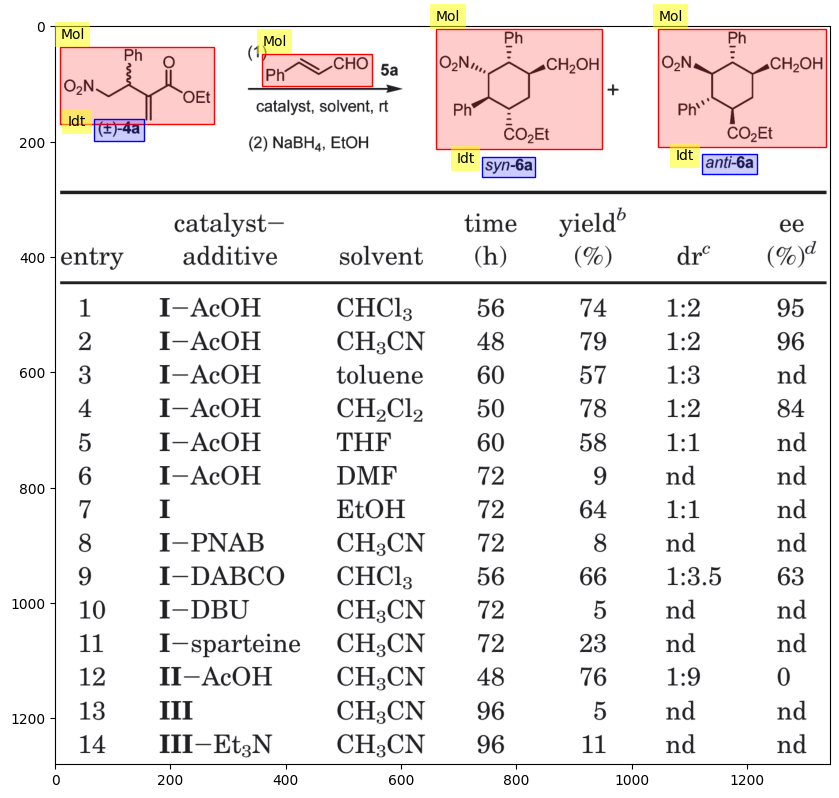

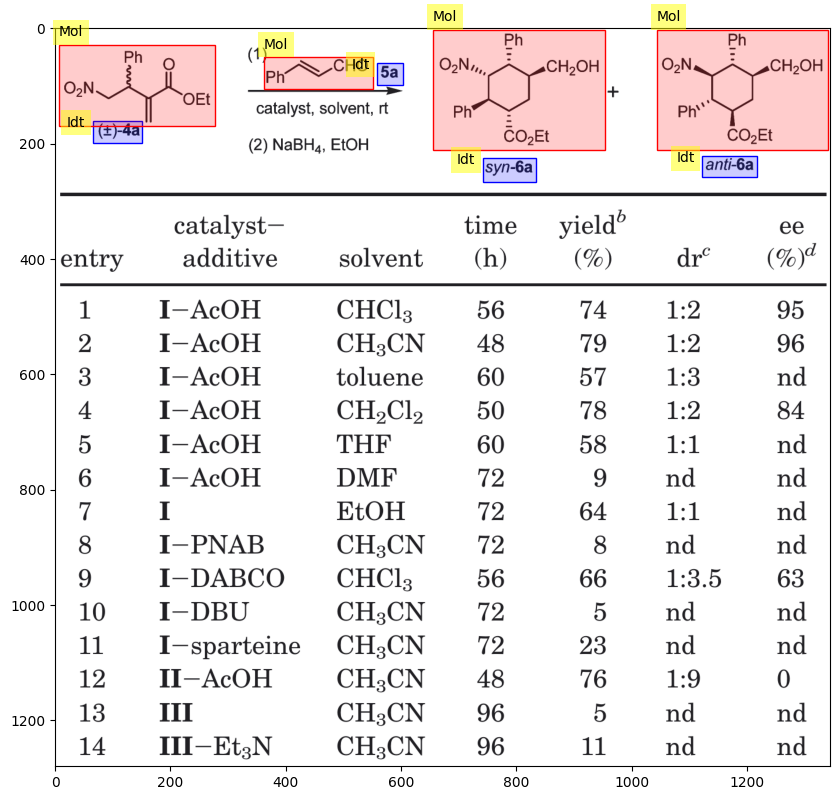

46
the prediction is
[{'category': '[Mol]', 'bbox': [0.1500750375187594, 0.3397607894856519, 0.2961480740370185, 0.4553640456591932], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6148074037018509, 0.0, 0.71935967983992, 0.10714448133157488], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7928964482241121, 0.21710855427713857, 0.9769884942471235, 0.46523261630815405], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9687, 'image_id': 1233, 'category_id': 1, 'segmentation': [], 'area': 10291.8424, 'bbox': [202.9, 167.62, 201.88, 50.98], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9688, 'image_id': 1233, 'category_id': 1, 'segmentation': [], 'area': 5786.9, 'bbox': [27.0, 168.0, 118.1, 49.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9689, 'image_id': 1233, 'category_id': 3, 'segmentation': [], 'area': 3120.0, 'bbox': [1159.94, 267.98, 80.0, 39.0], 'isc

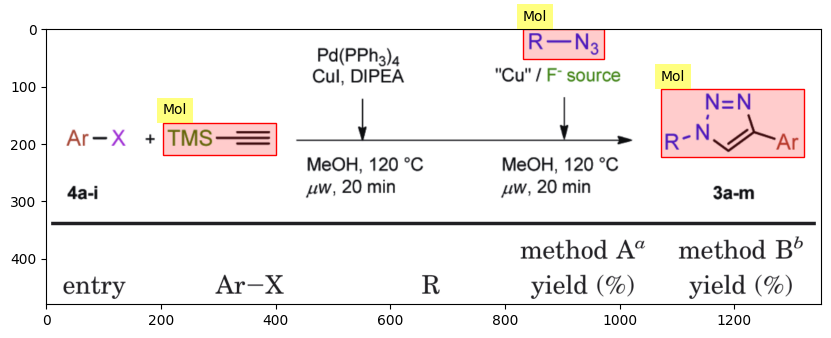

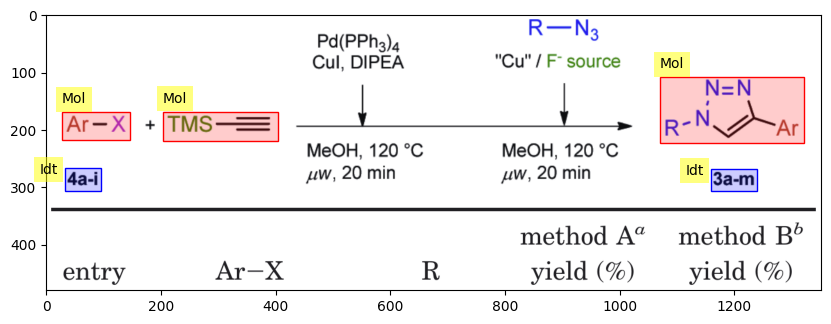

47
the prediction is
[{'category': '[Mol]', 'bbox': [0.03751875937968985, 0.14208557063035152, 0.3006503251625813, 0.854128032539272], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.17558779389694848, 0.8024605523100533, 0.2191095547773887, 0.9203269915829585], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.38319159579789897, 0.24703513984595205, 0.6263131565782891, 0.8735033376252291], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4867433716858429, 0.8751179463823923, 0.5337668834417209, 0.9929843856552975], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6433216608304152, 0.2421913135744628, 0.7733866933466733, 0.8961078602255124], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6823411705852926, 0.8622010763250875, 0.7293646823411706, 0.984911341869482], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7858929464732366, 0.19536765961673333, 0.9424712356178089, 0.85251

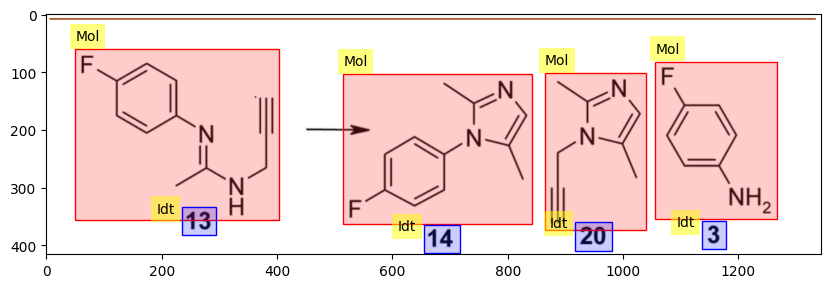

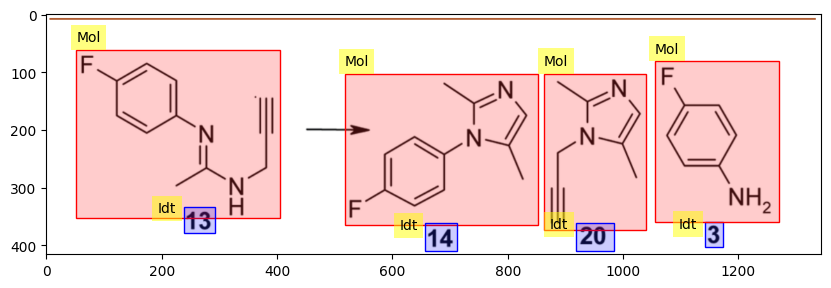

48
the prediction is
[{'category': '[Mol]', 'bbox': [0.04652326163081541, 0.14690994378428457, 0.19909954977488745, 0.3093142957020679], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.08704352176088044, 0.3271041717071961, 0.15607803901950976, 0.3689964603644335], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.24262131065532766, 0.155517948302895, 0.39919959979989994, 0.29037668576112496], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2851425712856428, 0.3259564377713814, 0.3156578289144572, 0.364979391589082], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4072036018009004, 0.0, 0.6438219109554777, 0.1836374297303557], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6688344172086043, 0.15150087952754349, 0.9549774887443722, 0.3213655020281225], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7618809404702351, 0.33284284138626974, 0.8314157078539269, 0.3770305979151365

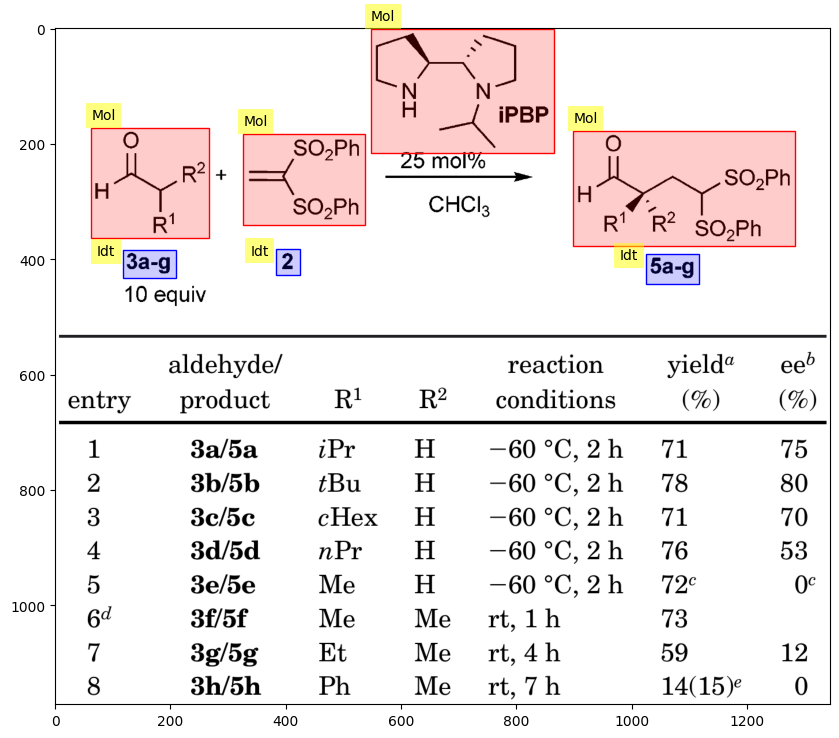

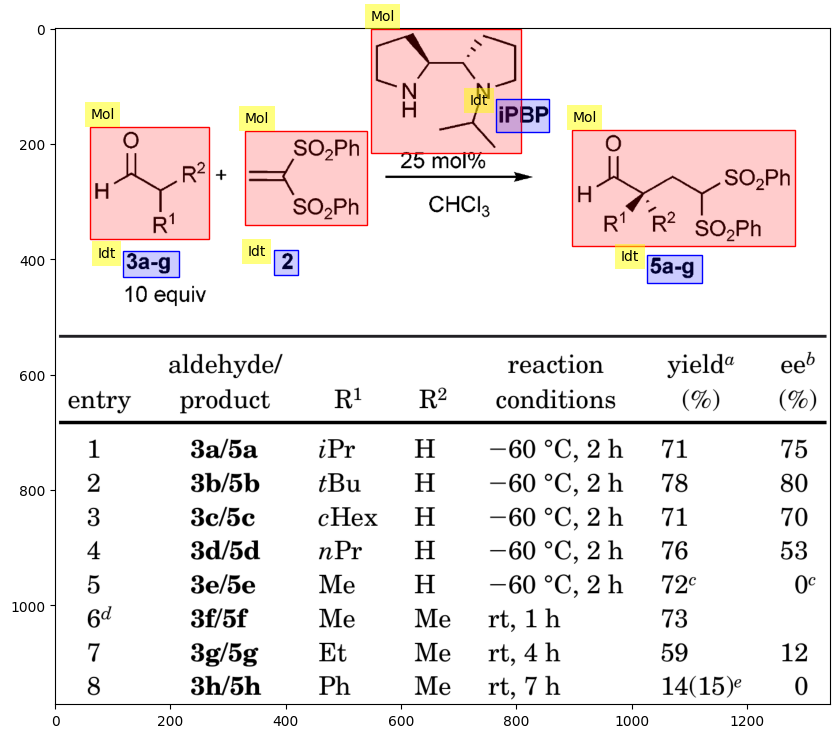

49
the prediction is
[{'category': '[Mol]', 'bbox': [0.11605802901450725, 0.3533221834797996, 0.21310655327663833, 0.5115707107284987], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12306153076538269, 0.5264998170727154, 0.21460730365182593, 0.570291862349085], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23311655827913957, 0.7325214846229086, 0.3061530765382691, 0.9196329508037602], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.23311655827913957, 0.9226187720726036, 0.33366683341670833, 0.9972643037936879], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3291645822911456, 0.34635526718583176, 0.42021010505252626, 0.5055990681908119], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3246623311655828, 0.5205281745350286, 0.45222611305652827, 0.562329672298836], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.32416208104052024, 0.5673060410802416, 0.4532266133066533, 0.

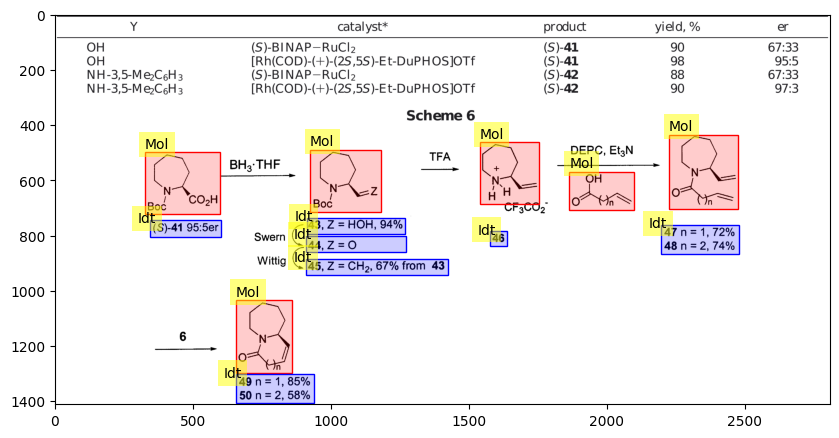

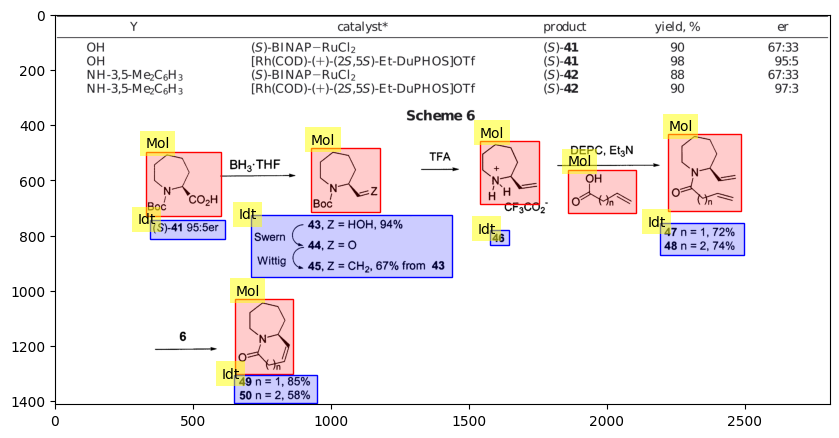

50
the prediction is
[{'category': '[Mol]', 'bbox': [0.15107553776888444, 0.020378610357810484, 0.26163081540770383, 0.08604302151075538], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.19759879939969985, 0.10189305178905242, 0.21810905452726362, 0.12000737210710619], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.18209104552276137, 0.1647271003923014, 0.2836418209104552, 0.22586293146573286], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.22461230615307654, 0.2394486717042732, 0.24412206103051526, 0.25756299202232696], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.30115057528764383, 0.013585740238540322, 0.4137068534267134, 0.09736447170953898], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.33516758379189593, 0.10189305178905242, 0.35567783891945975, 0.12000737210710619], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3186593296648324, 0.1596324478028488, 0.4227113

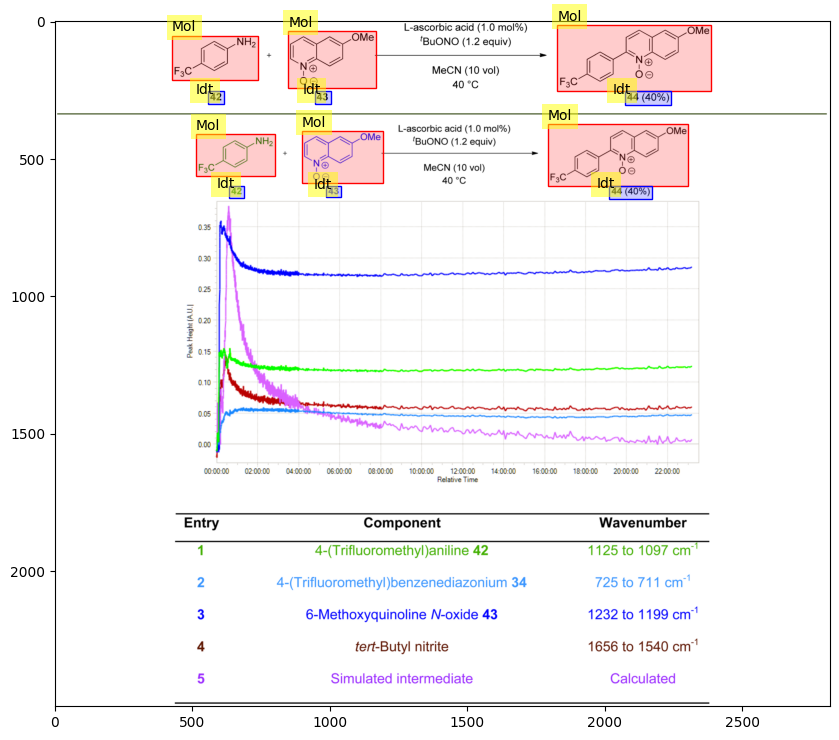

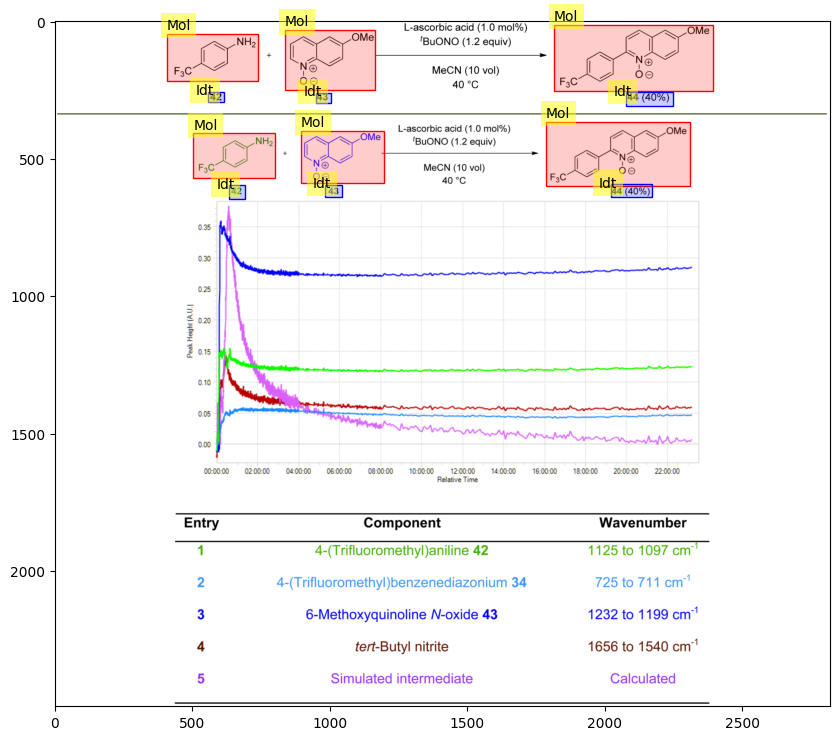

51
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.4177088544272136, 0.7414207938693888], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.18209104552276137, 0.7759313713618078, 0.2066033016508254, 0.8338200819942526], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3741870935467734, 0.23378133140025772, 0.5127563781890946, 0.38740906346328424], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5327663831915957, 0.0, 1.0, 0.797083015631355], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7698849424712356, 0.7737048824913291, 0.7943971985992997, 0.8338200819942526], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9731, 'image_id': 1238, 'category_id': 1, 'segmentation': [], 'area': 207542.19999999998, 'bbox': [0.0, 1.0, 461.0, 450.2], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9732, 'image_id': 1238, 'category_id': 3, 'segmentation': [

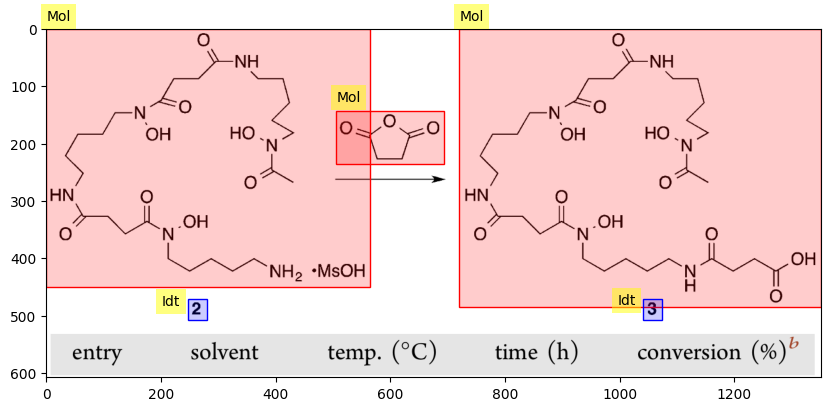

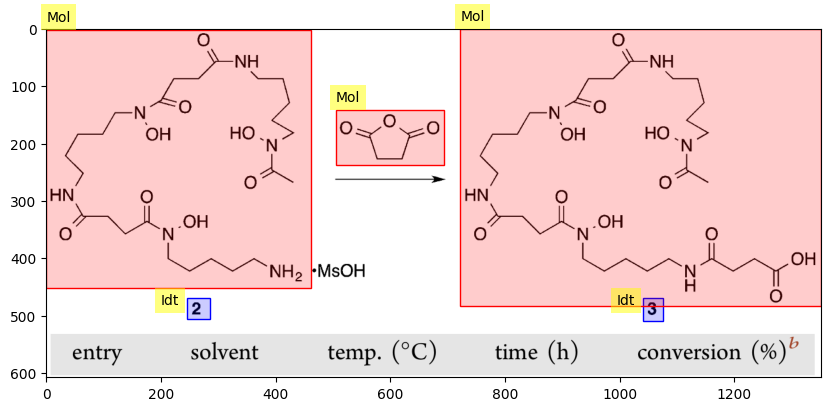

52
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0010887076191156803, 0.009504752376188095], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.7568784392196098, 0.004354830476462721, 0.9469734867433717], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.7858929464732366, 0.035382997621259606, 0.8244122061030515], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0027217690477892007, 0.009504752376188095], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0021774152382313607, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0021774152382313607, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0021774152382313607, 0.0010005002501250625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0021774152382313607, 0.0010005002501250625], 'category_id': 1

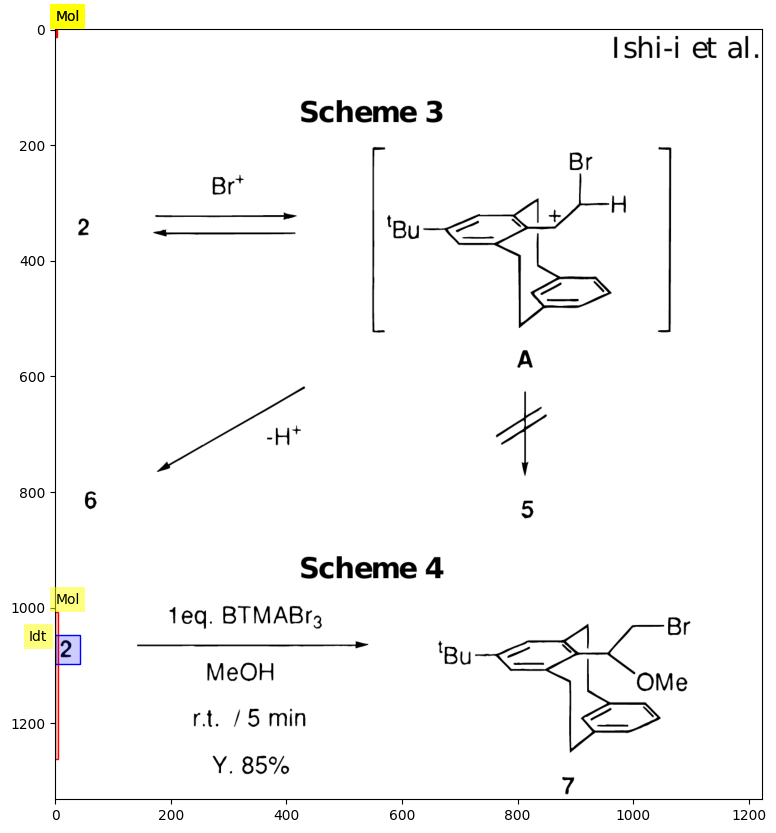

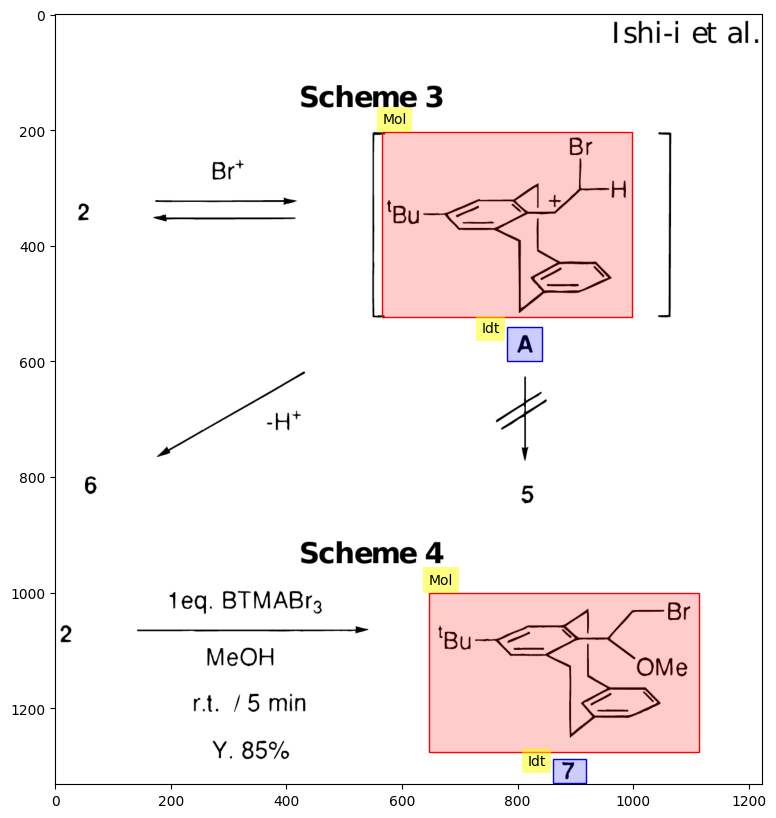

53
the prediction is
[{'category': '[Mol]', 'bbox': [0.02183085590414255, 0.0750375187593797, 0.2748703220657948, 0.16708354177088544], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12900051216084232, 0.1520760380190095, 0.1746468472331404, 0.17158579289644824], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3016627361299698, 0.07053526763381691, 0.459440285619, 0.16108054027013508], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.32746283856213826, 0.16558279139569784, 0.4435632995068964, 0.18659329664832416], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5418021510755378, 0.002001000500250125, 0.9754423342623693, 0.10055027513756878], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6400410026441792, 0.08604302151075538, 0.7065258819886133, 0.1040520260130065], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5447790859715572, 0.1055527763881941, 0.9744500226303628, 0.

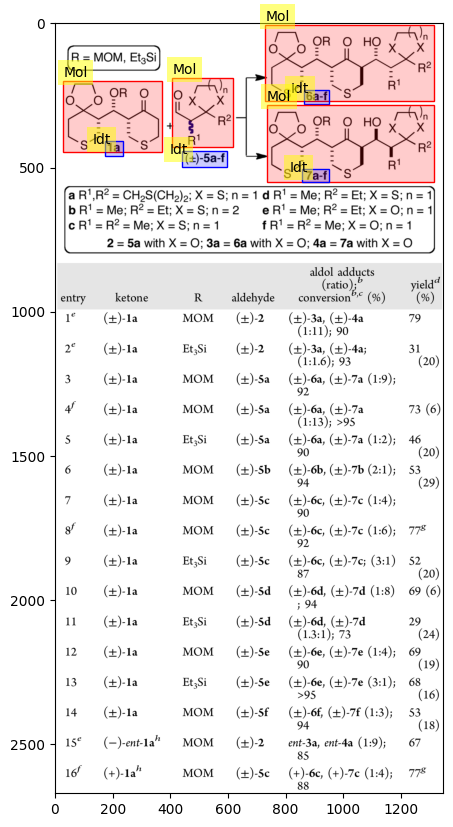

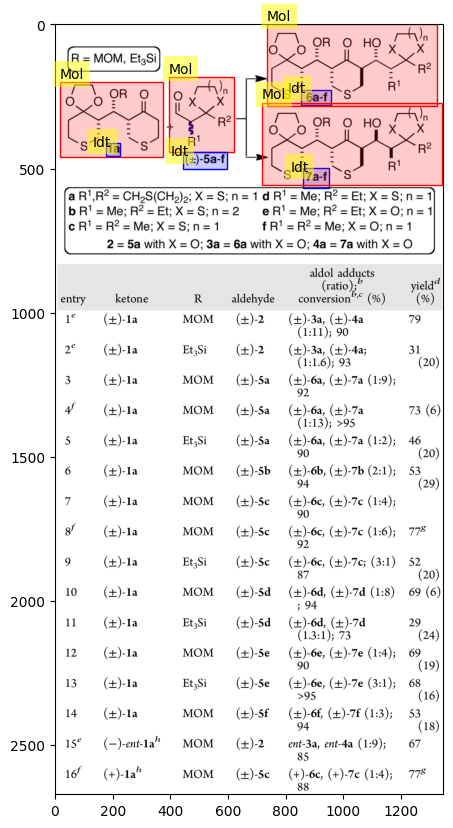

54
the prediction is
[{'category': '[Mol]', 'bbox': [0.07776661517168135, 0.37868934467233617, 0.19166102794280518, 0.4562281140570285], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.09062566177487273, 0.5117558779389695, 0.17880198133961378, 0.5647823911955978], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.12185477495405186, 0.3051525762881441, 0.18431300131241013, 0.3426713356678339], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.20758175230866122, 0.10005002501250625, 0.3031060985037974, 0.176088044022011], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.20758175230866122, 0.22861430715357678, 0.3031060985037974, 0.3046523261630815], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3012690918461986, 0.032016008004002, 0.3625026470994909, 0.06953476738369184], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3184144873171204, 0.3796898449224612, 0.4304718934306455, 0

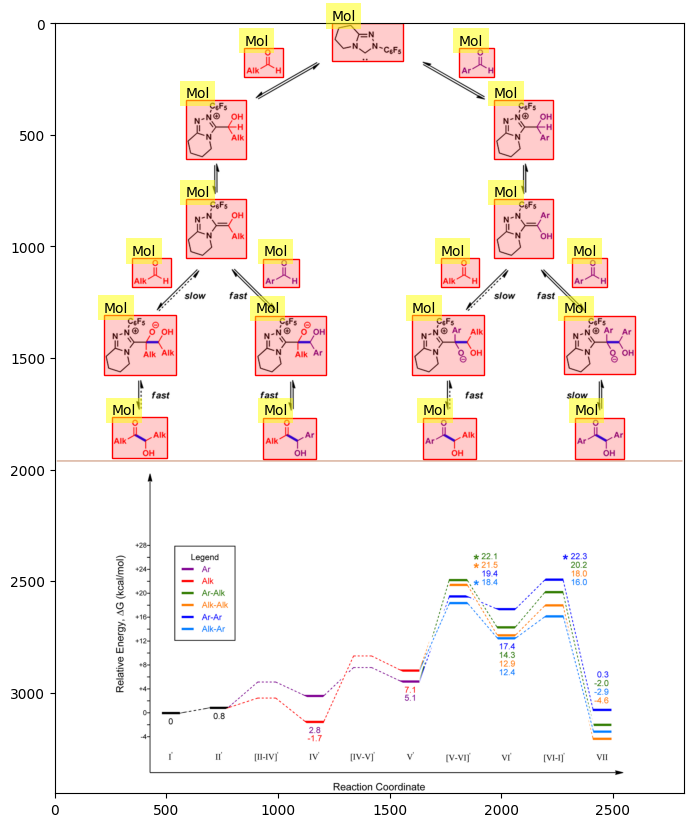

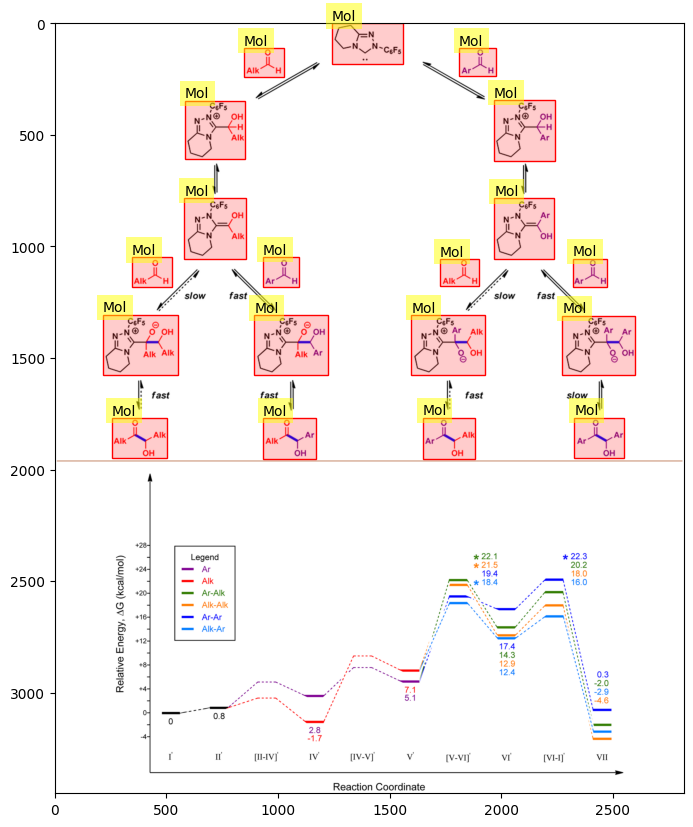

55
the prediction is
[{'category': '[Mol]', 'bbox': [0.06803401700850426, 0.6388721679772542, 0.22011005502751377, 0.7735945482270996], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2336168084042021, 0.6642914850055269, 0.4112056028014007, 0.7541064051720905], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5372686343171585, 0.05676980802980907, 0.8164082041020511, 0.5456680055402543], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6873436718359179, 0.6320936834363815, 0.9259629814907454, 0.767663374253836], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7233616808404202, 0.8134181449047269, 0.8904452226113057, 0.8701879529345359], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9767, 'image_id': 1242, 'category_id': 1, 'segmentation': [], 'area': 30965.209600000002, 'bbox': [929.82, 506.46, 314.24, 98.54], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}},

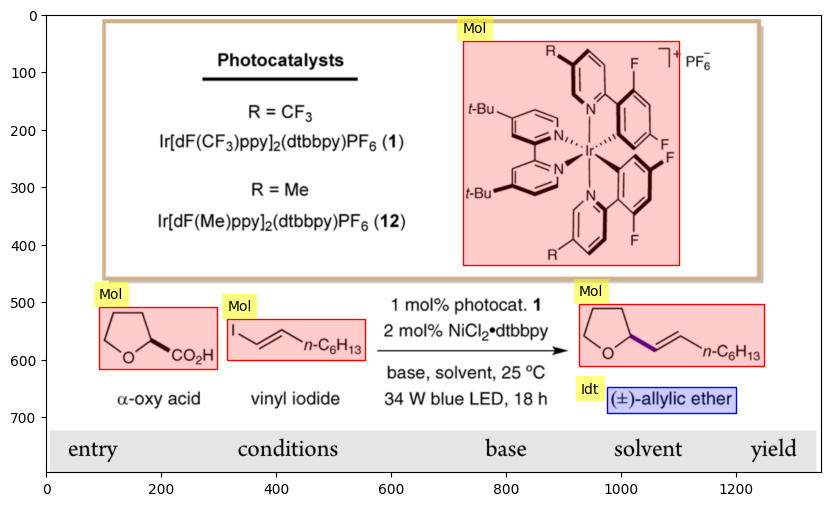

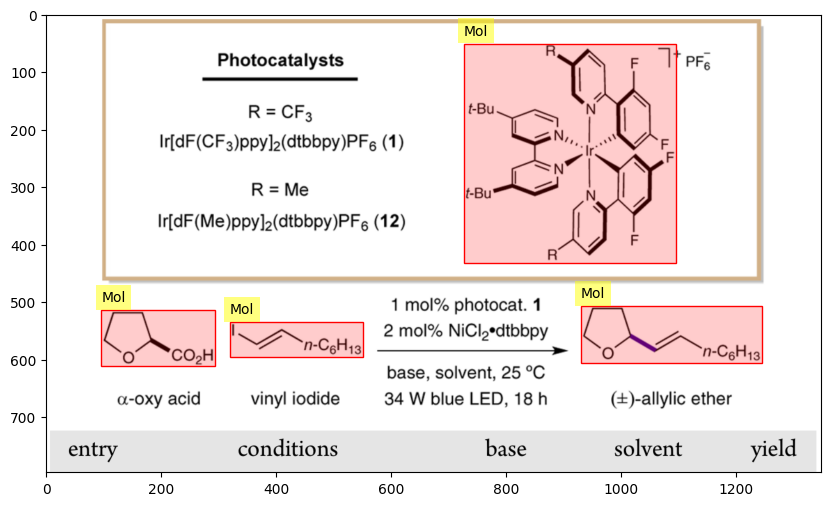

56
the prediction is
[{'category': '[Mol]', 'bbox': [0.09354677338669334, 0.06123980357525702, 0.22111055527763882, 0.39465651192943413], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14107053526763383, 0.41506977978785314, 0.17658829414707353, 0.5052283794958704], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3031515757878939, 0.015309950893814255, 0.41520760380190097, 0.36913992710641036], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3266633316658329, 0.41506977978785314, 0.3611805902951476, 0.5086305908056069], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.742871435717859, 0.06123980357525702, 0.904952476238119, 0.41847199109758965], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7958979489744873, 0.48311400598258314, 0.8314157078539269, 0.5800770283100735], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9771, 'image_id': 1243, 'category_id': 1

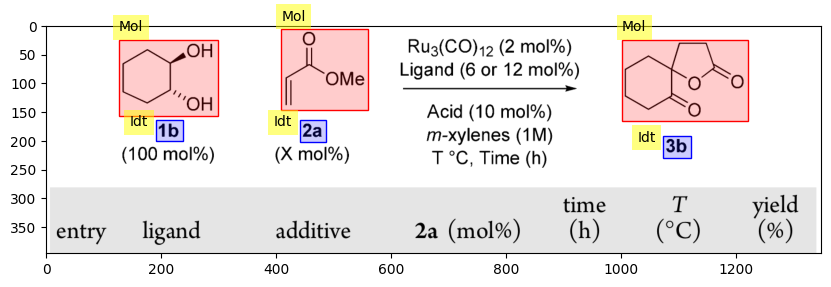

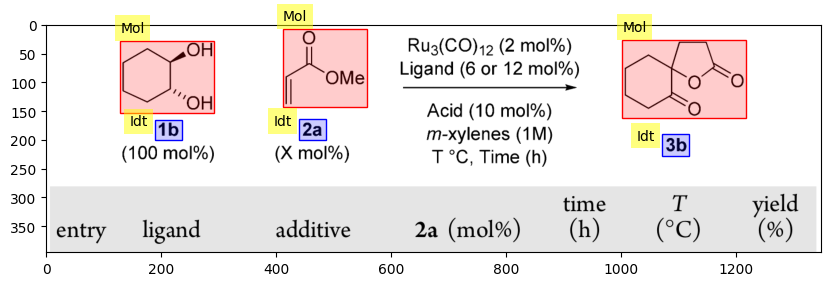

57
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.002318076767236457, 0.20710355177588793, 0.30753151778670335], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.06603301650825413, 0.3098495945539398, 0.1055527763881941, 0.3538930531314325], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.17408704352176088, 0.11358576159458642, 0.38319159579789897, 0.24726152183855543], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2511255627813907, 0.26271536695346515, 0.28864432216108055, 0.3090769022981943], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6718359179589795, 0.031680382485564915, 1.0, 0.3044407487637214], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.80040020010005, 0.30753151778670335, 0.8404202101050525, 0.3538930531314325], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9777, 'image_id': 1244, 'category_id': 1, 'segmentatio

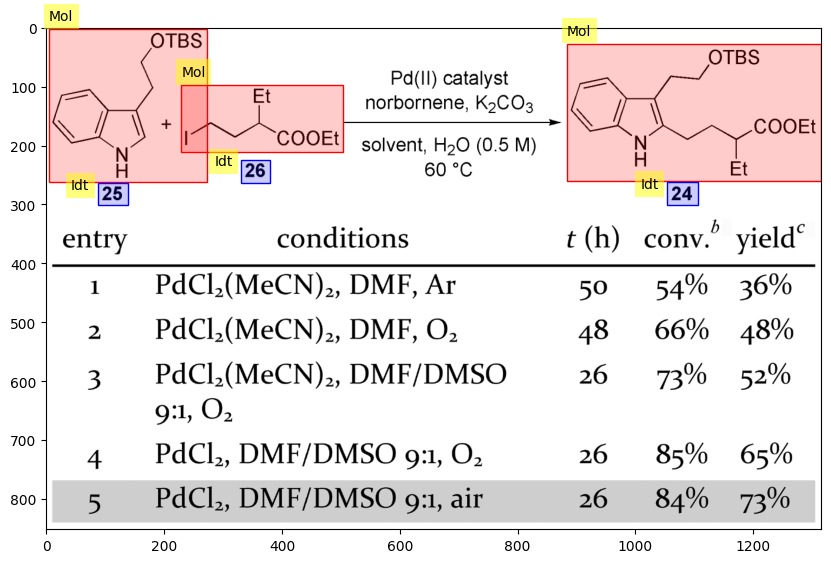

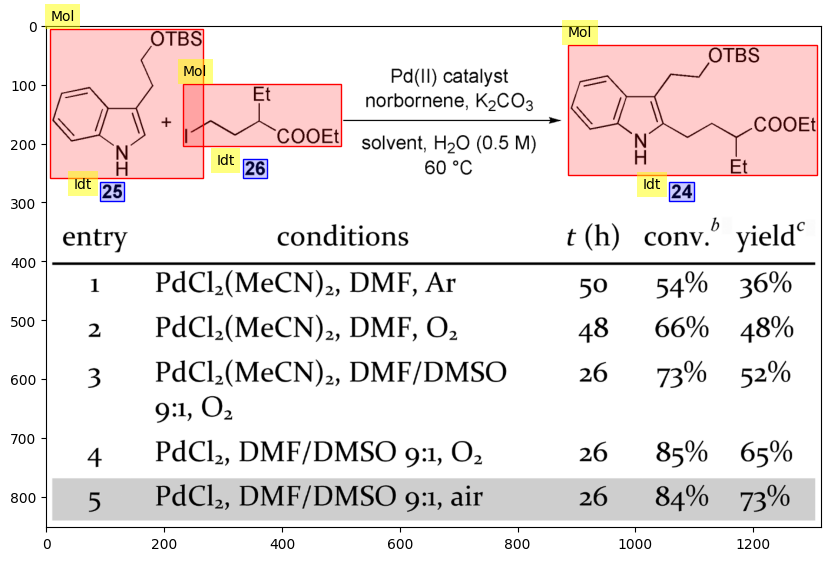

58
the prediction is
[{'category': '[Mol]', 'bbox': [0.007503751875937969, 0.06853263499612776, 0.08404202101050526, 0.23605685387555117], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.10705352676338169, 0.05983007817122265, 0.2366183091545773, 0.23605685387555117], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.8184092046023012, 0.0, 0.9939969984992496, 0.28718437522186874], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9783, 'image_id': 1245, 'category_id': 1, 'segmentation': [], 'area': 38586.263999999996, 'bbox': [1105.08, 5.53, 228.7, 168.72], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9784, 'image_id': 1245, 'category_id': 1, 'segmentation': [], 'area': 8742.25, 'bbox': [15.29, 47.21, 93.5, 93.5], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9785, 'image_id': 1245, 'category_id': 1, 'segmentation': [], 'area': 15964.7184, 'bbox': [148.46, 42.13

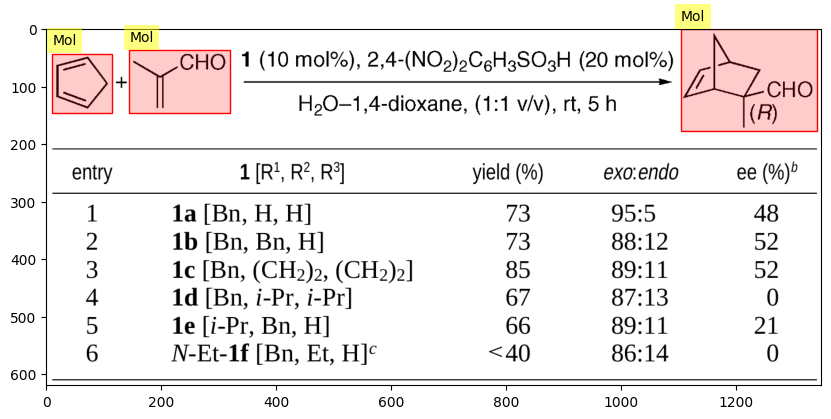

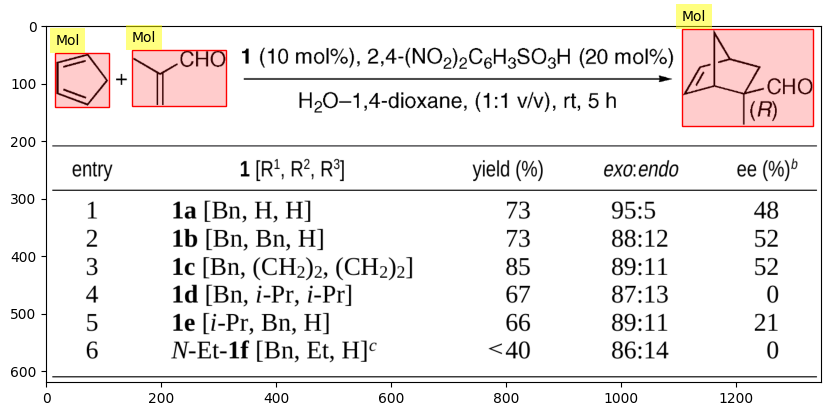

59
the prediction is
[{'category': '[Mol]', 'bbox': [0.26113056528264134, 0.030082710528196426, 0.32516258129064535, 0.20389392691333136], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.42471235617808906, 0.015041355264098213, 0.5387693846923461, 0.19553761843327677], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.47423711855927964, 0.22394906726546232, 0.4852426213106553, 0.26907313305775693], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.624312156078039, 0.015041355264098213, 0.7383691845922962, 0.2406616842255714], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6753376688344173, 0.24734673100961505, 0.6853426713356678, 0.287457011713877], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9786, 'image_id': 1246, 'category_id': 1, 'segmentation': [], 'area': 67859.0, 'bbox': [1758.0, 7.0, 341.0, 199.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'i

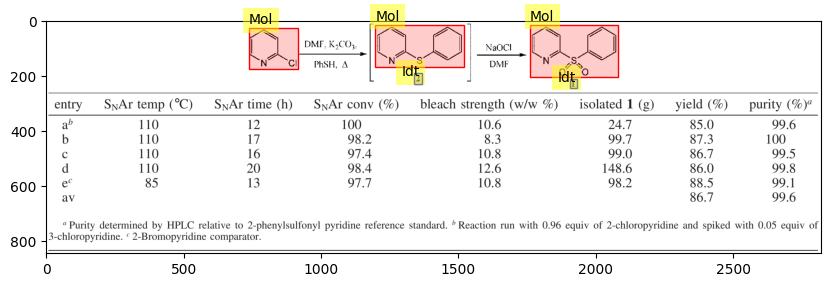

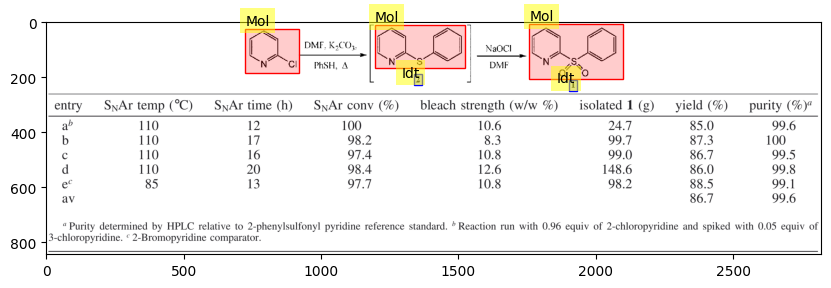

60
the prediction is
[{'category': '[Mol]', 'bbox': [0.004502251125562781, 0.003624094656023664, 0.2016008004002001, 0.40469056992264246], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.263631815907954, 0.5327419144354786, 0.5162581290645323, 0.938640515910129], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7538769384692346, 0.5327419144354786, 0.9964982491245623, 0.938640515910129], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9791, 'image_id': 1247, 'category_id': 1, 'segmentation': [], 'area': 72800.0, 'bbox': [1021.0, 302.0, 325.0, 224.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9792, 'image_id': 1247, 'category_id': 1, 'segmentation': [], 'area': 76840.0, 'bbox': [355.0, 302.0, 340.0, 226.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9793, 'image_id': 1247, 'category_id': 1, 'segmentation': [], 'area': 60480.0, 'bbox': [6.0, 4.0, 270.0, 2

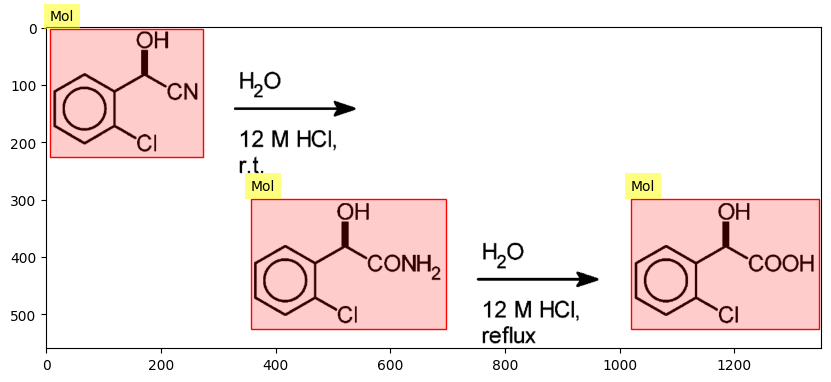

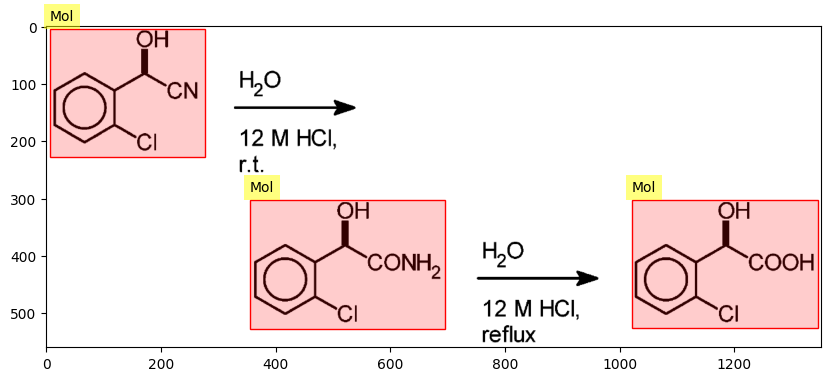

61
the prediction is
[{'category': '[Mol]', 'bbox': [0.06335244017699349, 0.0050025012506253125, 0.3363557390840376, 0.1520760380190095], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1567483055925612, 0.12056028014007003, 0.1802605514314454, 0.144072036018009], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6864269549074243, 0.0030015007503751876, 0.9431023053152433, 0.16008004002001], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7497793950844178, 0.11555777888944473, 0.779169702383023, 0.14307153576788395], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9794, 'image_id': 1248, 'category_id': 3, 'segmentation': [], 'area': 3737.1711999999998, 'bbox': [196.58, 205.78, 66.64, 56.08], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9795, 'image_id': 1248, 'category_id': 1, 'segmentation': [], 'area': 98692.8, 'bbox': [925.5, 0.0, 348.0, 283.6], 'iscrowd': 0, 'attri

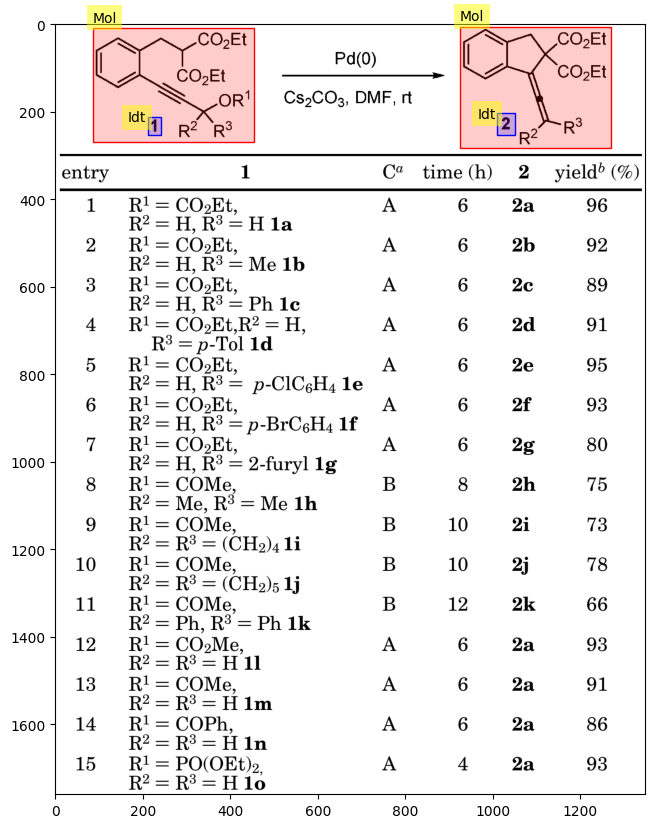

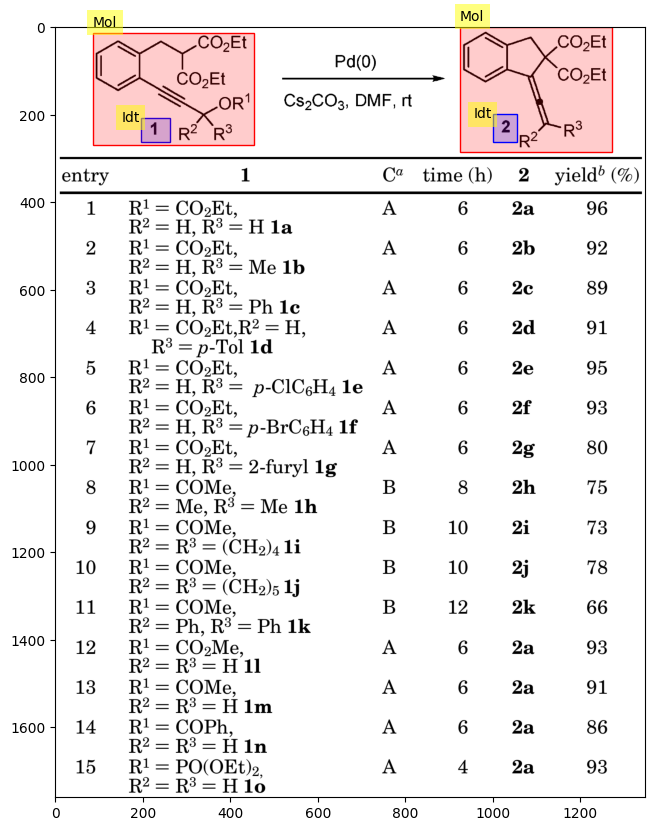

62
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.0008024469515142648], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.0016048939030285296], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.0016048939030285296], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.0010005002501250625, 0.003209787806057059], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.0024073408545427946], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.003209787806057059], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.002001000500250125, 0.003209787806057059], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.0, 0.0, 0.0030015007503751876, 0.003209787806057059], 'category_id': 3, 'score': 2010}, {'categ

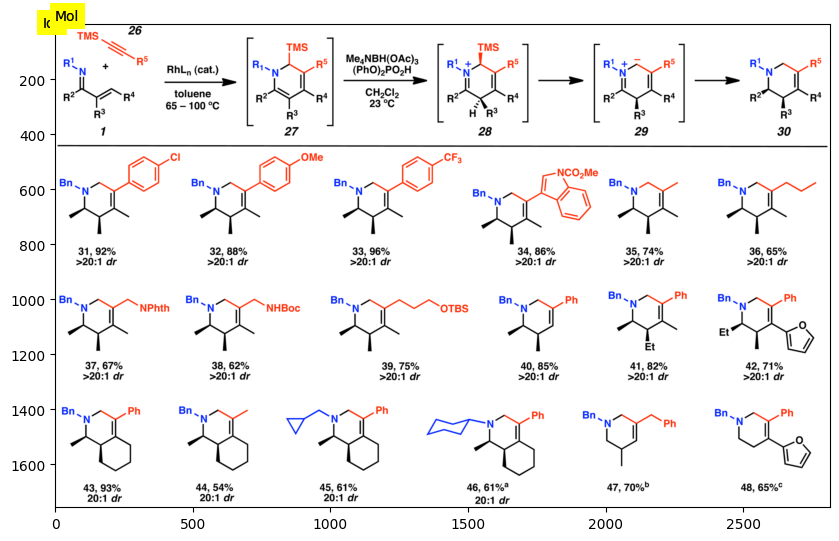

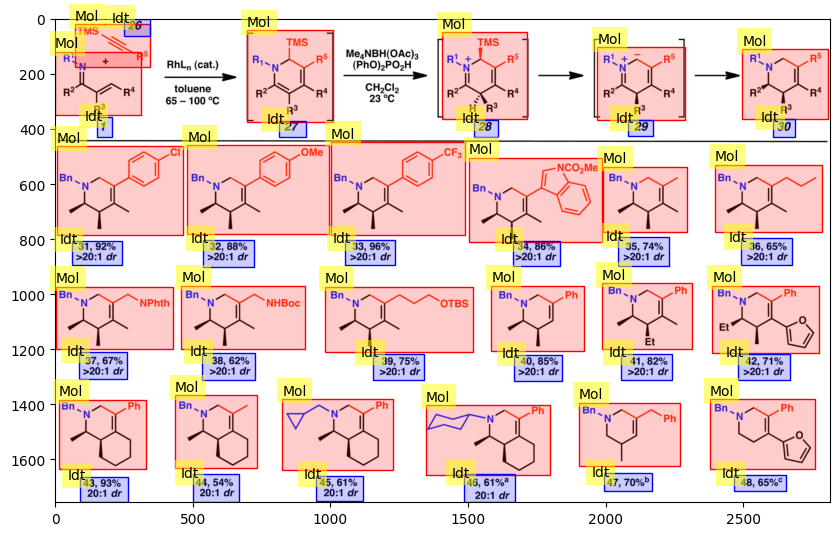

63
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.03471004771655097, 0.15607803901950976, 0.17355023858275484], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.05302651325662831, 0.18556525510002247, 0.07653826913456728, 0.22428030832232937], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.057528764382191094, 0.3163954349547146, 0.37318659329664833, 0.8163536222565738], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0750375187593797, 0.7722985616932592, 0.13906953476738368, 0.8223611305152077], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.22611305652826413, 0.004672506423381862, 0.40570285142571283, 0.18156024959426662], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.28864432216108055, 0.18089274867664065, 0.3856928464232116, 0.22161030465182543], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5887943971985993, 0.31839793770759256, 0.9394697348674337, 0.7462

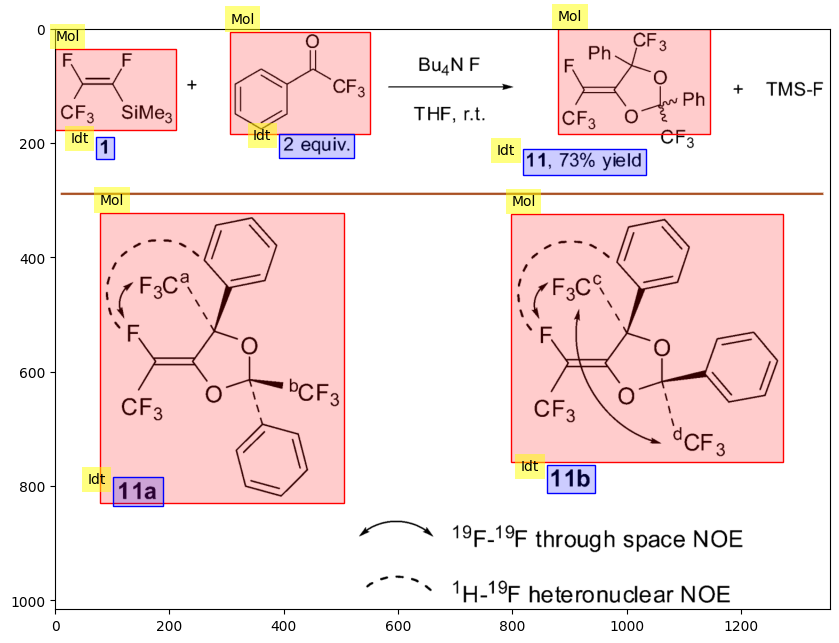

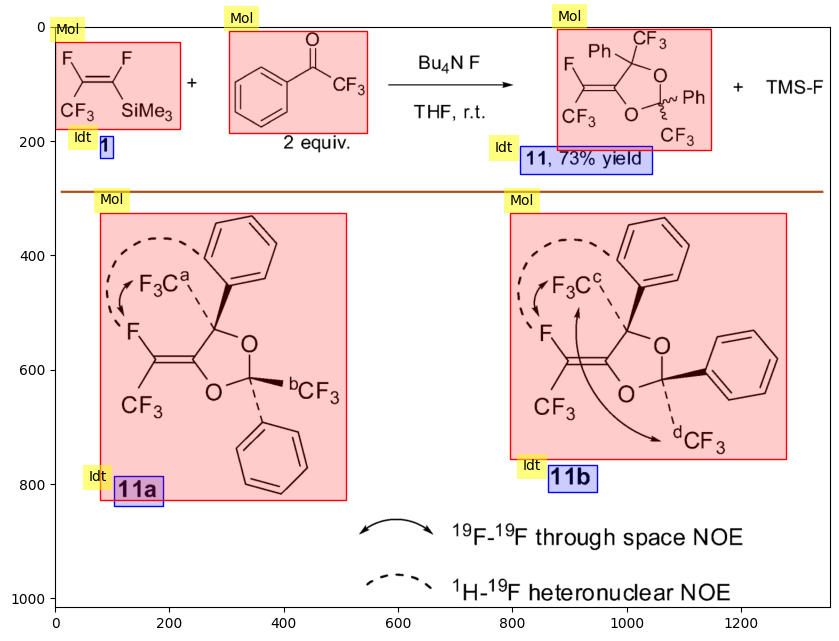

64
the prediction is
[{'category': '[Mol]', 'bbox': [0.12056028014007003, 0.0, 0.35317658829414705, 0.18516535053240907], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2031015507753877, 0.19290538126205958, 0.272136068034017, 0.23398708282712785], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6498249124562281, 0.0, 0.8769384692346173, 0.18754689844922462], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7303651825912957, 0.1940961552204674, 0.7998999499749875, 0.23279630886872008], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9855, 'image_id': 1251, 'category_id': 3, 'segmentation': [], 'area': 4606.0, 'bbox': [986.0, 221.0, 98.0, 47.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9856, 'image_id': 1251, 'category_id': 3, 'segmentation': [], 'area': 4185.0, 'bbox': [277.0, 223.0, 93.0, 45.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, 

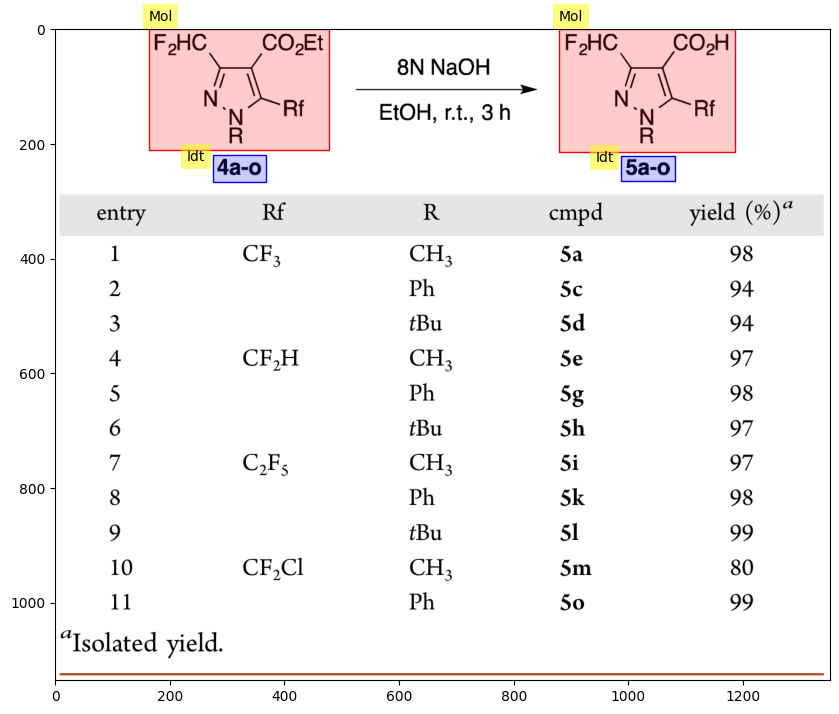

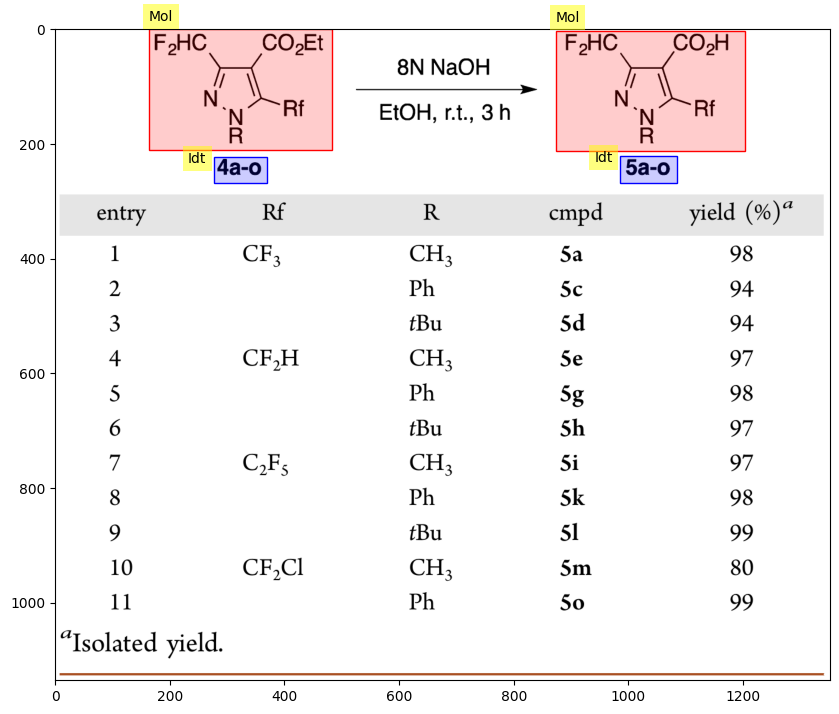

65
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.3026513256628314, 0.34001399482085026], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.10905452726363181, 0.36132830494394835, 0.14057028514257128, 0.4344059396517132], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.544272136068034, 0.0, 0.8999499749874937, 0.3410289619695693], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6938469234617308, 0.3582834034977915, 0.7273636818409205, 0.4313610382055563], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9859, 'image_id': 1252, 'category_id': 1, 'segmentation': [], 'area': 89352.0, 'bbox': [3.0, 2.0, 408.0, 219.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9860, 'image_id': 1252, 'category_id': 1, 'segmentation': [], 'area': 106646.96, 'bbox': [736.5, 3.1, 485.2, 219.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9861, 'im

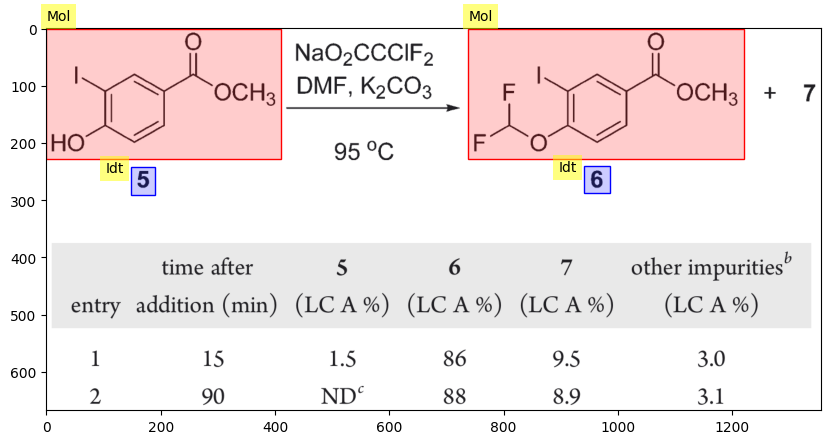

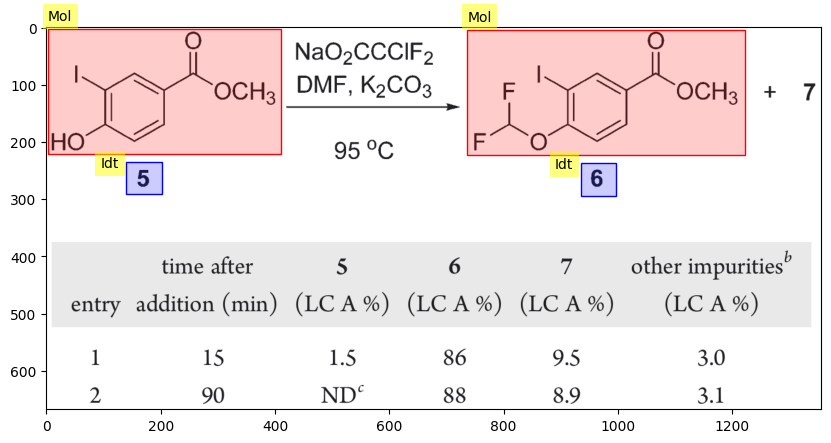

66
the prediction is
[{'category': '[Mol]', 'bbox': [0.062031015507753876, 0.11486125838038636, 0.28714357178589295, 0.29512962222738165], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11105552776388194, 0.26800960288756814, 0.16508254127063532, 0.3121461049504018], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6823411705852926, 0.13187774110340655, 0.9394697348674337, 0.3121461049504018], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.720360180090045, 0.26800960288756814, 0.7743871935967984, 0.3121461049504018], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9863, 'image_id': 1253, 'category_id': 1, 'segmentation': [], 'area': 80804.40000000001, 'bbox': [922.6, 167.2, 346.8, 233.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9864, 'image_id': 1253, 'category_id': 1, 'segmentation': [], 'area': 74511.36, 'bbox': [81.7, 141.5, 313.6, 237.6], 'iscrowd': 0, 'att

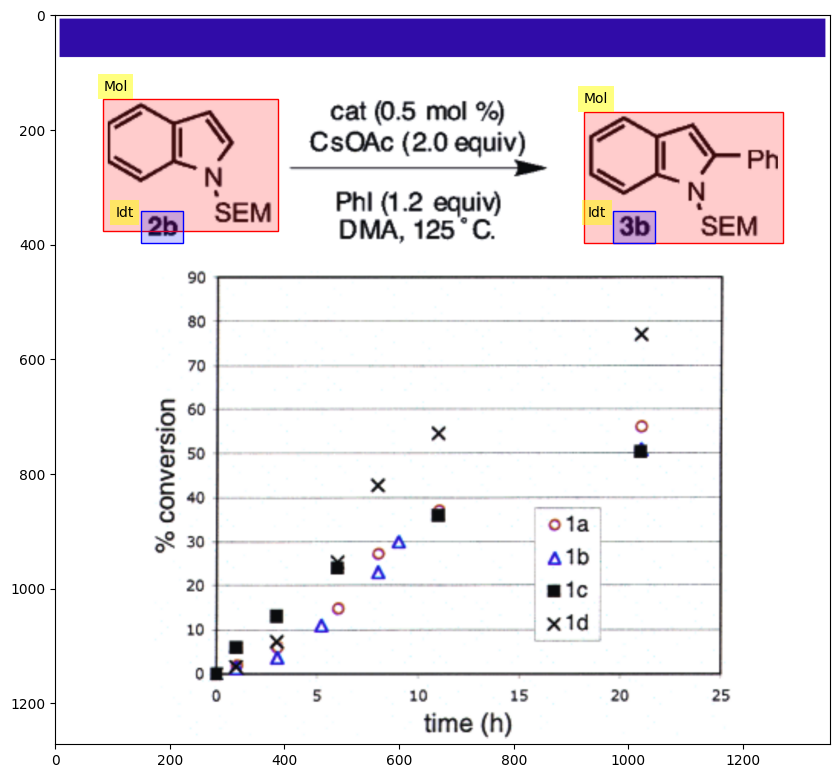

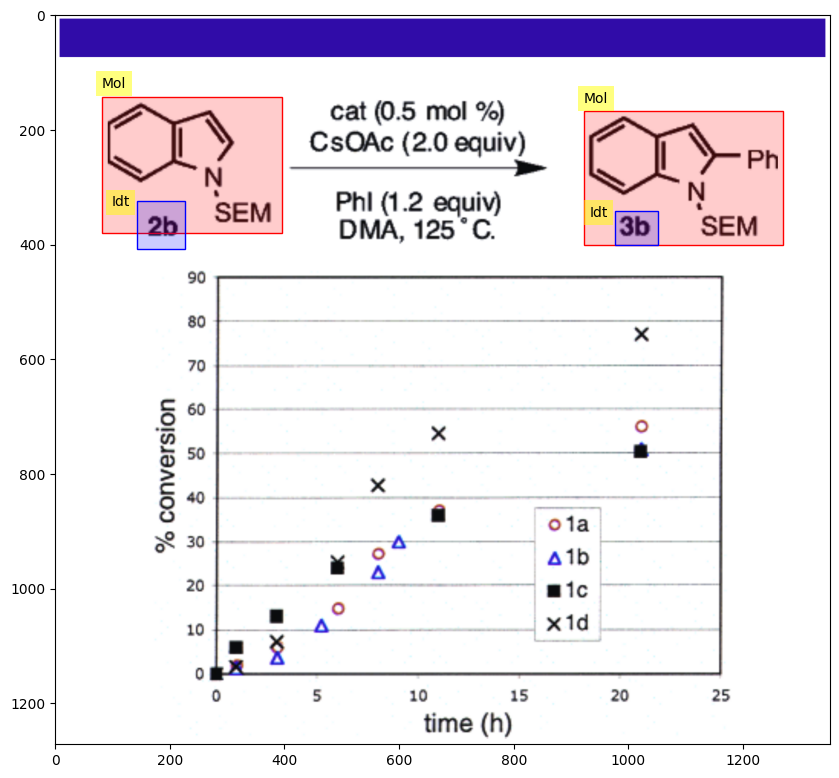

67
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.01533878319304931, 0.14607303651825912, 0.19375305085957023], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.054527263631815905, 0.2026333990239672, 0.07653826913456728, 0.25107166173885975], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.17408704352176088, 0.0605478283936157, 0.3291645822911456, 0.22120139973134267], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.20260130065032517, 0.23815479168155507, 0.24212106053026514, 0.2906295762893553], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5502751375687844, 0.005651130650070798, 0.7748874437218609, 0.20828452967403802], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6518259129564783, 0.23573287854581043, 0.6763381690845423, 0.28659305439644767], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7693846923461731, 0.009687652542978513, 1.0, 0.263

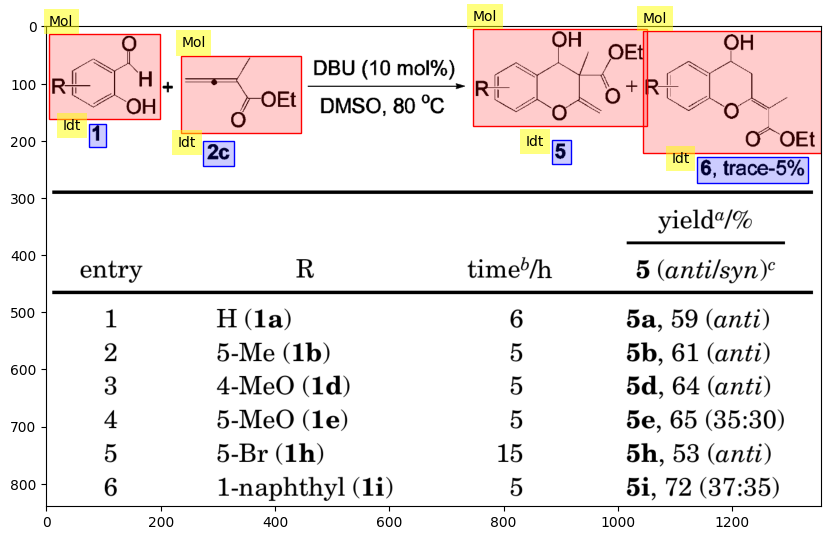

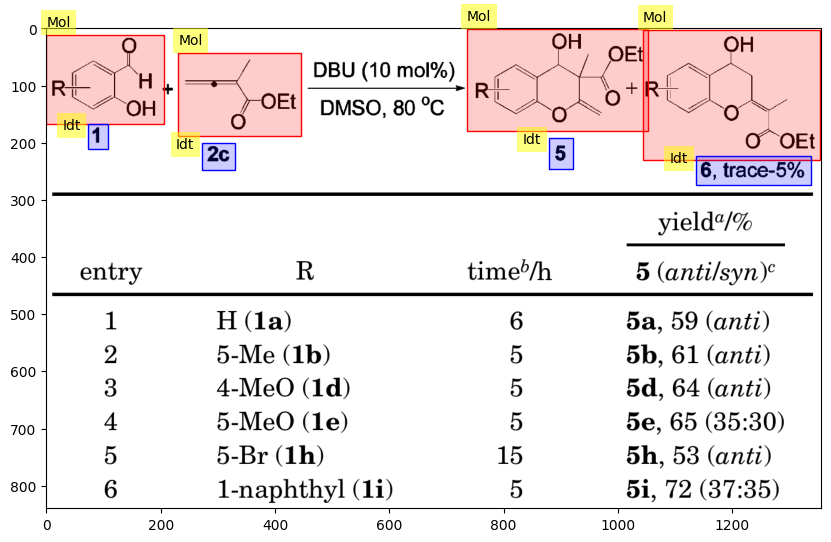

68
the prediction is
[{'category': '[Mol]', 'bbox': [0.06303151575787894, 0.053483226254765606, 0.15257628814407204, 0.1496392394149293], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.06453226613306653, 0.1524840918752892, 0.15157578789394696, 0.23953657716230126], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.06603301650825413, 0.3004164198140026, 0.21860930465232617, 0.44550389529235607], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.08254127063531766, 0.6167640134060205, 0.32216108054027015, 0.9388013119187579], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13906953476738368, 0.959853220125421, 0.2351175587793897, 0.9939914496497394], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.20410205102551277, 0.047793521334045866, 0.4047023511755878, 0.2571746624165325], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2381190595297649, 0.2617264263531083, 0.35417708854427

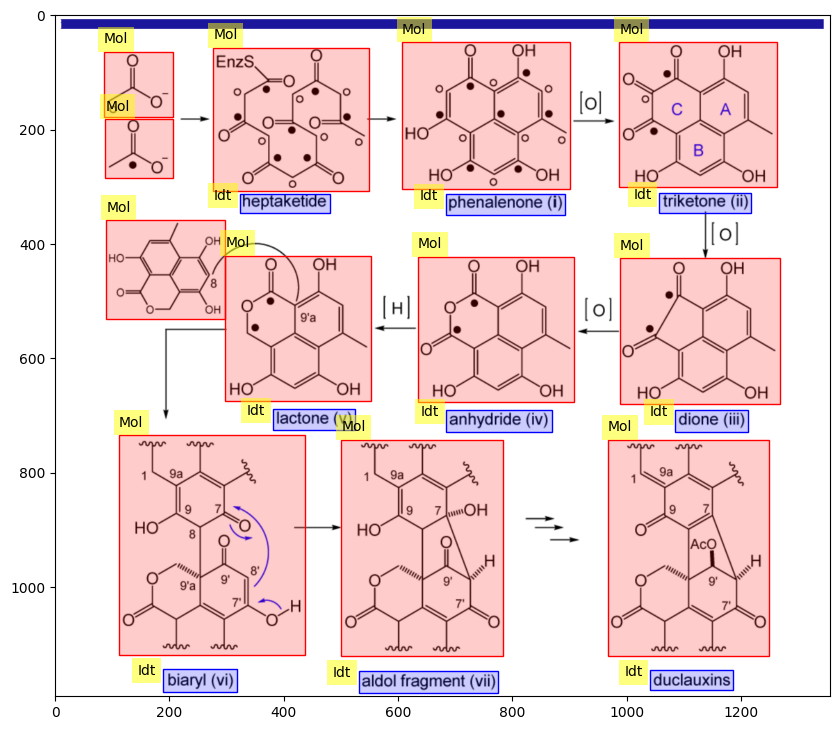

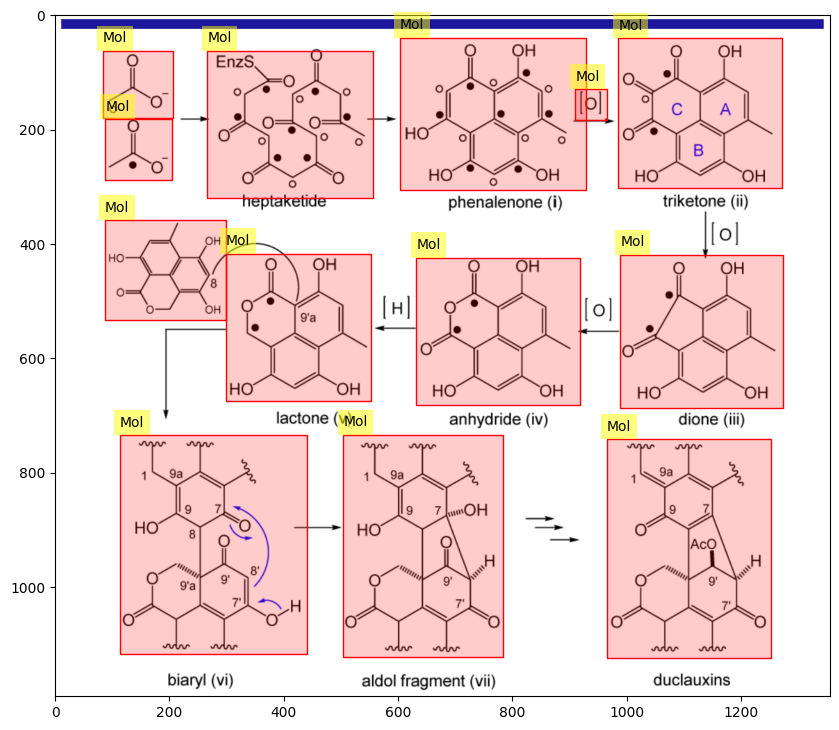

69
the prediction is
[{'category': '[Mol]', 'bbox': [0.2096048024012006, 0.01875468984492246, 0.3711855927963982, 0.6001500750375187], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.22761380690345173, 0.5688922586293147, 0.26863431715857927, 0.7022589419709855], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5887943971985993, 0.014586980990495248, 0.7913956978489245, 0.5480537143571785], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6448224112056028, 0.5647245497748875, 0.6848424212106053, 0.700175087543772], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9888, 'image_id': 1256, 'category_id': 1, 'segmentation': [], 'area': 42259.119999999995, 'bbox': [283.4, 5.3, 221.6, 190.7], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9889, 'image_id': 1256, 'category_id': 3, 'segmentation': [], 'area': 2268.0, 'bbox': [311.0, 178.6, 45.0, 50.4], 'iscrowd': 0, 'attributes':

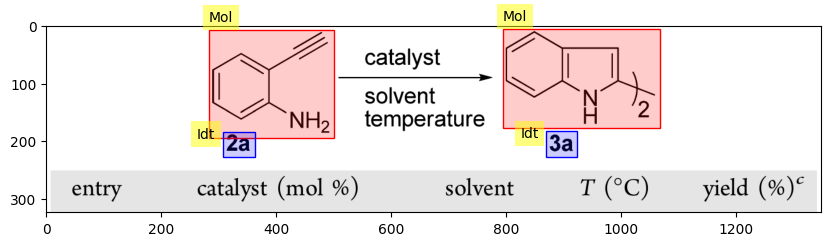

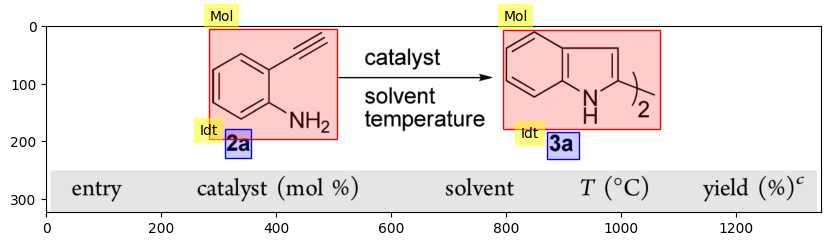

70
the prediction is
[{'category': '[Mol]', 'bbox': [0.018009004502251125, 0.1012057462120605, 0.2591295647823912, 0.39470241022703595], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1055527763881941, 0.40144945997450665, 0.17008504252126064, 0.47904053207041974], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.352176088044022, 0.18329485147295402, 0.5012506253126563, 0.36434068636341777], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7398699349674838, 0.007871558038715818, 0.9819909954977488, 0.40707200143073224], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8289144572286143, 0.40594749313948714, 0.8929464732366184, 0.47566700719668437], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9892, 'image_id': 1257, 'category_id': 3, 'segmentation': [], 'area': 3483.0, 'bbox': [1119.58, 242.83, 81.0, 43.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'i

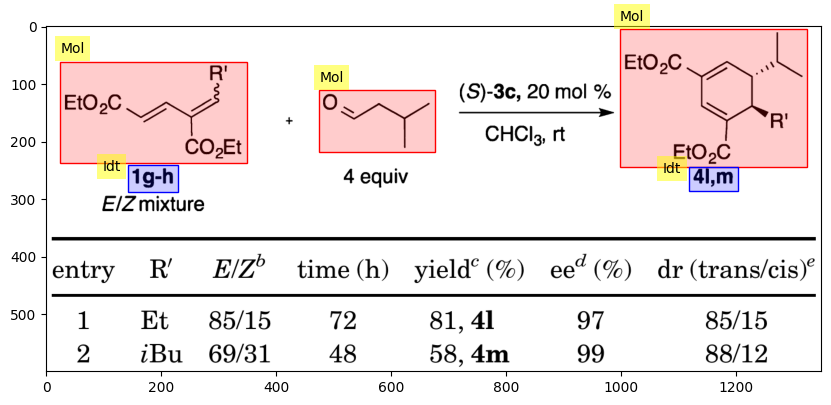

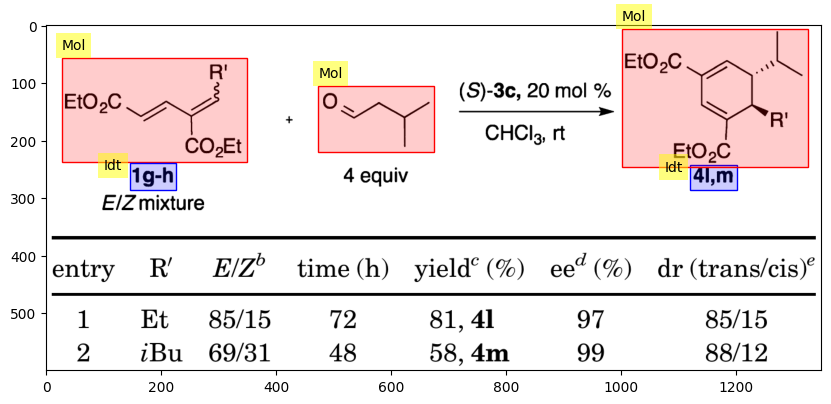

71
the prediction is
[{'category': '[Mol]', 'bbox': [0.032016008004002, 0.3428530302887292, 0.19309654827413708, 0.48754329995186263], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.09854927463731866, 0.6998605434792867, 0.2941470735367684, 0.9286913503921772], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.41670835417708857, 0.28308965803656544, 0.6118059029514757, 0.5134931852718811], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4612306153076538, 0.6739106581592683, 0.6443221610805403, 0.9129641471679235], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7728864432216108, 0.29095325964869223, 0.9684842421210605, 0.5260749478512842], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9897, 'image_id': 1258, 'category_id': 1, 'segmentation': [], 'area': 28519.760000000002, 'bbox': [175.9, 598.2, 220.4, 129.4], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}},

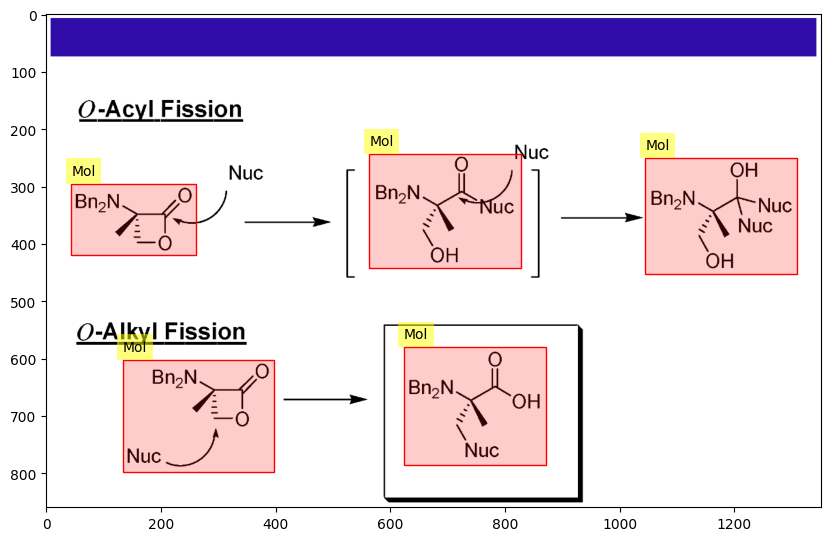

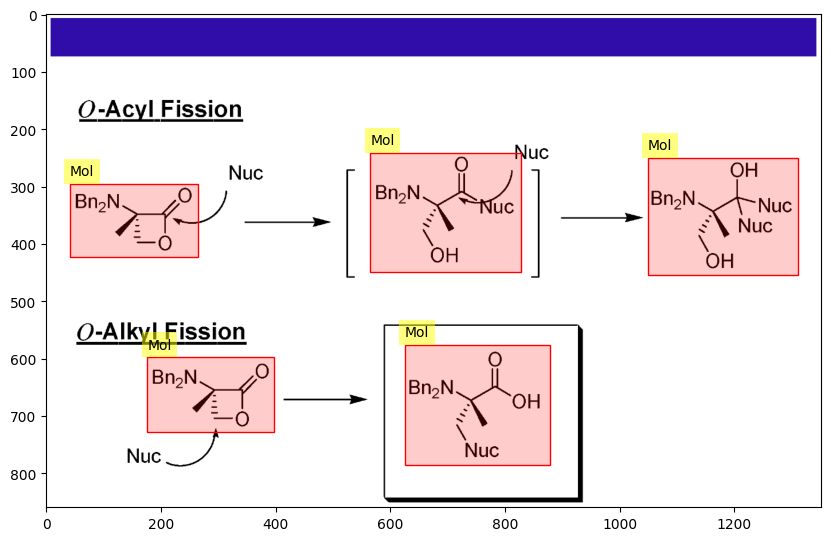

72
the prediction is
[{'category': '[Mol]', 'bbox': [0.015007503751875938, 0.010755377688844422, 0.21160580290145073, 0.45889611472402864], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.025512756378189096, 0.5055027513756879, 0.10605302651325663, 0.620226780056695], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5957978989494748, 0.0967983991995998, 0.7883941970985493, 0.449933299983325], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6198099049524762, 0.5019176254794063, 0.7013506753376688, 0.6184342171085543], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9902, 'image_id': 1259, 'category_id': 3, 'segmentation': [], 'area': 4644.0, 'bbox': [837.0, 187.0, 108.0, 43.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9903, 'image_id': 1259, 'category_id': 3, 'segmentation': [], 'area': 4212.0, 'bbox': [35.0, 191.0, 108.0, 39.0], 'iscrowd': 0, 'attributes': {'occlu

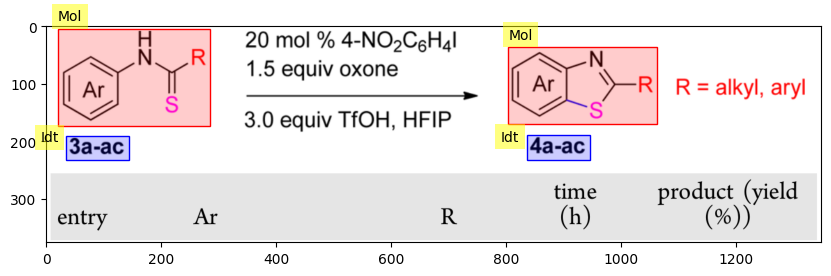

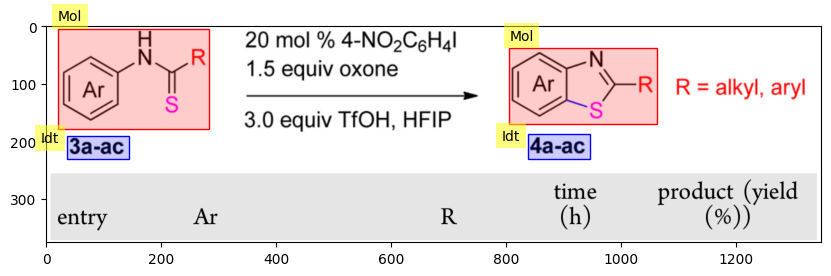

73
the prediction is
[{'category': '[Mol]', 'bbox': [0.24712356178089045, 0.09558704266809173, 0.43121560780390195, 0.6463504789937631], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.26013006503251623, 0.5257287346745044, 0.3186593296648324, 0.6759369445815058], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5842921460730365, 0.006827645904863695, 0.7548774387193596, 0.6372469511206115], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5967983991995998, 0.5052457969599133, 0.6573286643321661, 0.6645575347400662], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9906, 'image_id': 1260, 'category_id': 1, 'segmentation': [], 'area': 45579.200000000004, 'bbox': [781.0, 5.0, 244.0, 186.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9907, 'image_id': 1260, 'category_id': 3, 'segmentation': [], 'area': 4000.0, 'bbox': [351.0, 150.0, 80.0, 50.0], 'iscrowd': 0, 'attributes

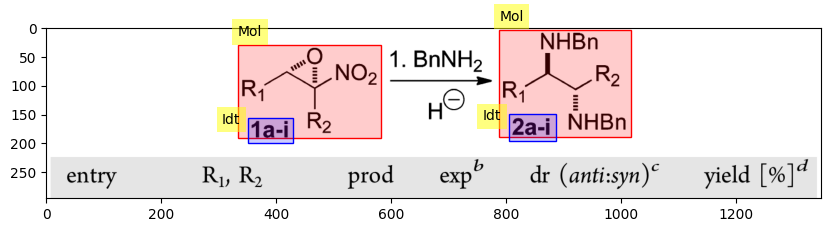

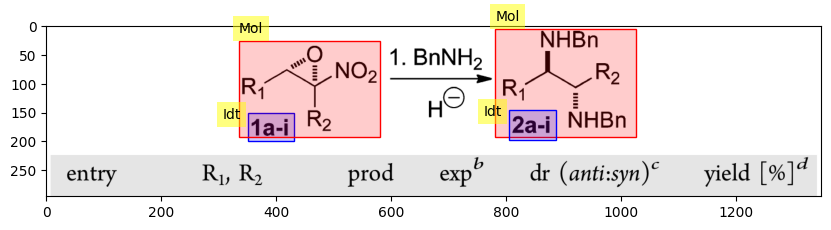

74
the prediction is
[{'category': '[Mol]', 'bbox': [0.04852426213106553, 0.7921857693099247, 0.33516758379189593, 0.9108595129614114], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11755877938969485, 0.9278129049116237, 0.3321660830415208, 0.9648021237120872], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.05102551275637819, 0.5645993258570734, 0.3261630815407704, 0.7146111576589528], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.10605302651325663, 0.7125562010589269, 0.2571285642821411, 0.748004202409371], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0560280140070035, 0.36372731820455684, 0.2816408204102051, 0.5019231495562881], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.10855427713856929, 0.5055193236063332, 0.2466233116558279, 0.5404535858067708], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.06803401700850426, 0.028255653250353993, 0.26313156578289143, 0

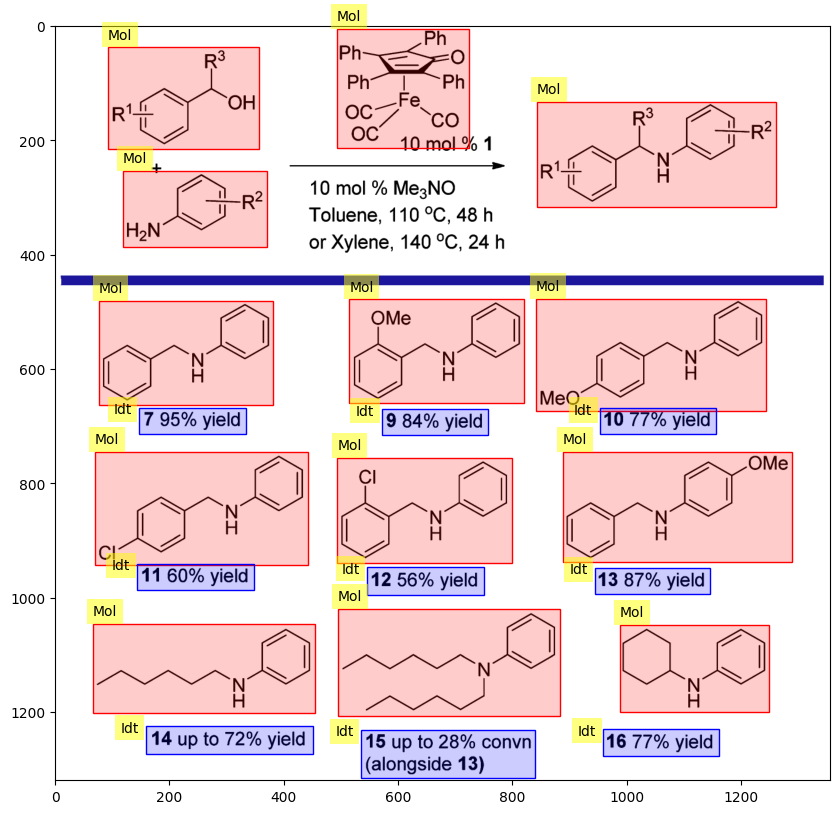

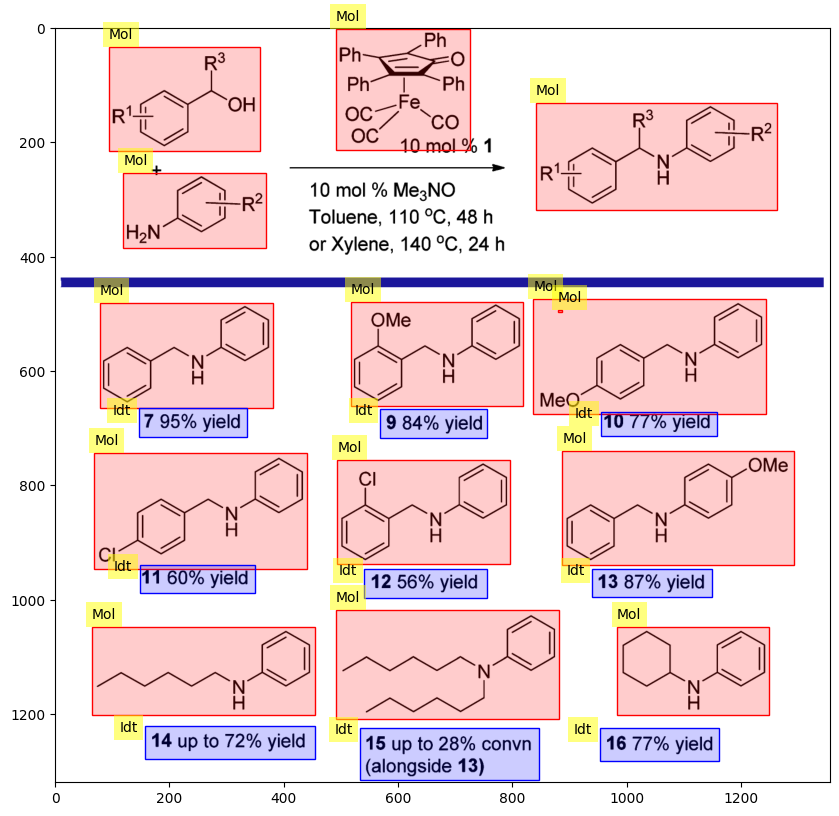

75
the prediction is
[{'category': '[Mol]', 'bbox': [0.7148574287143572, 0.7268925853655304, 1.0, 0.8205142306252463], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.83991995997999, 0.8505438149538345, 0.8754377188594297, 0.900887529857644], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7168584292146073, 0.0317960304655639, 0.9784892446223111, 0.12541767572527984], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.83991995997999, 0.1536808139168922, 0.8764382191095548, 0.20402452882070174], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 9933, 'image_id': 1262, 'category_id': 3, 'segmentation': [], 'area': 4623.92, 'bbox': [1617.0, 922.0, 71.8, 64.4], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9934, 'image_id': 1262, 'category_id': 1, 'segmentation': [], 'area': 52789.32000000001, 'bbox': [1384.6, 793.9, 543.1, 97.2], 'iscrowd': 0, 'attributes': {'occluded': False

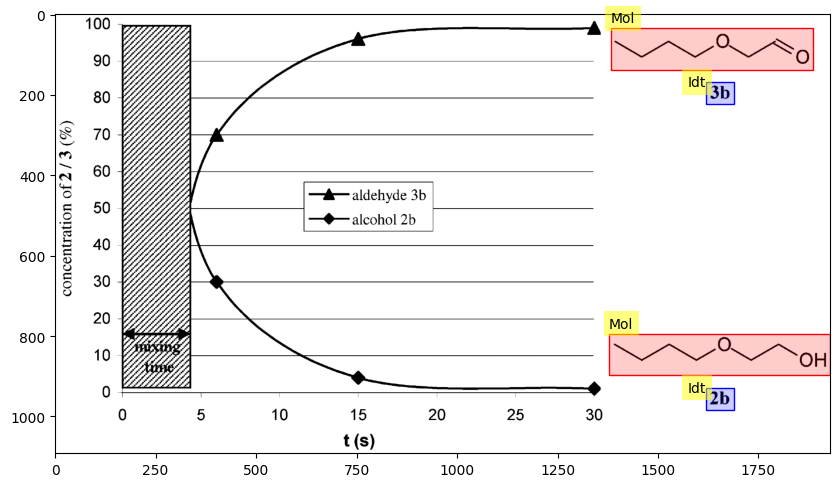

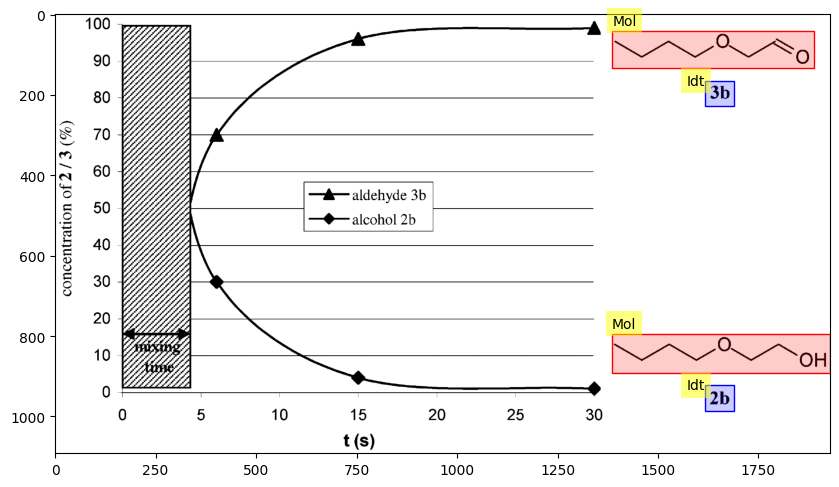

76
the prediction is
[{'category': '[Mol]', 'bbox': [0.2001000500250125, 0.049904952476238114, 0.48574287143571787, 0.22973486743371682], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5247623811905953, 0.0, 0.7983991995997999, 0.30459229614807404], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9937, 'image_id': 1263, 'category_id': 1, 'segmentation': [], 'area': 405113.5, 'bbox': [1455.0, 0.0, 803.0, 504.5], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 9938, 'image_id': 1263, 'category_id': 1, 'segmentation': [], 'area': 270864.0, 'bbox': [562.0, 59.0, 836.0, 324.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation resu

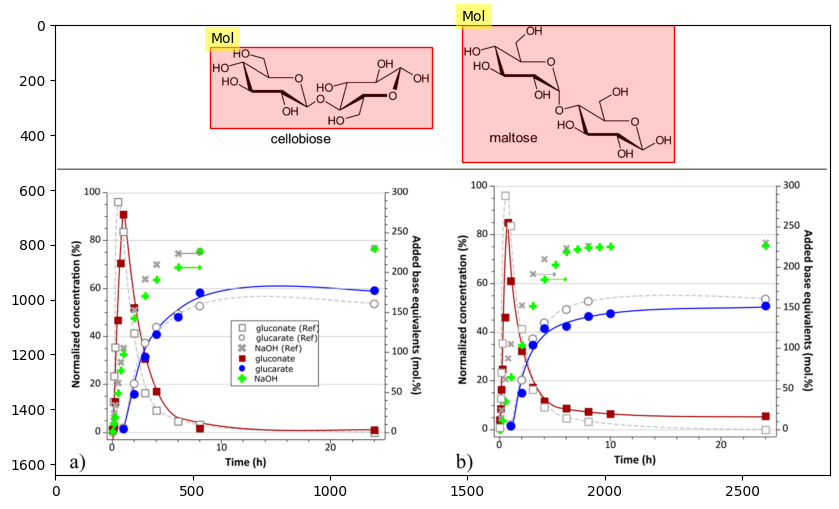

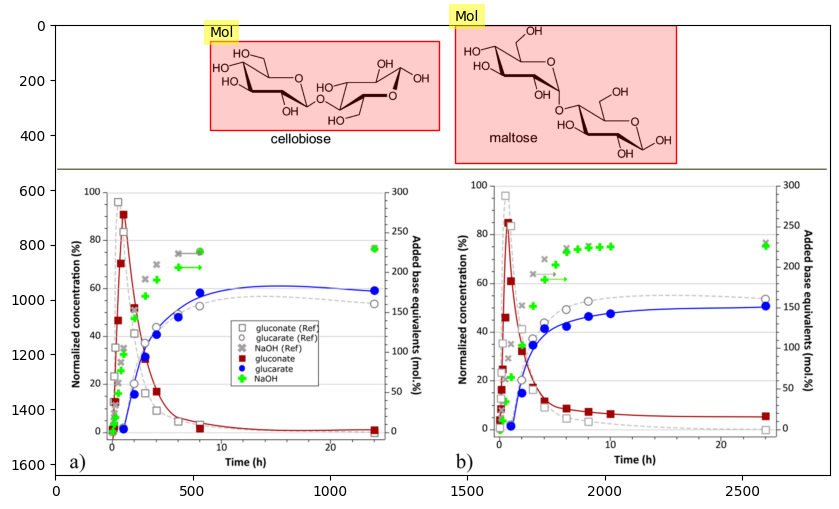

77
the prediction is
[{'category': '[Mol]', 'bbox': [0.22111055527763882, 0.5910568920824049, 0.3571785892946473, 0.8831409506406096], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.28264132066033015, 0.9685617602189524, 0.29314657328664334, 0.9974946150761331], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23461730865432717, 0.23008508386424617, 0.32266133066533265, 0.4009267030209319], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.31465732866433216, 0.49874730753806656, 0.32516258129064535, 0.5345689373612426], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.33016508254127064, 0.25212916375543143, 0.4062031015507754, 0.3775048681365476], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.38669334667333666, 0.5662573022048214, 0.5667833916958479, 0.9093182955113921], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.47573786893446723, 0.9658062502325543, 0.4882441220610305

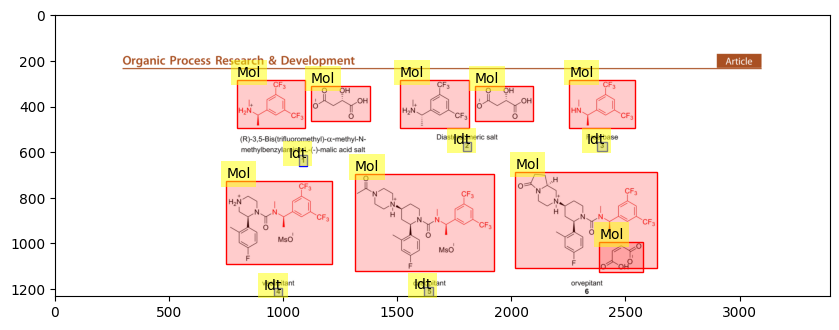

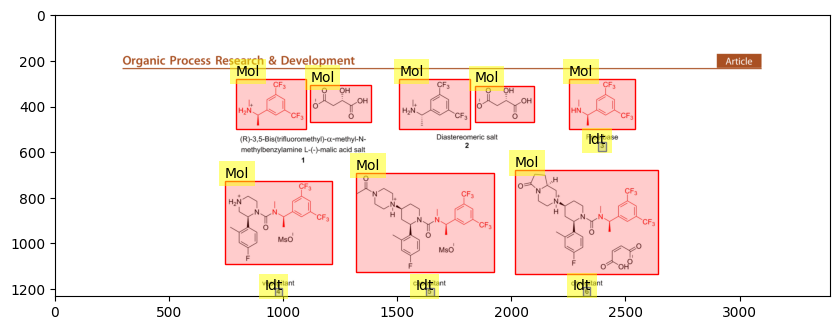

78
the prediction is
[{'category': '[Mol]', 'bbox': [0.04402201100550275, 0.4553984309227785, 0.2541270635317659, 0.7657741472362196], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13806903451725863, 0.9189289766834635, 0.16008004002001, 0.9921180102246244], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3071535767883942, 0.4432002586659183, 0.439719859929965, 0.7793276719660643], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.36368184092046024, 0.9257057390483859, 0.38669334667333666, 0.99076265775164], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4502251125562781, 0.33477206082716154, 0.7558779389694847, 0.8836898123858677], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5927963981990996, 0.9270610915213704, 0.6133066533266633, 0.99076265775164], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.8059029514757379, 0.353746995448944, 0.9574787393696849, 0.863359525291

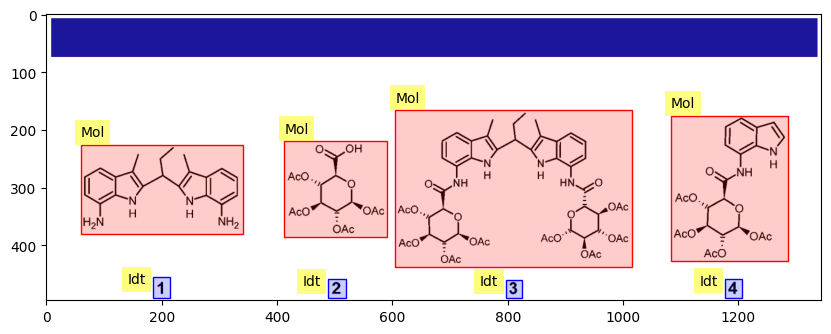

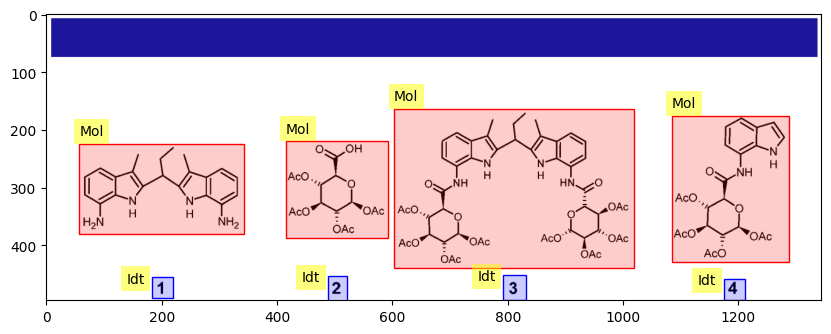

79
the prediction is
[{'category': '[Mol]', 'bbox': [0.18359179589794897, 0.706972903927692, 0.3061530765382691, 0.8636463862999461], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.21860930465232617, 0.8740049636468721, 0.23311655827913957, 0.918028917371307], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.33316658329164583, 0.7432279246419327, 0.42771385692846425, 0.9465150050753531], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3646823411705853, 0.9555787602539134, 0.3791895947973987, 0.9983078918099827], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5317658829414708, 0.6435266176777709, 0.6613306653326664, 0.8079690330602195], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5942971485742872, 0.8455188759428257, 0.609304652326163, 0.8895428296672608], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6953476738369184, 0.7691243680092474, 0.8199099549774888, 0.8960169

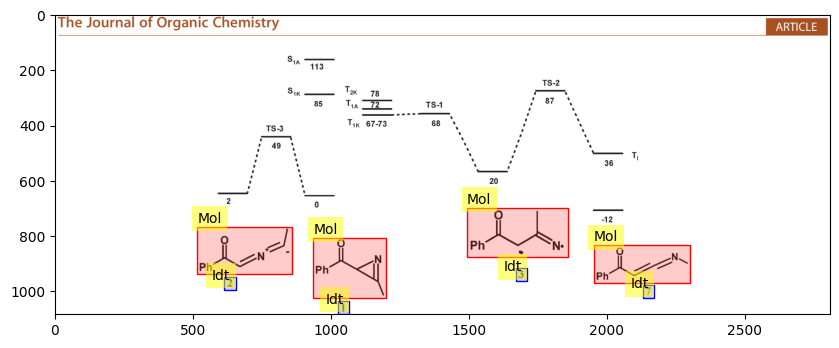

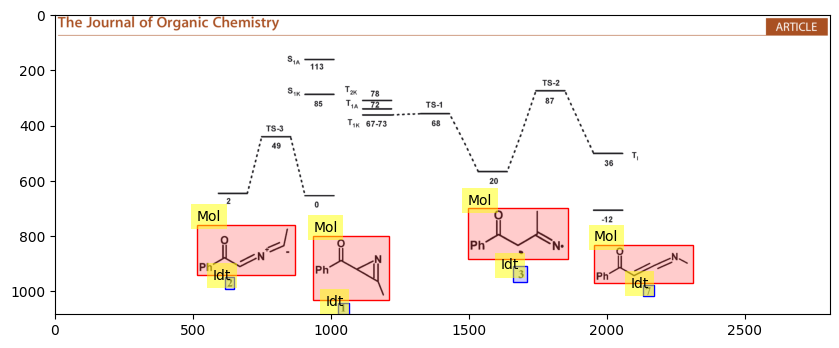

80
the prediction is
[{'category': '[Mol]', 'bbox': [0.002001000500250125, 0.01686543660935526, 0.2671335667833917, 0.34120075602003336], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09354677338669334, 0.33990341474239066, 0.12756378189094547, 0.4397986931208795], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3826913456728364, 0.007784047665856274, 0.6248124062031015, 0.32044329557775], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.46923461730865434, 0.32044329557775, 0.5082541270635318, 0.40995984373509714], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7738869434717359, 0.009081388943498987, 0.9874937468734367, 0.33211936707653433], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8669334667333667, 0.33211936707653433, 0.9069534767383692, 0.41644655012331067], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.7858929464732366, 0.5747221859957216, 0.9979989994997499,

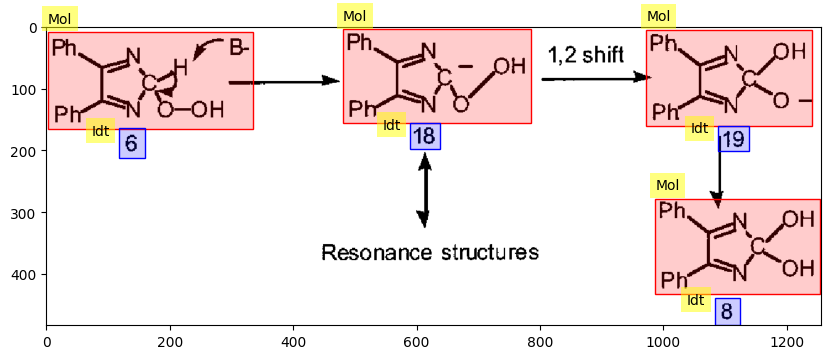

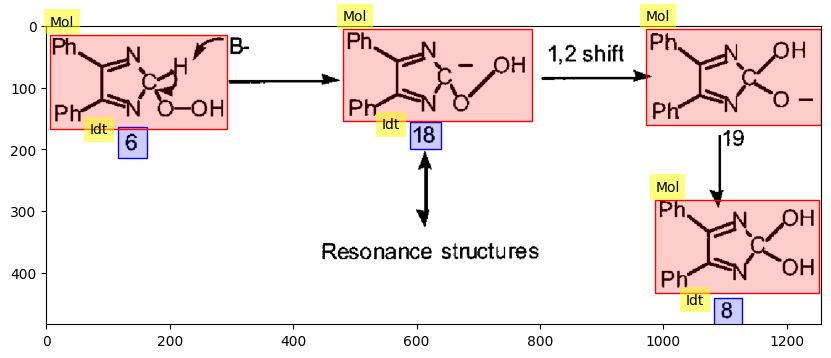

81
the prediction is
[{'category': '[Mol]', 'bbox': [0.016508254127063533, 0.02020707323358649, 0.21310655327663833, 0.34076473498457216], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.08704352176088044, 0.6227452569259836, 0.4012006003001501, 0.9331993820601762], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3021510755377689, 0.11848692941512079, 0.4177088544272136, 0.273713991982217], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5057528764382191, 0.0027555099863981578, 0.6183091545772886, 0.18645617574627535], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6693346673336669, 0.6209082502683849, 0.9819909954977488, 0.9313623754025773], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7323661830915458, 0.05511019972796316, 0.9734867433716858, 0.3572977949029611], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 9974, 'image_id': 1268, 'category_id': 1, 

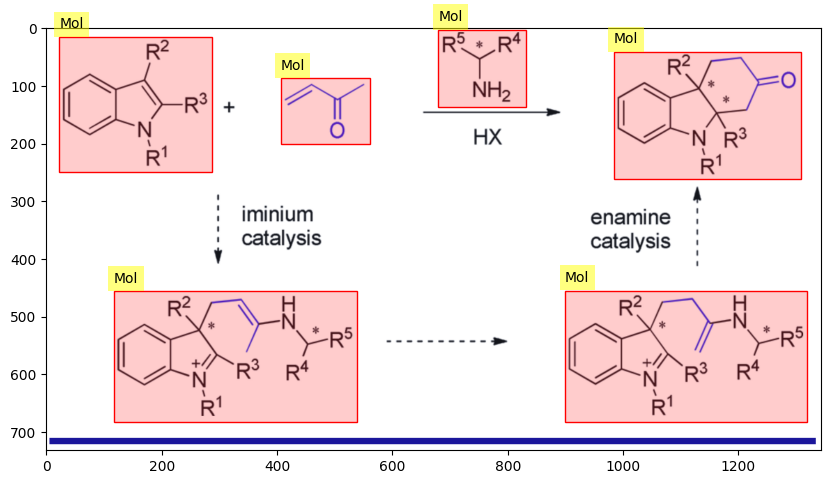

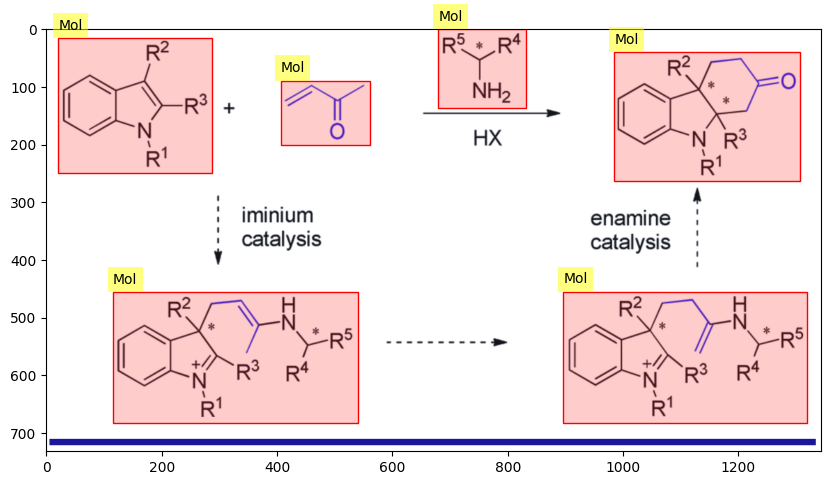

82
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.23223615188828567, 0.3026513256628314, 0.4120500656076136], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1485742871435718, 0.4509439842490983, 0.18009004502251125, 0.4898379028905831], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.007503751875937969, 0.003945759862179611, 0.2481240620310155, 0.11160863610165184], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13056528264132067, 0.1459931149006456, 0.16358179089544772, 0.18657807348306443], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3601800900450225, 0.4920926228118286, 0.742871435717859, 0.9977135651511301], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5842921460730365, 0.0, 0.9864932466233116, 0.11611807594414283], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6763381690845423, 0.14881151480220248, 0.7128564282141071, 0.1899601533649327], 'category

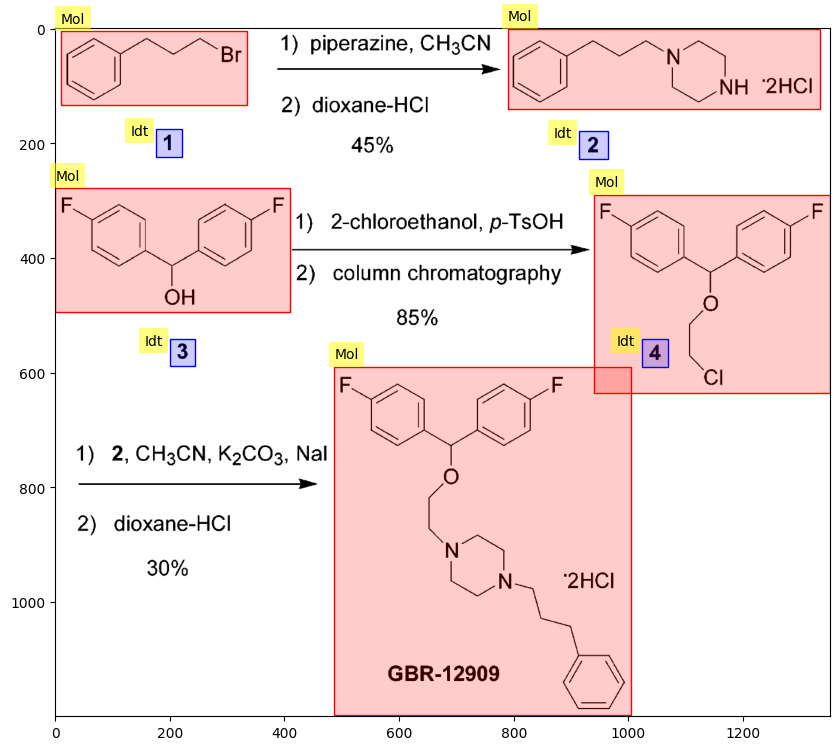

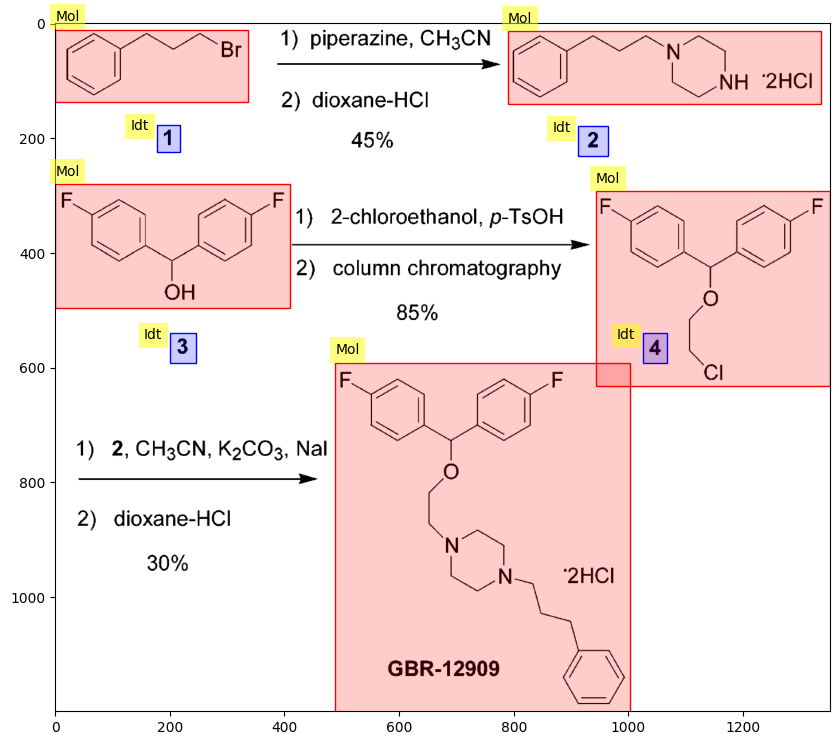

83
the prediction is
[{'category': '[Mol]', 'bbox': [0.0065032516258129065, 0.0, 0.3456728364182091, 0.4300317772522625], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.06953476738369184, 0.46697283300741277, 0.10305152576288144, 0.5512742166537814], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.17558779389694848, 0.6279979478375551, 0.4222111055527764, 0.8685884135249442], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.24362181090545273, 0.9131071217426895, 0.27963981990995496, 0.9955140922734095], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.663831915957979, 0.6298923609532039, 0.9394697348674337, 0.8685884135249442], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7303651825912957, 0.9121599151848652, 0.7668834417208604, 0.9888836463686389], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6643321660830416, 0.08998462299331483, 1.0, 0.3248918493337578], 'category_i

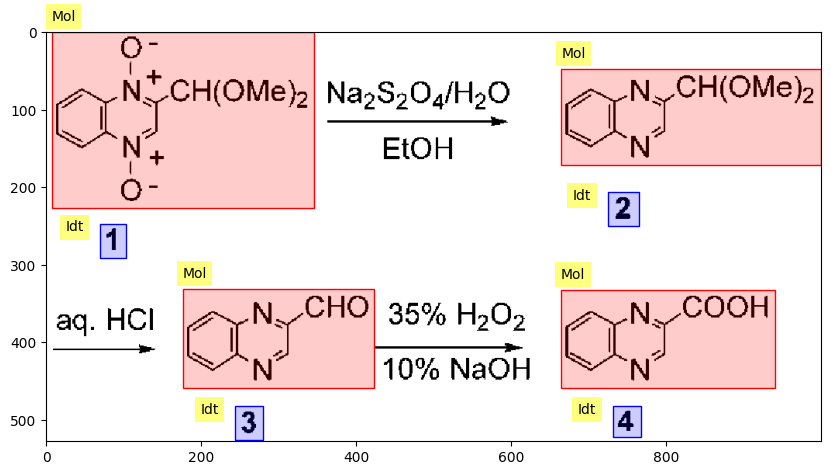

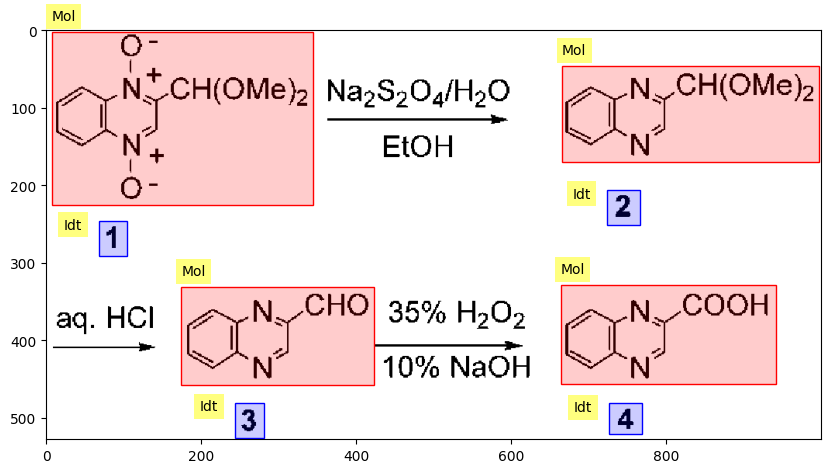

84
the prediction is
[{'category': '[Mol]', 'bbox': [0.044635908217800585, 0.742871435717859, 0.2454974951979032, 0.9674837418709354], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.02367055738822758, 0.9729864932466233, 0.16231239351927484, 1.0], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.04734111477645516, 0.38619309654827416, 0.2468500984772305, 0.6128064032016008], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.027052065586545805, 0.6118059029514757, 0.1406707410500382, 0.639319659829915], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.045988511497127876, 0.0240120060030015, 0.23873447880126675, 0.144072036018009], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.06492495740770994, 0.16208104052026012, 0.09671113447190127, 0.1875937968984492], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.472734846124888, 0.0030015007503751876, 0.6735964331049906, 0.22611305652

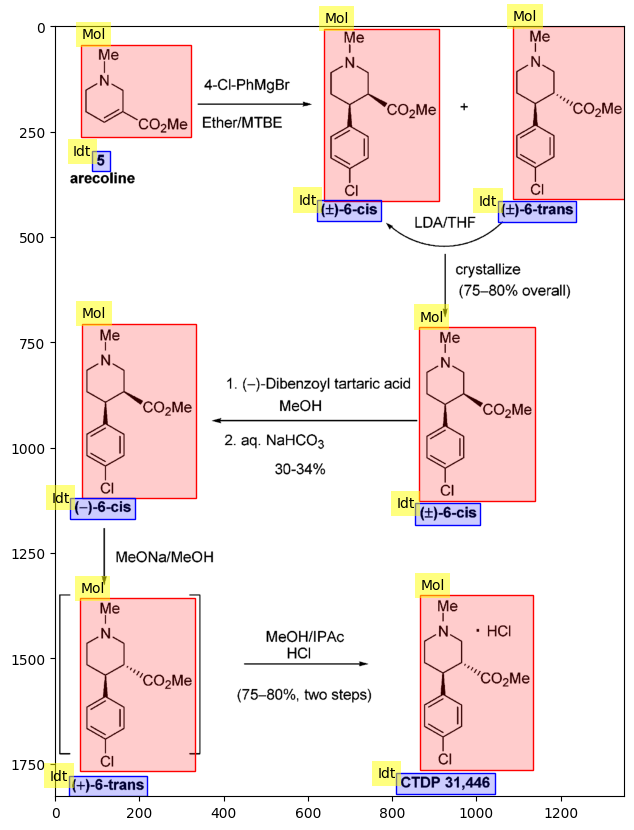

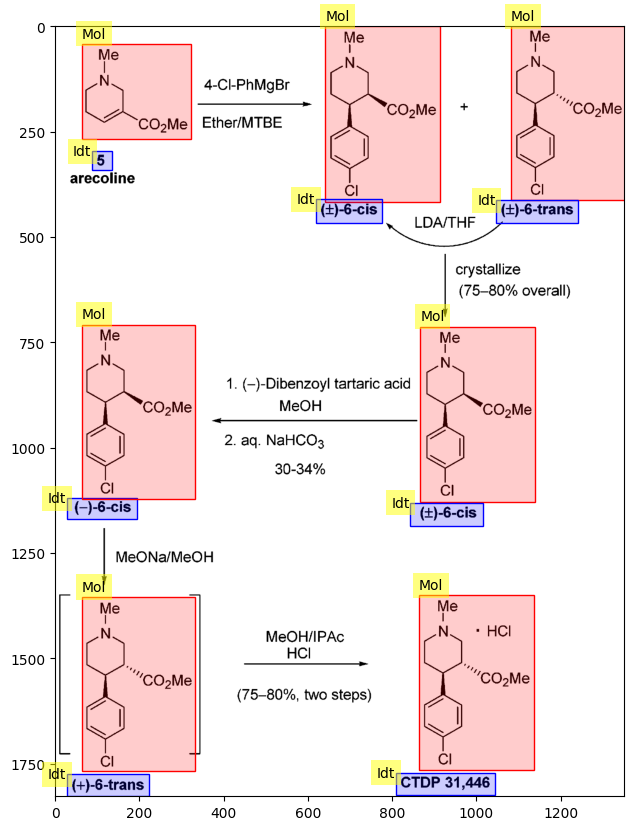

85
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.5062531265632816, 0.4564477360631535, 0.8599299649824912], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0802718432386925, 0.9244622311155578, 0.36463353628033524, 1.0], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.21773081662782612, 0.0, 0.7791090667284862, 0.32066033016508255], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3063971009895191, 0.3721860930465233, 0.5592796398199099, 0.4462231115557779], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5451140204248466, 0.5017508754377189, 0.9999877987774375, 0.8514257128564282], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6012518454349125, 0.9084542271135568, 0.9695579497065606, 0.9859929964982491], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10011, 'image_id': 1272, 'category_id': 3, 'segmentation': [], 'area': 20615.199999999997, 'bbo

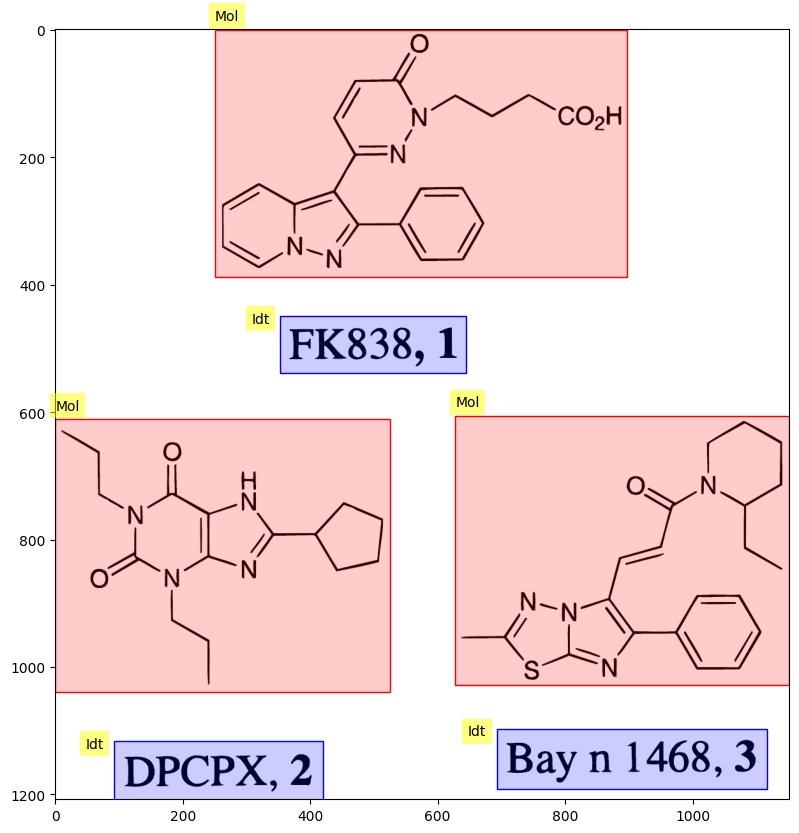

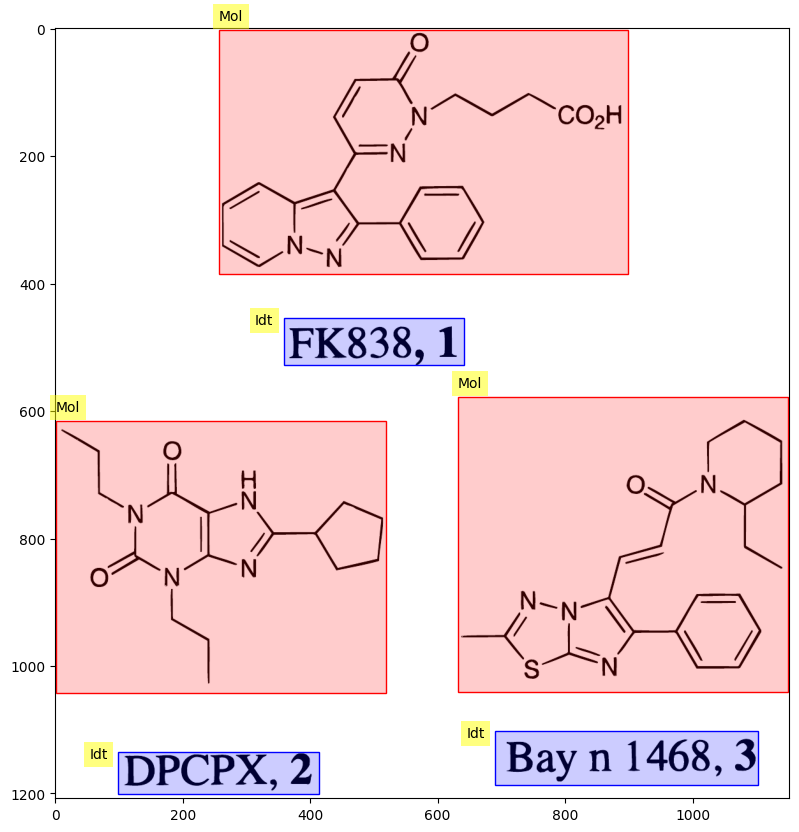

86
the prediction is
[{'category': '[Mol]', 'bbox': [0.096048024012006, 0.0, 0.4412206103051526, 0.9536565015720201], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.867730598511597, 0.064032016008004, 1.002065461042681], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.735367683841921, 0.0, 1.0, 0.9705996373867515], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6558279139569785, 0.8689408224983635, 0.7148574287143572, 0.9960143411088483], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10017, 'image_id': 1273, 'category_id': 3, 'segmentation': [], 'area': 2755.0, 'bbox': [575.3, 316.5, 58.0, 47.5], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10018, 'image_id': 1273, 'category_id': 3, 'segmentation': [], 'area': 3016.4399999999996, 'bbox': [0.0, 312.7, 58.8, 51.3], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10019, 'image_id': 127

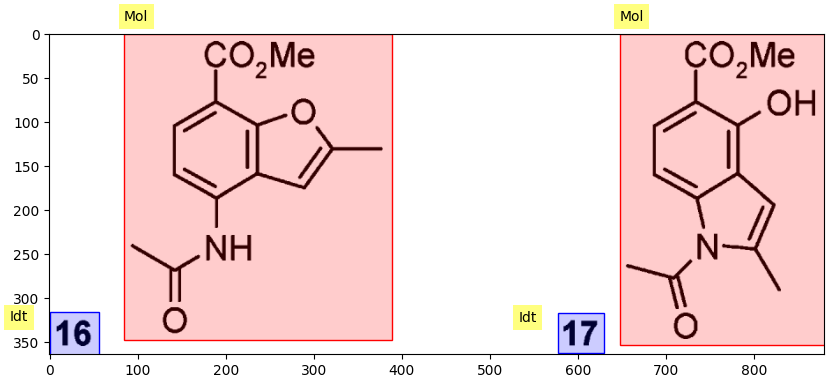

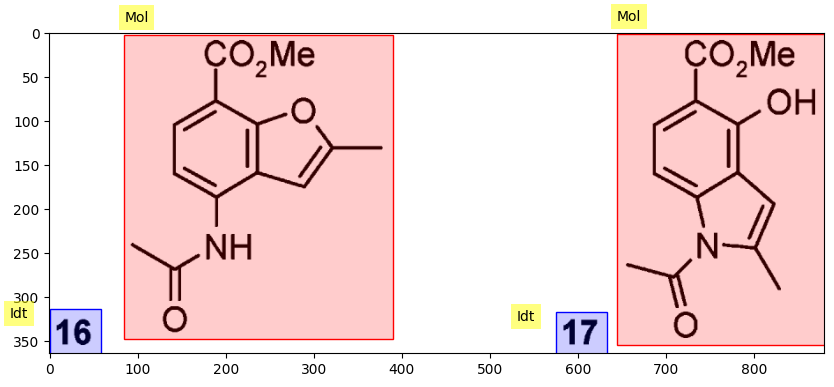

87
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.45972986493246626, 0.8080451990701233], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.208104052026013, 0.8551157931907128, 0.23711855927963982, 1.000250125062531], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5377688844422212, 0.0, 1.0, 0.8080451990701233], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7473736868434218, 0.8649221669658358, 0.7943971985992997, 1.0041726745725803], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10021, 'image_id': 1274, 'category_id': 1, 'segmentation': [], 'area': 163928.00999999998, 'bbox': [720.1, 2.0, 611.9, 267.9], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10022, 'image_id': 1274, 'category_id': 1, 'segmentation': [], 'area': 169063.5, 'bbox': [0.0, 0.0, 615.0, 274.9], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10023, 'image_i

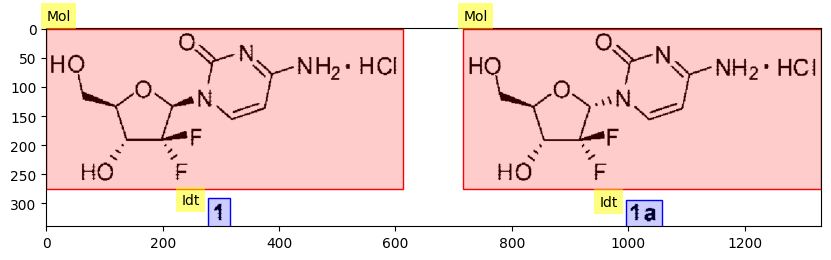

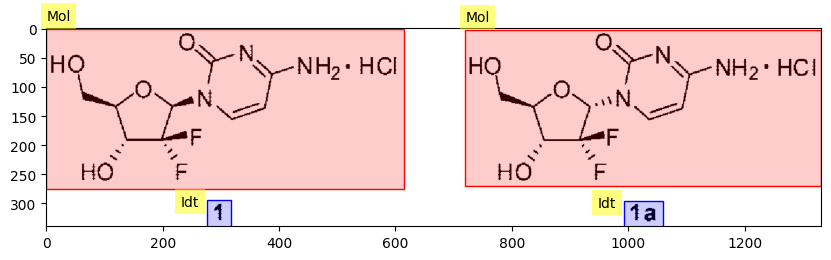

88
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.1524630675614944, 0.5147573786893447, 0.9016881419924743], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.17158579289644824, 0.9116983433980269, 0.4182091045522761, 0.9971700630915921], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.16108054027013508, 0.0, 1.0, 0.08393168870809539], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5162581290645323, 0.436598784380643, 0.9129564782391195, 0.8978380645288003], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.609304652326163, 0.9124683588907618, 0.8659329664832416, 0.9917799546424484], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10025, 'image_id': 1275, 'category_id': 1, 'segmentation': [], 'area': 144753.0, 'bbox': [564.0, 295.0, 427.0, 339.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10026, 'image_id': 1275, 'category_id': 3, 'segmen

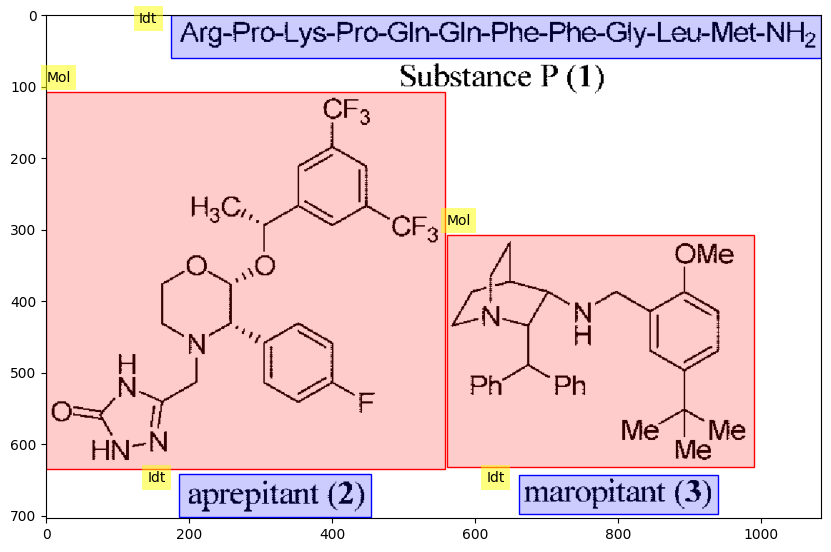

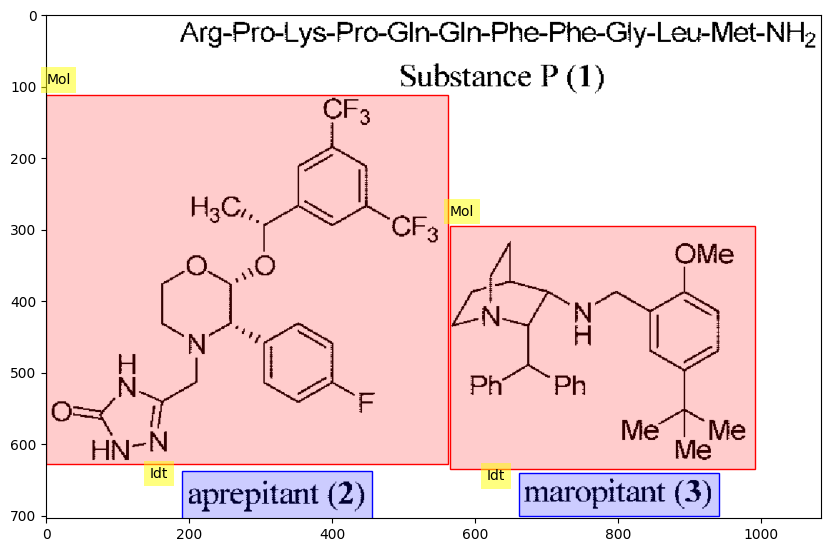

89
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 1.0058605023665679, 0.5247623811905953], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.24124622407357524, 0.6738369184592297, 0.8046884018932543, 0.8554277138569285], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1779291087851618, 0.8809404702351176, 0.8680055171816676, 1.0], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10029, 'image_id': 1276, 'category_id': 1, 'segmentation': [], 'area': 135394.0, 'bbox': [207.0, 950.0, 509.0, 266.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10030, 'image_id': 1276, 'category_id': 1, 'segmentation': [], 'area': 651798.0, 'bbox': [2.0, 2.0, 882.0, 739.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index creat

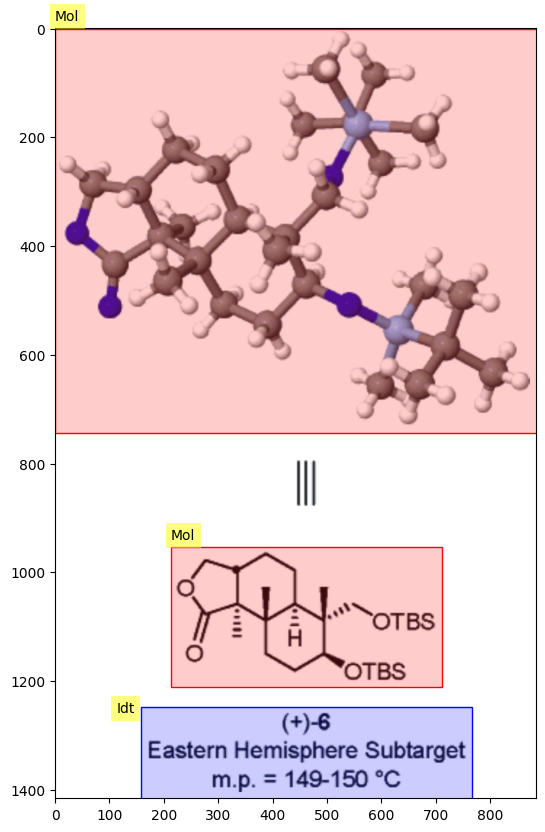

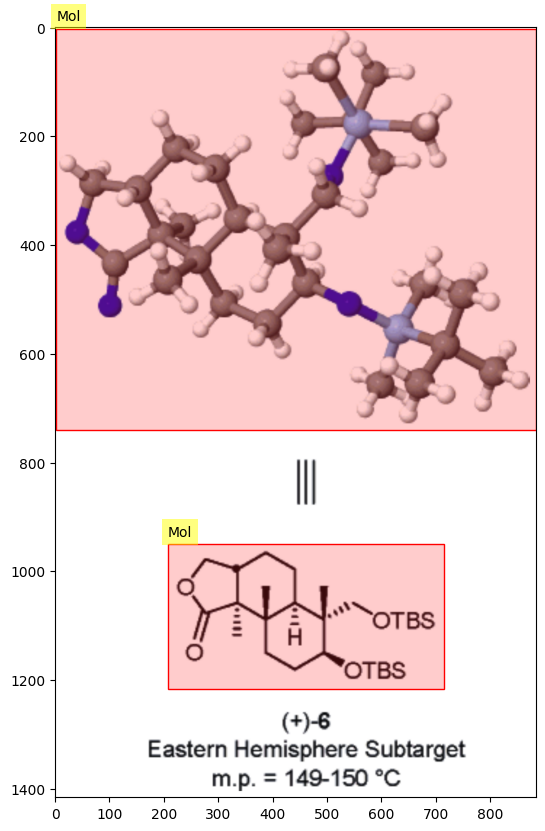

90
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.5169251292312824, 0.4412206103051526, 0.8137878463041045], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1520760380190095, 0.8256032778293909, 0.26013006503251623, 0.89723433145144], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.02001000500250125, 0.00221539341099121, 0.2991495747873937, 0.29833964601348295], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1455727863931966, 0.33600133400033355, 0.19559779889944973, 0.397293885037757], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5342671335667833, 0.5479406369851593, 1.0, 0.889849686748136], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6078039019509754, 0.9245575168536649, 0.9024512256128064, 0.9969270349460446], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6323161580790395, 0.0, 0.9949974987493747, 0.3042473617761262], 'category_id': 1, 'score': 2011},

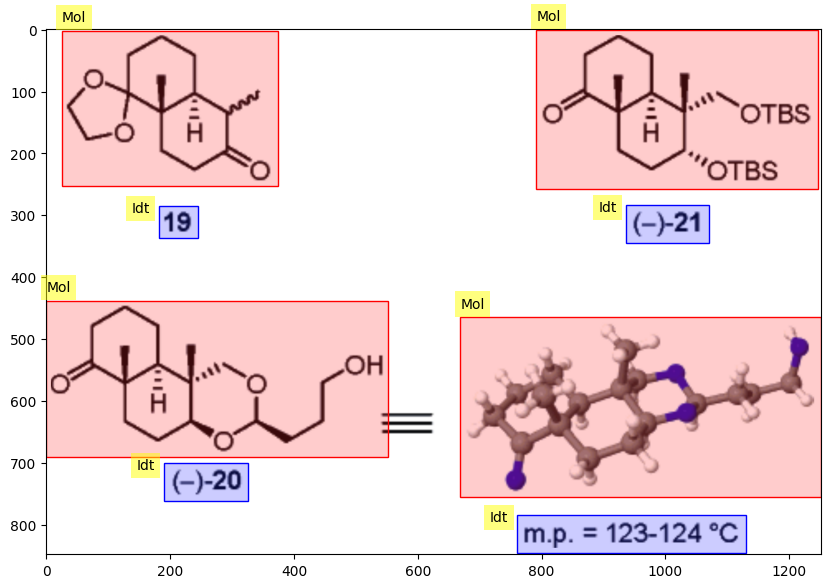

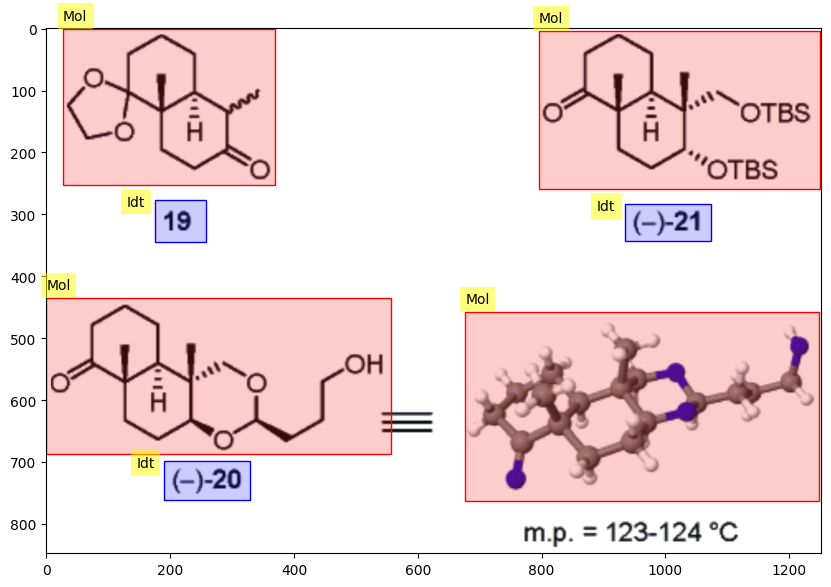

91
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 1.0, 0.9032649465108821], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4547273636818409, 0.8386081608097827, 0.5477738869434717, 0.9881872919093411], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10038, 'image_id': 1278, 'category_id': 3, 'segmentation': [], 'area': 3825.0, 'bbox': [292.0, 284.0, 75.0, 51.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10039, 'image_id': 1278, 'category_id': 1, 'segmentation': [], 'area': 199120.0, 'bbox': [0.0, 0.0, 655.0, 304.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precisi

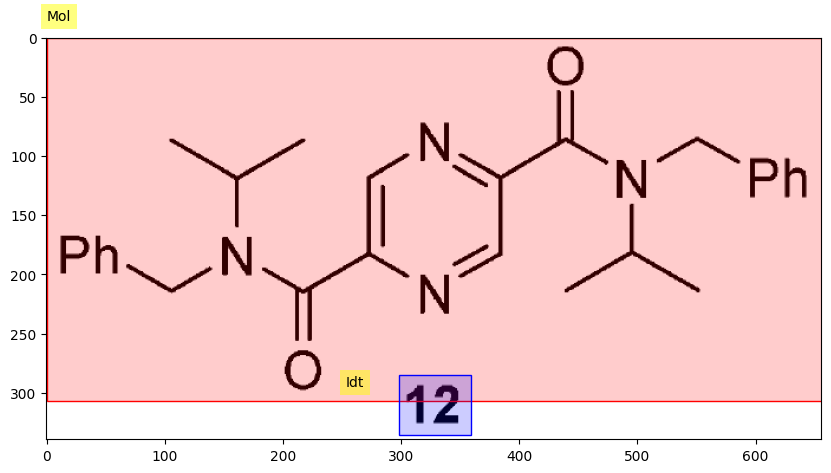

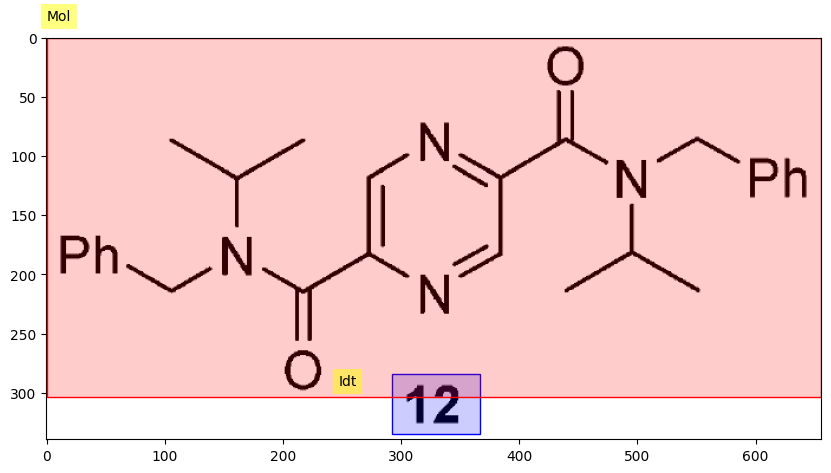

92
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.049395067904322534, 0.1615807903951976], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.21060530265132565, 0.007056438272046076, 0.2571285642821411], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.19758027161729014, 0.0, 1.0031903076758837, 0.1630815407703852], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.49747889817924834, 0.21010505252626313, 0.5974451070332344, 0.2571285642821411], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10040, 'image_id': 1279, 'category_id': 3, 'segmentation': [], 'area': 2749.4400000000005, 'bbox': [204.0, 203.8, 53.7, 51.2], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10041, 'image_id': 1279, 'category_id': 1, 'segmentation': [], 'area': 54010.53999999999, 'bbox': [79.3, 1.3, 338.2, 159.7], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
load

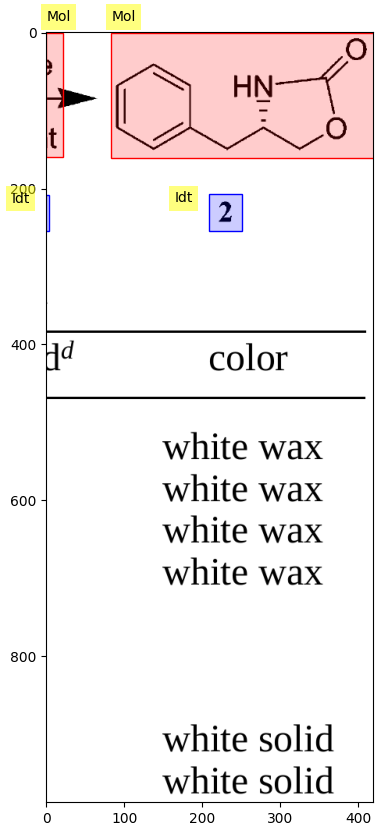

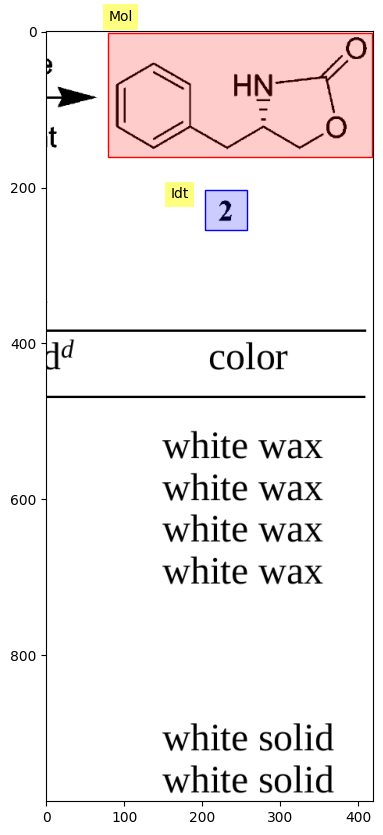

93
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0264197074765592, 0.42921460730365185, 0.3075253950271491], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2511255627813907, 0.3466265620924567, 0.29664832416208103, 0.4322264143165085], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10755377688844422, 0.5114855367461861, 0.8639319659829915, 0.8507145807452062], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4912456228114057, 0.9141218786889483, 0.5392696348174087, 0.9976081543148755], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5147573786893447, 0.0, 0.9319659829914958, 0.3952388238493256], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7363681840920461, 0.36776232807370407, 0.7828914457228614, 0.4501918154005688], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10042, 'image_id': 1280, 'category_id': 1, 'segmentation': [], 'area': 90572.40

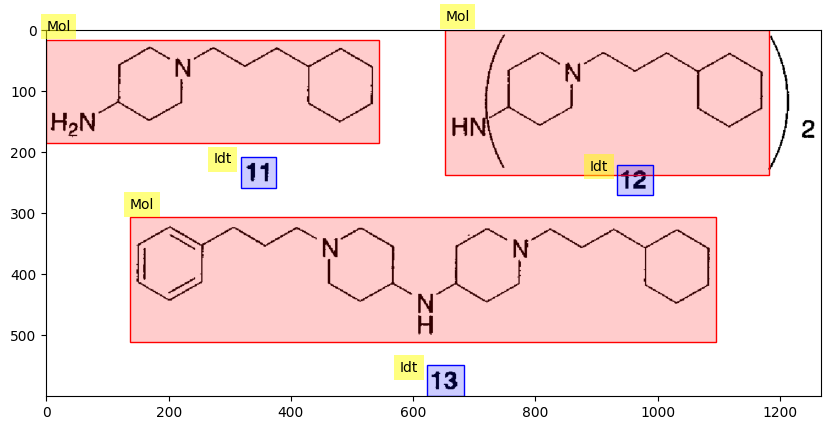

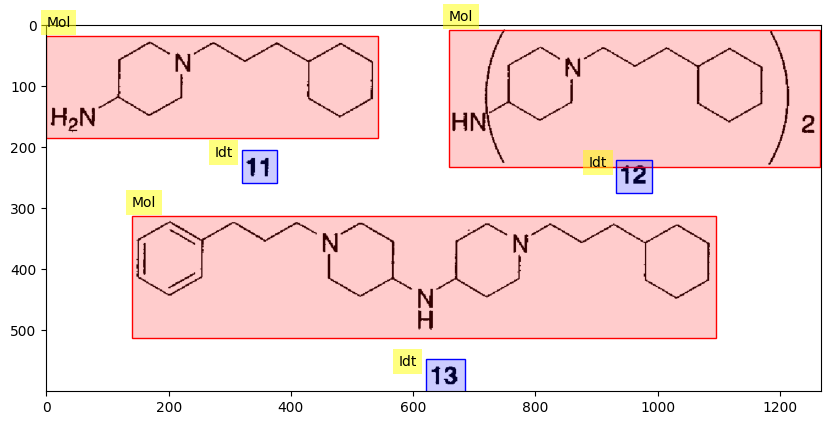

94
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.5858225297387649, 0.2496248124062031, 0.9105355890796805], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.15057528764382191, 0.929281910031321, 0.1870935467733867, 0.9841818499611252], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.21810905452726362, 0.0026780458502343543, 0.663831915957979, 0.4043849233853875], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3396698349174587, 0.3360947542044115, 0.37718859429714857, 0.3916642055967743], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.28214107053526766, 0.6219761487169287, 0.6368184092046023, 0.9312904444189968], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4732366183091546, 0.9426721392824927, 0.5257628814407204, 0.9955635448246212], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6653326663331666, 0.5938566672894681, 1.0, 0.813456427008685], 'category_id': 1

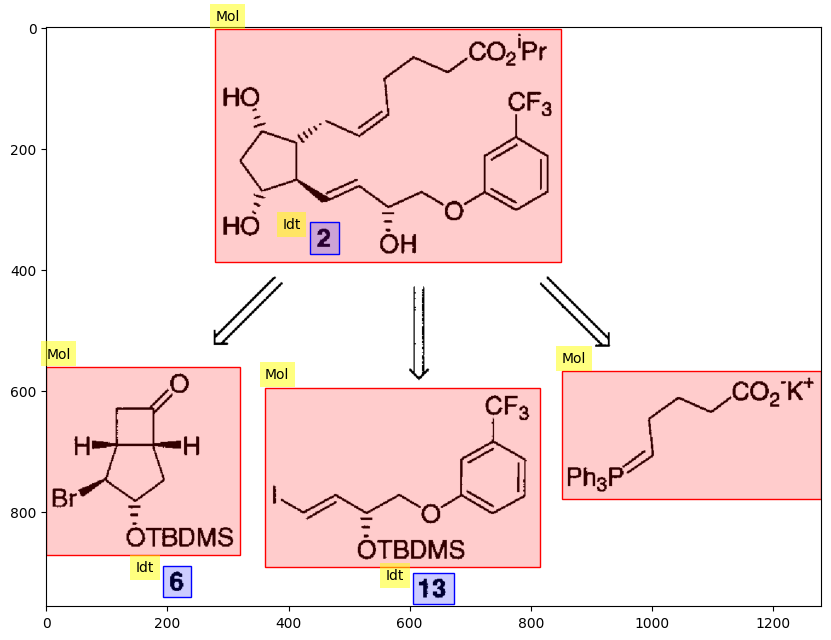

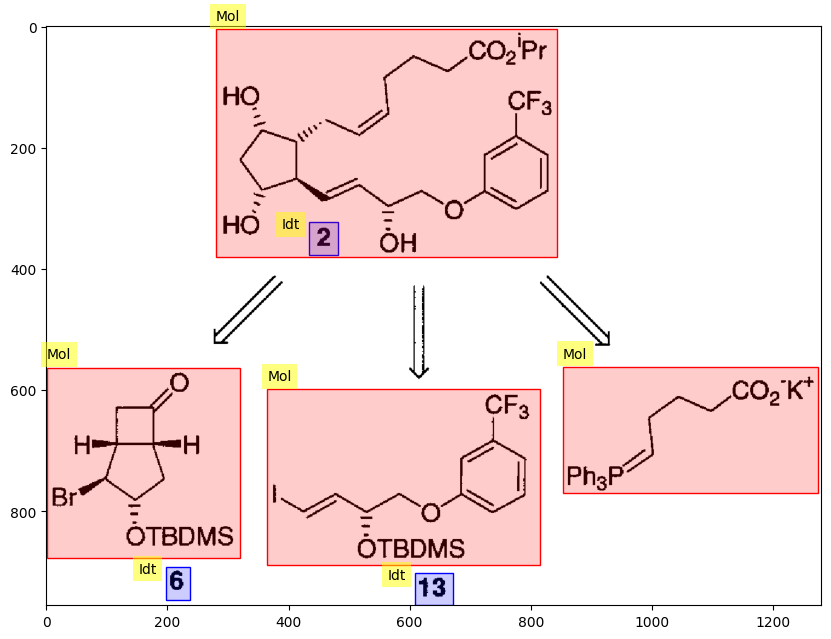

95
the prediction is
[{'category': '[Mol]', 'bbox': [0.029014507253626812, 0.6668334167083542, 0.33616808404202103, 0.8600575878490426], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.16808404202101052, 0.9020628424448445, 0.19459729864932465, 0.9713715125279174], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3166583291645823, 0.5271659451773131, 0.5497748874437218, 0.936717177486381], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.42021010505252626, 0.9125641560937949, 0.45222611305652827, 0.9850232202715531], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5022511255627814, 0.21107640434390423, 0.967983991995998, 0.9524691479598066], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7168584292146073, 0.9293662579321157, 0.7453726863431716, 0.9965746652853986], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10055, 'image_id': 1282, 'category_id': 3, 'seg

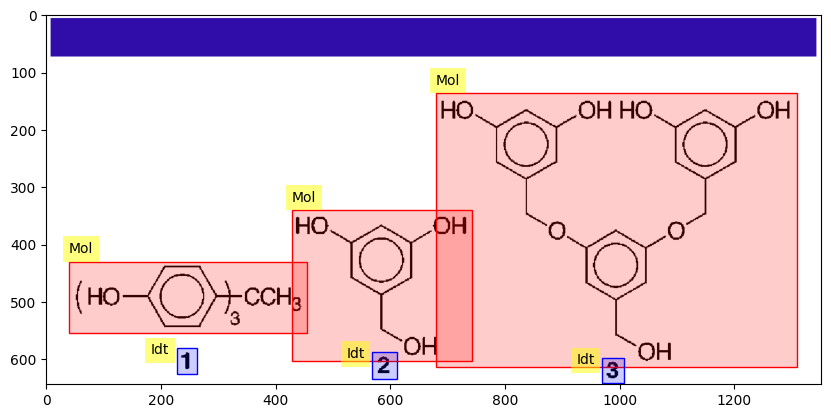

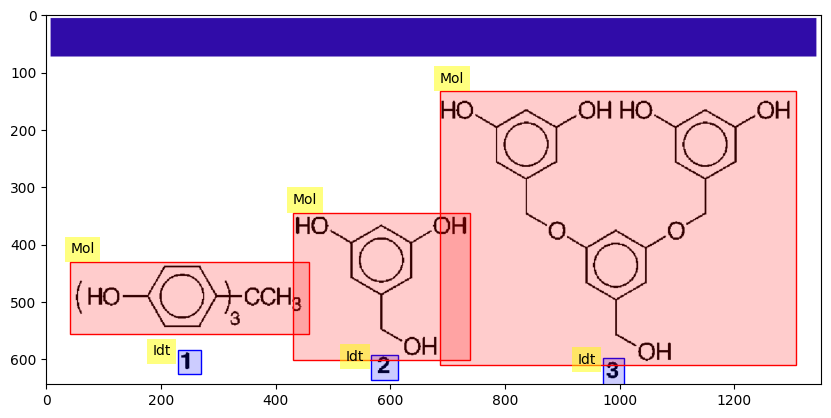

96
the prediction is
[{'category': '[Mol]', 'bbox': [0.04252126063031516, 0.6001500750375187, 0.24062031015507754, 0.7861615018035334], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.432216108054027, 0.5802620608549889, 0.6258129064532266, 0.8060495159860631], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7878939469734867, 0.6013199582247264, 1.0, 0.783821735429118], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10061, 'image_id': 1283, 'category_id': 1, 'segmentation': [], 'area': 30140.0, 'bbox': [70.0, 366.0, 274.0, 110.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10062, 'image_id': 1283, 'category_id': 1, 'segmentation': [], 'area': 33018.520000000004, 'bbox': [1116.4, 363.3, 295.6, 111.7], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10063, 'image_id': 1283, 'category_id': 1, 'segmentation': [], 'area': 37155.36, 'bbox': [615.2, 353.3, 272.8, 

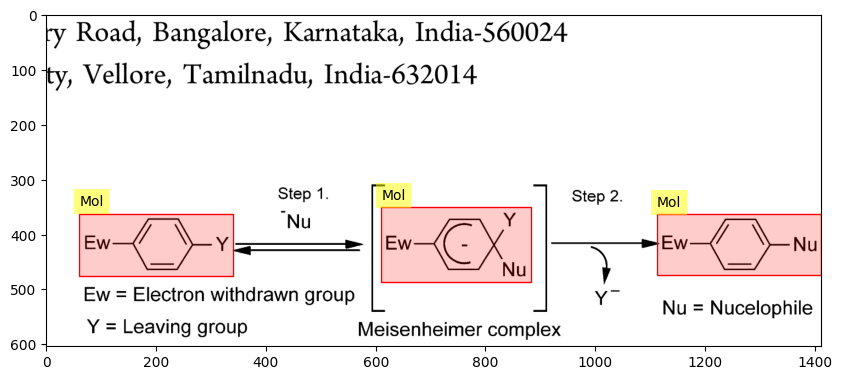

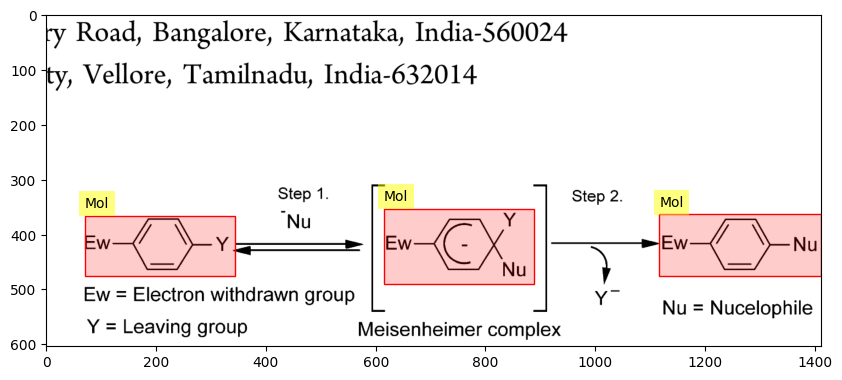

97
the prediction is
[{'category': '[Mol]', 'bbox': [0.36668334167083544, 0.13562713560169914, 0.6298149074537268, 0.7798560297097701], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5192596298149075, 0.8295859794303931, 0.5652826413206603, 0.9945989944124605], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10064, 'image_id': 1284, 'category_id': 1, 'segmentation': [], 'area': 68093.7, 'bbox': [502.0, 40.1, 353.0, 192.9], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10065, 'image_id': 1284, 'category_id': 3, 'segmentation': [], 'area': 2596.0, 'bbox': [704.0, 254.0, 59.0, 44.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evalu

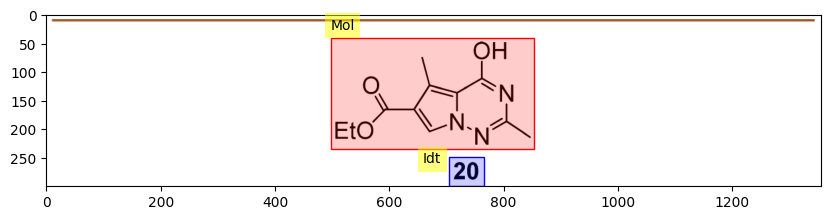

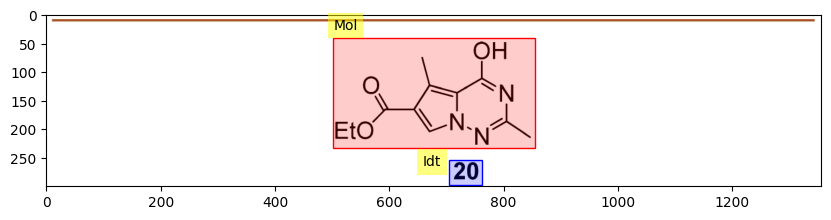

98
the prediction is
[{'category': '[Mol]', 'bbox': [0.24762381190595298, 0.08586989671898324, 0.6423211605802901, 0.9928706808132437], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10066, 'image_id': 1285, 'category_id': 1, 'segmentation': [], 'area': 249320.40000000002, 'bbox': [333.4, 35.0, 531.6, 469.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= s

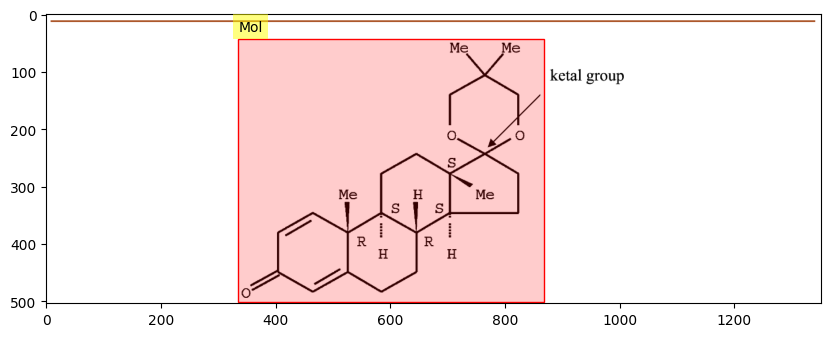

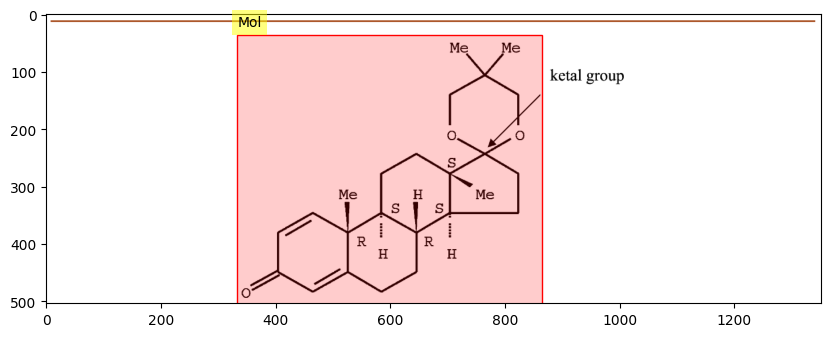

99
the prediction is
[{'category': '[Mol]', 'bbox': [0.667385888470333, 0.0, 0.856883702829045, 0.17408704352176088], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10067, 'image_id': 1286, 'category_id': 1, 'segmentation': [], 'area': 73652.2, 'bbox': [943.0, 3.0, 269.0, 273.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000


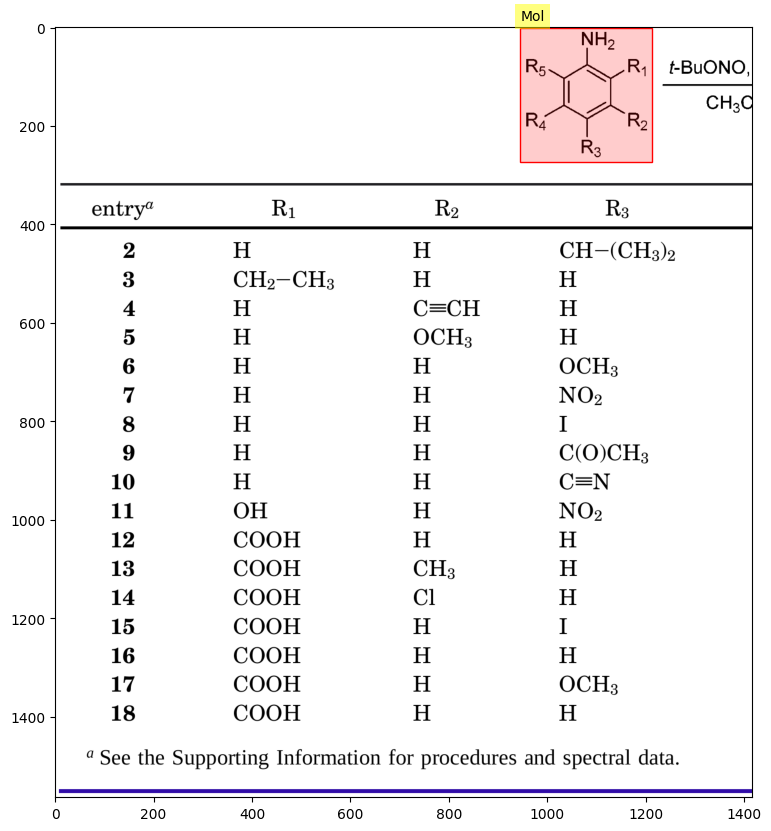

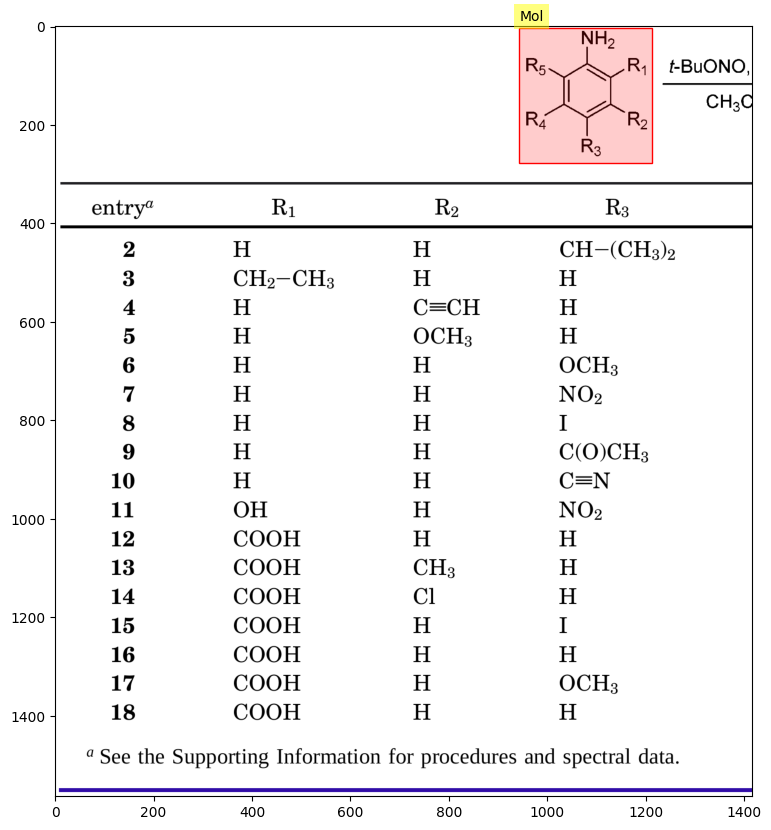

100
the prediction is
[{'category': '[Mol]', 'bbox': [0.07803901950975488, 0.14496378624094655, 0.9244622311155578, 1.00201797611425], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10068, 'image_id': 1287, 'category_id': 1, 'segmentation': [], 'area': 964904.0, 'bbox': [91.0, 132.0, 1171.0, 824.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | max

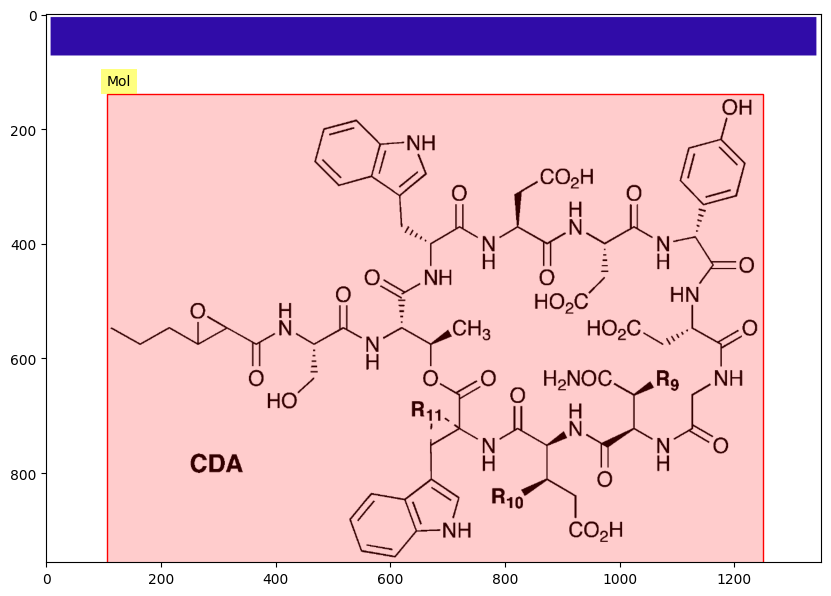

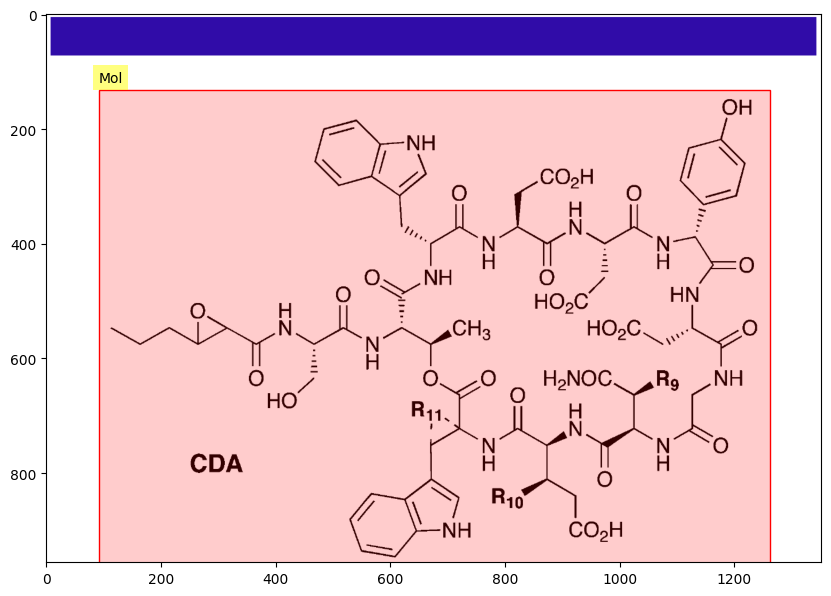

101
the prediction is
[{'category': '[Mol]', 'bbox': [0.19309654827413708, 0.22866078309424984, 0.8074037018509255, 0.8909885686086287], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10069, 'image_id': 1288, 'category_id': 1, 'segmentation': [], 'area': 327195.25, 'bbox': [261.5, 141.0, 831.5, 393.5], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | 

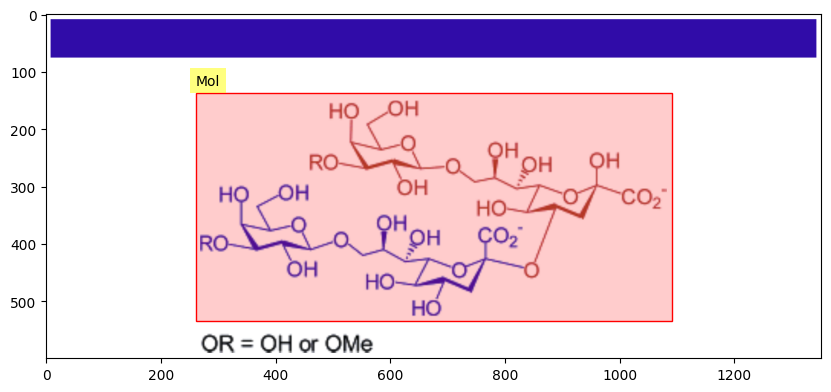

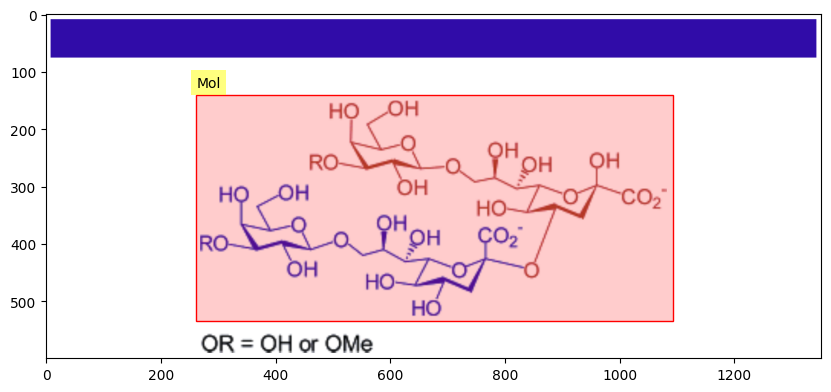

102
the prediction is
[{'category': '[Mol]', 'bbox': [0.04702351175587794, 0.0, 1.0, 0.9780980779998175], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10070, 'image_id': 1289, 'category_id': 1, 'segmentation': [], 'area': 608580.0, 'bbox': [6.0, 0.0, 828.0, 735.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.900
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Prec

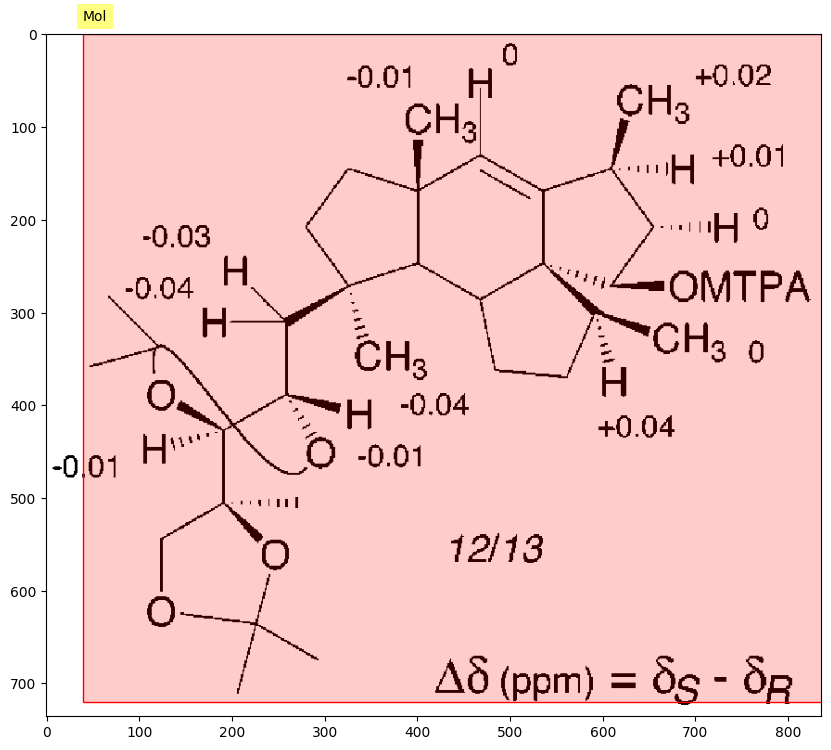

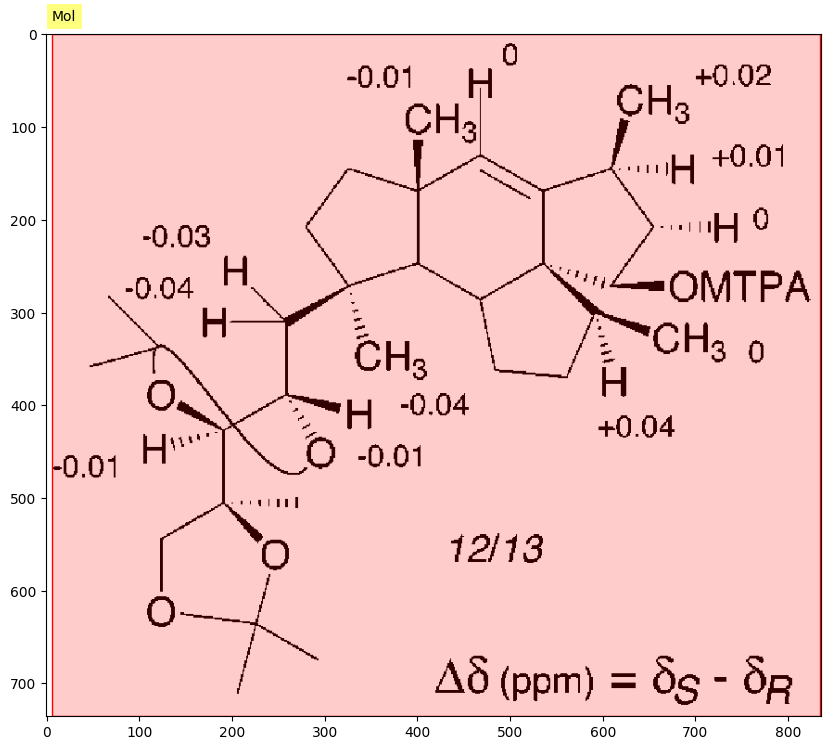

103
the prediction is
[{'category': '[Mol]', 'bbox': [0.07803901950975488, 0.16715449607051516, 0.37718859429714857, 0.4039071275155865], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.16408204102051024, 0.5680873442965908, 0.4092046023011506, 0.779261173851868], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.263631815907954, 0.7768817504202591, 0.30115057528764383, 0.8191165163313145], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.46173086543271635, 0.7852097324308899, 0.599799899949975, 0.9589076429383291], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4747373686843422, 0.05056274792168609, 0.5592796398199099, 0.10053063998546999], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5827913956978489, 0.546672533412112, 0.8344172086043021, 0.757251507109487], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6938469234617308, 0.7507080926725628, 0.7328664332166083, 0.79472

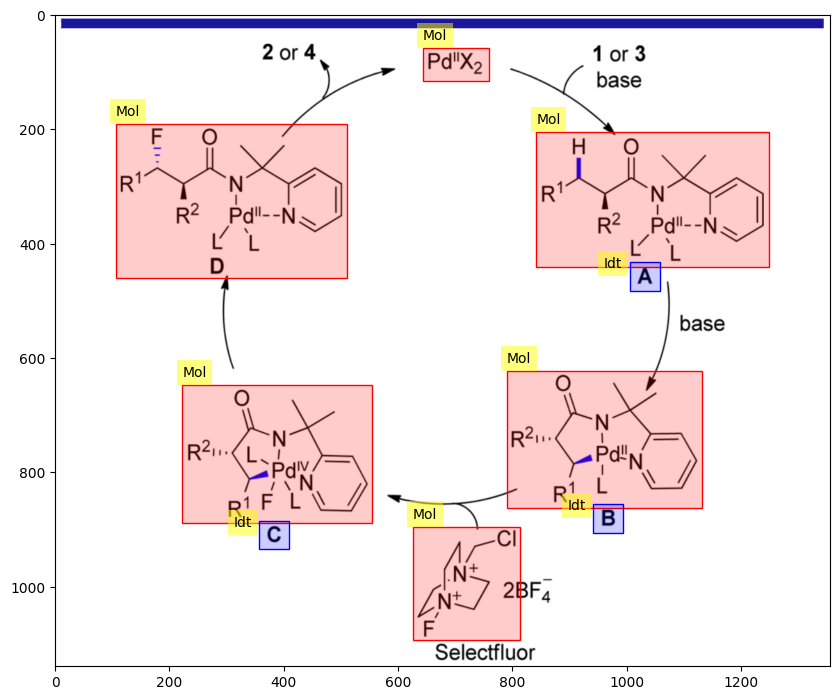

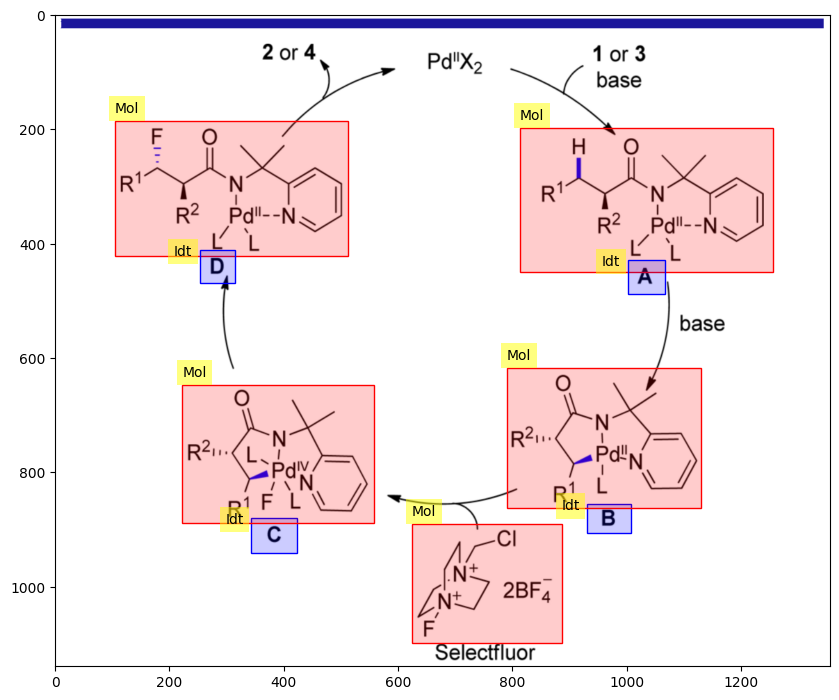

104
the prediction is
[{'category': '[Mol]', 'bbox': [0.058529264632316155, 0.16881858650844409, 0.9394697348674337, 0.9974364819540571], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.695847923961981, 0.6436208610634431, 0.9224612306153076, 0.9214681180252574], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7863931965982992, 0.9334261012362721, 0.8359179589794897, 0.9791478017489758], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10080, 'image_id': 1291, 'category_id': 3, 'segmentation': [], 'area': 1785.0, 'bbox': [1064.0, 896.0, 51.0, 35.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10081, 'image_id': 1291, 'category_id': 1, 'segmentation': [], 'area': 83571.0, 'bbox': [933.0, 614.0, 313.0, 267.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10082, 'image_id': 1291, 'category_id': 1, 'segmentation': [], 'area': 925036.2000000001, 'bbox': [83.0, 1

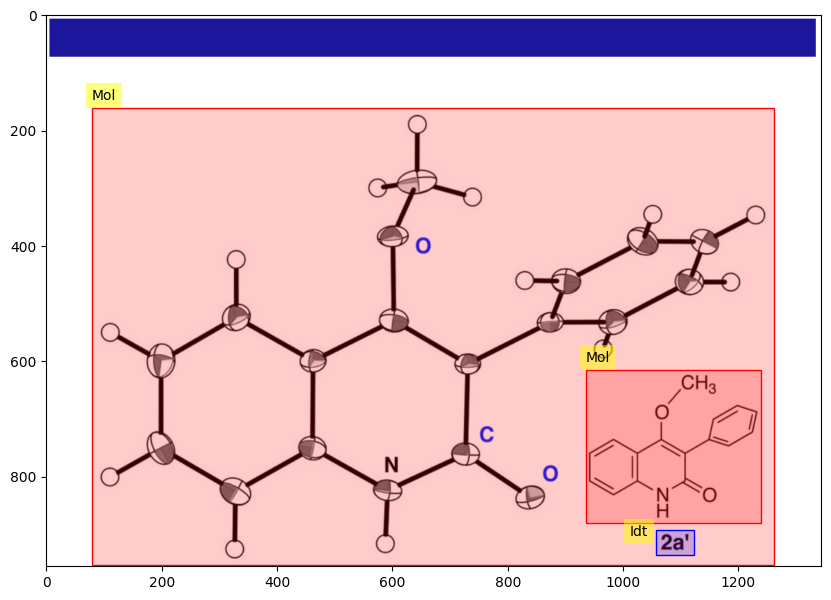

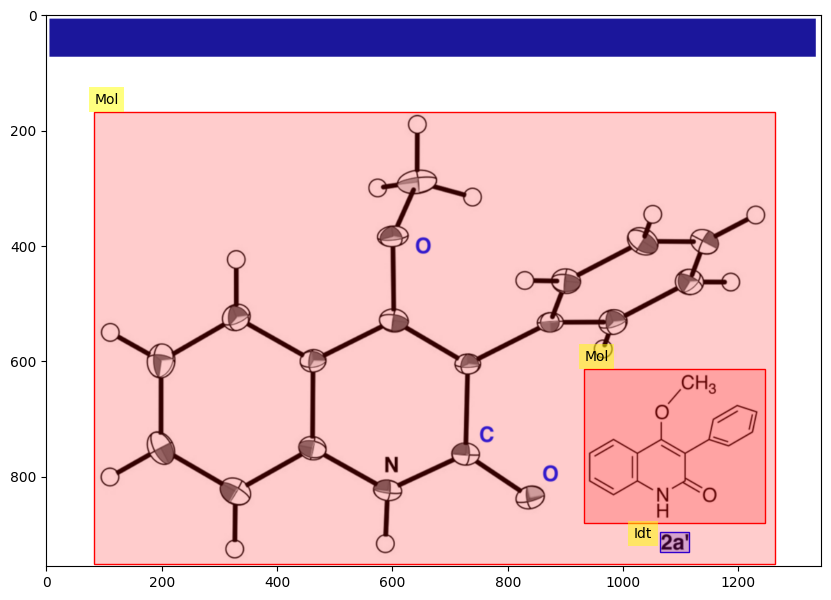

105
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.2748562666602423, 0.27463731865932967, 0.6970581608084496], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4012006003001501, 0.23046367376322724, 0.8839419709854928, 0.7461733699711045], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10083, 'image_id': 1292, 'category_id': 1, 'segmentation': [], 'area': 81375.0, 'bbox': [0.0, 166.0, 312.5, 260.4], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10084, 'image_id': 1292, 'category_id': 1, 'segmentation': [], 'area': 5550.84, 'bbox': [358.3, 266.8, 90.7, 61.2], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10085, 'image_id': 1292, 'category_id': 1, 'segmentation': [], 'area': 171821.55999999997, 'bbox': [460.2, 141.9, 554.8, 309.7], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index

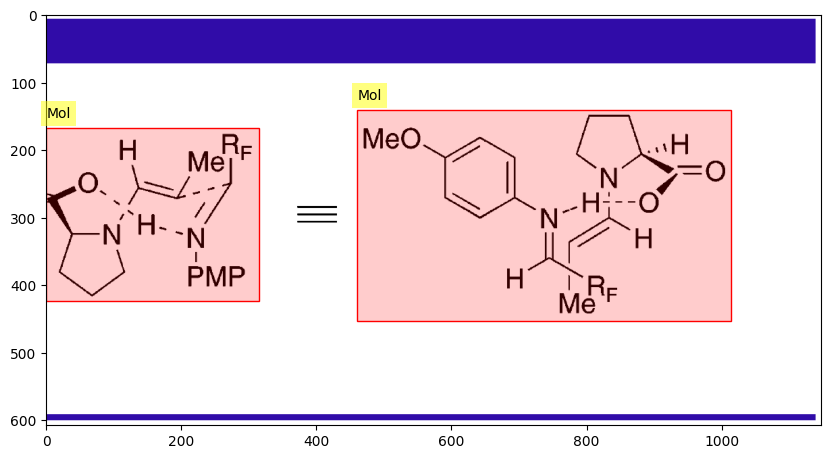

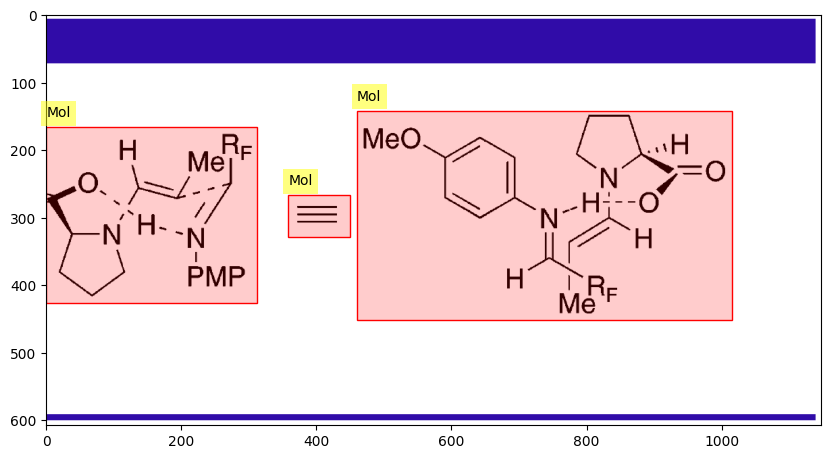

106
the prediction is
[{'category': '[Mol]', 'bbox': [0.05511582321773131, 0.0, 0.2851053077559188, 0.15257628814407204], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09117926310093824, 0.16508254127063532, 0.17351277679656155, 0.19109554777388693], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.055796265479678614, 0.447223611805903, 0.2898684035895499, 0.5147573786893447], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14221243274698575, 0.5227613806903452, 0.19120427560719136, 0.552776388194097], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.055796265479678614, 0.2206103051525763, 0.3000750375187594, 0.3806903451725863], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11295341548325184, 0.3901950975487744, 0.15309950893814253, 0.41870935467733866], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4048631458586436, 0.003501750875437719, 0.6355330726587785, 0.15457728

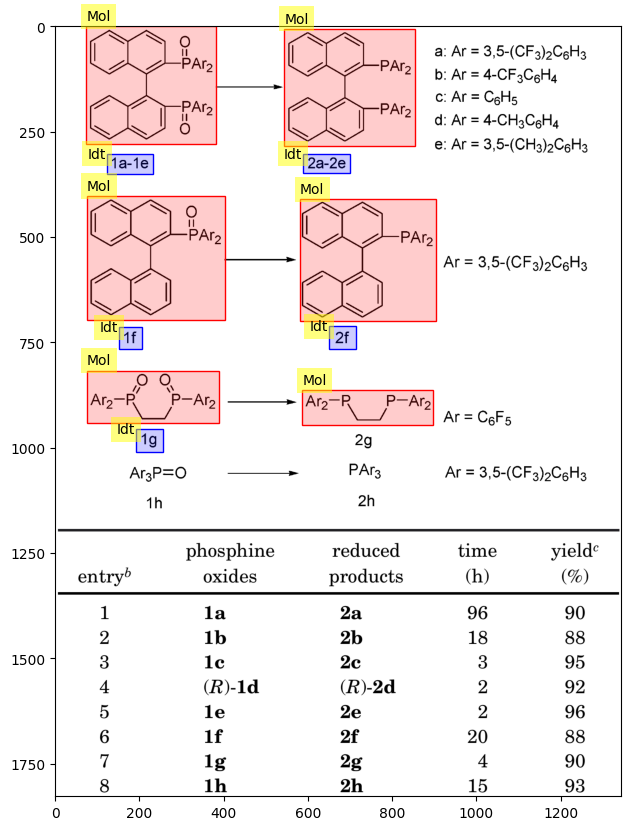

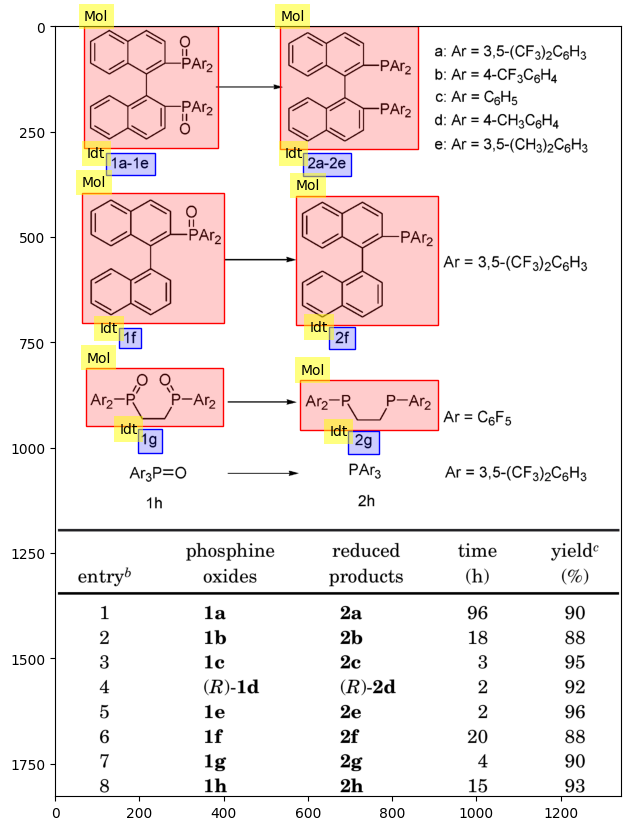

107
the prediction is
[{'category': '[Mol]', 'bbox': [0.057528764382191094, 0.1507505280134976, 0.24512256128064033, 0.3402072726791094], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14457228614307155, 0.3232308618667786, 0.1775887943971986, 0.3721229250062913], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.061030515257628815, 0.47330233344778294, 0.2911455727863932, 0.6763402067632595], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1890945472736368, 0.6451036108685707, 0.22111055527763882, 0.6939956740080835], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.21810905452726362, 0.7965331953145615, 0.3901950975487744, 0.9309863689482215], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2816408204102051, 0.9459256104630726, 0.3291645822911456, 0.9941386171700921], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.33616808404202103, 0.14667618941853816, 0.5632816408204102,

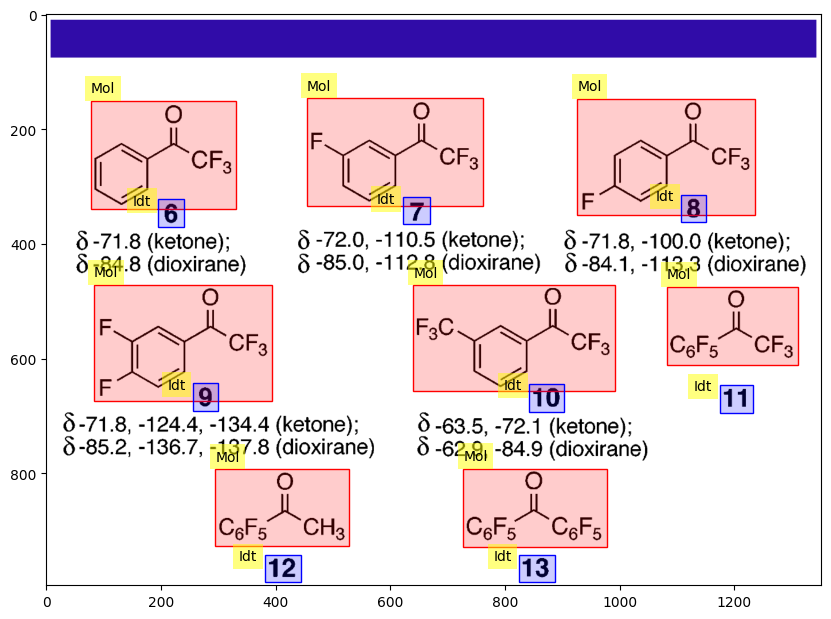

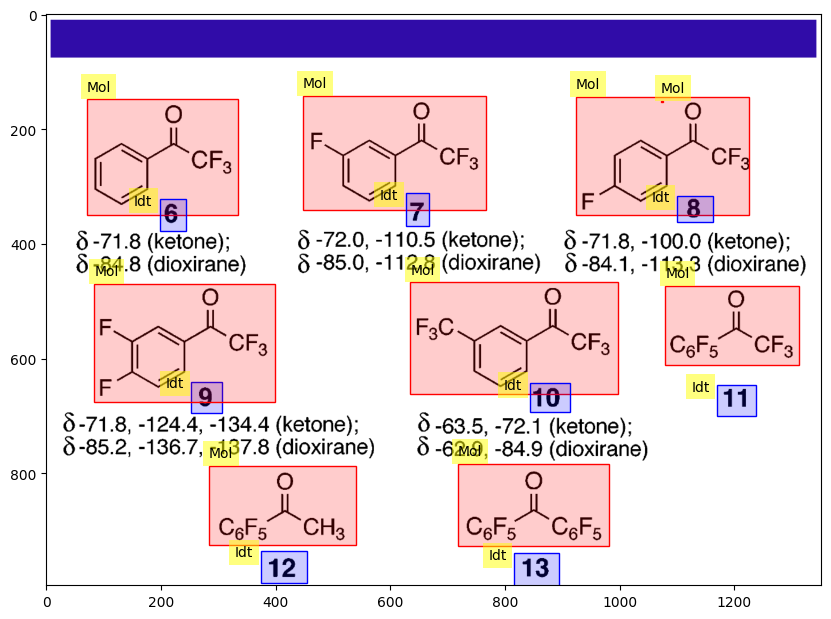

108
the prediction is
[{'category': '[Mol]', 'bbox': [0.07903644535173644, 0.1055527763881941, 0.37234947587929174, 0.3306653326663332], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1984692961054715, 0.32066033016508255, 0.2341820603014413, 0.35617808904452225], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.08313463140701166, 0.38469234617308656, 0.34834581469839393, 0.5412706353176588], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.19905475125622513, 0.5977988994497249, 0.2341820603014413, 0.6313156578289144], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4508004660802745, 0.14307153576788395, 0.7464553172108442, 0.26463231615807903], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6041897155777186, 0.32066033016508255, 0.6381461143214275, 0.35567783891945975], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.569647861683256, 0.38369184592296146, 0.7124989184671352

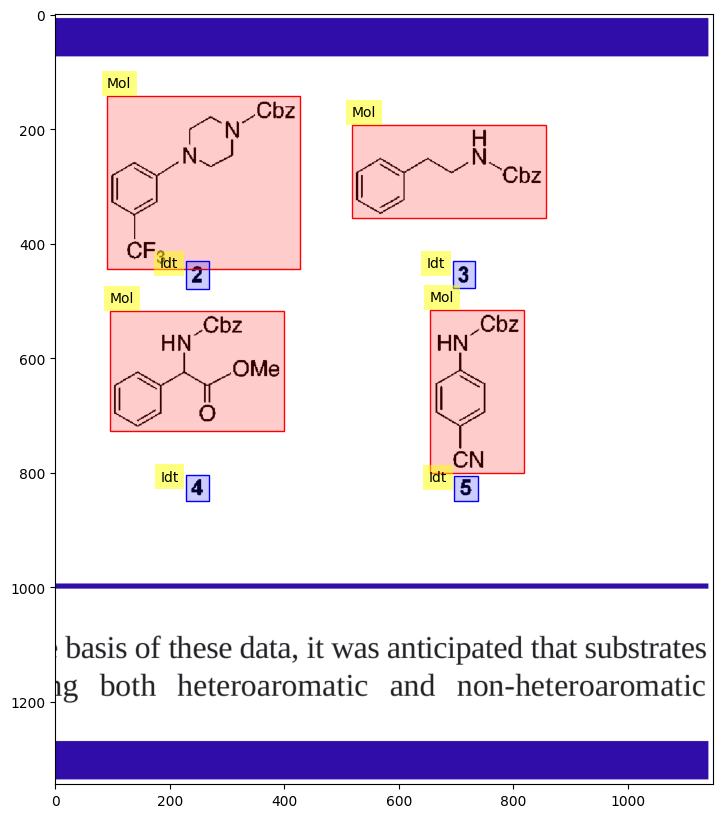

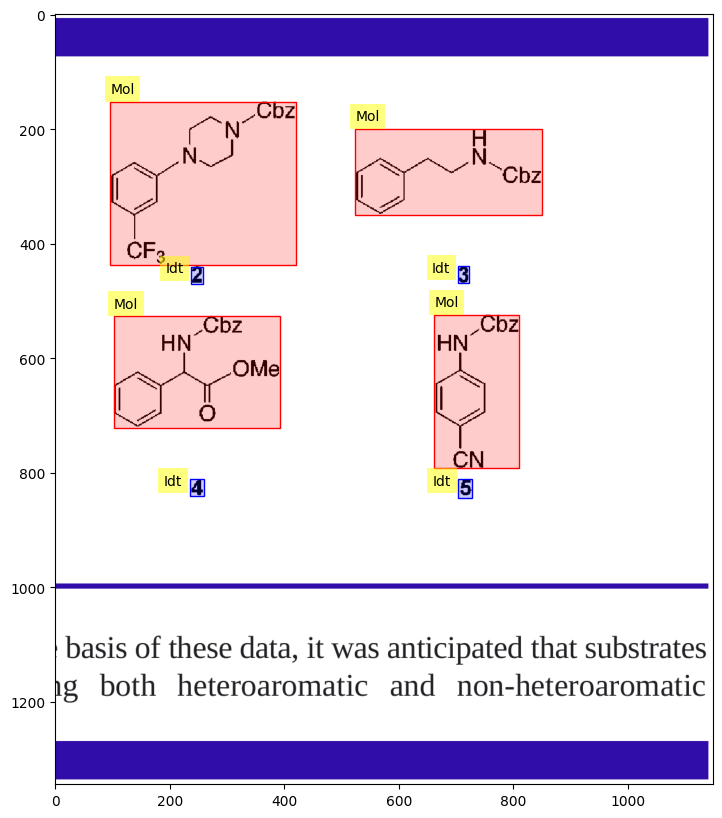

109
the prediction is
[{'category': '[Mol]', 'bbox': [0.11405702851425713, 0.2883603964144234, 0.8844422211105553, 1.0009432990923737], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4732366183091546, 0.8692402334223244, 0.5007503751875938, 0.9607392053615165], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10123, 'image_id': 1296, 'category_id': 1, 'segmentation': [], 'area': 356385.0, 'bbox': [159.0, 143.0, 1033.0, 345.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10124, 'image_id': 1296, 'category_id': 3, 'segmentation': [], 'area': 672.0, 'bbox': [649.0, 430.0, 21.0, 32.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating eva

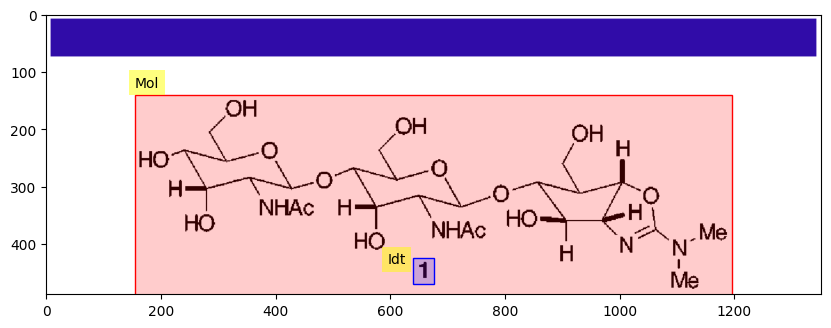

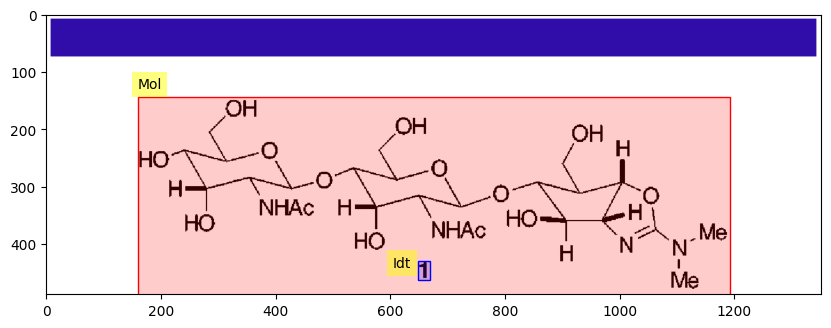

110
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.13529024127448339, 0.3626813406703352, 0.47511880940470236], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.577067379843768, 0.40820410205102553, 0.9335667833916957], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13206603301650827, 0.9284372955708623, 0.1775887943971986, 0.9912735213760726], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.43571785892946474, 0.15196107669219225, 0.8389194597298649, 0.47447762342709815], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5062531265632816, 0.49435438873282794, 0.752376188094047, 0.5597553584484549], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.46673336668334164, 0.6129737945896024, 0.8244122061030515, 0.9624201523838842], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6133066533266633, 0.9348491553469042, 0.6608304152076038, 0.9983265671297187], 'category_id

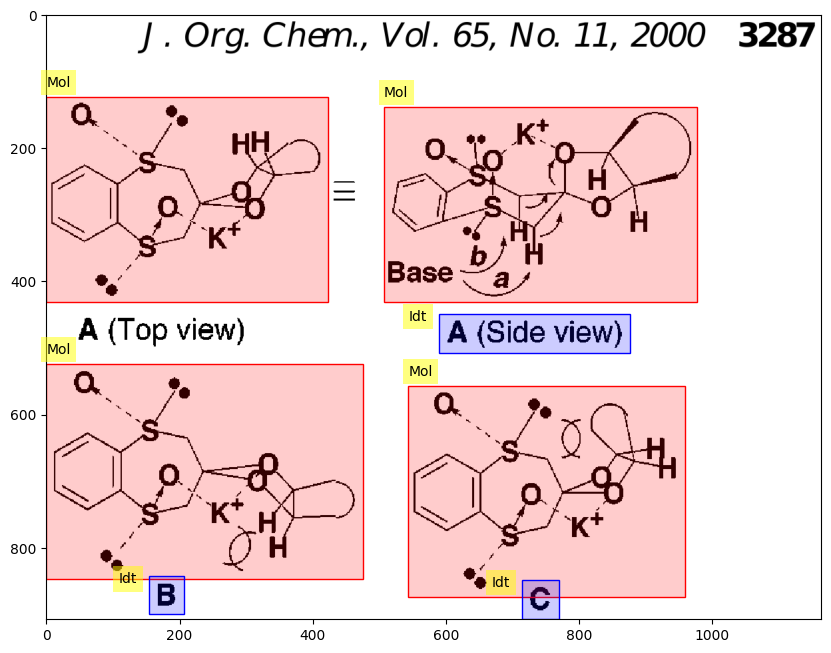

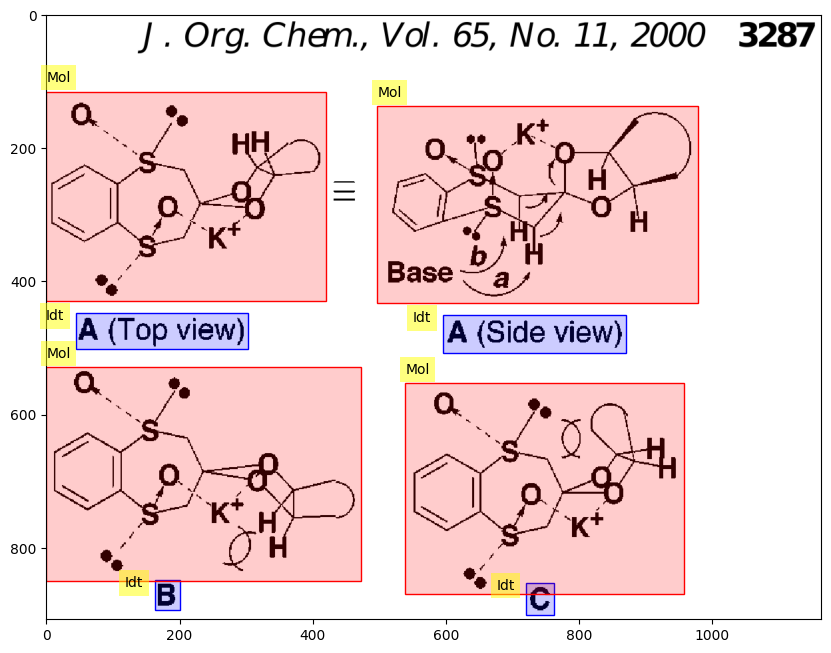

111
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.6233116558279139, 0.39336538965733825, 0.894447223611806], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.02959168949432635, 0.0065032516258129065, 0.378569544910175, 0.20410205102551277], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1719379199928962, 0.2206103051525763, 0.2387743221266333, 0.2836418209104552], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4454059470439121, 0.5572786393196598, 0.8479549644753516, 0.9444722361180591], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.575507340510347, 0.0, 0.9101995527220381, 0.2961480740370185], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5709155266232964, 0.32216108054027015, 0.6244866886388871, 0.38169084542271137], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10133, 'image_id': 1298, 'category_id': 1, 'segmentation': [], 'area': 97579.

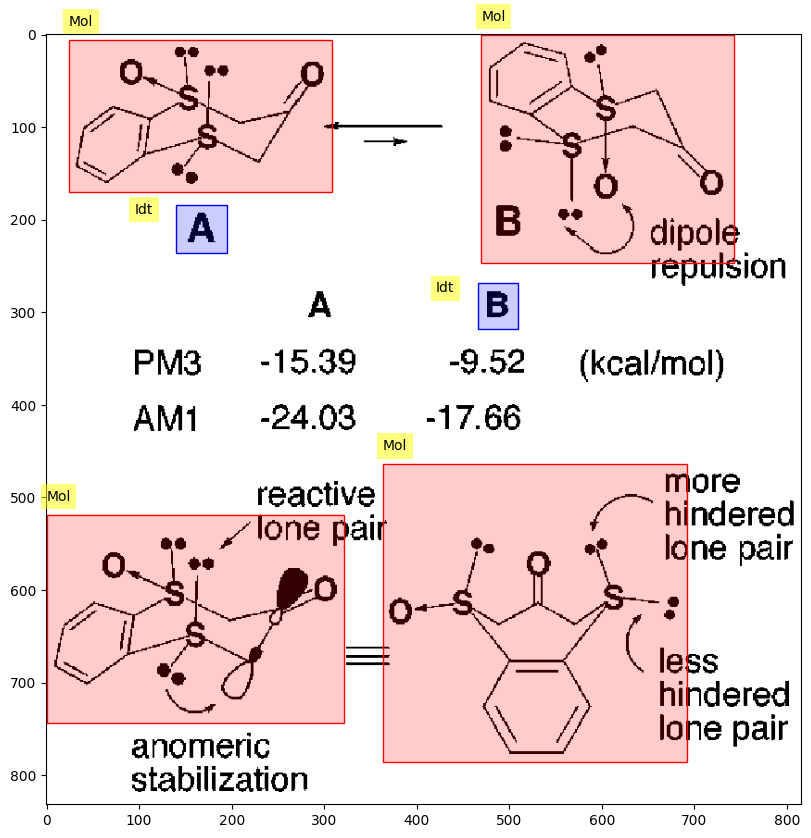

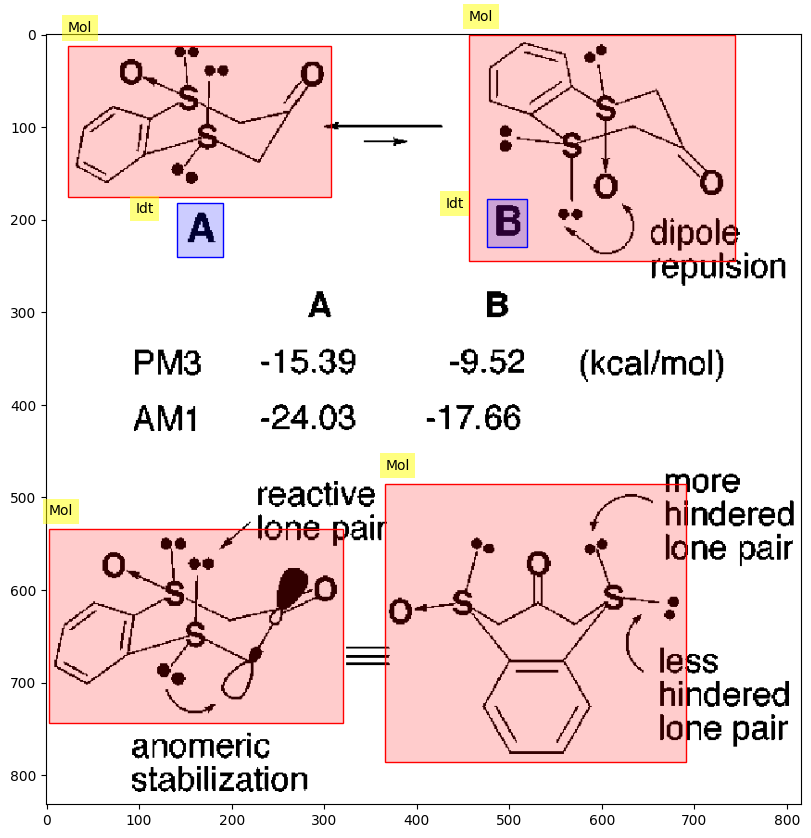

112
the prediction is
[{'category': '[Mol]', 'bbox': [0.3227876522153694, 0.05302651325662831, 0.47551040620981627, 0.16208104052026012], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10139, 'image_id': 1299, 'category_id': 1, 'segmentation': [], 'area': 34716.0, 'bbox': [445.0, 88.0, 210.4, 165.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10140, 'image_id': 1299, 'category_id': 1, 'segmentation': [], 'area': 24455.0, 'bbox': [698.0, 130.0, 365.0, 67.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10141, 'image_id': 1299, 'category_id': 3, 'segmentation': [], 'area': 3965.0, 'bbox': [792.0, 207.0, 65.0, 61.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10142, 'image_id': 1299, 'category_id': 3, 'segmentation': [], 'area': 28842.0, 'bbox': [469.0, 301.0, 437.0, 66.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into

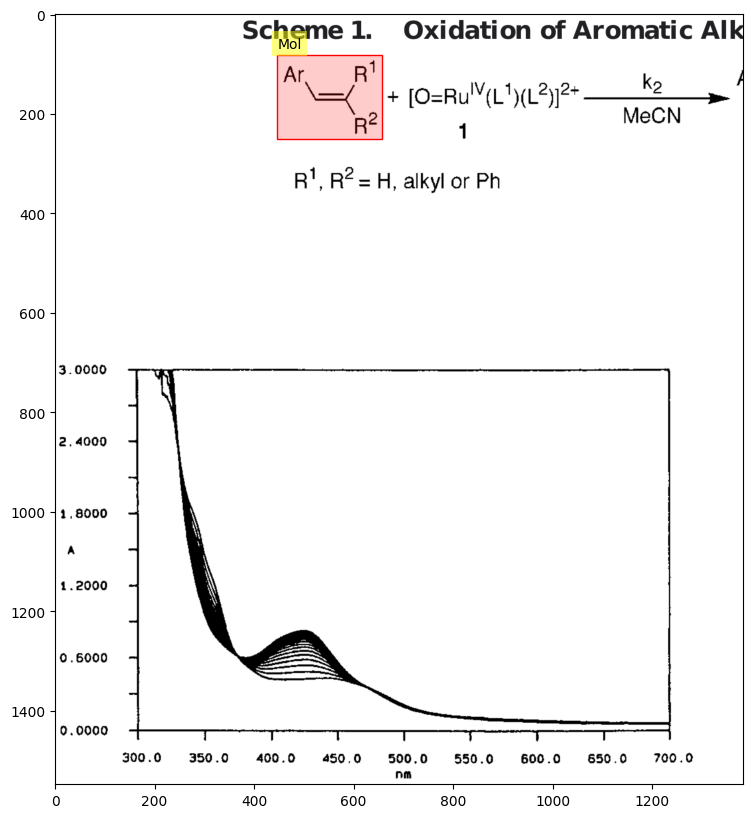

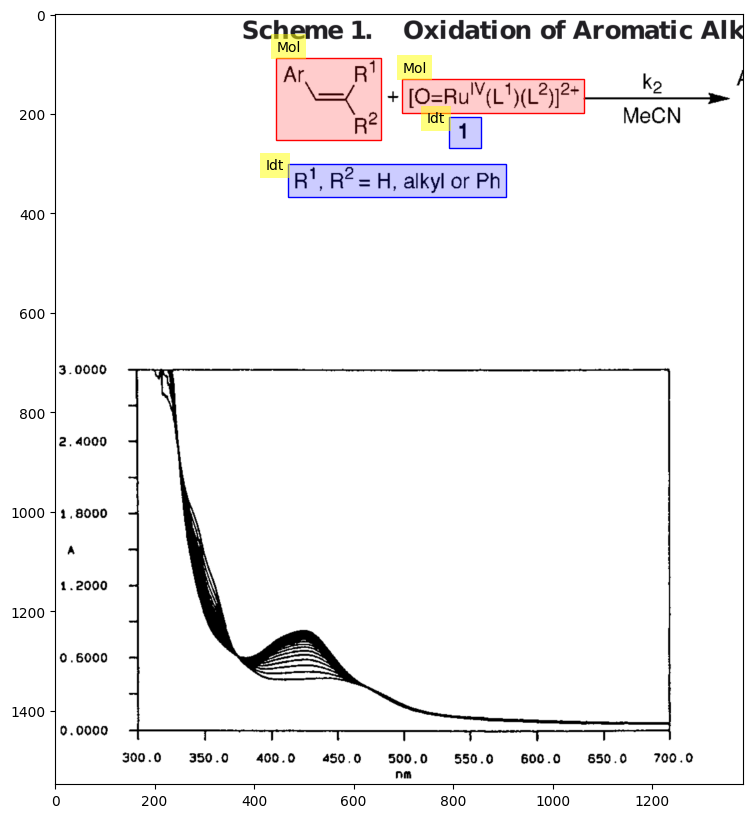

113
the prediction is
[{'category': '[Mol]', 'bbox': [0.3216608304152076, 0.0, 0.5622811405702851, 0.2841908016413077], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5907953976988495, 0.15021513801040548, 0.6753376688344173, 0.27810099874899397], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10143, 'image_id': 1300, 'category_id': 3, 'segmentation': [], 'area': 51798.0, 'bbox': [1650.0, 203.0, 267.0, 194.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10144, 'image_id': 1300, 'category_id': 1, 'segmentation': [], 'area': 268995.0, 'bbox': [903.0, 2.0, 681.0, 395.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation resu

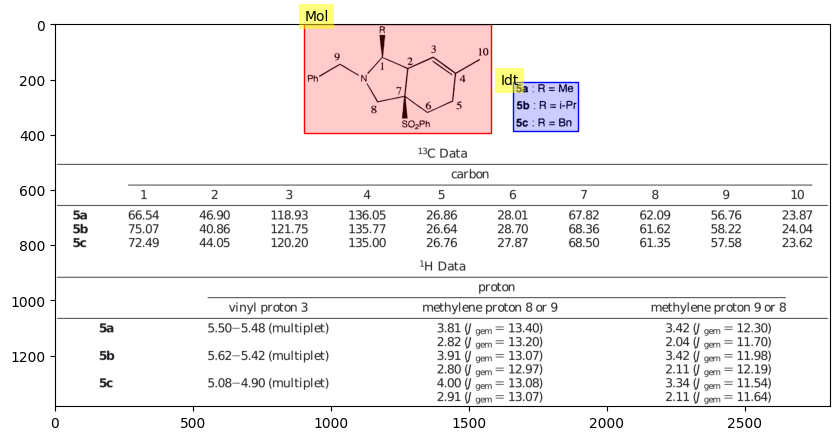

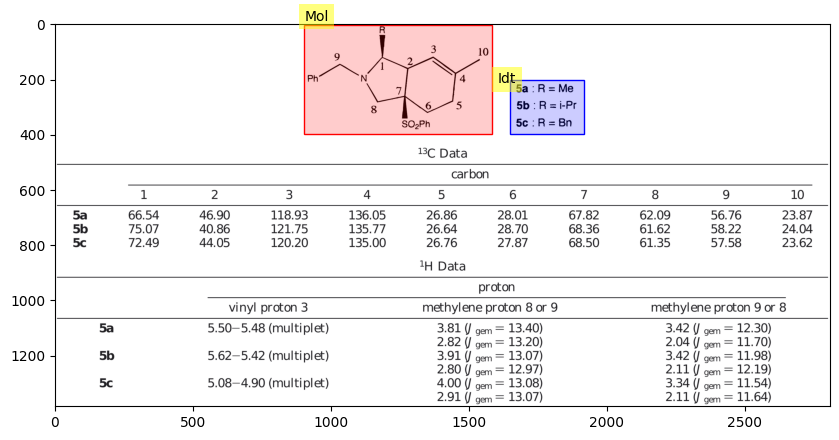

114
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.1455968158751865, 0.12756378189094547], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.061878646746954265, 0.7223611805902952, 0.9791385867606293, 1.0], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10145, 'image_id': 1301, 'category_id': 1, 'segmentation': [], 'area': 739195.2000000001, 'bbox': [81.6, 1476.0, 1301.4, 568.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10146, 'image_id': 1301, 'category_id': 1, 'segmentation': [], 'area': 57835.0, 'bbox': [0.0, 3.0, 215.0, 269.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).

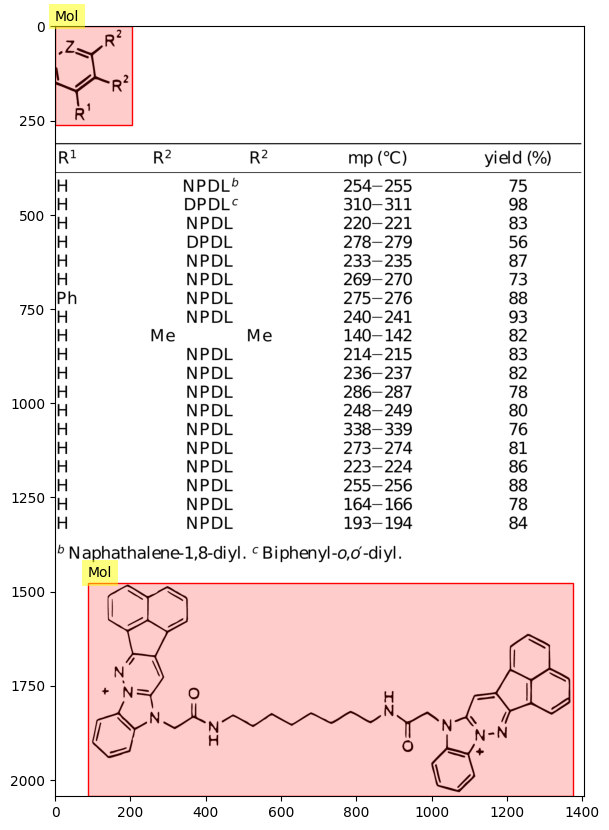

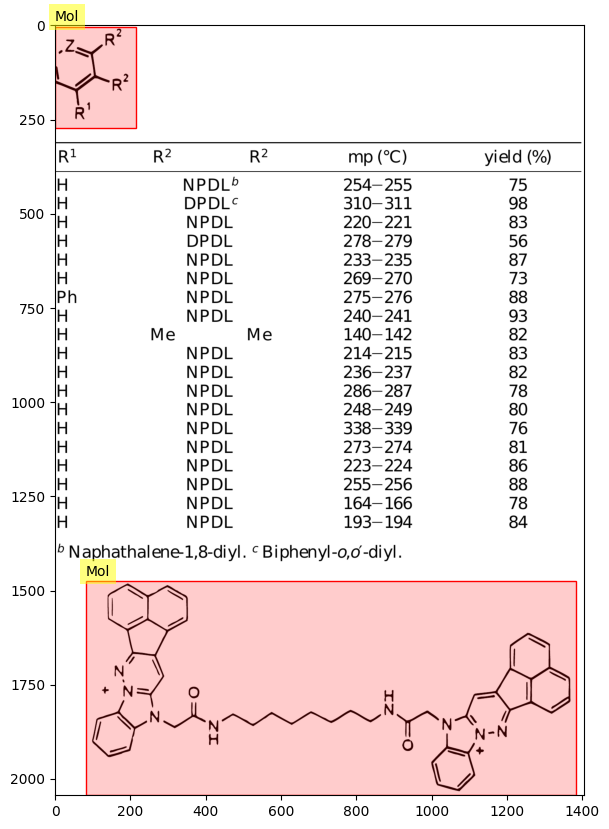

115
the prediction is
[{'category': '[Mol]', 'bbox': [0.4062031015507754, 0.8242142434391152, 0.6123061530765382, 0.9341094758976639], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.43871935967983994, 0.9497118854442481, 0.5867933966983492, 0.9951623828190799], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6423211605802901, 0.7760502835344427, 0.8149074537268635, 0.9354662071625843], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7263631815907954, 0.9503902510767082, 0.7538769384692346, 0.9910921890243188], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10147, 'image_id': 1302, 'category_id': 3, 'segmentation': [], 'area': 8461.8, 'bbox': [646.2, 946.0, 156.7, 54.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10148, 'image_id': 1302, 'category_id': 1, 'segmentation': [], 'area': 31196.25, 'bbox': [554.9, 824.2, 277.3, 112.5], 'iscrowd': 0, 'attributes': {'occl

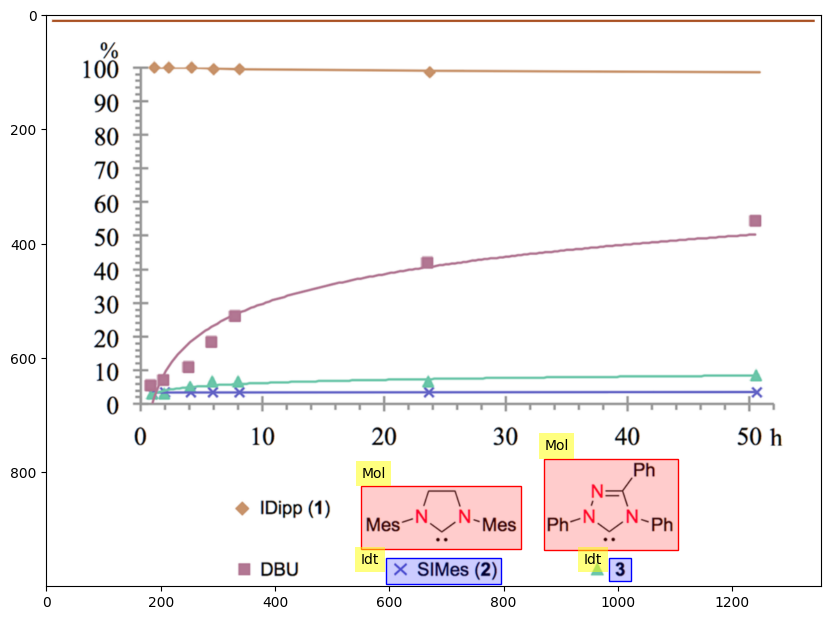

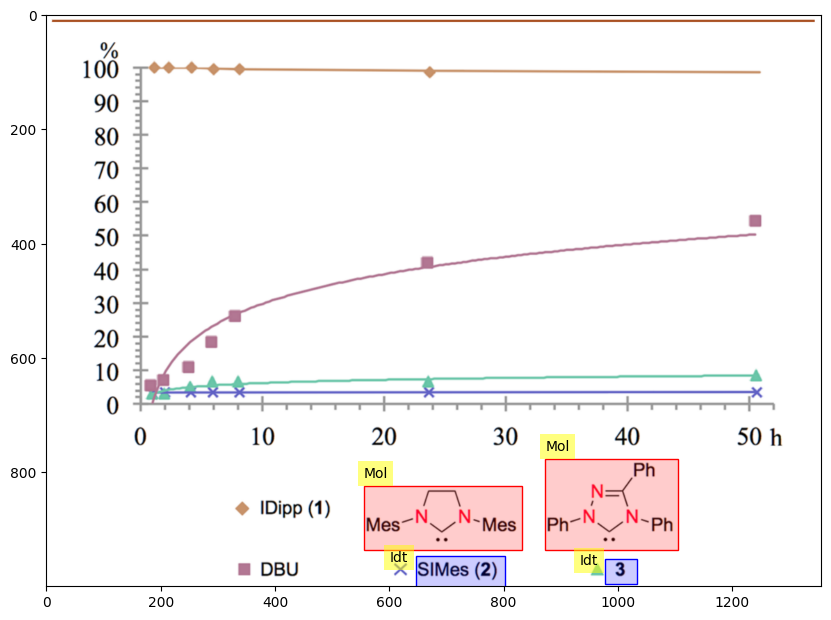

116
the prediction is
[{'category': '[Mol]', 'bbox': [0.027013506753376687, 0.1050131364895046, 0.9709854927463731, 0.7998500562617267], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10151, 'image_id': 1303, 'category_id': 3, 'segmentation': [], 'area': 13805.000000000002, 'bbox': [512.7, 335.0, 276.1, 50.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10152, 'image_id': 1303, 'category_id': 1, 'segmentation': [], 'area': 344112.0, 'bbox': [33.7, 44.5, 1284.0, 268.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 1.000
 Average Precision

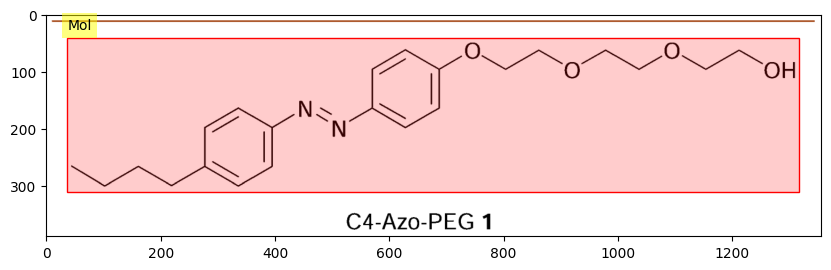

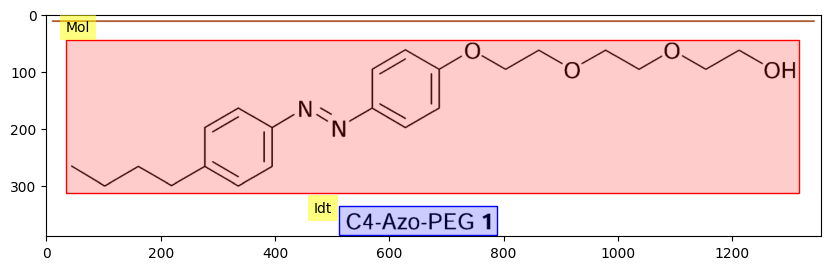

117
the prediction is
[{'category': '[Mol]', 'bbox': [0.07873454799689002, 0.0560280140070035, 0.5864920412013236, 0.3441720860430215], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.31922306534793504, 0.31465732866433216, 0.3476103513604192, 0.3476738369184592], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.1837139453260767, 0.6458229114557279, 0.7862742616288064, 1.0], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5714949844400112, 0.9354677338669335, 0.6047027529829172, 0.9694847423711856], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.19174808287677977, 0.38469234617308656, 0.6454090499064794, 0.7013506753376688], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.43116538188773107, 0.673336668334167, 0.4627663229204964, 0.7083541770885443], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4659799779407776, 0.026013006503251626, 0.9196409449704772, 0.3416708354177089

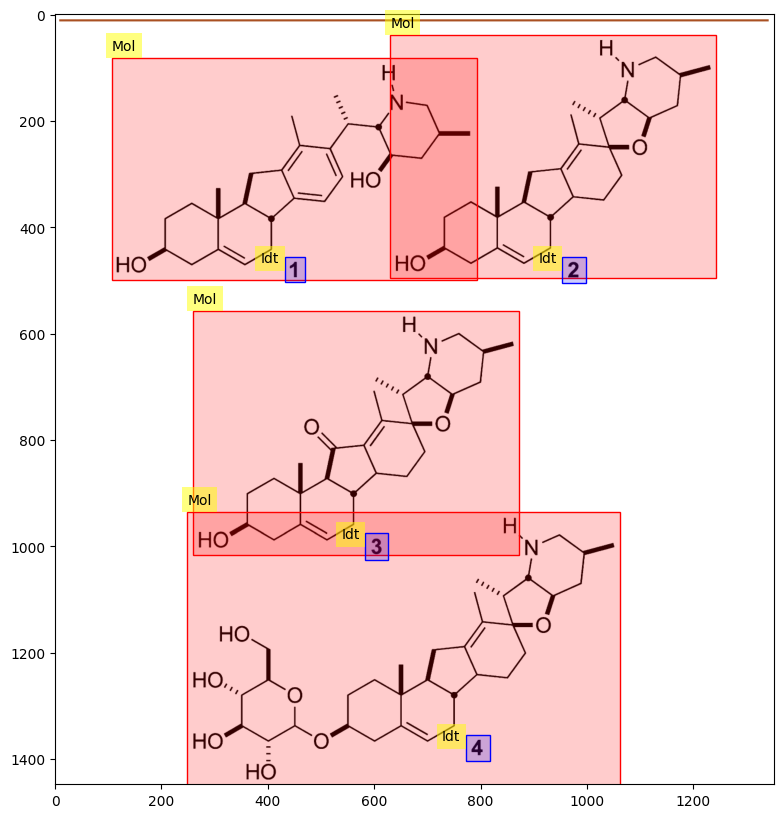

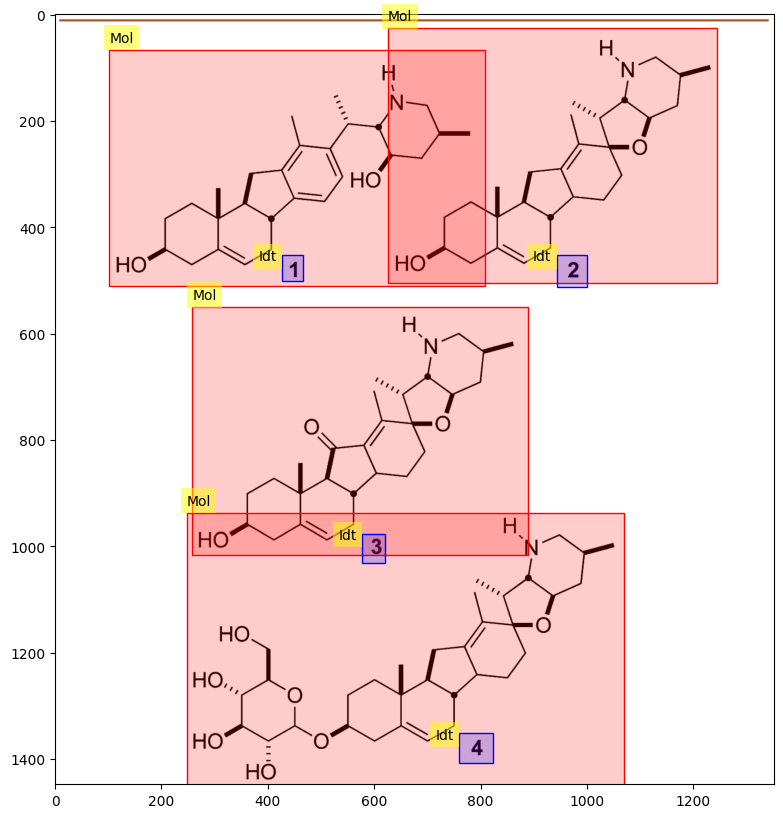

118
the prediction is
[{'category': '[Mol]', 'bbox': [0.31465732866433216, 0.08087634780529386, 0.4242121060530265, 0.23787161119204075], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5267633816908455, 0.0023787161119204073, 0.6843421710855427, 0.2909962710249298], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5502751375687844, 0.5280749768463304, 0.663831915957979, 0.5851641635324202], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.5502751375687844, 0.6652476059670739, 0.6368184092046023, 0.7223367926531636], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5502751375687844, 0.7350232785834059, 0.6123061530765382, 0.7913195598988555], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10161, 'image_id': 1305, 'category_id': 1, 'segmentation': [], 'area': 50851.0, 'bbox': [708.0, 1.0, 211.0, 241.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 101

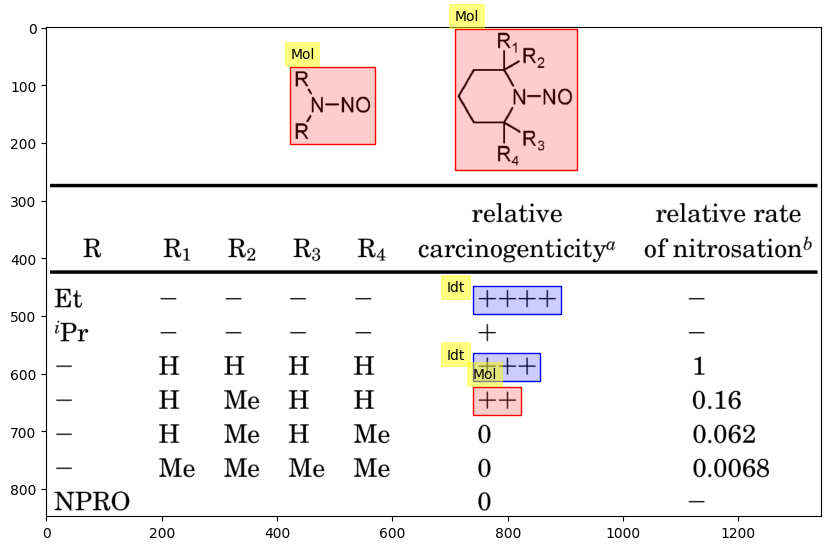

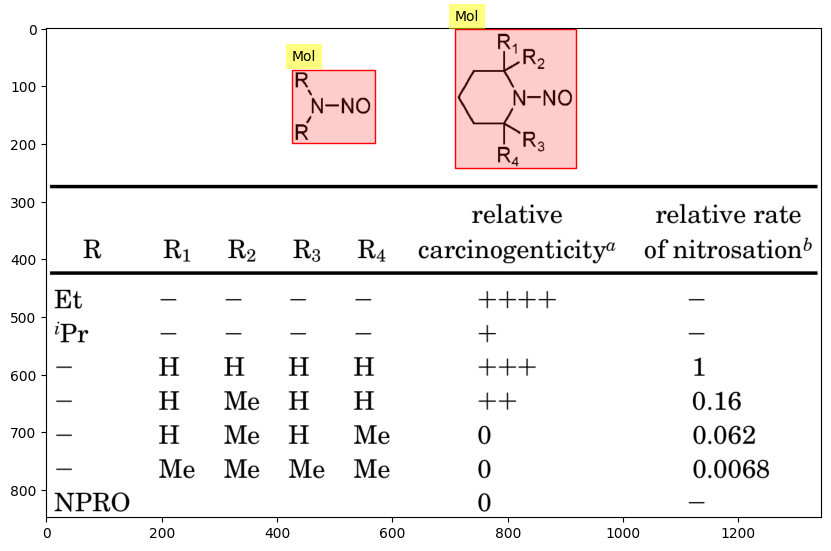

119
the prediction is
[{'category': '[Mol]', 'bbox': [0.1455727863931966, 0.07384396896434794, 0.43571785892946474, 0.7563412578772607], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2226113056528264, 0.7619354979503173, 0.3486743371685843, 0.8536810351484467], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4842421210605303, 0.10181516932963125, 0.8524262131065533, 0.7574601058918721], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6298149074537268, 0.7619354979503173, 0.7603801900950475, 0.8570375791922807], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10163, 'image_id': 1306, 'category_id': 1, 'segmentation': [], 'area': 194003.91999999998, 'bbox': [657.1, 66.3, 493.9, 392.8], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10164, 'image_id': 1306, 'category_id': 1, 'segmentation': [], 'area': 161708.04, 'bbox': [198.5, 46.0, 392.4, 412.1], 'iscrowd': 0, 'attri

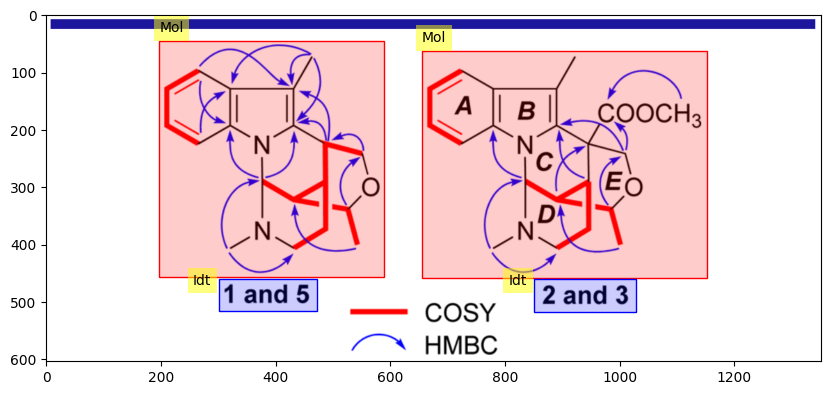

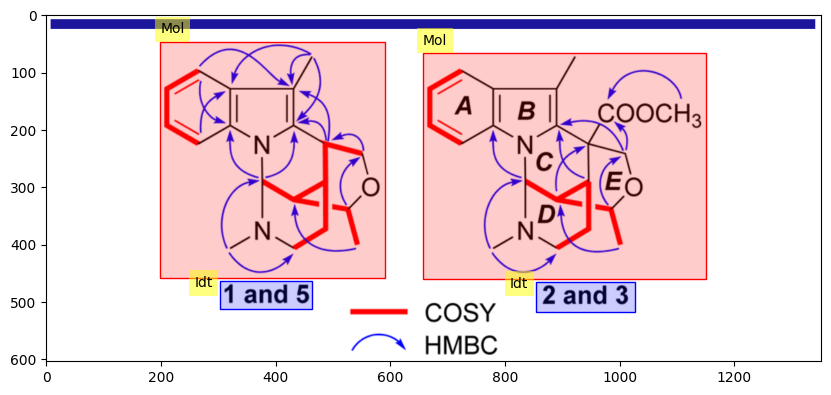

120
the prediction is
[{'category': '[Mol]', 'bbox': [0.2441787070005591, 0.34067033516758377, 0.4765897654709707, 0.43421710855427714], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.24810125651060821, 0.4517258629314657, 0.4765897654709707, 0.551775887943972], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2520238060206574, 0.11455727863931967, 0.4746284907159462, 0.2016008004002001], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2530044433981697, 0.6868434217108554, 0.4746284907159462, 0.7858929464732366], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.25594635553070655, 0.8024012006003002, 0.4736478533384339, 0.886943471735868], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.25594635553070655, 0.5692846423211606, 0.4746284907159462, 0.6683341670835418], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.25594635553070655, 0.23611805902951477, 0.4765897654709707, 0.32

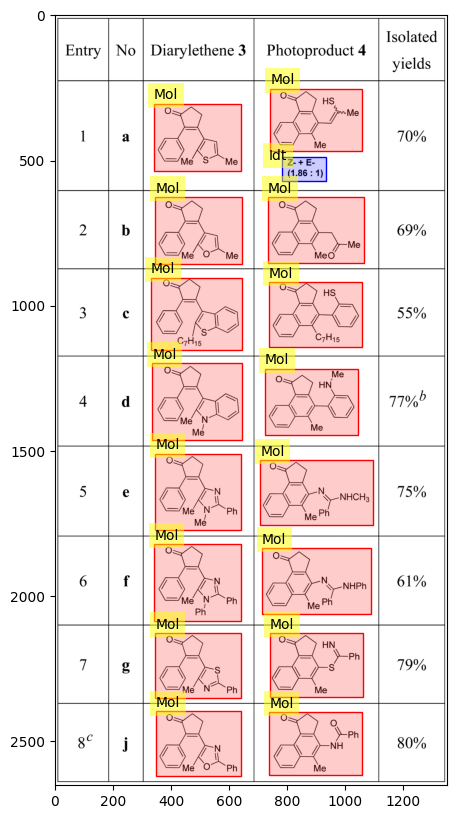

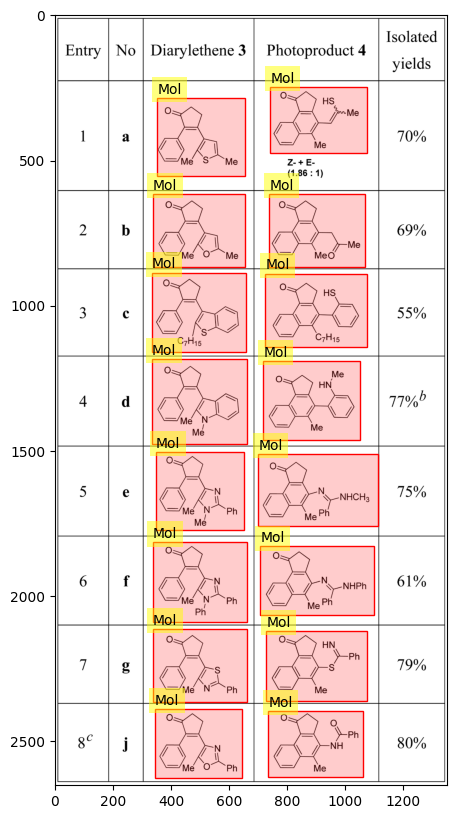

121
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.456005089578537, 0.008504252126063032, 0.7651410074486622], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.10105052526263132, 0.45541287517648704, 0.4827413706853427, 0.7657332218507121], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.15407703851925963, 0.05507593939065448, 0.4352176088044022, 0.258205479293821], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10183, 'image_id': 1308, 'category_id': 1, 'segmentation': [], 'area': 97112.0, 'bbox': [215.0, 64.0, 398.0, 244.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10184, 'image_id': 1308, 'category_id': 1, 'segmentation': [], 'area': 200508.0, 'bbox': [142.0, 542.0, 539.0, 372.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=

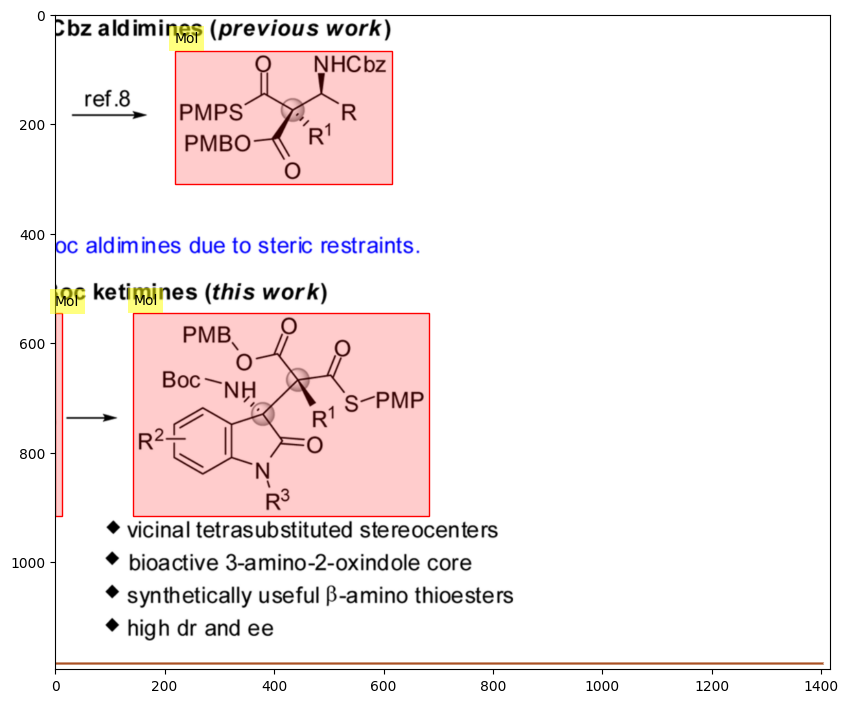

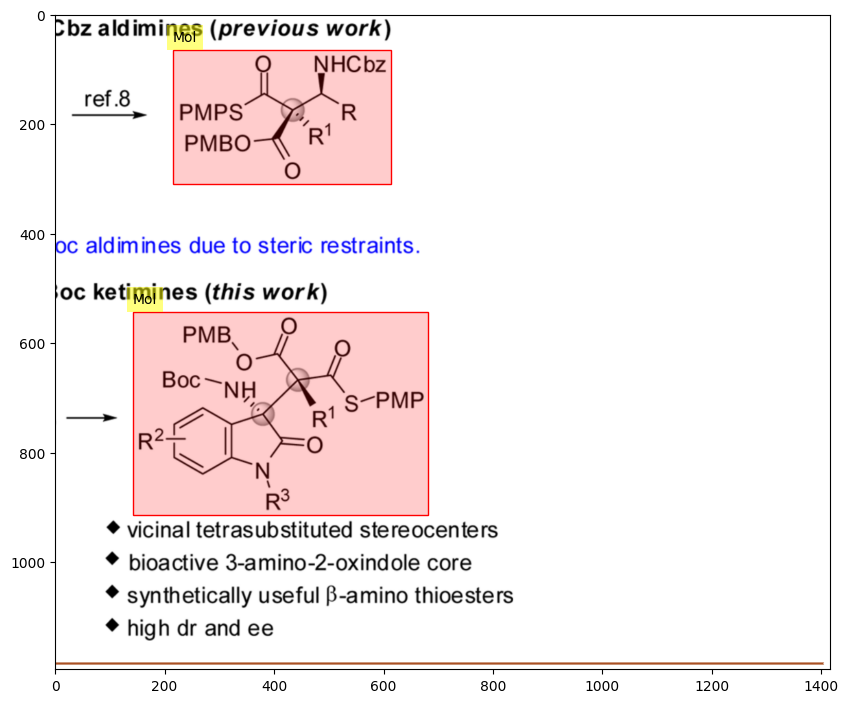

122
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.04721677608990831, 0.35967983991996, 0.48956341524799674], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14107053526763383, 0.47879467684152643, 0.16408204102051024, 0.5342950978594887], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.05252626313156578, 0.5798551449637863, 0.28714357178589295, 0.8358197732406577], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.13356678339169584, 0.8606707080248199, 0.17258629314657328, 0.9120293065787553], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.29964982491245623, 0.5765416869925646, 0.6353176588294147, 0.8631558015032361], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.43721860930465234, 0.8598423435320145, 0.46673336668334164, 0.9070591196219228], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3506753376688344, 0.049701869568324536, 0.6738369184592297, 0.48790668626

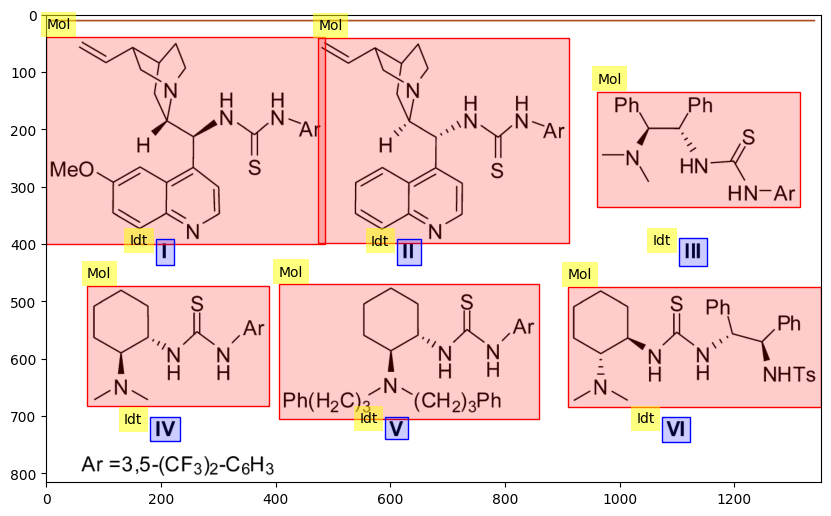

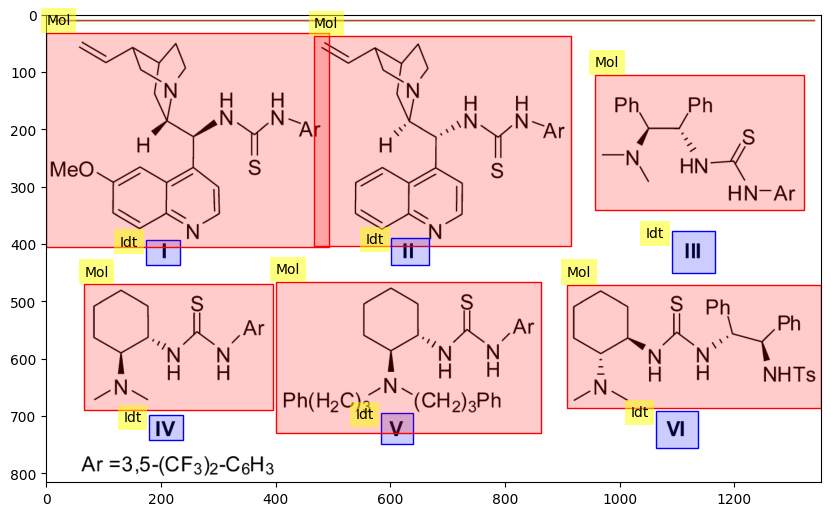

123
the prediction is
[{'category': '[Mol]', 'bbox': [0.018509254627313655, 0.06517920614442559, 0.21260630315157578, 0.2112952287099511], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09354677338669334, 0.2234715639237449, 0.12156078039019509, 0.26644686467831125], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.021510755377688845, 0.37531762658987927, 0.3326663331665833, 0.6045192306142331], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.208104052026013, 0.5336099843691985, 0.24712356178089045, 0.5801665601866454], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.04502251125562781, 0.6661171616957781, 0.2466233116558279, 0.8423158947895], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.15907953976988495, 0.8201119893996407, 0.19459729864932465, 0.8616547801290549], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.24862431215607803, 0.6517920614442559, 0.5117558779389695,

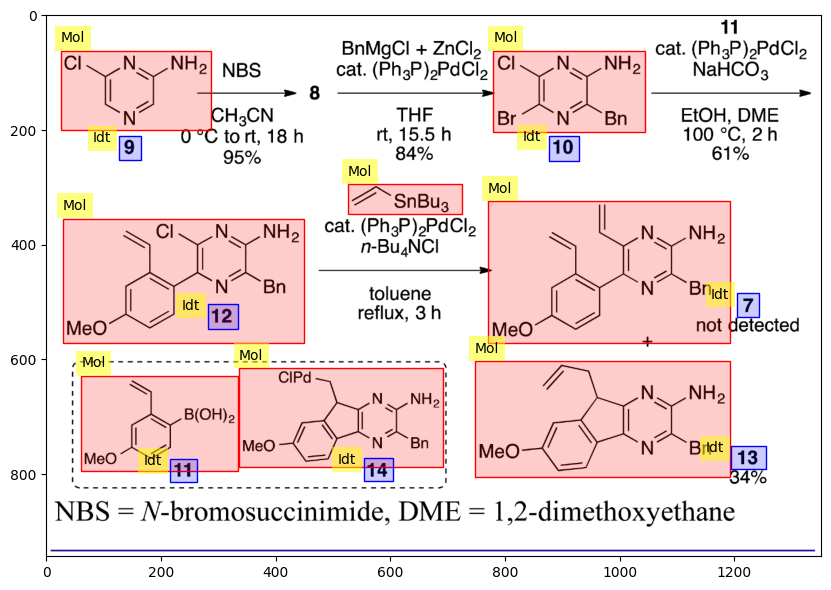

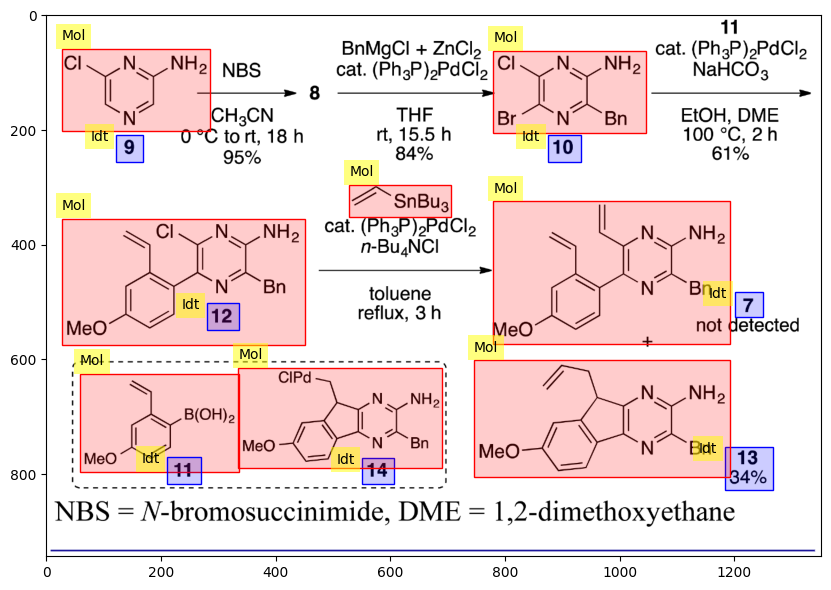

124
the prediction is
[{'category': '[Mol]', 'bbox': [0.06603301650825413, 0.05106382019838748, 0.39119559779889945, 0.3814767744232476], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2016008004002001, 0.3404254679892499, 0.26463231615807903, 0.40550680745778295], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3536768384192096, 0.4896119230786564, 0.6543271635817909, 0.8700874461254652], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.46323161580790395, 0.8550686754788805, 0.527263631815908, 0.9181475121945357], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6353176588294147, 0.006007508258633822, 0.9319659829914958, 0.3854817799290035], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6998499249624812, 0.3404254679892499, 0.7628814407203601, 0.40550680745778295], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10212, 'image_id': 1311, 'category_id': 3, '

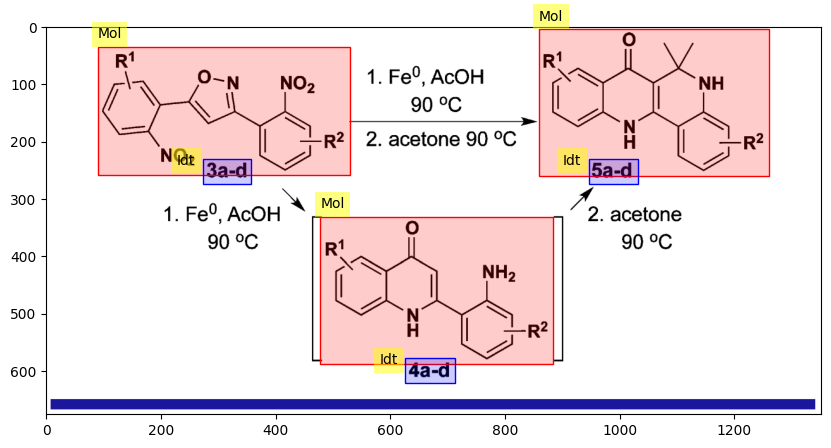

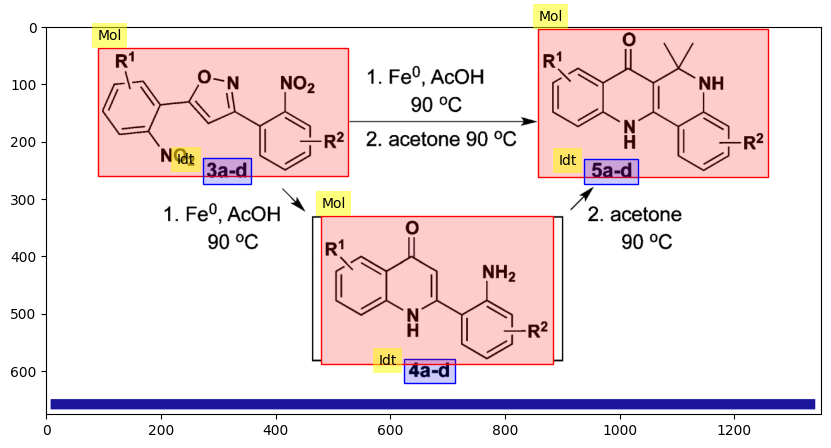

125
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.2061030515257629, 0.5432990597378083], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3416708354177089, 0.0, 0.5502751375687844, 0.5357357317600199], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4732366183091546, 0.5332146224340903, 0.5052526263131566, 0.6302773314823764], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3571785892946473, 0.6617911980564952, 0.5807903951975988, 0.9214654586272342], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.47873936968484243, 0.9139021306494457, 0.5102551275637819, 1.004662066382908], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10218, 'image_id': 1312, 'category_id': 1, 'segmentation': [], 'area': 39291.1245, 'bbox': [446.26, 325.85, 289.95, 135.51], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10219, 'image_id': 1312, 'category_id': 1, '

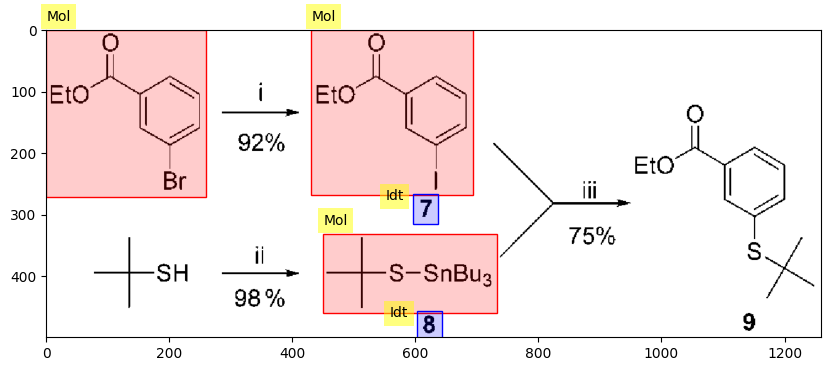

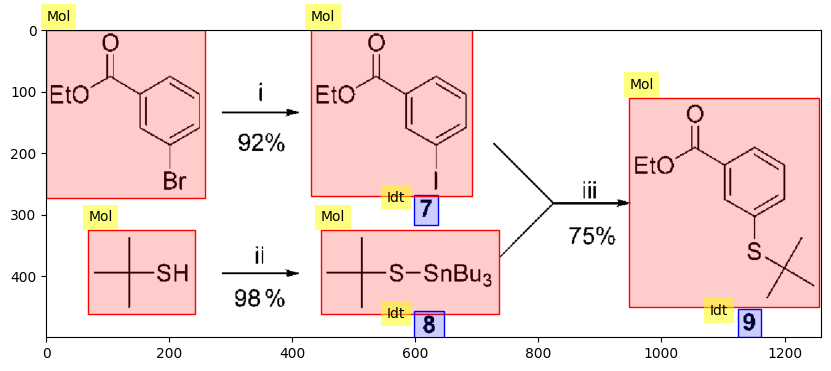

126
the prediction is
[{'category': '[Mol]', 'bbox': [0.058726806585110744, 0.5067533766883442, 0.3618329050889081, 0.7148574287143572], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.18944131156487337, 0.7183591795897949, 0.22606663180074887, 0.7398699349674838], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10419272136068035, 0.013506753376688344, 0.29552844604120243, 0.11405702851425713], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.18375807221792714, 0.12456228114057029, 0.21848897933815392, 0.14657328664332167], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.19386160883472042, 0.735367683841921, 0.526646846150348, 0.9444722361180591], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3428887739324208, 0.951975987993997, 0.37888262312974674, 0.9734867433716858], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2639548941137235, 0.15457728864432216, 0.493178881107220

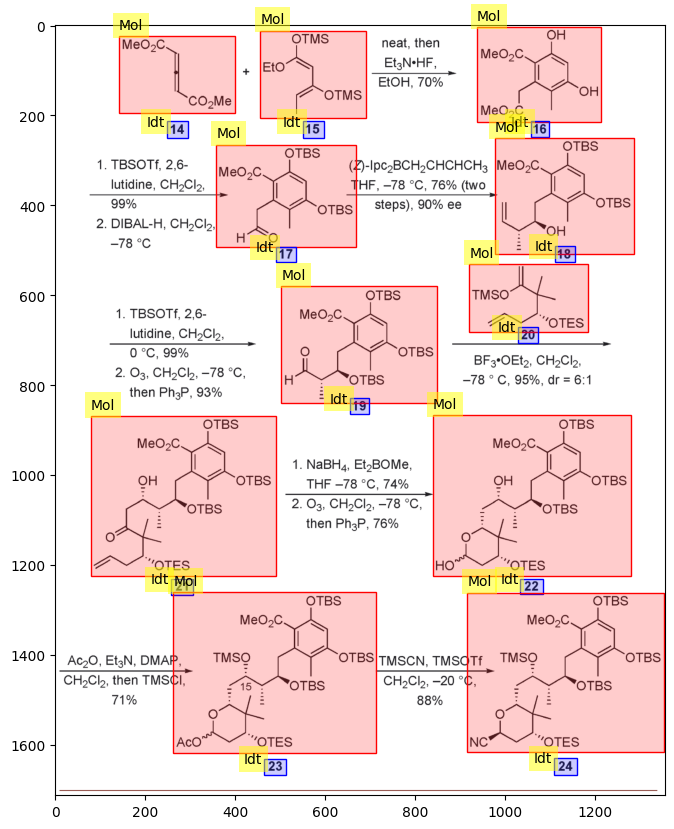

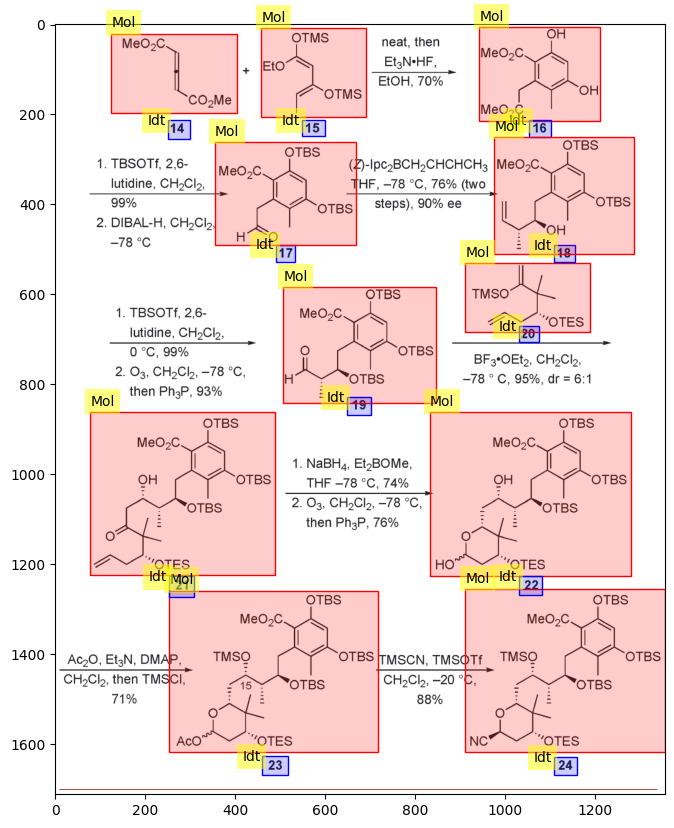

127
the prediction is
[{'category': '[Mol]', 'bbox': [0.002001000500250125, 0.38296730229094395, 0.13056528264132067, 0.5492557361804328], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.03901950975487744, 0.5694119099852193, 0.11055527763881941, 0.6399585183019721], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.20060030015007504, 0.3712095342381518, 0.3311655827913957, 0.5492557361804328], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.423711855927964, 0.36785017193735403, 0.4912456228114057, 0.5408573304284384], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4347173586793397, 0.5660525476844215, 0.4577288644322161, 0.6231617067979833], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5157578789394698, 0.3863266645917417, 0.567783891945973, 0.5207011566236518], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5377688844422212, 0.5660525476844215, 0.5607803901950975, 0.62

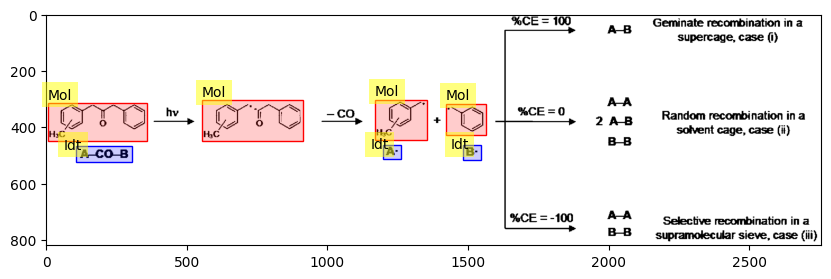

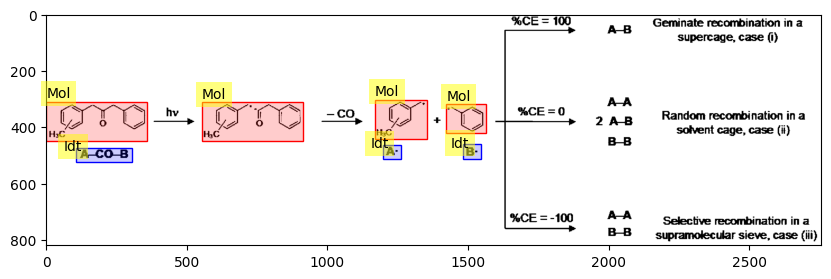

128
the prediction is
[{'category': '[Mol]', 'bbox': [0.11505752876438219, 0.04110616952311772, 0.304152076038019, 0.8061376578700309], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2066033016508254, 0.844960151308531, 0.23311655827913957, 1.0071011533163843], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3456728364182091, 0.013702056507705907, 0.5352676338169085, 0.883782644747031], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.45222611305652827, 0.8472438273931486, 0.4867433716858429, 1.0116685054856196], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10255, 'image_id': 1315, 'category_id': 3, 'segmentation': [], 'area': 1897.8493999999998, 'bbox': [276.62, 251.46, 42.61, 44.54], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10256, 'image_id': 1315, 'category_id': 3, 'segmentation': [], 'area': 2017.3244, 'bbox': [615.47, 250.11, 43.96, 45.89], 'iscrowd': 0, 

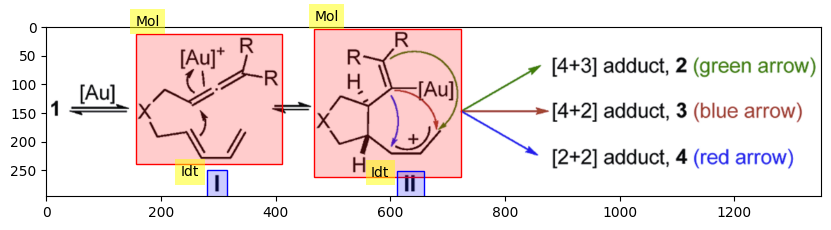

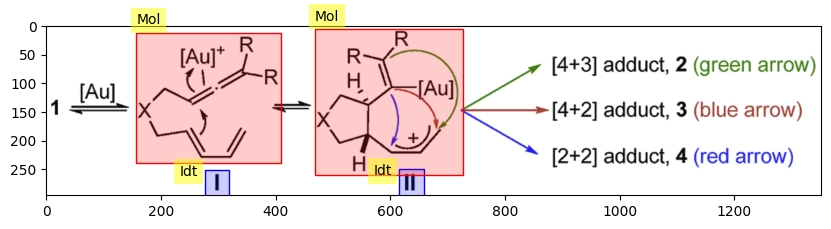

129
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.6859403913991379, 0.3901950975487744, 0.9547118353828299], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.23761880940470234, 0.9445214488810786, 0.2836418209104552, 0.9910150872953191], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.003501750875437719, 0.3356458554014352, 0.40070035017508754, 0.6050541985414866], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.23411705852926462, 0.5916793162579379, 0.2786393196598299, 0.6407205512976164], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.014507253626813406, 0.022928369628940543, 0.30865432716358177, 0.22100400725673247], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.14157078539269635, 0.2534858642310649, 0.17358679339669836, 0.29870570433258653], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4467233616808404, 0.0019106974690783788, 0.830915457

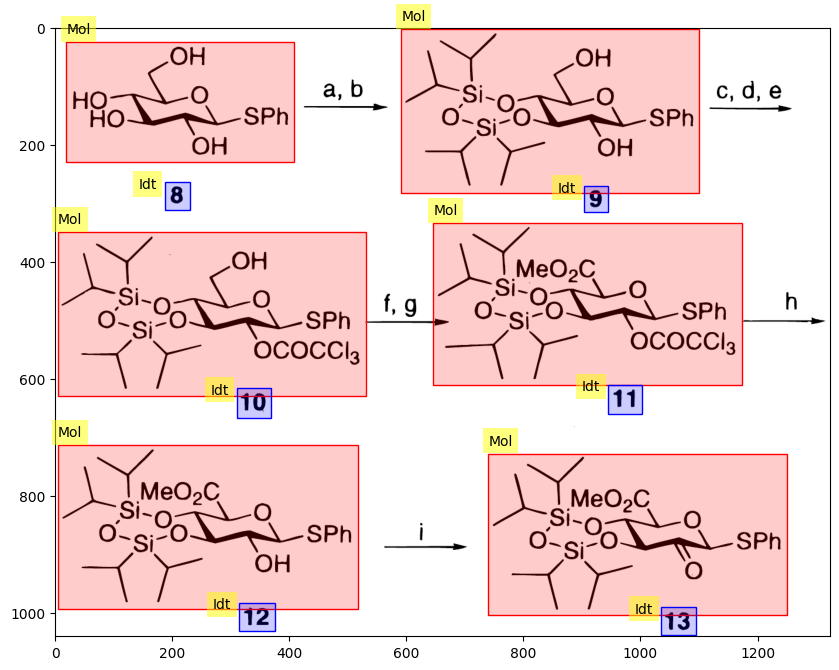

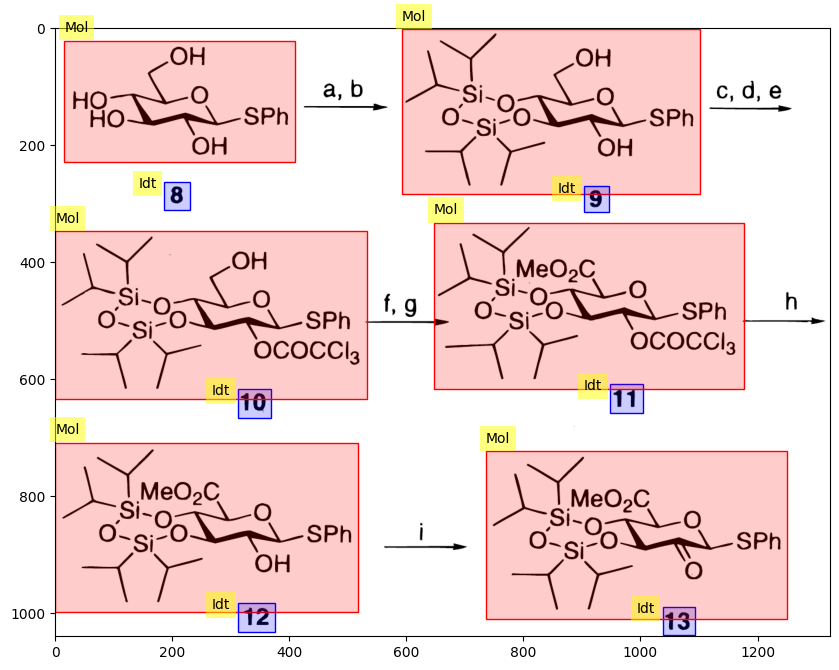

130
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.28564053368147485, 0.21410705352676337], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.05692480386534731, 0.23561780890445222, 0.19008818433607047, 0.29364682341170584], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.009656886370014276, 0.6998499249624812, 0.3634038818189583, 0.9259629814907454], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.06505691870325406, 0.9409704852426213, 0.265310246586708, 1.0], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3069873351309801, 0.3501750875437719, 0.5916113544577166, 0.5722861430715358], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.353746995448944, 0.5877938969484743, 0.4838608328554521, 0.6438219109554777], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6805563604973218, 0.006003001500750375, 0.9667051513561659, 0.2306153076538269], 'category_id': 1, 'score'

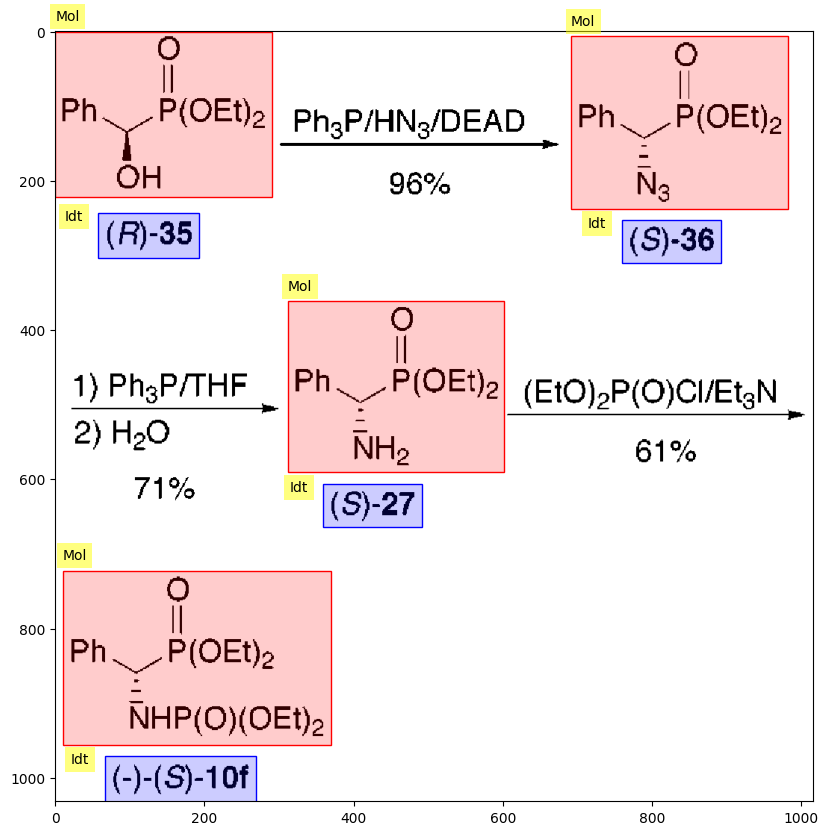

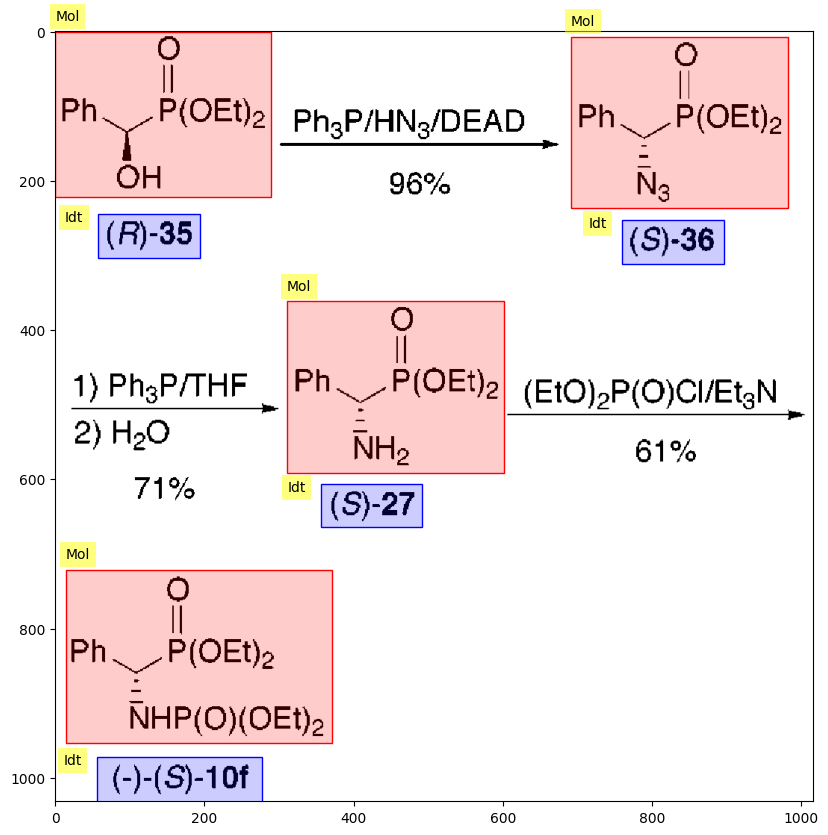

131
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0043624616046340926, 0.32016008004002, 0.376418115599856], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.23861930965482742, 0.33777916995881124, 0.27313656828414207, 0.3870126652111102], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.004502251125562781, 0.7858662976347988, 0.1965982991495748, 0.9709593114314167], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.13506753376688344, 0.5559022501905159, 0.4732366183091546, 0.7796342096281786], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6128064032016008, 0.002492835202648053, 0.9639819909954978, 0.37205565399522195], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.855927963981991, 0.35086655477271345, 0.903951975987994, 0.40757855563295664], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6448224112056028, 0.6587317022997481, 0.9964982491245623, 0.96036476182016

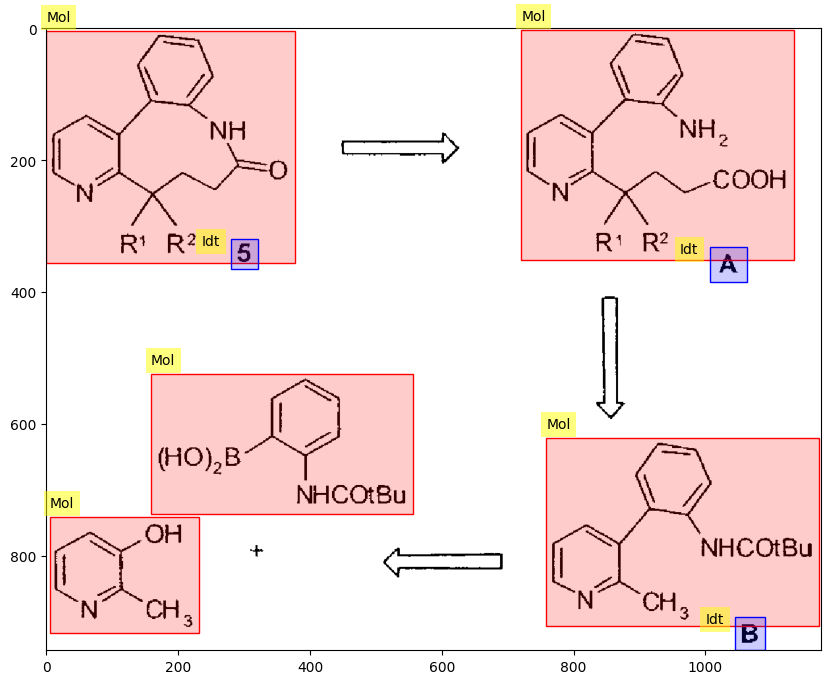

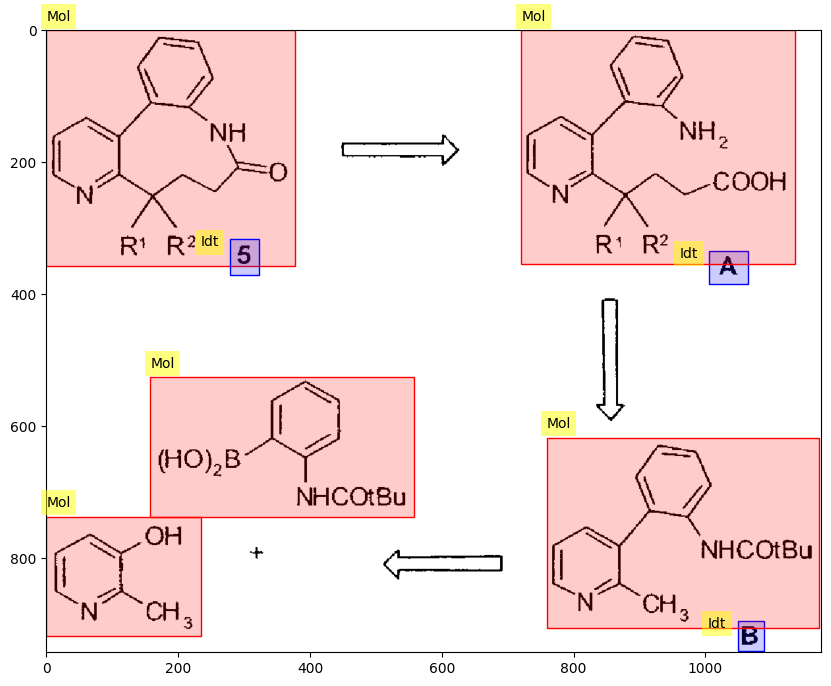

132
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 0.4637318659329665, 0.22004945664143682], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2046023011505753, 0.25626012672167325, 0.24212106053026514, 0.3013841925139679], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.1485742871435718, 0.6768609868844196, 0.7643821910955477, 0.996071970822504], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4032016008004002, 0.9554046028862384, 0.45372686343171587, 0.9999715814465294], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.583791895947974, 0.005013785088032738, 0.9544772386193097, 0.22896285235349506], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.552776388194097, 0.2623880862737133, 0.8344172086043021, 0.31642554777806614], 'category_id': 3, 'score': 2010}, {'category': '[Idt]', 'bbox': [0.5502751375687844, 0.33926612429021524, 0.8574287143571786, 0.388846887938539], 'category_id':

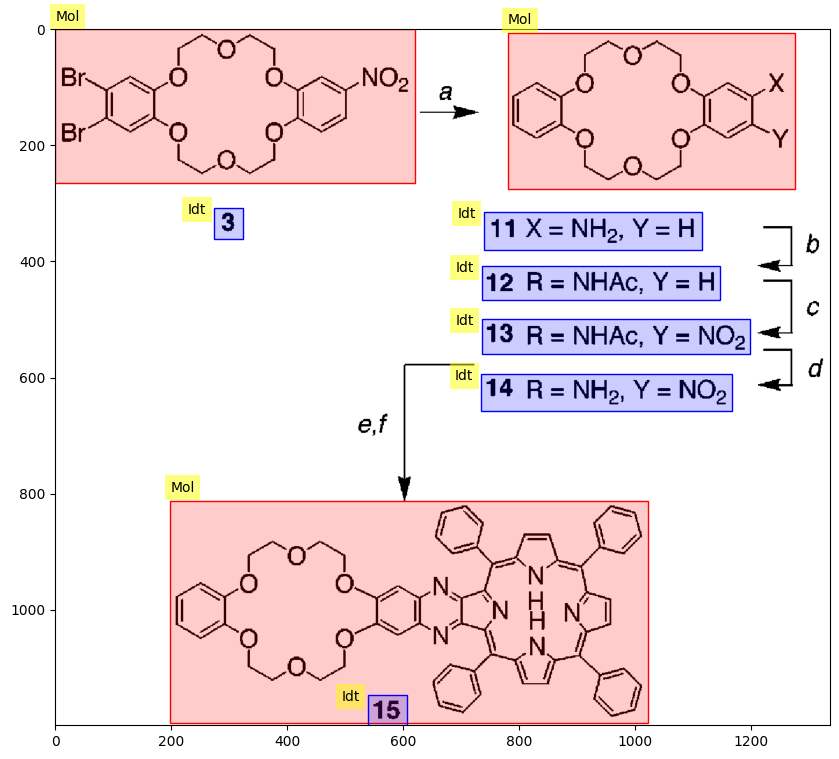

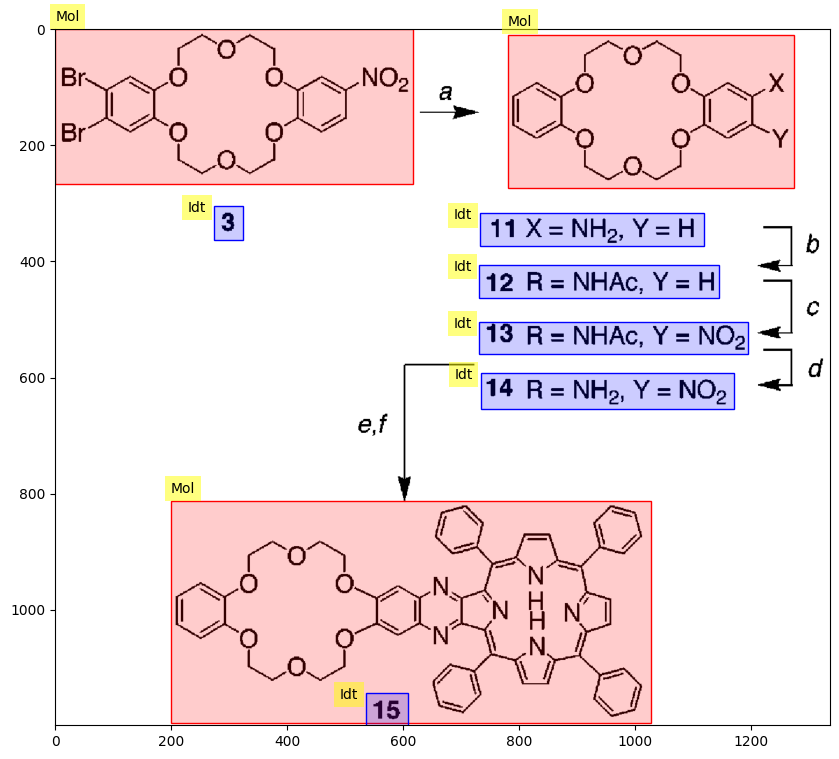

133
the prediction is
[{'category': '[Mol]', 'bbox': [0.0240120060030015, 0.004311422952855738, 0.2001000500250125, 0.32263815097203774], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.018009004502251125, 0.32766814441703607, 0.22861430715357678, 0.3743752264063066], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10955477738869435, 0.6273120396405099, 0.3106553276638319, 0.7695889970847491], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12206103051525763, 0.8148589380897344, 0.27613806903451726, 0.867314584016146], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.34317158579289647, 0.011497127874281967, 0.5567783891945973, 0.24575110831277705], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.36668334167083544, 0.33485384933846235, 0.5612806403201601, 0.3815609313277328], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4562281140570285, 0.6294677511169378, 0.6583291645822

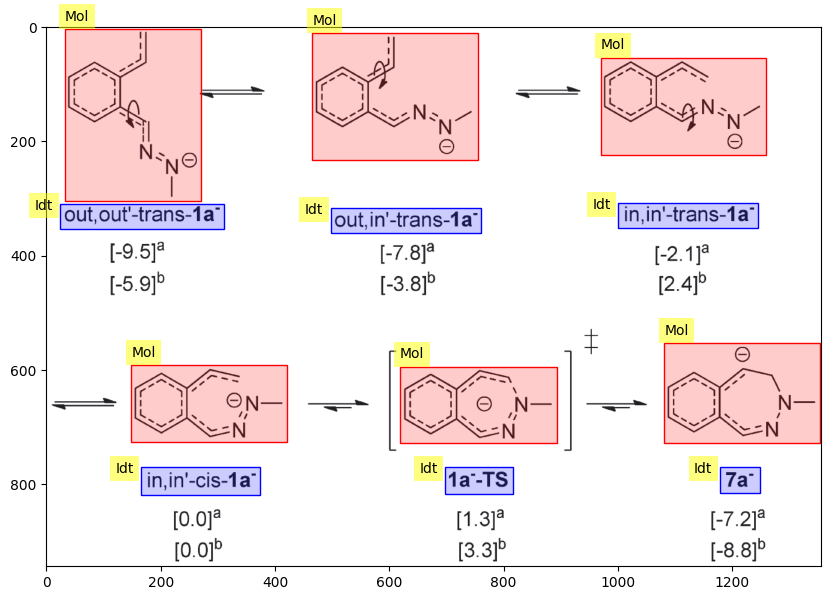

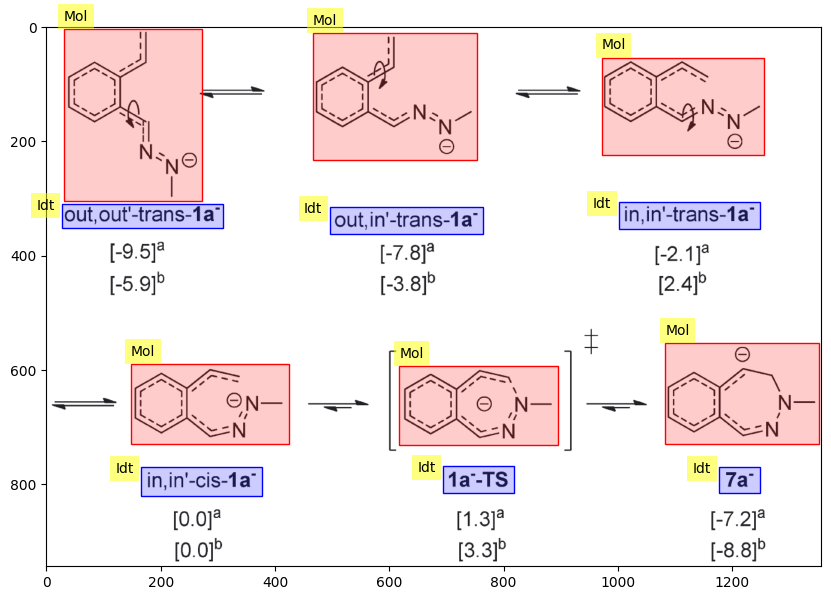

134
the prediction is
[{'category': '[Mol]', 'bbox': [0.00965349044232584, 0.016508254127063533, 0.17227767558612267, 0.11755877938969485], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.04009911414504579, 0.15757878939469736, 0.08316853304157647, 0.18109054527263632], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.06311897596905357, 0.6188094047023511, 0.4440605603469886, 0.8924462231115557], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.20049557072522897, 0.9094547273636818, 0.38985249863238974, 0.9804902451225613], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0720298902235082, 0.31315657828914456, 0.38316931294154877, 0.503751875937969], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2064361802281987, 0.5007503751875938, 0.25024817531260063, 0.5232616308154077], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.18712919934354705, 0.04252126063031516, 0.374258398687

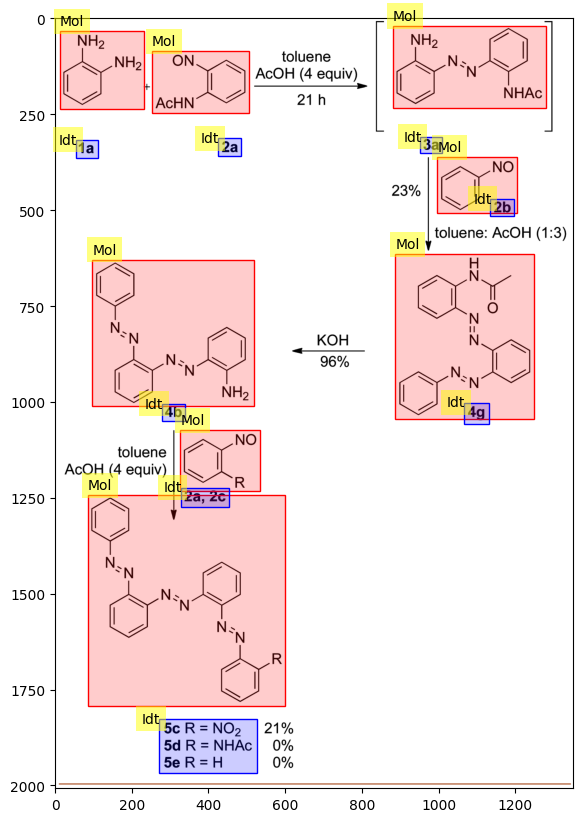

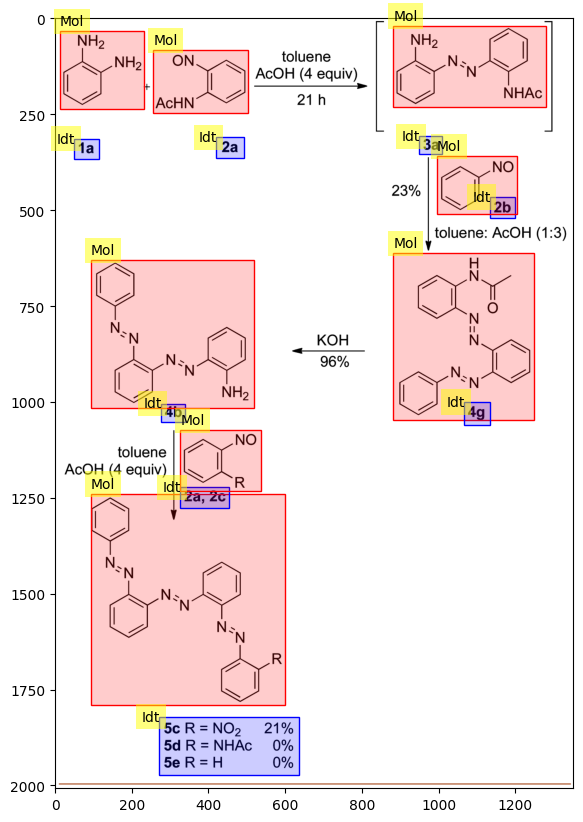

135
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.570598198205105, 0.053526763381690844, 0.6506522737741796], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.018509254627313655, 0.6498006346723809, 0.032016008004002, 0.6787563641335356], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.02451225612806403, 0.36109497916263367, 0.13356678339169584, 0.5424941078457491], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.02301150575287644, 0.49991215275581596, 0.04102051025512756, 0.5331260777259639], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.07603801900950476, 0.08516391017986644, 0.17708854427213608, 0.26656303886298194], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12706353176588295, 0.23334911389283403, 0.144072036018009, 0.2657113997611833], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.08054027013506754, 0.6029604840734544, 0.19909954977488745, 0.81842517

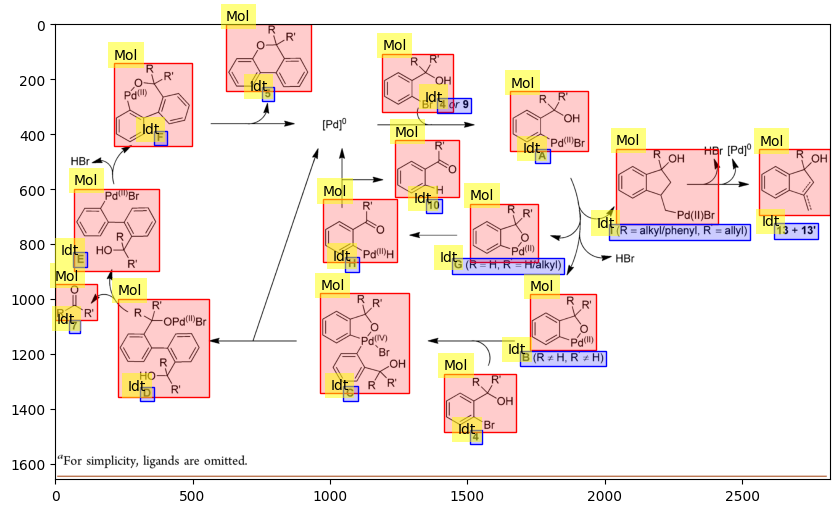

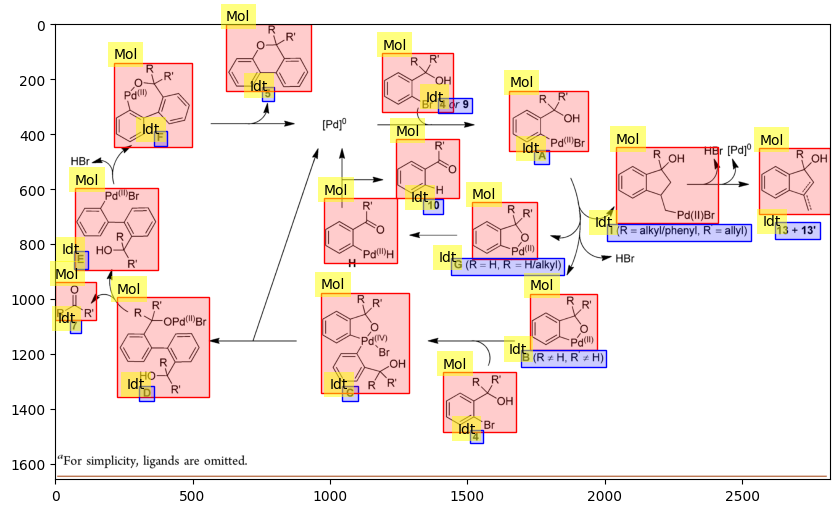

136
the prediction is
[{'category': '[Mol]', 'bbox': [0.010872283968070991, 0.022511255627813906, 0.28630347782586946, 0.060030015007503754], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.011476299744074936, 0.6063031515757878, 0.5164334884833721, 0.80040020010005], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5979756182439045, 0.6828414207103551, 0.6384446752361688, 0.7138569284642321], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.013288347072086768, 0.3501750875437719, 0.6837458584364646, 0.5512756378189094], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3618054498263625, 0.44772386193096547, 0.40287852259463064, 0.4792396198099049], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.010872283968070991, 0.17358679339669836, 0.4505957688989422, 0.21410705352676337], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.409522696130674, 0.23311655827913957, 0.4530118320029

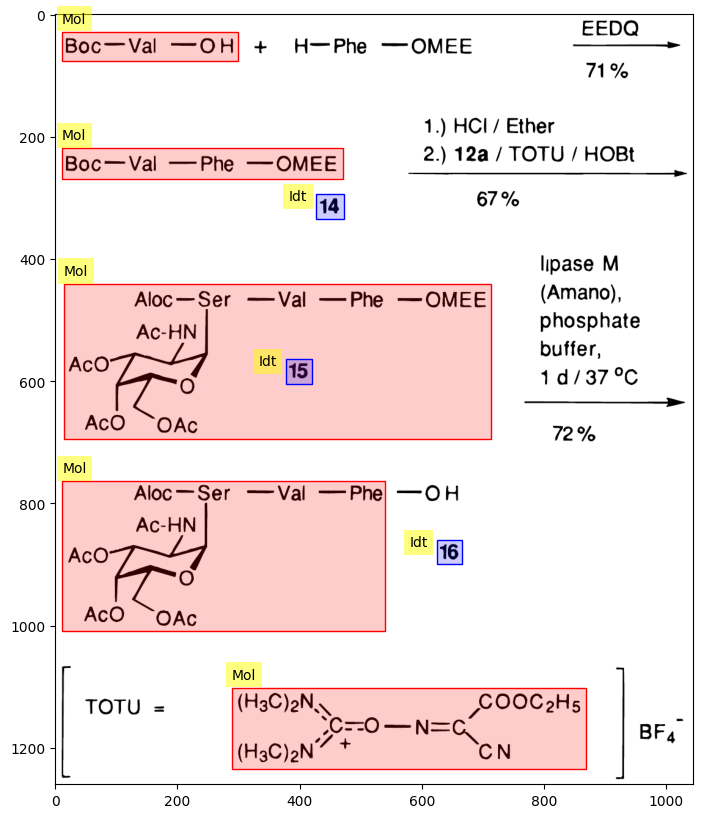

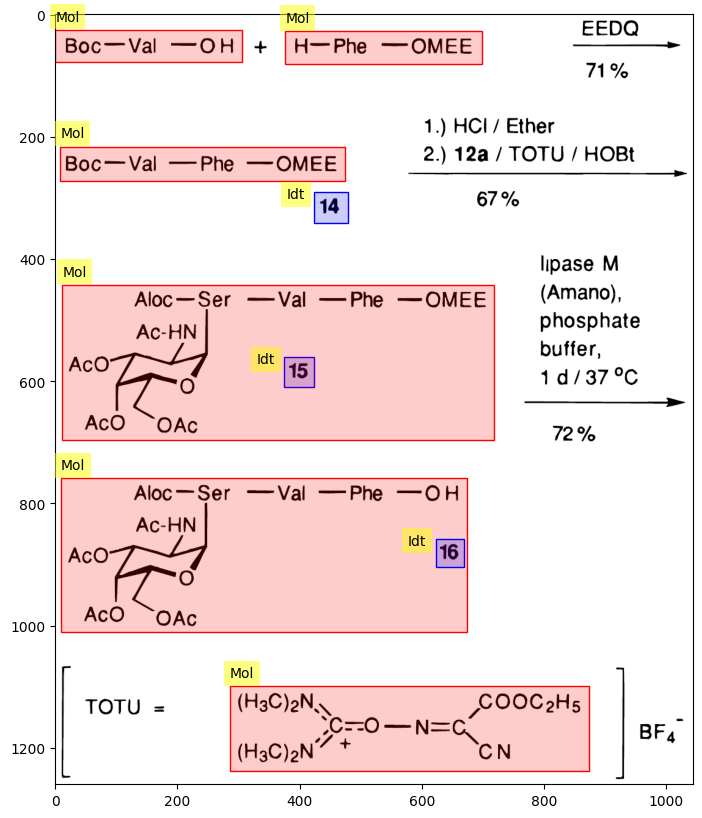

137
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.11855927963981991, 0.26148270985886646, 0.27963981990995496], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12181523832782531, 0.24862431215607803, 0.17327167520768258, 0.2706353176588294], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.037804729136221654, 0.5177588794397199, 0.23102890027691012, 0.7178589294647324], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.091361428745869, 0.6853426713356678, 0.1491186538150965, 0.7083541770885443], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2992874389950881, 0.38019009504752377, 0.37489689726753134, 0.4452226113056528], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3706963718079512, 0.0, 0.5912239584359108, 0.13156578289144572], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.36019505815900077, 0.13506753376688344, 0.6122265857338118, 0.22111055527763882], 'cate

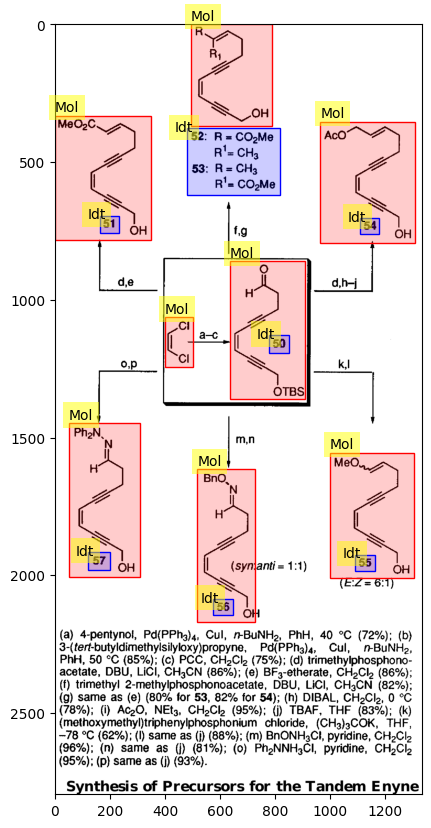

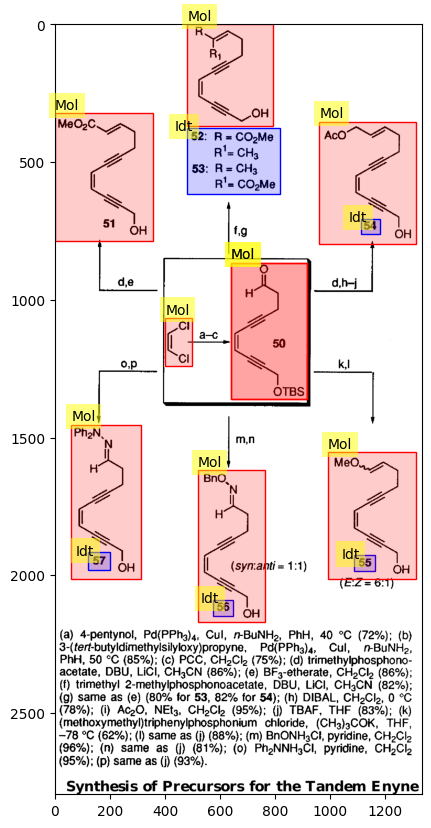

138
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.7033516758379189, 0.36354472416931355, 0.8299149574787393], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1164949944851944, 0.8369184592296148, 0.2671350735608768, 0.8679339669834918], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.07933710831319274, 0.40220110055027514, 0.4780311842668322, 0.5477738869434717], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.09741391780227462, 0.02301150575287644, 0.42279648860574864, 0.08904452226113056], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.18277662927849464, 0.11305652826413207, 0.3314081739665013, 0.14307153576788395], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4991207953374277, 0.704352176088044, 0.8706996570574443, 0.8299149574787393], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6377096680870555, 0.8439219609804902, 0.7431577234400333, 0.87093546773386

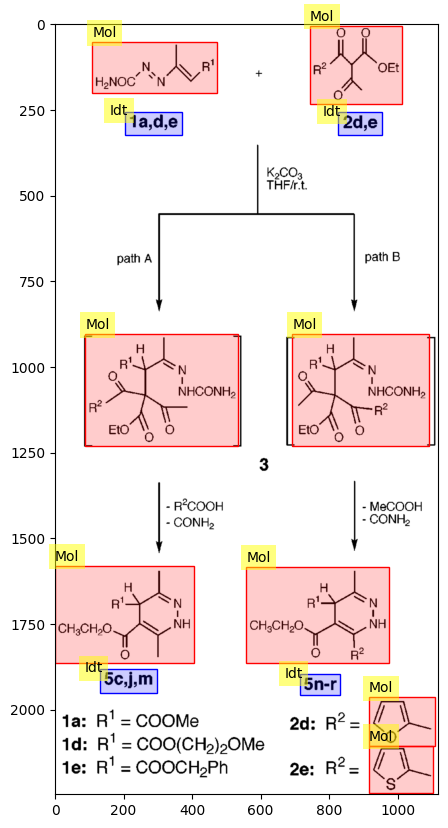

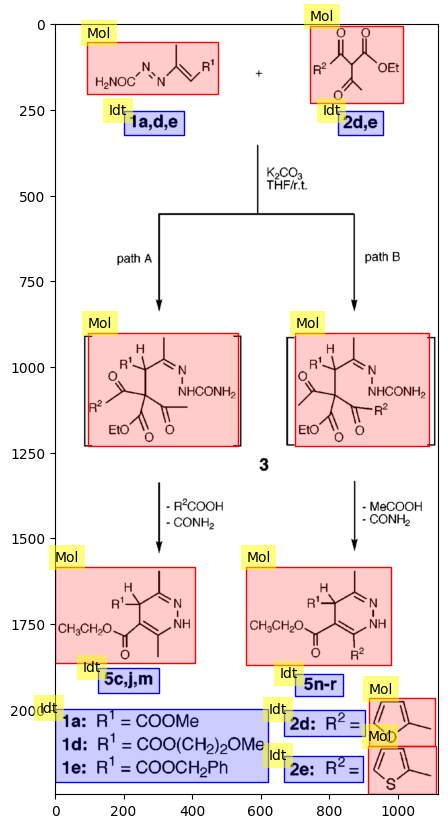

139
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.2061030515257629, 0.3236904333146737, 0.3006503251625813], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.0, 0.6193096548274137, 0.3291371473367956, 0.7158579289644822], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12683062651512456, 0.7148574287143572, 0.15639850263521493, 0.7363681840920461], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.16340142066365737, 0.009504752376188095, 0.42095318370970786, 0.10205102551275638], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2567736610428902, 0.10655327663831916, 0.2902320471787819, 0.12756378189094547], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.21475615287223543, 0.8144072036018009, 0.634931234578783, 0.9694847423711856], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3579269214537257, 0.9759879939969985, 0.44118383579187487, 1.0], 'category_id': 3, 'score

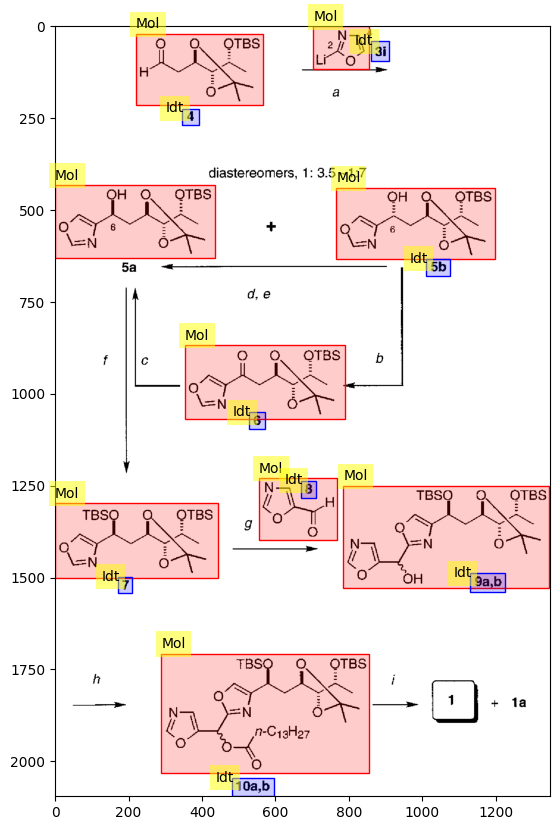

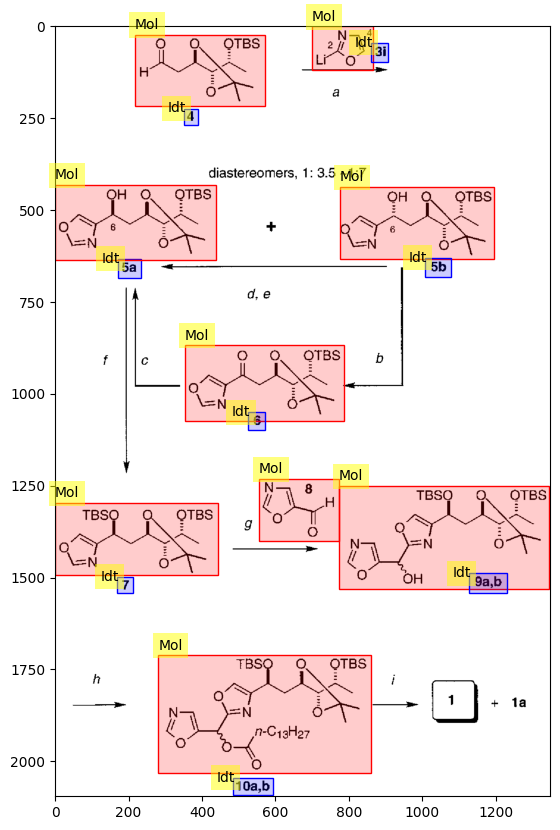

140
the prediction is
[{'category': '[Mol]', 'bbox': [0.04205255781043675, 0.18509254627313657, 0.405840557916596, 0.42621310655327665], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.22227780556945143, 0.4092046023011506, 0.26433036337988813, 0.4347173586793397], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.28836039641442346, 0.0, 0.5506882570414336, 0.13506753376688344], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4298705909511313, 0.44172086043021513, 0.9585313177109076, 0.9634817408704353], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6454733873443228, 0.8799399699849925, 0.7689610571051292, 0.9279639819909955], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.509303200148623, 0.20410205102551277, 0.8383811525382311, 0.4457228614307154], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.6608259084497204, 0.42671335667833915, 0.7008759635072793, 0.451725862931465

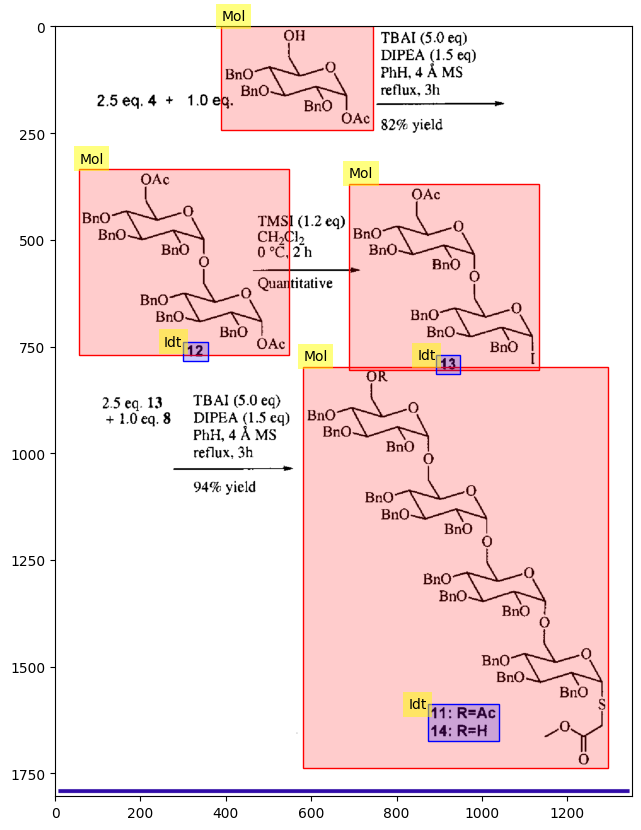

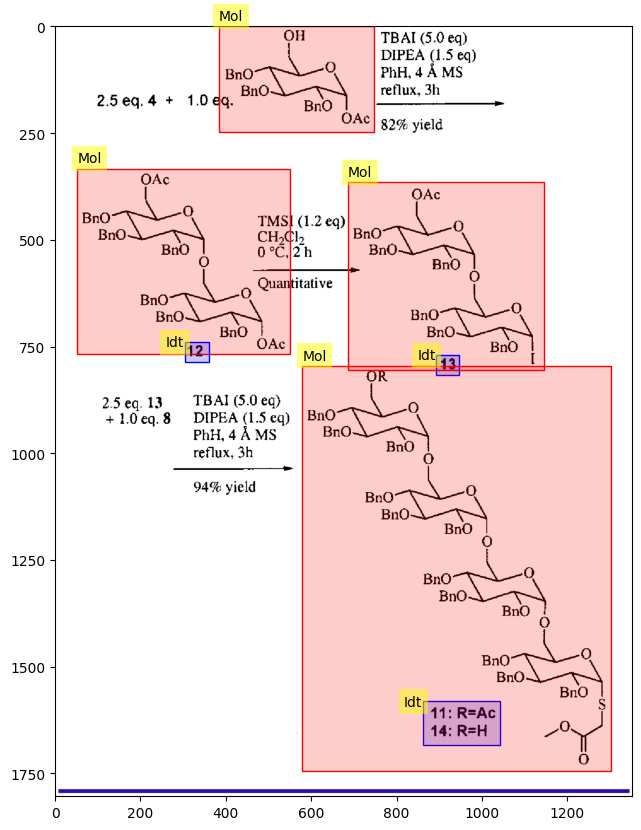

141
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.7218609304652326, 0.5065644410187927, 0.9319659829914958], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09959572060708466, 0.9604802401200601, 0.15511747289953992, 1.0], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.0, 0.31115557778889447, 0.26329903148999395, 0.5052526263131566], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09959572060708466, 0.5227613806903452, 0.15683464049621376, 0.5617808904452226], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.07956209864588946, 0.0080040020010005, 0.22265939836871224, 0.10055027513756878], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.10474722339710628, 0.18509254627313657, 0.15511747289953992, 0.2226113056528264], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3875074876494041, 0.0, 0.6193251132003771, 0.17158579289644824], 'category_id': 1, 'score': 2011}, {'

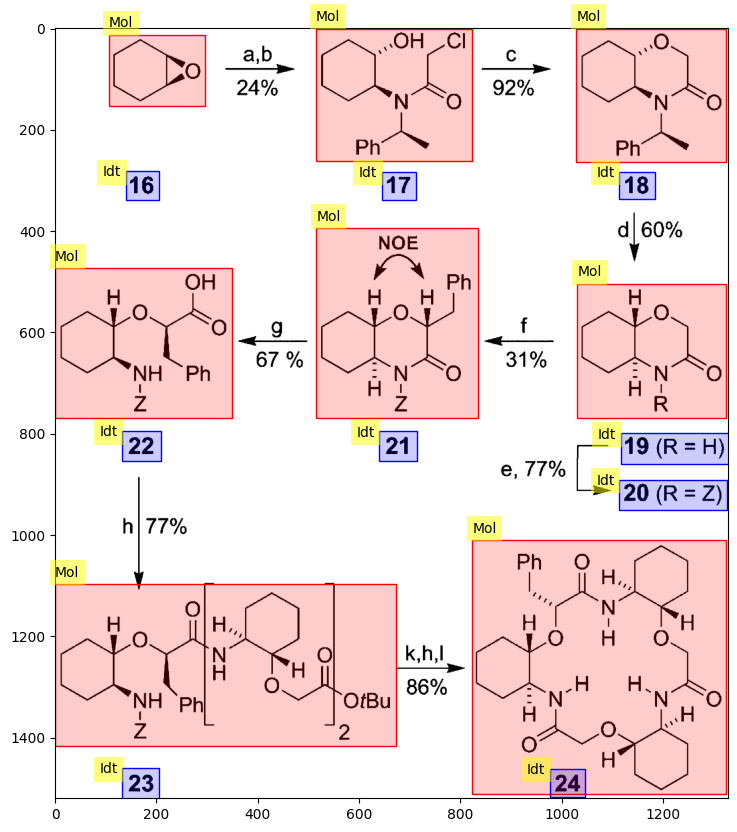

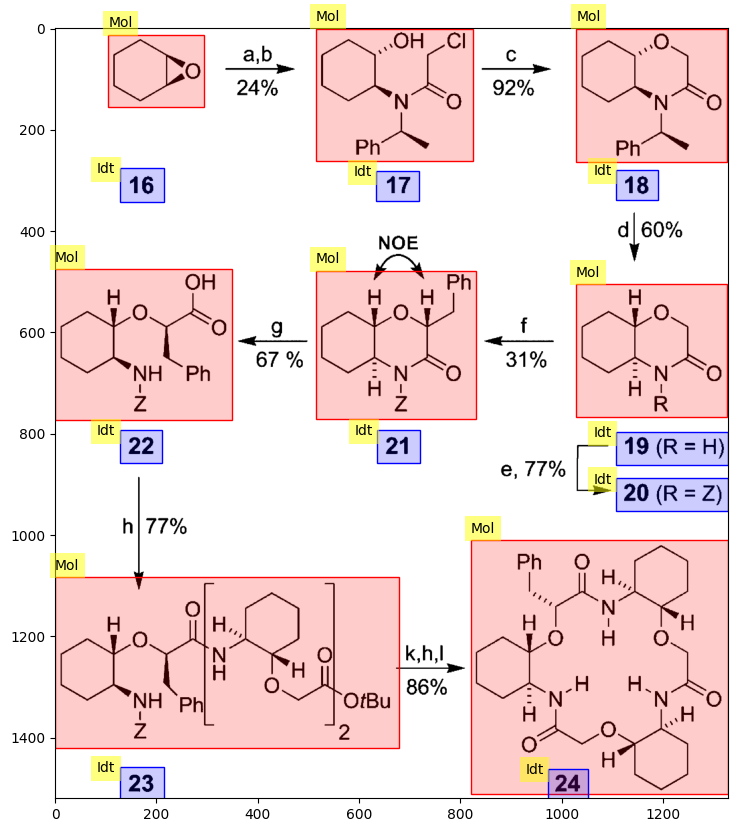

142
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.33367658108087556, 0.3371685842921461, 0.5904308350589949], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.17008504252126064, 0.5644435623891447, 0.27763881940970486, 0.611220653194875], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.054527263631815905, 0.06392869076783131, 0.24212106053026514, 0.18347014504914186], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.054527263631815905, 0.19854276319765493, 0.23711855927963982, 0.2843007630081604], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.24262131065532766, 0.6787875621364852, 0.5822911455727864, 0.9345023252078105], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.40820410205102553, 0.9183902161525034, 0.5142571285642822, 0.9625685796912486], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.44222111055527763, 0.06704716348821332, 0.6153076538269134, 0.18762810

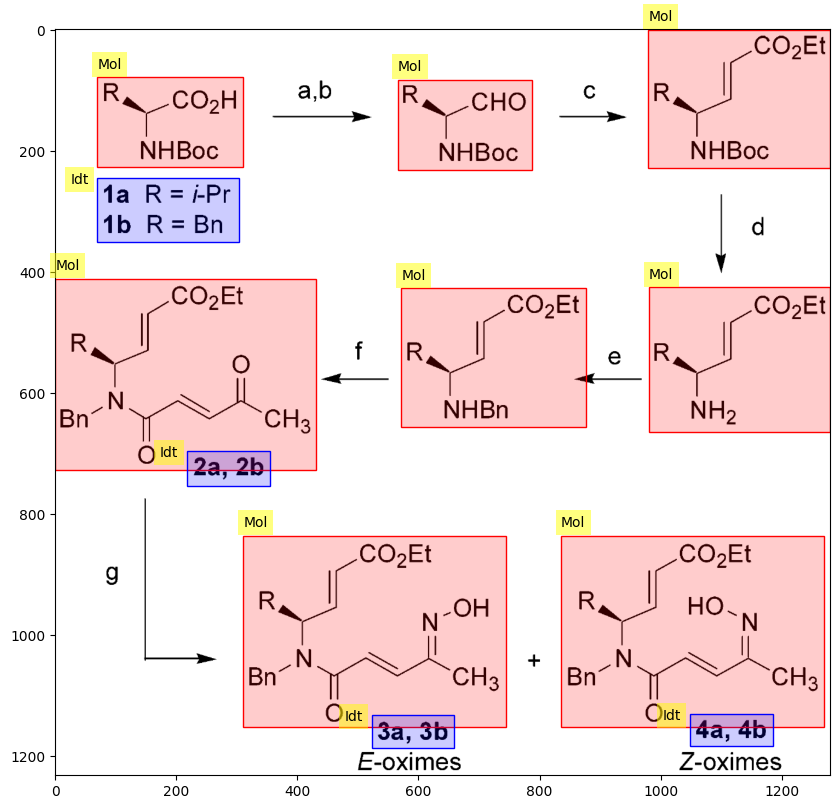

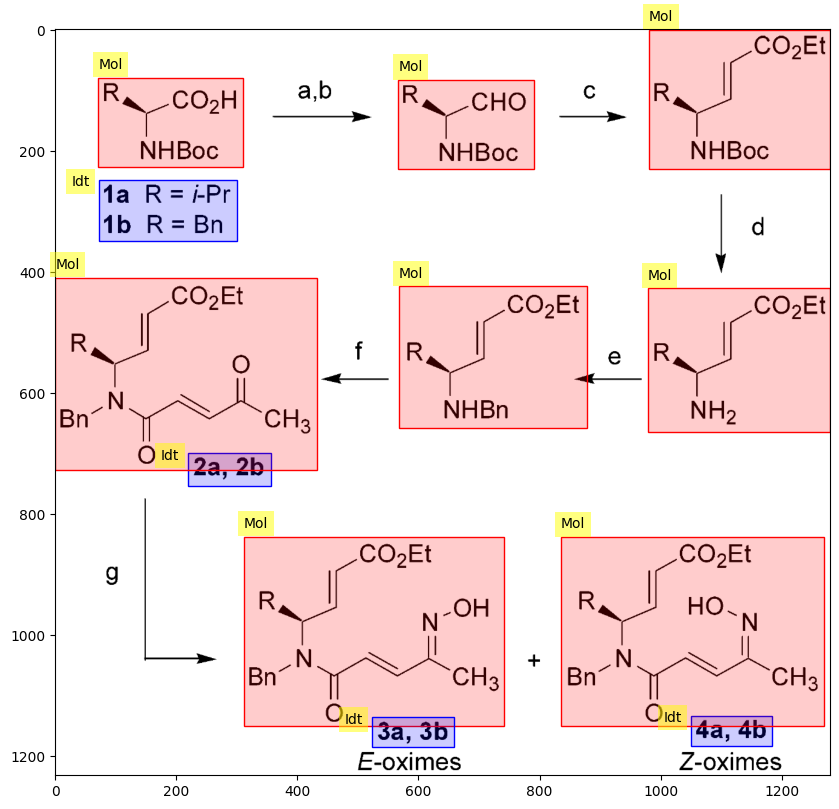

143
the prediction is
[{'category': '[Mol]', 'bbox': [0.002001000500250125, 0.05852782506361095, 0.2591295647823912, 0.39338374223082767], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.07053526763381691, 0.5555346018332908, 0.26263131565782893, 0.8596873976556625], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.36418209104552274, 0.6581981638301166, 0.6218109054527263, 0.994973026081386], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.37018509254627313, 0.003837890168105636, 0.6298149074537268, 0.3914647971467749], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6183091545772886, 0.39338374223082767, 0.7938969484742371, 0.5919945584302942], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7413706853426714, 0.011513670504316908, 1.0, 0.3953026873148805], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7508754377188595, 0.6131029543548754, 1.0, 0.9901756633712541], 'catego

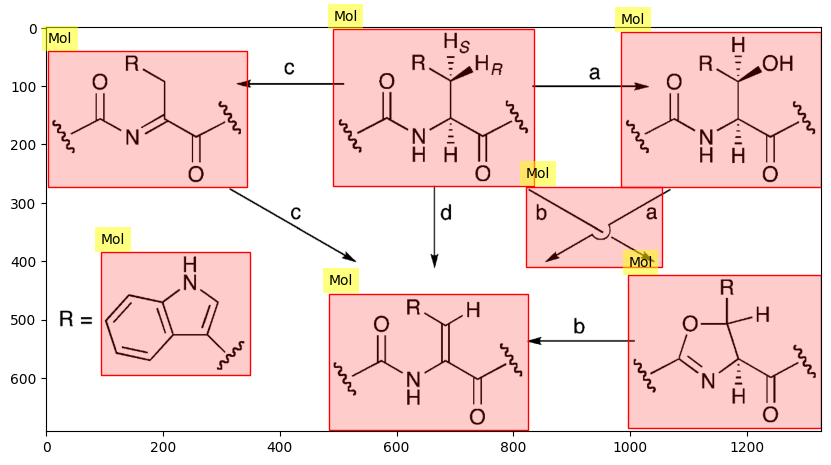

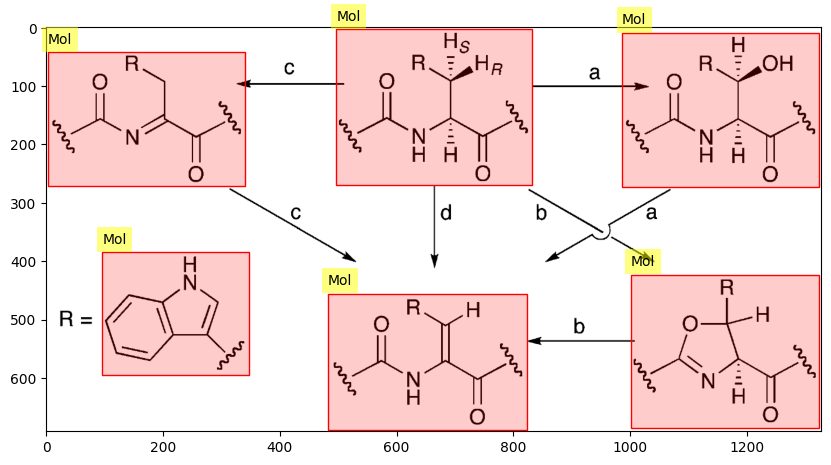

144
the prediction is
[{'category': '[Mol]', 'bbox': [0.007503751875937969, 0.25070470520314087, 0.14507253626813407, 0.4931895840061788], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.15907953976988495, 0.35139757860440235, 0.19559779889944973, 0.4151012332052005], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3091545772886443, 0.6483388073081224, 0.4817408704352176, 0.8733565550109414], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.35567783891945975, 0.8733565550109414, 0.391695847923962, 0.9329502964116883], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3306653326663332, 0.019522087700244578, 0.5627813906953477, 0.3832494059048014], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7388694347173587, 0.07500591590093968, 0.9079539769884942, 0.2989961853037459], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.9219609804902451, 0.1006928734012615, 0.9949974987493747, 

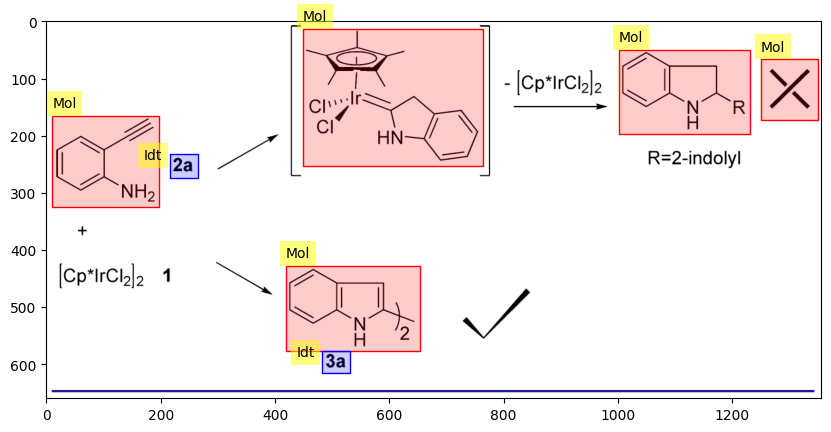

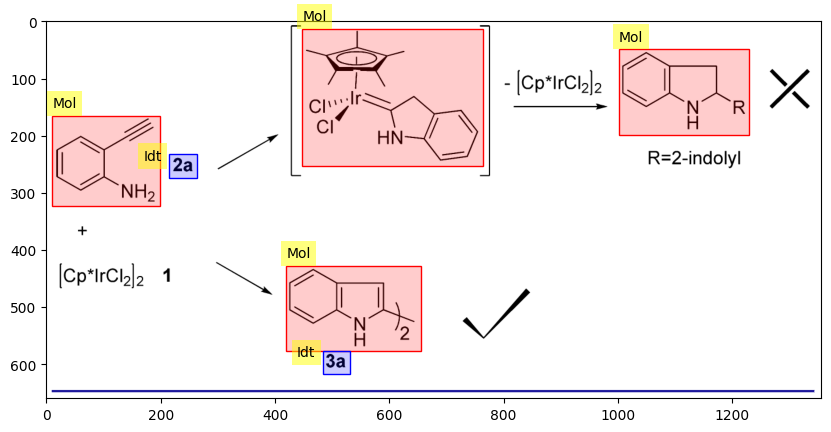

145
the prediction is
[{'category': '[Mol]', 'bbox': [0.2046023011505753, 0.31954299297299654, 0.3806903451725863, 0.5164602435445911], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.599799899949975, 0.24704164162618222, 0.8024012006003002, 0.581800967597893], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10456, 'image_id': 1332, 'category_id': 1, 'segmentation': [], 'area': 67905.35140000001, 'bbox': [813.63, 186.76, 271.22, 250.37], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10457, 'image_id': 1332, 'category_id': 1, 'segmentation': [], 'area': 35503.170000000006, 'bbox': [276.62, 241.57, 237.4, 149.55], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DON

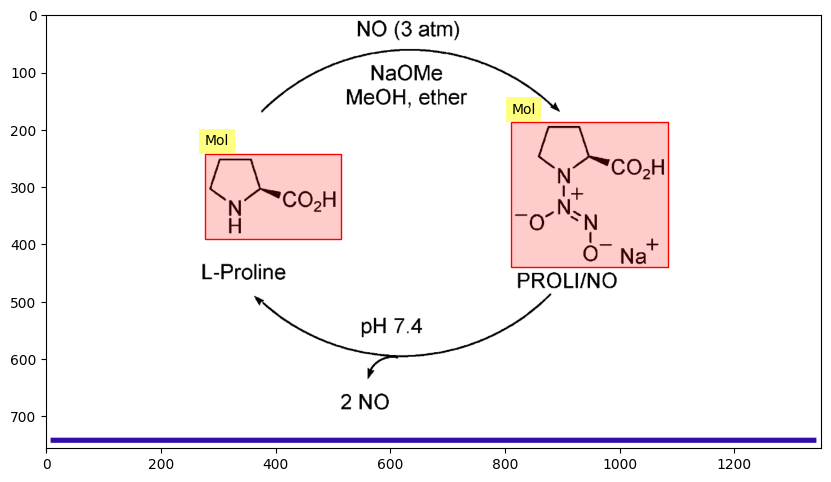

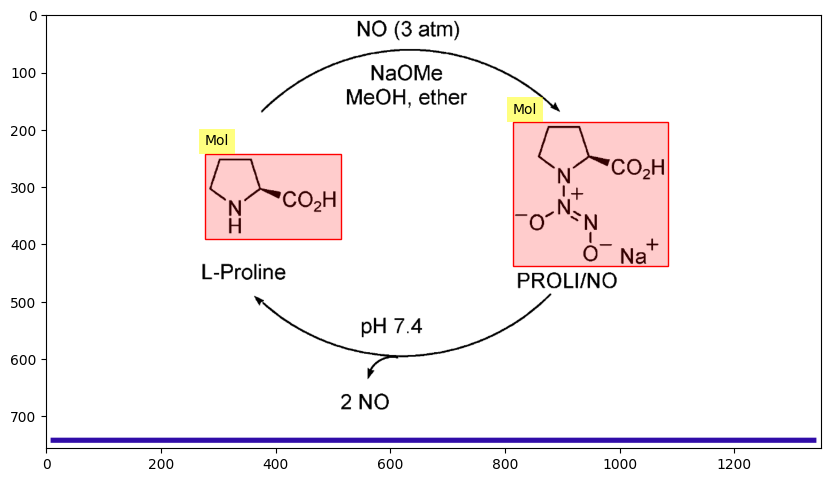

146
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.27424110804424884, 0.11505752876438219, 0.48800318845896756], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0400200100050025, 0.5020802035106686, 0.07453726863431716, 0.5411830230987269], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.22811405702851426, 0.6261664843367736, 0.6343171585792896, 0.9327325899071507], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.31265632816408206, 0.25234352907493623, 0.4777388694347174, 0.4937382686652161], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4817408704352176, 0.0, 0.6108054027013506, 0.2945745742300392], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5257628814407204, 0.2930104614465168, 0.5707853926963482, 0.3300277973232121], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5947973986993497, 0.22262538618801192, 0.9964982491245623, 0.5323197173254336], 'category_i

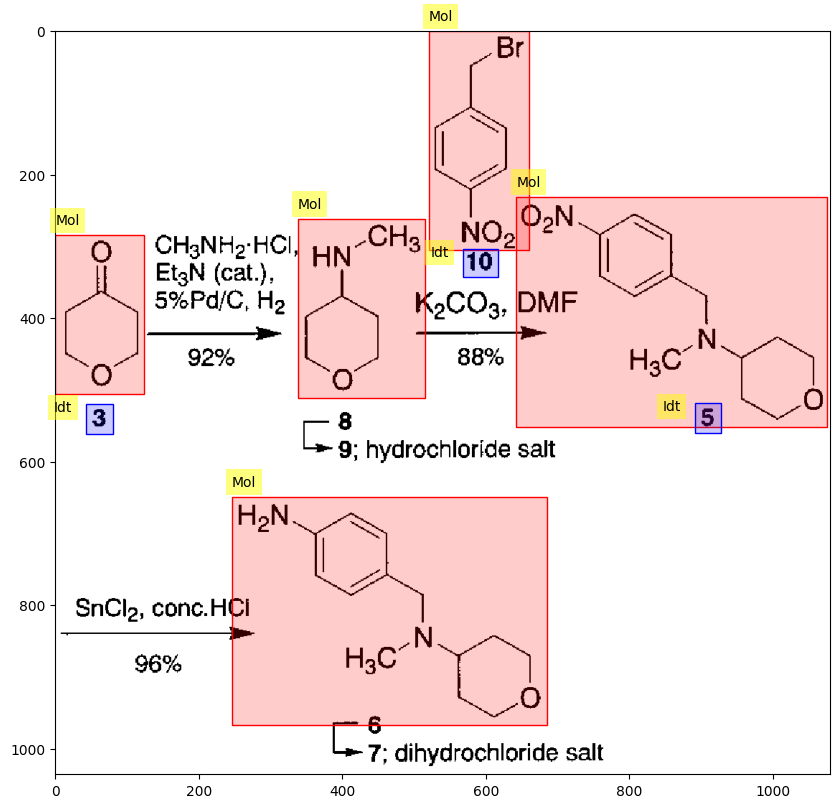

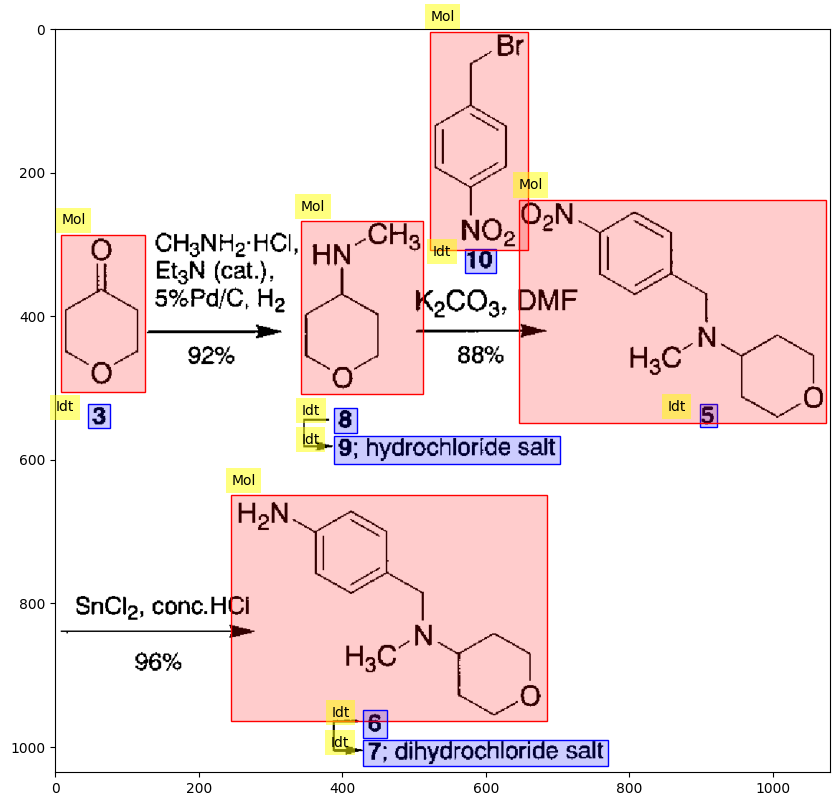

147
the prediction is
[{'category': '[Mol]', 'bbox': [0.035599871648971895, 0.5717858929464732, 0.27736019404124373, 0.7388694347173587], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.21359922989383137, 0.7123561780890445, 0.2385722741849012, 0.7378689344672336], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2741721458338731, 0.0, 0.4580162591255787, 0.16808404202101052], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.27470348720176824, 0.8329164582291145, 0.4914907653029702, 1.0], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.27470348720176824, 0.3061530765382691, 0.46651772101190037, 0.47423711855927964], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4898967411992849, 0.5707853926963482, 0.7003079228857456, 0.7388694347173587], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7502540114678853, 0.5552776388194097, 1.0010471371143739, 0.7618809404702351], 'category_

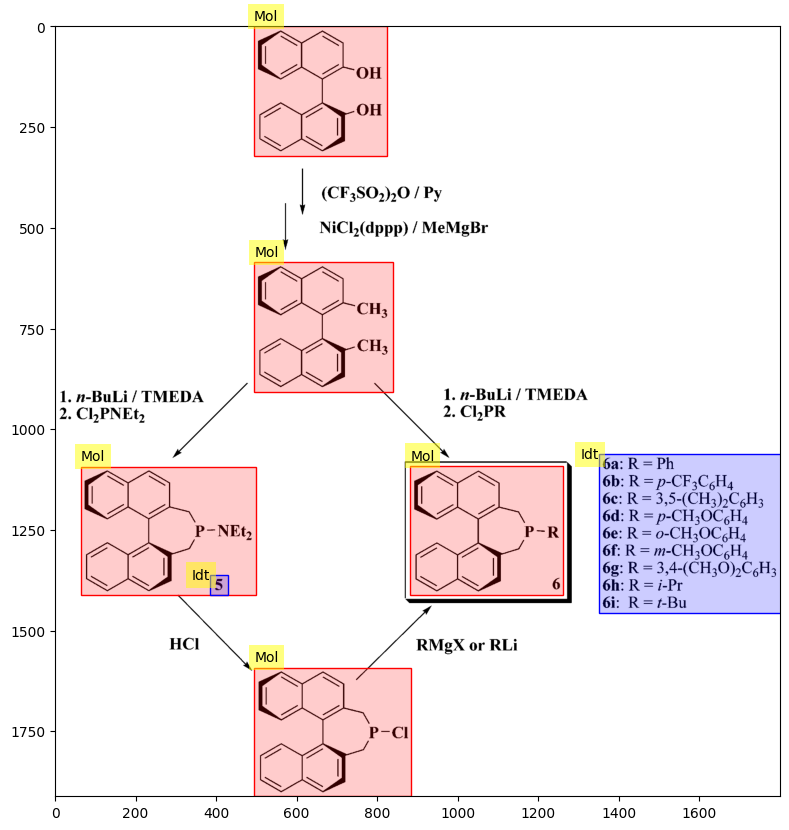

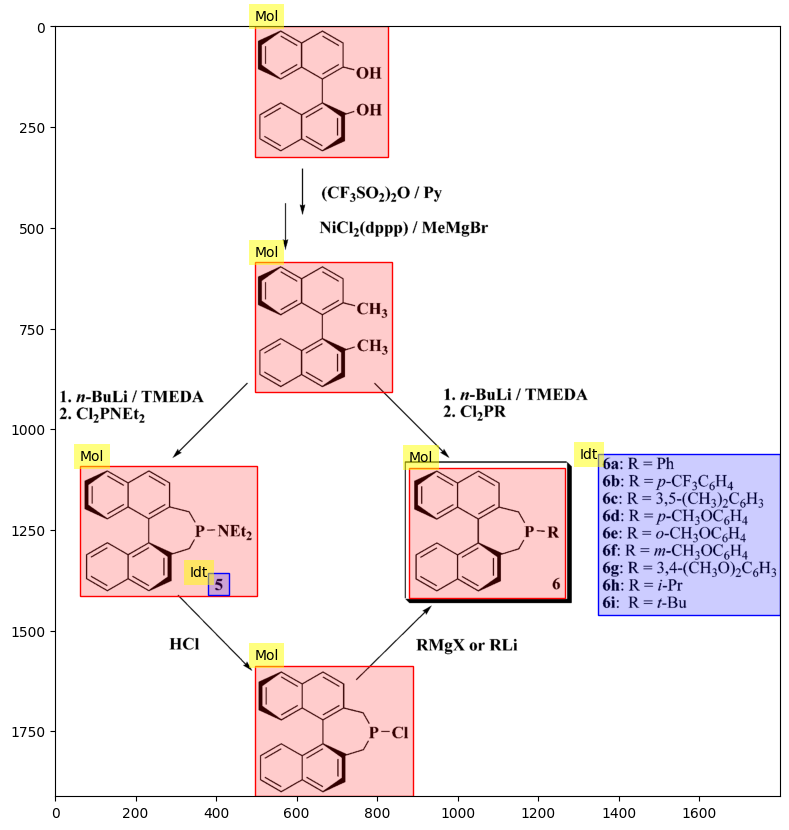

148
the prediction is
[{'category': '[Mol]', 'bbox': [0.0065032516258129065, 0.0, 0.1585792896448224, 0.2594753158892371], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.054527263631815905, 0.2540317777936587, 0.08354177088544272, 0.298487338907549], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.010005002501250625, 0.3955637682786971, 0.24912456228114058, 0.7584663079839238], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.09954977488744372, 0.7602808206824501, 0.128064032016008, 0.8029218690978142], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.36868434217108553, 0.0027217690477892003, 0.5547773886943472, 0.30574538970165355], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.44922461230615307, 0.2812494682715507, 0.47873936968484243, 0.3238905166869148], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3736868434217109, 0.43639030399553513, 0.6153076538269134, 0.7149180

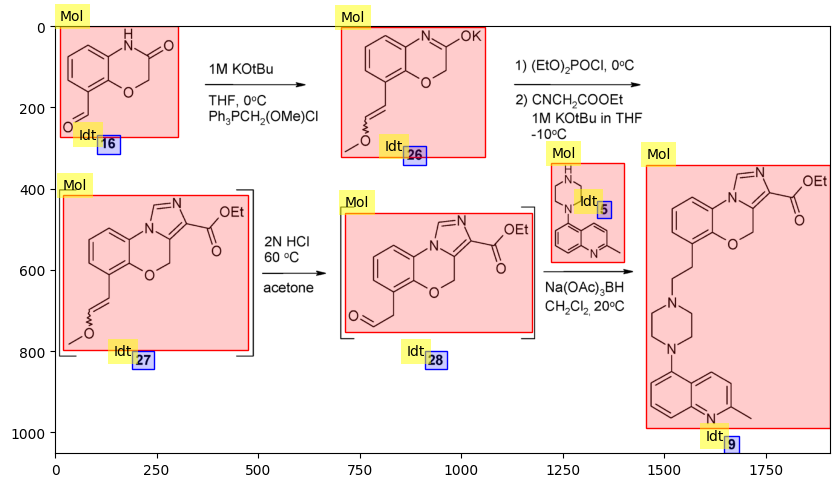

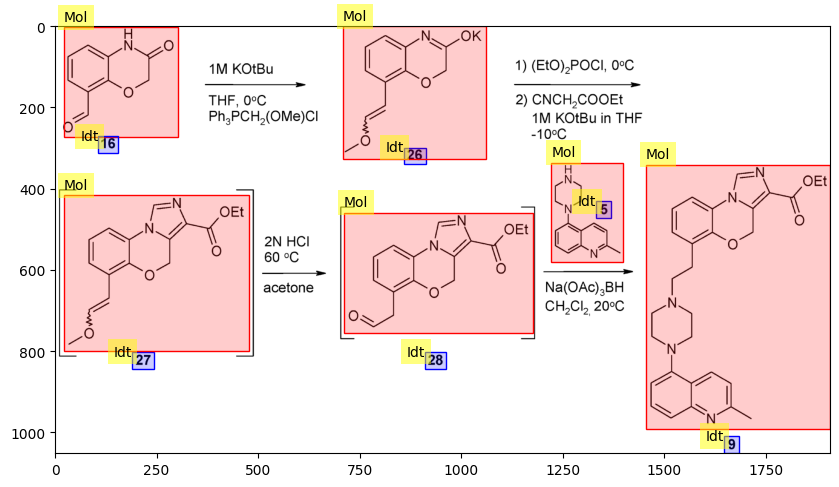

149
the prediction is
[{'category': '[Mol]', 'bbox': [0.15457728864432216, 0.3033016508254127, 0.2176088044022011, 0.4925962981490746], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.23261630815407705, 0.43881940970485245, 0.3311655827913957, 0.8002001000500251], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.24312156078039018, 0.09894947473736869, 0.3321660830415208, 0.30115057528764383], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.471735867933967, 0.42161080540270135, 0.5867933966983492, 0.8217108554277138], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4792396198099049, 0.09894947473736869, 0.5857928964482241, 0.3033016508254127], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7153576788394197, 0.021510755377688845, 0.8449224612306153, 0.38289144572286143], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7573786893446723, 0.43881940970485245, 0.8444222111055528,

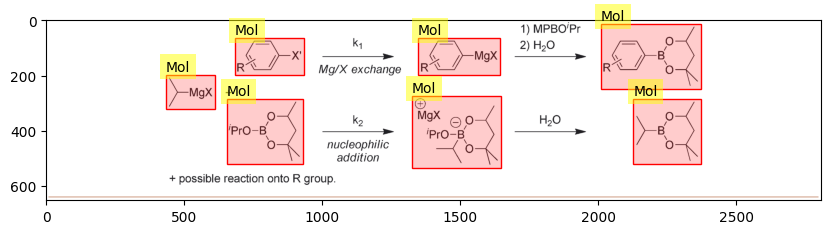

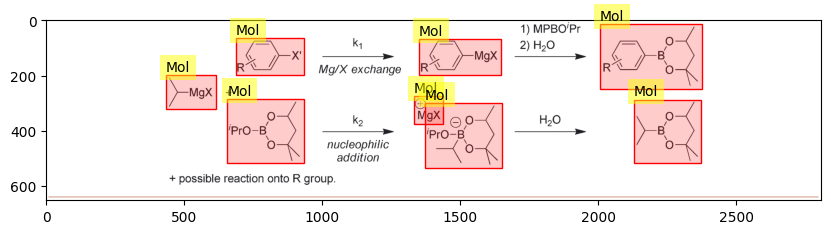

150
the prediction is
[{'category': '[Mol]', 'bbox': [0.0080040020010005, 0.0022452303592873876, 0.33616808404202103, 0.20150942474604305], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.11105552776388194, 0.21722603726105477, 0.13706853426713356, 0.2525884154198311], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.009504752376188095, 0.6915309506605155, 0.18359179589794897, 0.7588878614391371], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.17258629314657328, 0.3070352516325503, 0.5267633816908455, 0.5994765059297326], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2876438219109555, 0.5893729693129394, 0.3156578289144572, 0.6247353474717157], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2111055527763882, 0.6842339519928315, 0.36368184092046024, 0.9121248334605013], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.272136068034017, 0.9295253687449786, 0.2981490745372686

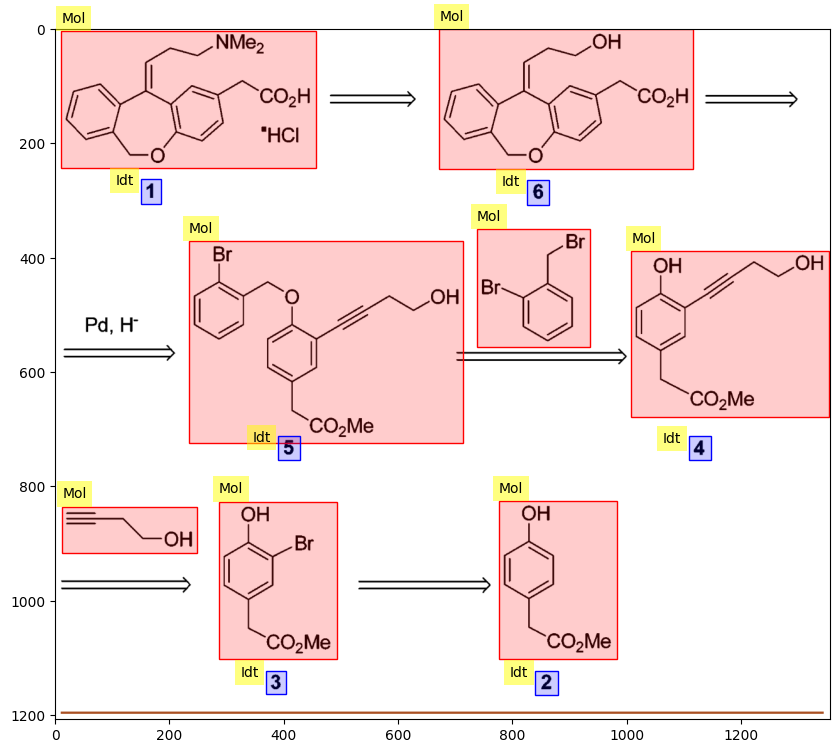

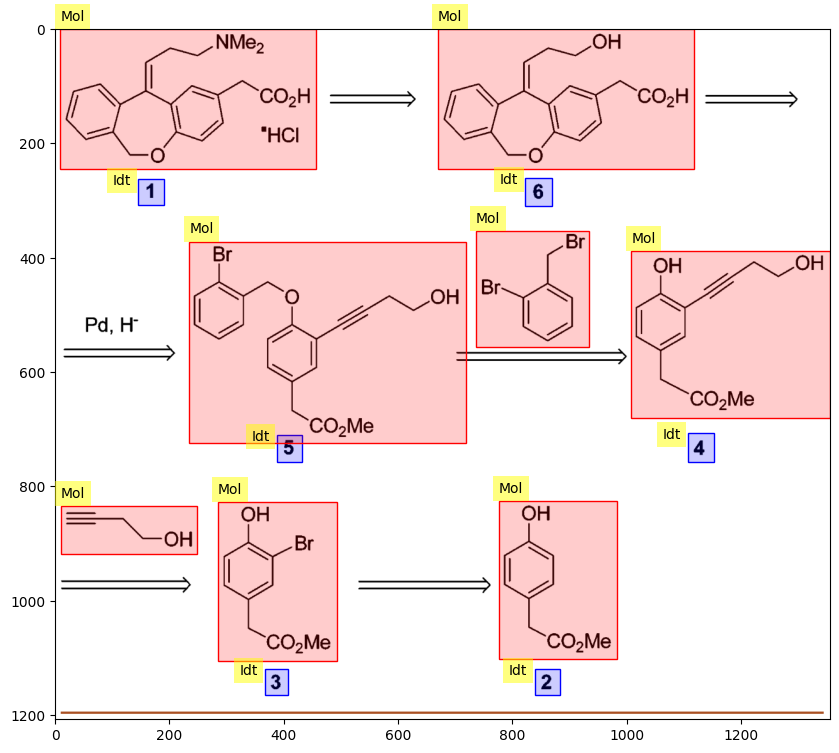

151
the prediction is
[{'category': '[Mol]', 'bbox': [0.002001000500250125, 0.053760213440053356, 0.19909954977488745, 0.24605636151409038], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0830415207603802, 0.29568117392029347, 0.10855427713856929, 0.35771218942804733], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.03751875937968985, 0.6048024012006002, 0.21710855427713857, 0.8436218109054527], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2236118059029515, 0.8684342171085543, 0.24912456228114058, 0.928397532099383], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2381190595297649, 0.6265132566283141, 0.41270635317658827, 0.8250125062531265], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2511255627813907, 0.057895614473903616, 0.42621310655327665, 0.23571785892946473], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.33366683341670833, 0.29568117392029347, 0.3611805902

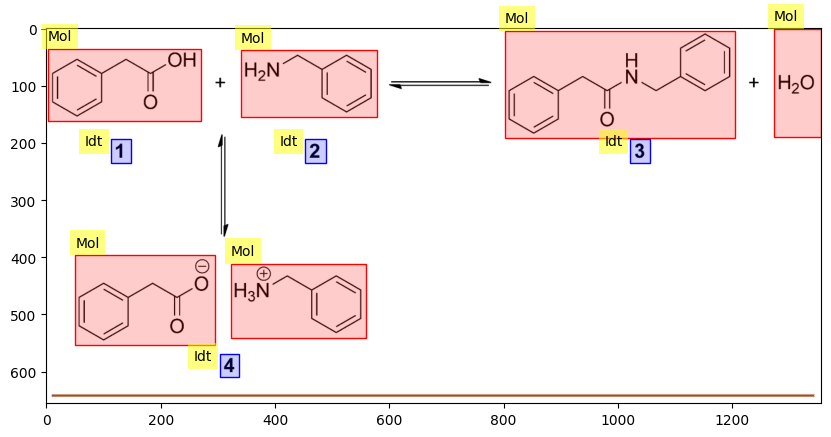

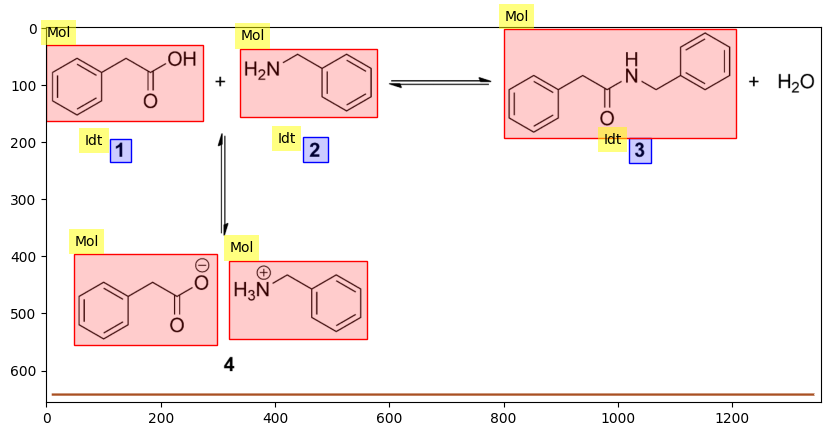

152
the prediction is
[{'category': '[Mol]', 'bbox': [0.15157578789394696, 0.4042615661471152, 0.29464732366183094, 0.5885572801259471], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.24612306153076538, 0.5627955136557878, 0.2591295647823912, 0.5954931403294516], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.4382191095547774, 0.012880883235079651, 0.6218109054527263, 0.1971765972139116], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5502751375687844, 0.16546980771217706, 0.5727863931965983, 0.2051032945893452], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.43921960980490243, 0.724301972680248, 0.5862931465732867, 0.9561578709116818], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5552776388194097, 0.928414430097664, 0.576288144072036, 0.9700295913186906], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.439719859929965, 0.3358938012840001, 0.6203101550775387, 0.58558

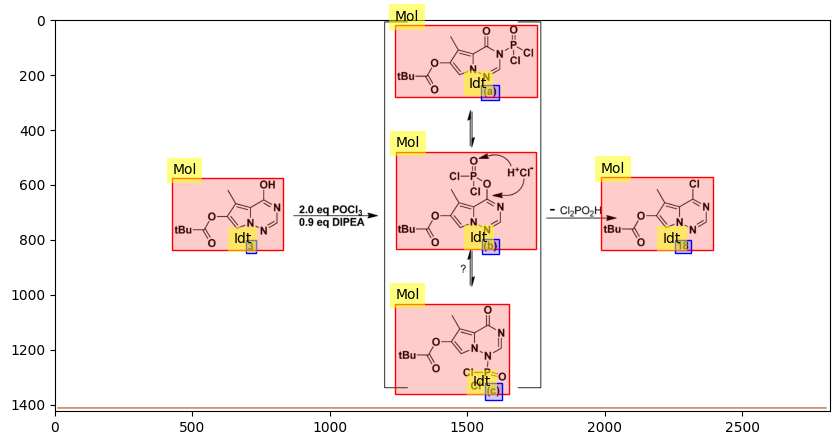

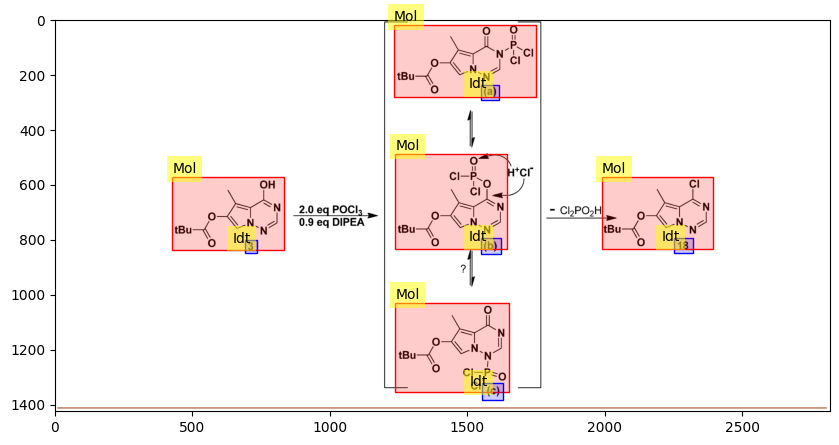

153
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.005849415936038194, 0.17408704352176088, 0.42700736333078815], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.057528764382191094, 0.4226203013787596, 0.0785392696348174, 0.48403916870716057], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.1790895447723862, 0.5747051157157527, 0.36718359179589793, 1.0017124790465408], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.29364682341170584, 0.900810054149882, 0.31315657828914456, 0.9710030453823404], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.2496248124062031, 0.004387061952028645, 0.423711855927964, 0.42846971731479777], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3321660830415208, 0.42115794739475, 0.35117558779389696, 0.48403916870716057], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.40220110055027514, 0.5366839121315043, 0.6108054027013506, 0.83939118682

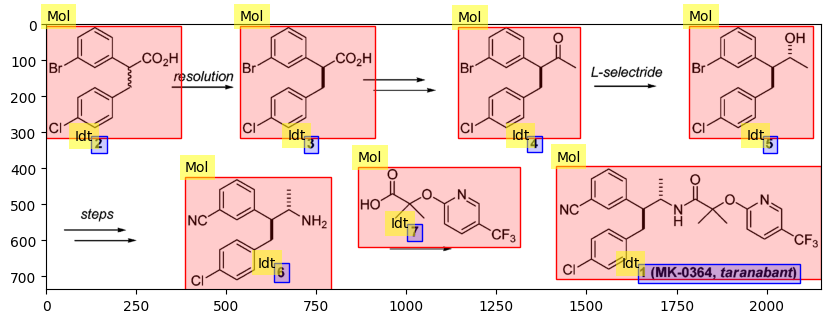

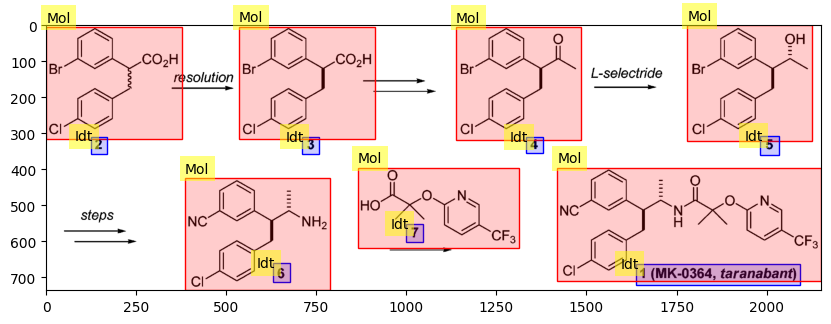

154
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.8505528274341252, 0.19959979989994997, 0.9639598710920085], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.04702351175587794, 0.5182701895165269, 0.18359179589794897, 0.7791063899296586], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2756378189094547, 0.011340704365788335, 0.5887943971985993, 0.26537248215944703], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3381690845422711, 0.8505528274341252, 0.5207603801900951, 0.9628258006554298], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3741870935467734, 0.5216724008262634, 0.5092546273136568, 0.7847767421125528], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7313656828414207, 0.8505528274341252, 0.9079539769884942, 0.9639598710920085], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7383691845922962, 0.5250746121359999, 0.9414707353676839, 0.7178665863544017]

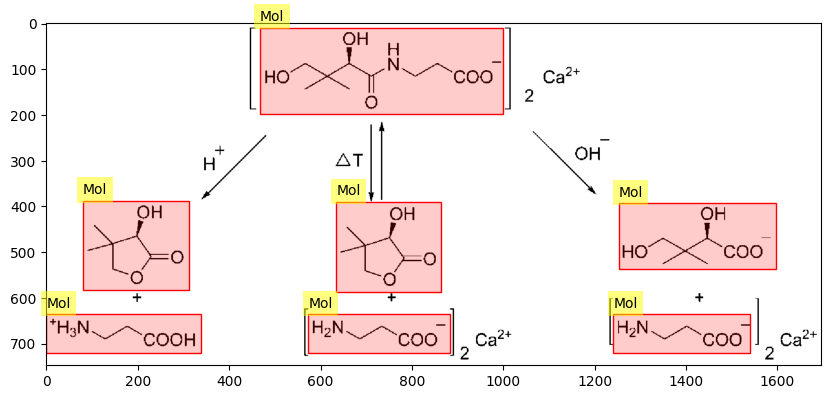

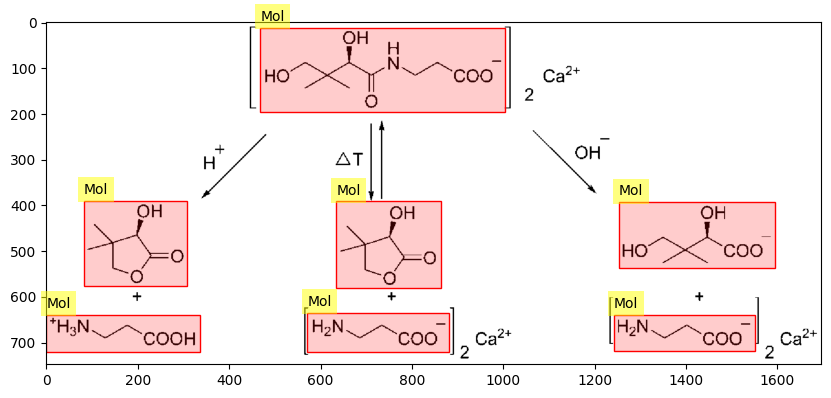

155
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.2528314558195478, 0.23411705852926462, 0.4353895160638738], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.447223611805903, 0.0007638412562524102, 0.6213106553276638, 0.21845859928818934], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4517258629314657, 0.36664380300115695, 0.655327663831916, 0.5629510058580264], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.4957478739369685, 0.5843385610330939, 0.695847923961981, 0.7264130346960421], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7668834417208604, 0.03666438030011569, 0.9639819909954978, 0.18179421898807366], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.8949474737368684, 0.20470945667564597, 0.92096048024012, 0.24060999571950925], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.8024012006003002, 0.4873307214890378, 1.0, 0.6355159252020054], 'category_id':

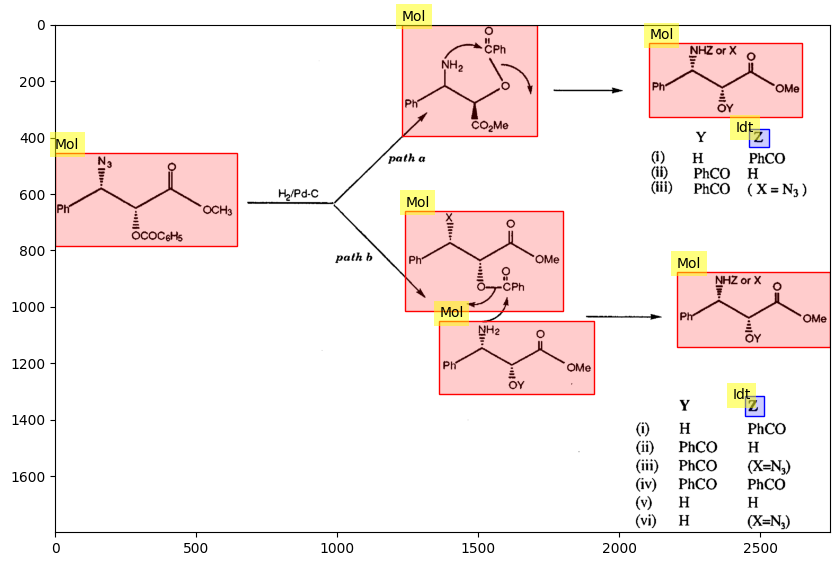

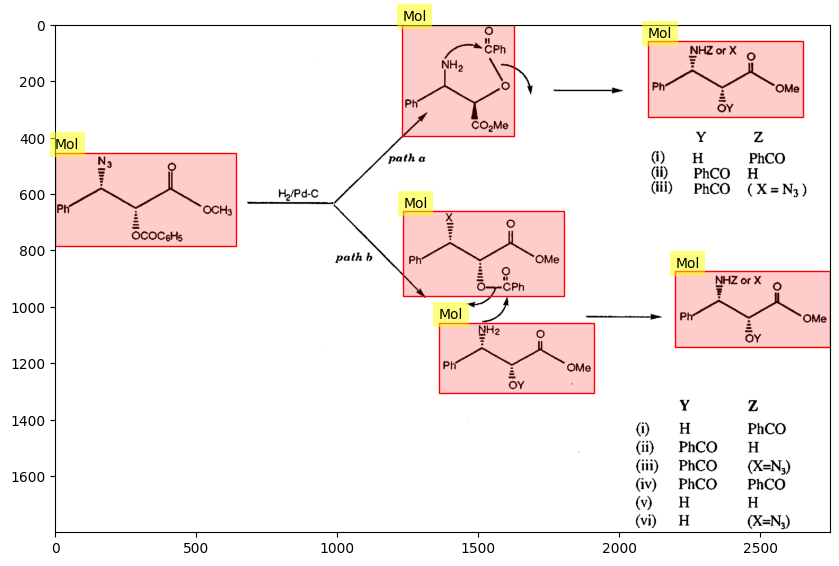

156
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.012069383107843515, 0.2621310655327664, 0.22780960616054635], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.12756378189094547, 0.24591368082231163, 0.16108054027013508, 0.30022590480760747], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.23561780890445222, 0.5280355109681538, 0.5237618809404703, 0.7973336215619122], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.33366683341670833, 0.7626341451268621, 0.36668334167083544, 0.8177007055563983], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.28864432216108055, 0.009052037330882636, 0.48924462231115556, 0.1380435692959602], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5497748874437218, 0.011315046663603296, 0.9844922461230615, 0.28287616659008236], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7698849424712356, 0.24214199860111052, 0.80490245

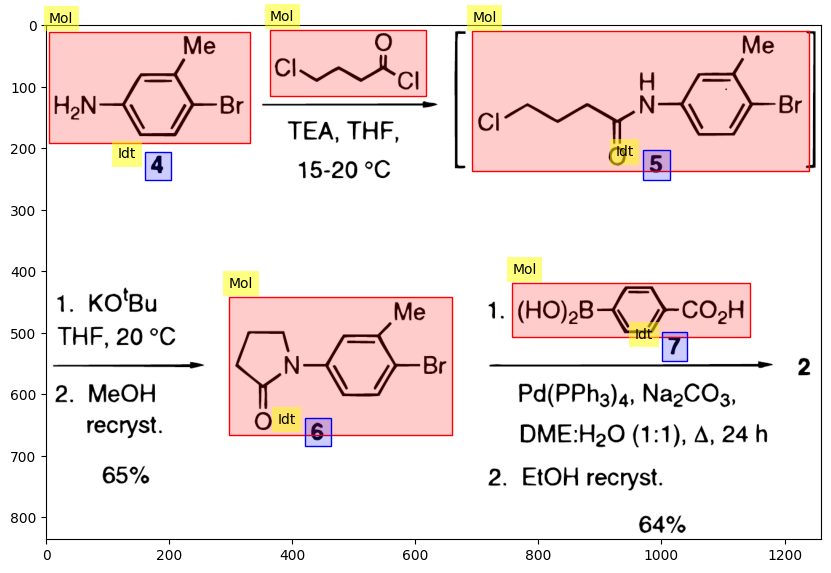

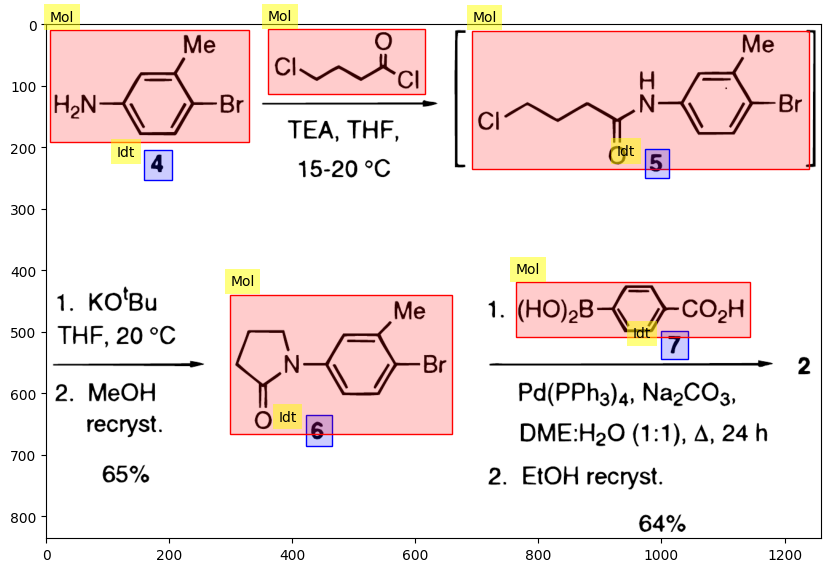

157
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.4432926690618036, 0.096048024012006, 0.6128426429123653], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.03501750875437719, 0.6223147084906089, 0.06753376688344172, 0.697144026558734], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.13206603301650827, 0.4101404395379508, 0.3121560780390195, 0.6213675019327846], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2001000500250125, 0.6156842625858384, 0.23711855927963982, 0.6905135806539633], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.40520260130065033, 0.5806376199463368, 0.64032016008004, 0.8316473577697939], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.40970485242621313, 0.0426242951020965, 0.567783891945973, 0.4811809313747783], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7508754377188595, 0.0037888262312974668, 0.919959979989995, 0.46602562644958845], 

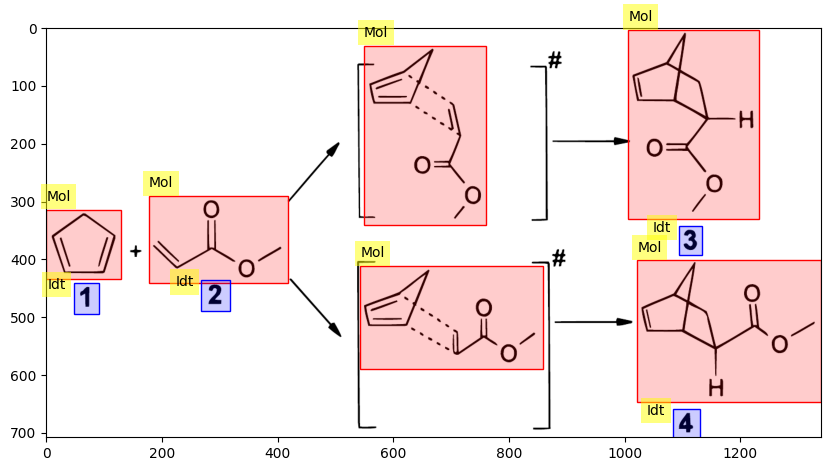

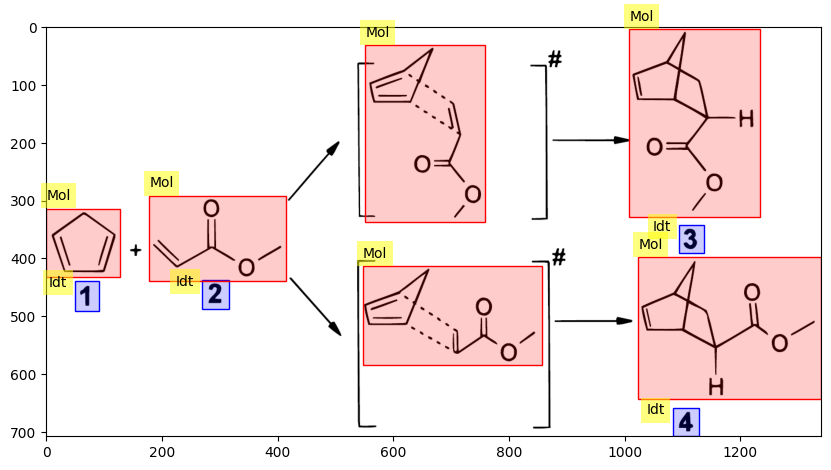

158
the prediction is
[{'category': '[Mol]', 'bbox': [0.01158031982706259, 0.6498249124562281, 0.4342619935148472, 0.822911455727864], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.024125666306380397, 0.23461730865432717, 0.42171664703552936, 0.3711855927963982], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.21327089014840273, 0.3876938469234617, 0.2441517430205696, 0.407703851925963], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.12448843814092286, 0.11905952976488245, 0.3425844615506017, 0.17058529264632316], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.32810906176677346, 0.45872936468234116, 0.6735886032741407, 0.5827913956978489], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.5153242323042853, 0.5992996498249125, 0.5471701118287073, 0.6193096548274137], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.37443034107502376, 0.0, 0.7035044294940525, 0.0860430215107

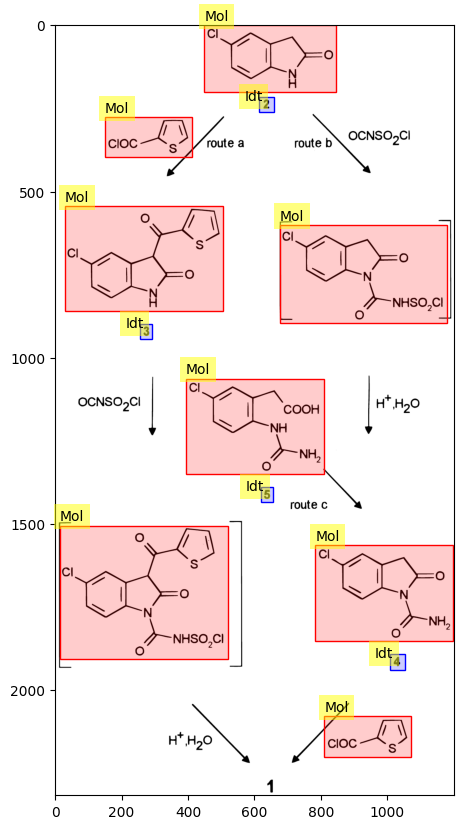

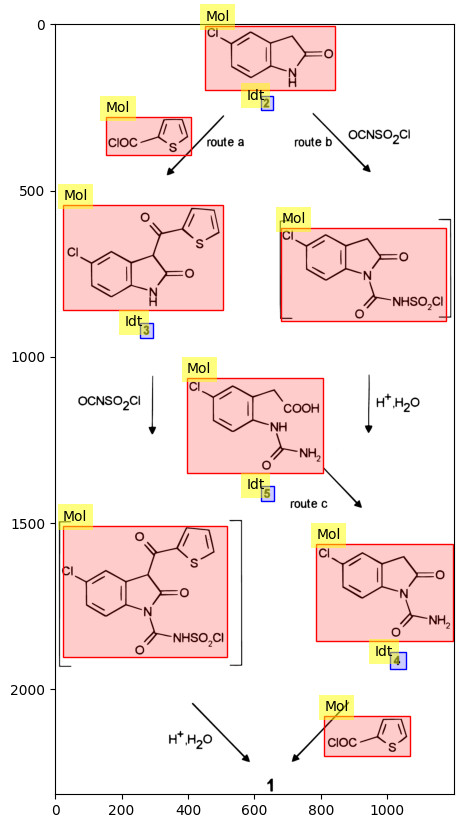

159
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.0, 1.0, 0.8651425599292268], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4102051025512756, 0.8999601957618991, 0.4562281140570285, 0.9930595263579576], 'category_id': 3, 'score': 2010}]
-------
the ground truth annotations are
[{'id': 10587, 'image_id': 1346, 'category_id': 1, 'segmentation': [], 'area': 299619.0, 'bbox': [0.0, 3.0, 729.0, 411.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10588, 'image_id': 1346, 'category_id': 3, 'segmentation': [], 'area': 1000.0, 'bbox': [304.0, 439.0, 25.0, 40.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}]
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precis

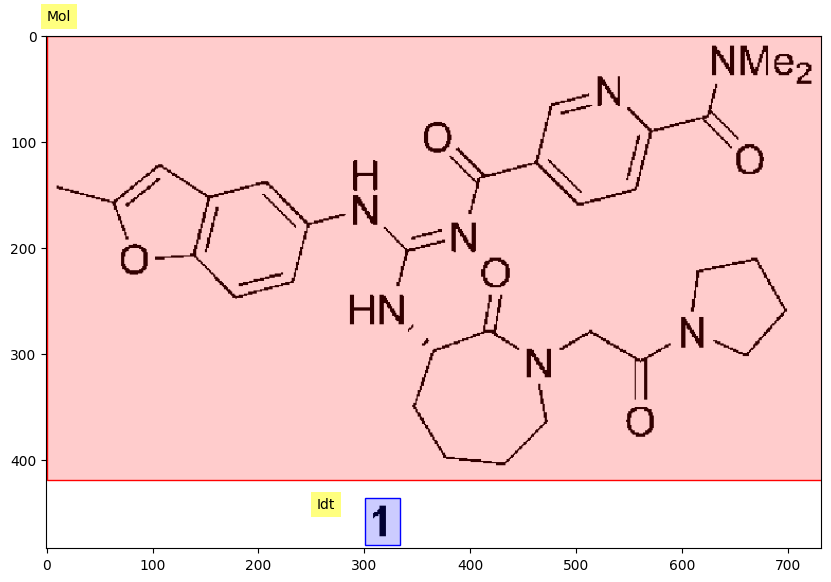

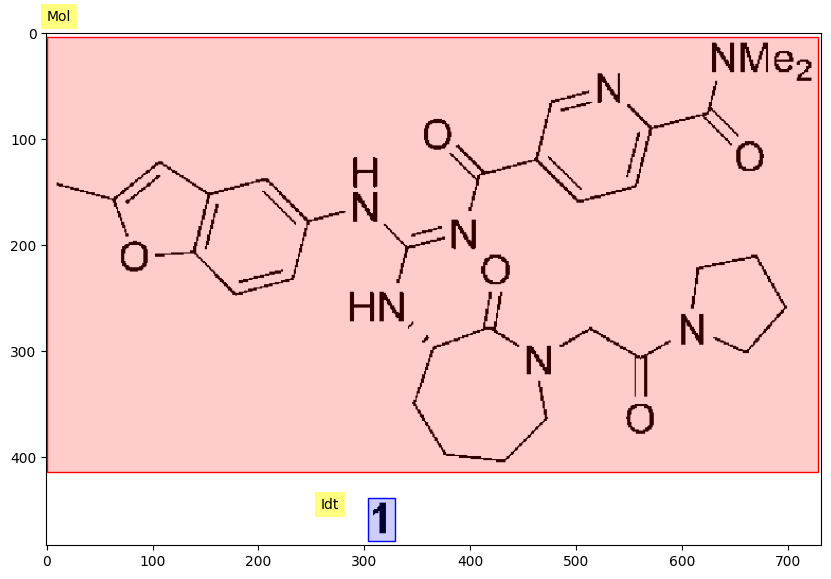

160
the prediction is
[{'category': '[Mol]', 'bbox': [0.0042902885266162495, 0.5697848924462231, 0.3187071476914928, 0.6668334167083542], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.009193475414177678, 0.23411705852926462, 0.3162555542477121, 0.3306653326663332], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.011032170497013213, 0.375687843921961, 0.32606192802283496, 0.5222611305652827], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.49154448547803314, 0.575287643821911, 0.6417045839096019, 0.673336668334167], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.728123252802872, 0.22611305652826413, 0.8770575545125503, 0.32366183091545775], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10589, 'image_id': 1347, 'category_id': 1, 'segmentation': [], 'area': 47328.0, 'bbox': [9.0, 317.0, 348.0, 136.0], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 

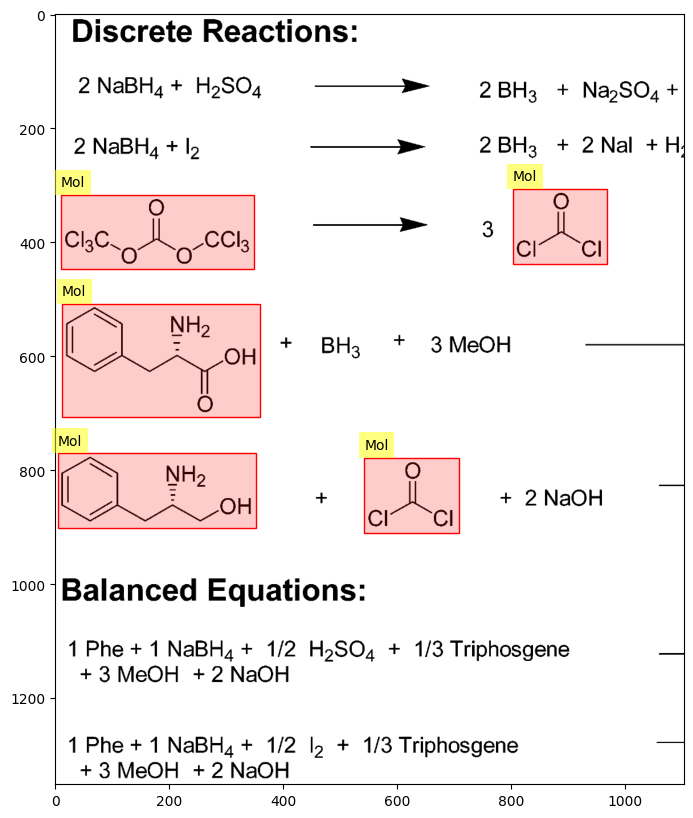

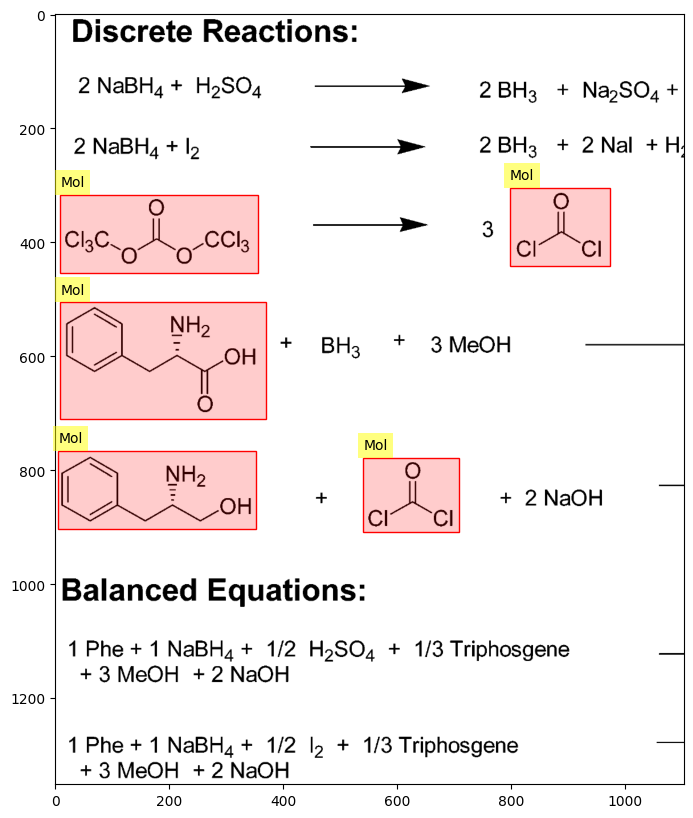

161
the prediction is
[{'category': '[Idt]', 'bbox': [0.0, 0.0, 0.18362079590519897, 0.04102051025512756], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.16770320369050679, 0.4547273636818409, 0.5110684071788665, 0.6128064032016008], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.3086875918777803, 0.6148074037018509, 0.3382488345622086, 0.6443221610805403], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5974781934871954, 0.44922461230615307, 0.9385694552305991, 0.6053026513256629], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7384625816744689, 0.6148074037018509, 0.7668868534864192, 0.6443221610805403], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.6054369895945414, 0.7953976988494247, 0.9482337076466621, 0.9529764882441221], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.752106232144205, 0.9709854927463731, 0.7816674748286334, 1.0], 'category_id': 3, 'score': 2010

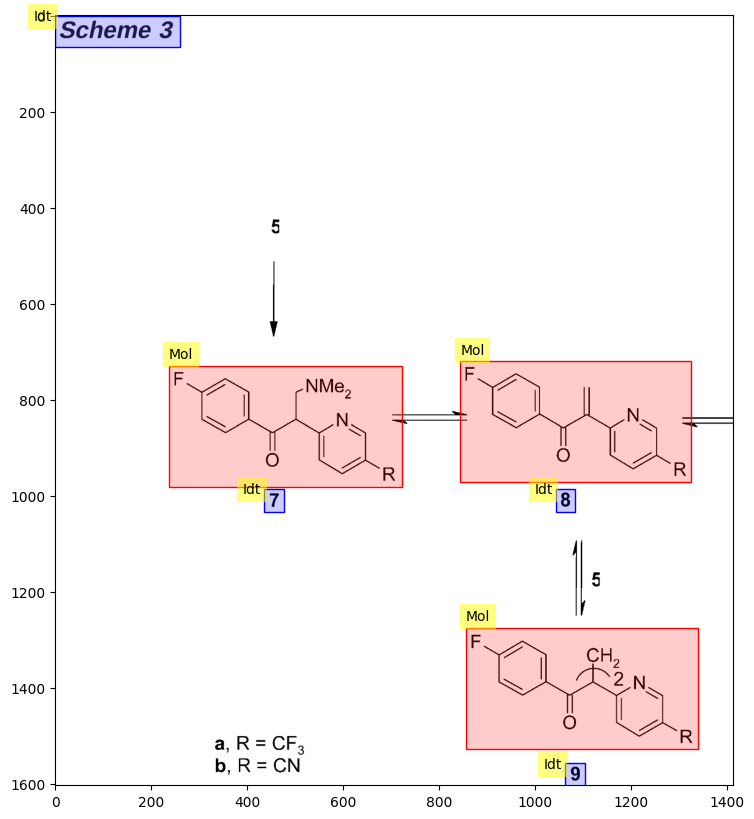

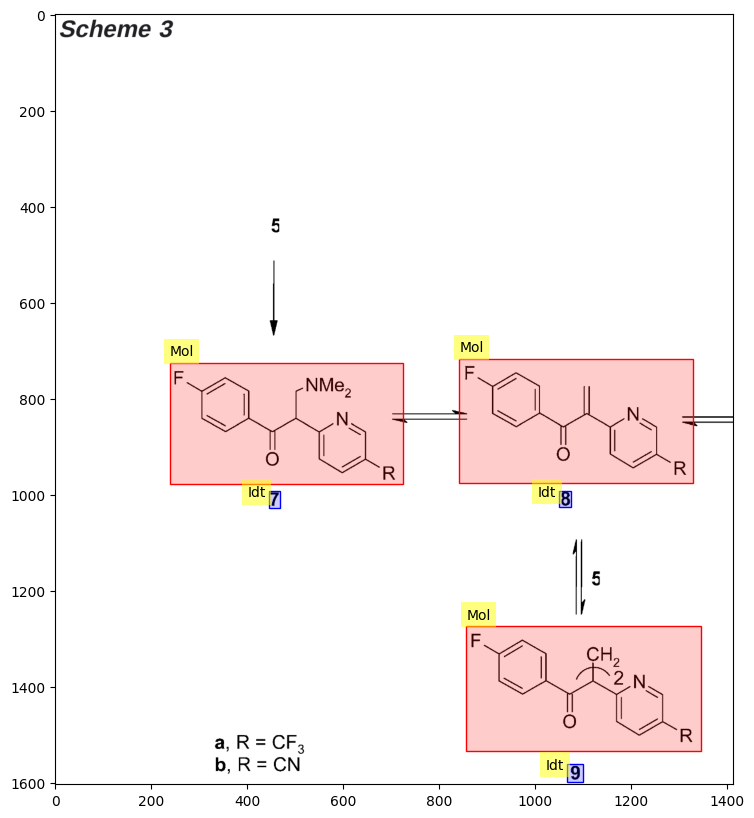

162
the prediction is
[{'category': '[Mol]', 'bbox': [0.07803901950975488, 0.06286992027698547, 0.23711855927963982, 0.26384753427718494], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.08054027013506754, 0.4277215887696553, 0.23761880940470234, 0.625607239477544], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6558279139569785, 0.06286992027698547, 0.8134067033516759, 0.2607555709848742], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6738369184592297, 0.42669093433888505, 0.8149074537268635, 0.6194233128929225], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10600, 'image_id': 1349, 'category_id': 1, 'segmentation': [], 'area': 30056.340000000004, 'bbox': [101.2, 279.4, 223.8, 134.3], 'iscrowd': 0, 'attributes': {'occluded': False, 'rotation': 0.0}}, {'id': 10601, 'image_id': 1349, 'category_id': 1, 'segmentation': [], 'area': 25090.660000000003, 'bbox': [912.7, 278.2, 193.9, 129.4], 'iscr

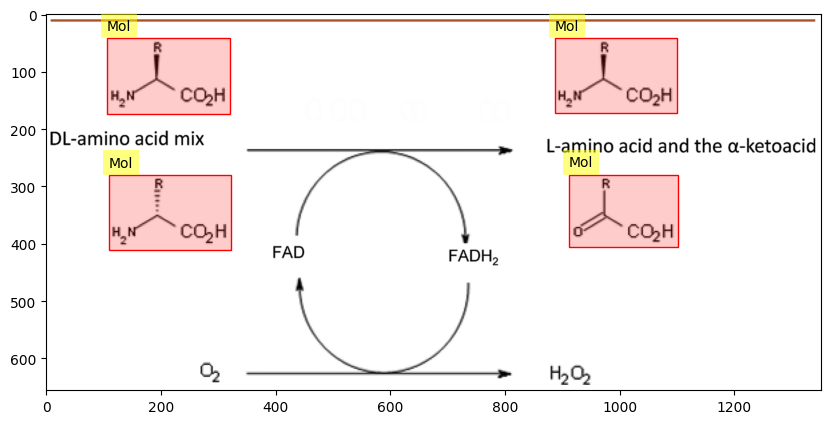

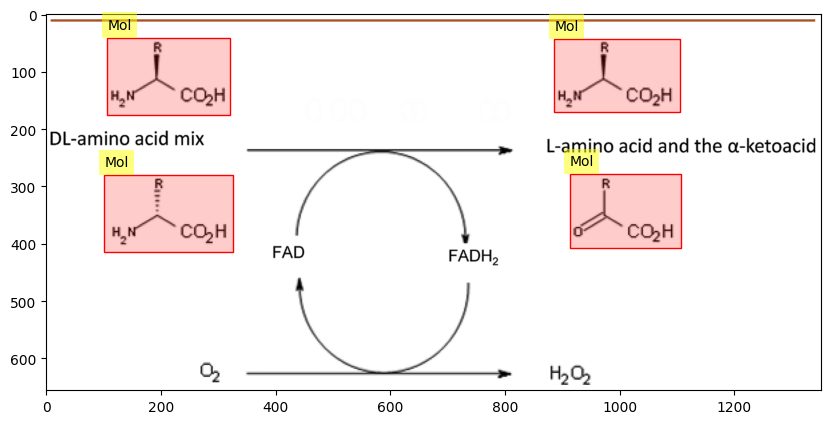

163
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.004576307761723999, 0.41720860430215106, 0.36937341219629416], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.2016008004002001, 0.3844098519848159, 0.23961980990495246, 0.4393255451255039], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.028514257128564282, 0.4608995674307742, 0.4197098549274637, 0.9296442338816467], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.19559779889944973, 0.9414118824117941, 0.23261630815407705, 0.9982888503075066], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5447723861930965, 0.0026150330066994276, 0.9744872436218109, 0.3661046209379199], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.7338669334667334, 0.3785260277197422, 0.7908954477238619, 0.4360567538671296], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5737868934467234, 0.5583095469303279, 0.97098549274637

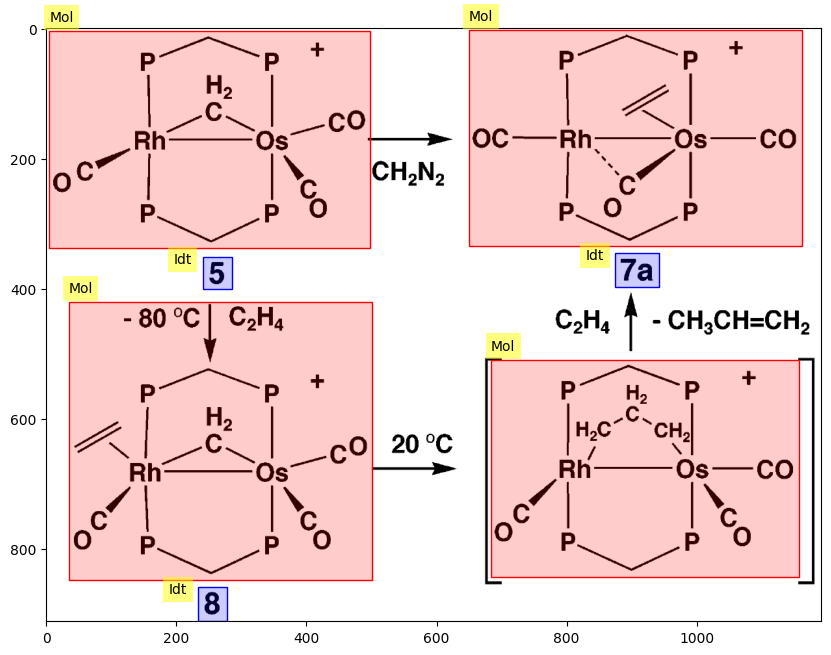

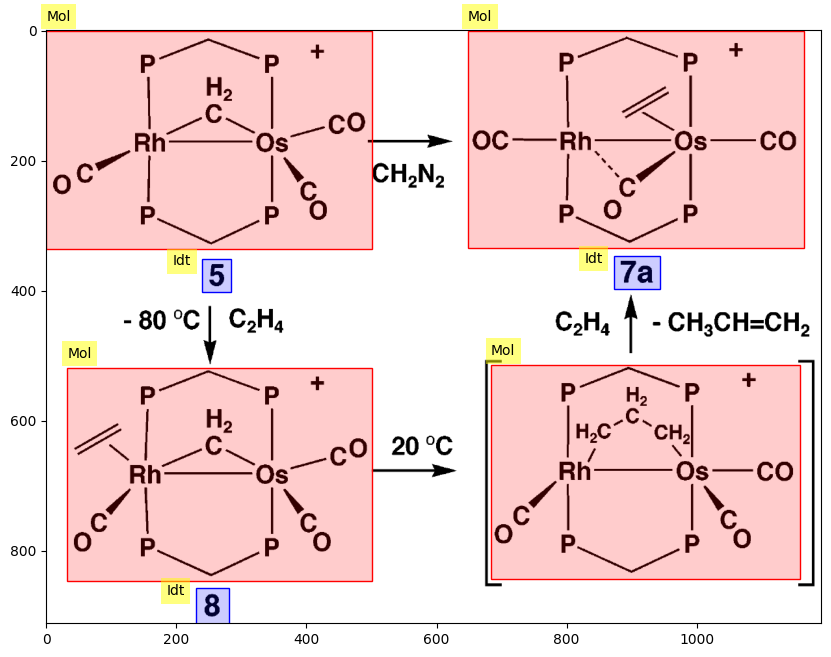

164
the prediction is
[{'category': '[Mol]', 'bbox': [0.003501750875437719, 0.5687040844837135, 0.17258629314657328, 0.7471210521648783], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.04852426213106553, 0.7419172239408445, 0.08554277138569284, 0.7939555061811842], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.004502251125562781, 0.20517951283333977, 0.1745872936468234, 0.3888003087385387], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.05152576288144072, 0.37541903616245137, 0.0830415207603802, 0.4244837022747717], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10955477738869435, 0.40961562163467463, 0.33166583291645824, 0.5568096199716358], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.23261630815407705, 0.5783683368997765, 0.4897448724362181, 0.8943150505018397], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.36668334167083544, 0.8995188787258735, 0.4092046023011

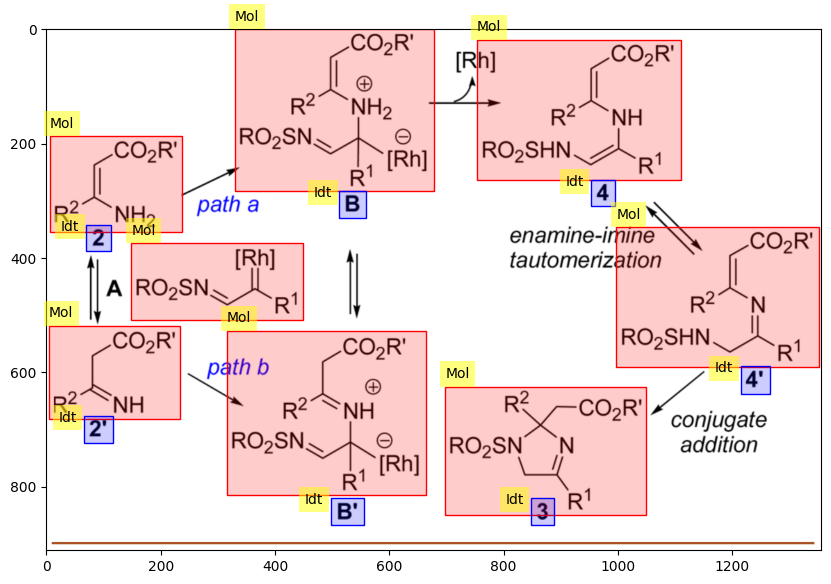

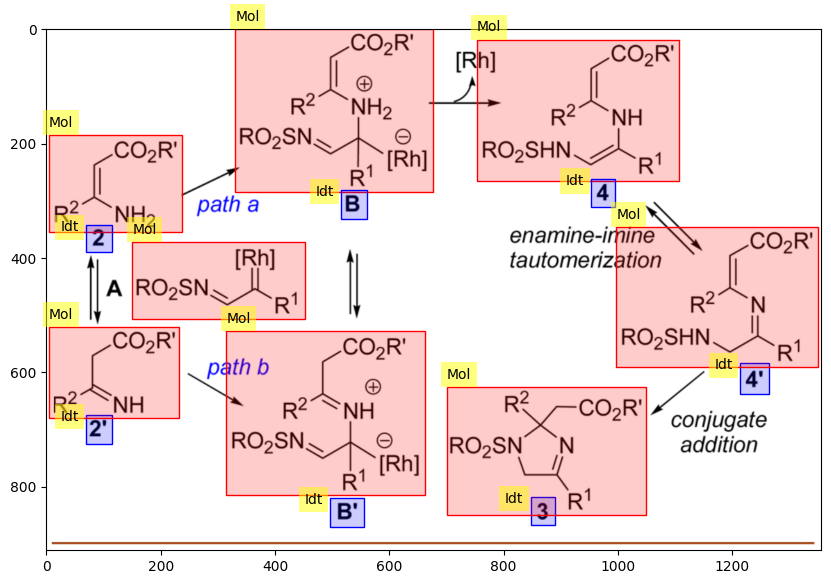

165
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.4004917289775578, 0.23711855927963982, 0.6198319424029195], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.03651825912956478, 0.0, 0.24412206103051526, 0.22717379247626748], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.2576288144072036, 0.419096479223459, 0.400200100050025, 0.49743226973251675], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.34067033516758377, 0.7774827208023982, 0.5787893946973487, 0.9948645394650335], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.41270635317658827, 0.20269385794218694, 0.5637818909454727, 0.4318260451811809], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.46773386693346675, 0.5033074540206961, 0.5432716358179089, 0.666833416708354], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.5622811405702851, 0.39657493945210487, 0.7108554277138569, 0.5042866514020593], 'category_id

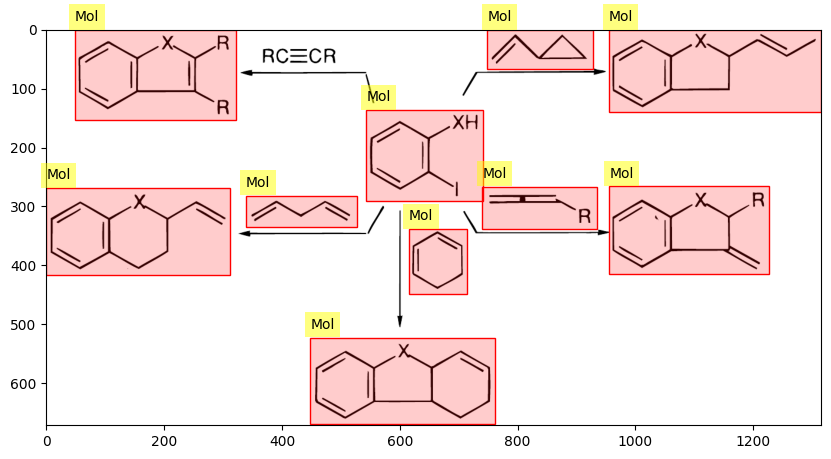

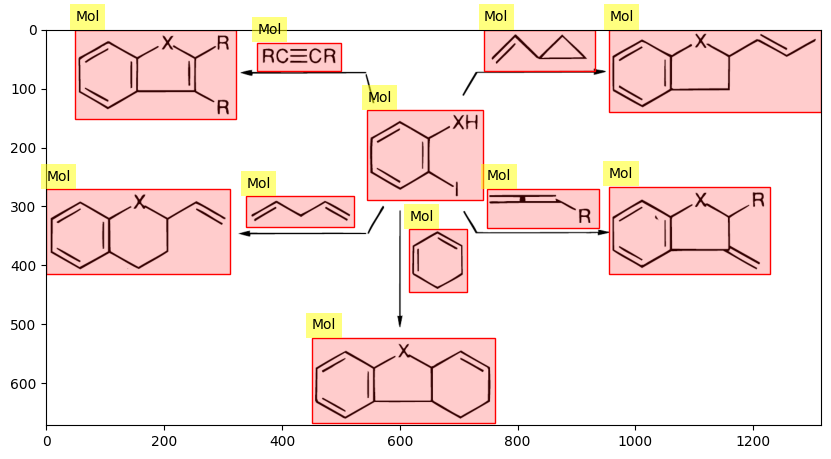

166
the prediction is
[{'category': '[Mol]', 'bbox': [0.0080040020010005, 0.0023590804836380454, 0.2681340670335168, 0.47417517721124713], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1295647823911956, 0.4553025333421427, 0.1615807903951976, 0.5079886641433924], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.06803401700850426, 0.5189977064003699, 0.36068034017008505, 0.8948778634600318], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1265632816408204, 0.8838688212030542, 0.17108554277138568, 0.938914032487942], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.3856928464232116, 0.0023590804836380454, 0.6298149074537268, 0.46237977479305686], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.4957478739369685, 0.4560888935033554, 0.5387693846923461, 0.5072023039821797], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.5057528764382191, 0.6416698915495483, 0.7063531765882941, 

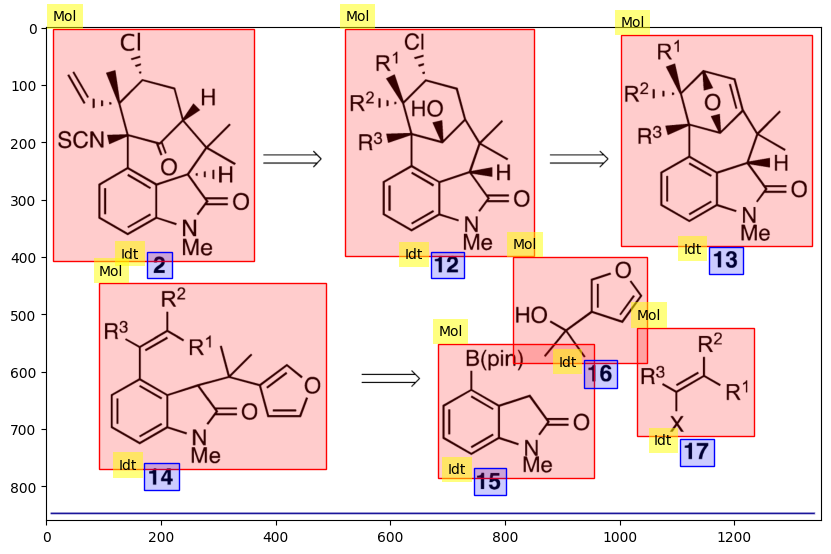

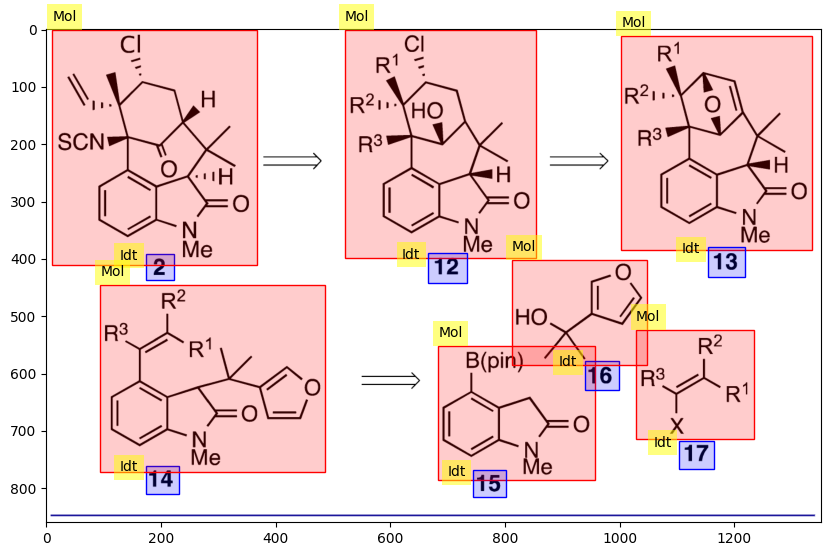

167
the prediction is
[{'category': '[Mol]', 'bbox': [0.0, 0.22755219417618414, 0.28564282141070535, 0.4626392292191294], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.06603301650825413, 0.03013936346704426, 0.26263131565782893, 0.18987798984237883], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3021510755377689, 0.6035407534275613, 0.5737868934467234, 0.9486364651252179], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.3806903451725863, 0.0, 0.6418209104552276, 0.4769554268659754], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.6988494247123562, 0.1047342880479788, 0.9964982491245623, 0.48222981547270816], 'category_id': 1, 'score': 2011}, {'category': '[Mol]', 'bbox': [0.7123561780890445, 0.6035407534275613, 0.9864932466233116, 0.9433620765184852], 'category_id': 1, 'score': 2011}]
-------
the ground truth annotations are
[{'id': 10651, 'image_id': 1354, 'category_id': 1, 'segmentation': [], 'area': 8085

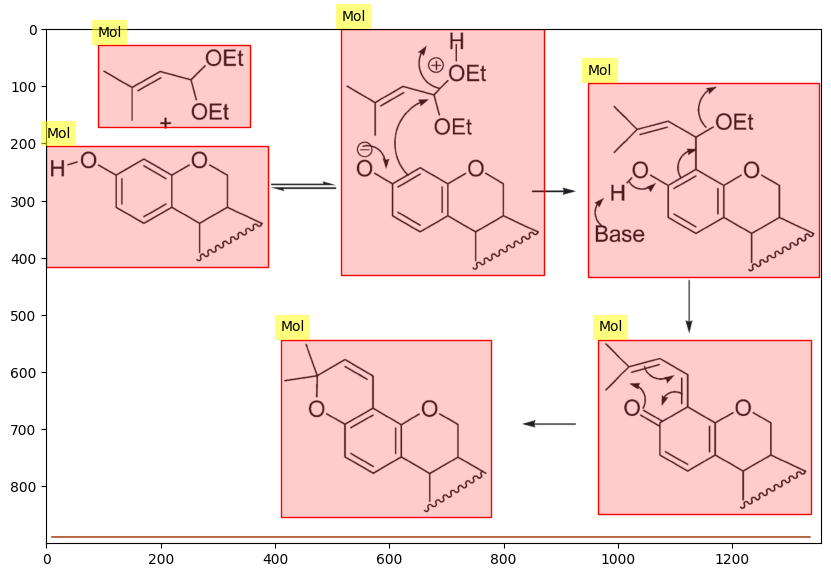

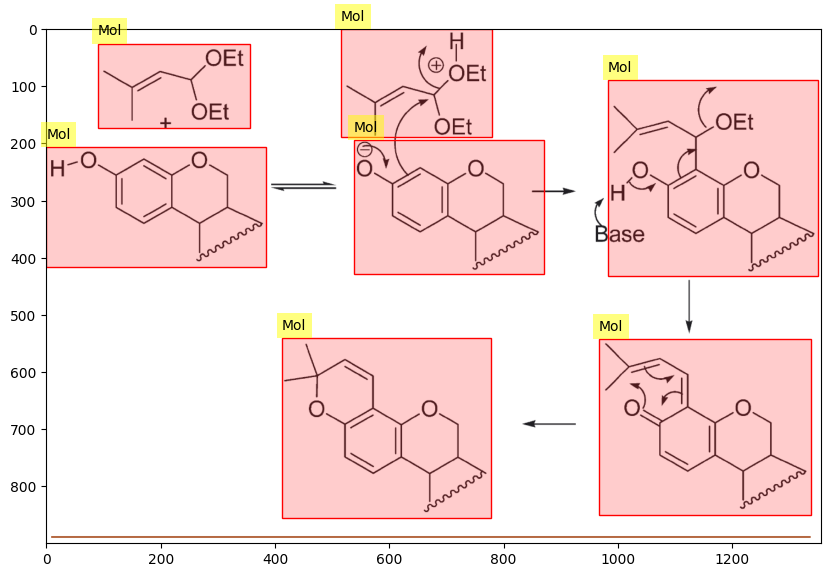

168
the prediction is
[{'category': '[Mol]', 'bbox': [0.024971570389910627, 0.7538769384692346, 0.3440527475943242, 0.9589794897448725], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.07861420307934827, 0.9709854927463731, 0.2913349878822907, 1.0], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.030520808254335213, 0.35767883941970985, 0.33017965293326274, 0.5612806403201601], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.0, 0.5777888944472236, 0.35792584225538565, 0.639319659829915], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.10636039240147119, 0.01250625312656328, 0.32648016102364635, 0.17658829414707353], 'category_id': 1, 'score': 2011}, {'category': '[Idt]', 'bbox': [0.1646273899779293, 0.21310655327663833, 0.22381926053179155, 0.24062031015507754], 'category_id': 3, 'score': 2010}, {'category': '[Mol]', 'bbox': [0.664983670753546, 0.753376688344172, 0.9692668803194939, 0.9579789894947474], 'catego

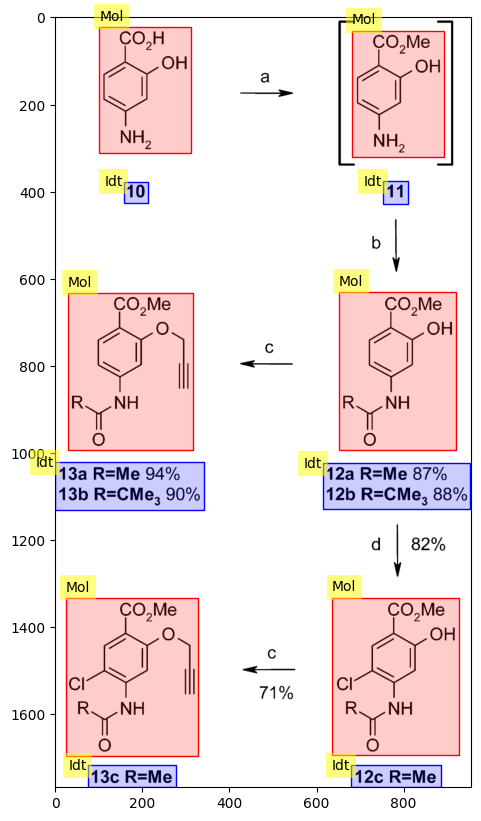

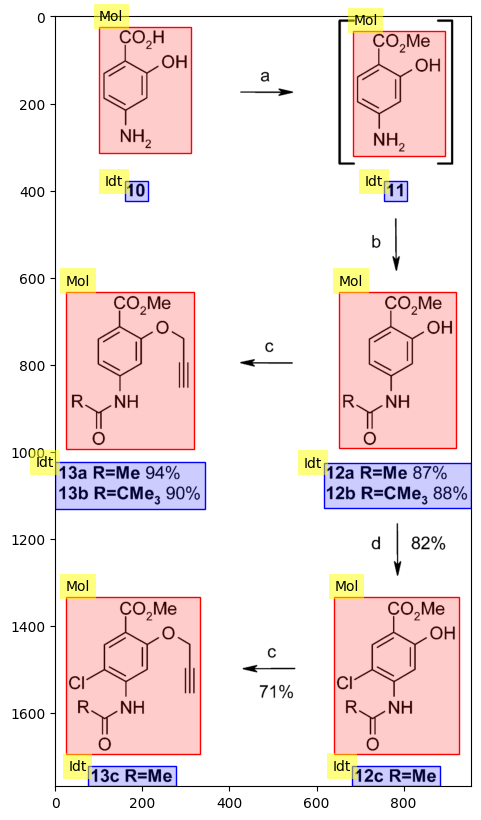

169
150.43524936140236


In [24]:
ap = 0
hits = 0 
goldpred = 0 
preds = 0
for i in range(170):
    ap = evaluate_single_image(i, ap)
    '''
    h, g, p = evaluate_single_image(i, ap)
    hits += h
    goldpred += g
    preds += p
    '''
print(ap)

In [ ]:
print(hits, goldpred, preds)

In [41]:
print(ap)

(0, 0, 0)


-------
[{'image_id': 1648, 'category_id': 3, 'bbox': [4.6643321660830415, 152.7048524262131, 37.98099049524762, 50.01250625312658], 'score': -0.09153727442026138}, {'image_id': 1648, 'category_id': 1, 'bbox': [193.23661830915458, 0.0, 384.4742371185592, 310.7443721860931], 'score': -0.0804392471909523}, {'image_id': 1648, 'category_id': 2, 'bbox': [1287.3556778389195, 148.703851925963, 44.64432216108048, 54.01350675337672], 'score': -0.5128538608551025}, {'image_id': 1648, 'category_id': 1, 'bbox': [764.9504752376188, 0.0, 348.4922461230615, 360.0900450225113], 'score': -0.08164539188146591}, {'image_id': 1648, 'category_id': 2, 'bbox': [323.83791895947974, 318.07953976988495, 95.2856428214107, 46.01150575287645], 'score': -0.43915754556655884}, {'image_id': 1648, 'category_id': 1, 'bbox': [0.0, 0.0, 0.6663331665832916, 364.0910455227614], 'score': -0.3735106289386749}, {'image_id': 1648, 'category_id': 1, 'bbox': [0.0, 0.0, 0.6663331665832916, 146.70335167583795], 'score': -0.3556986

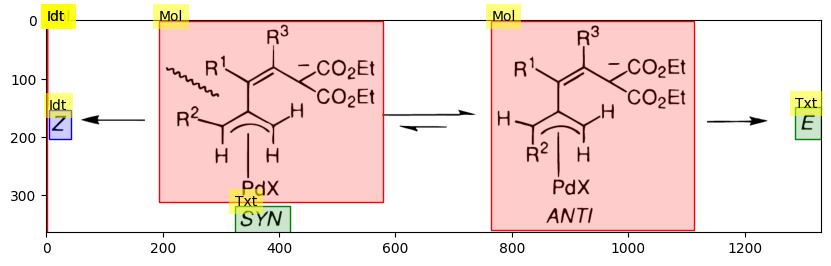

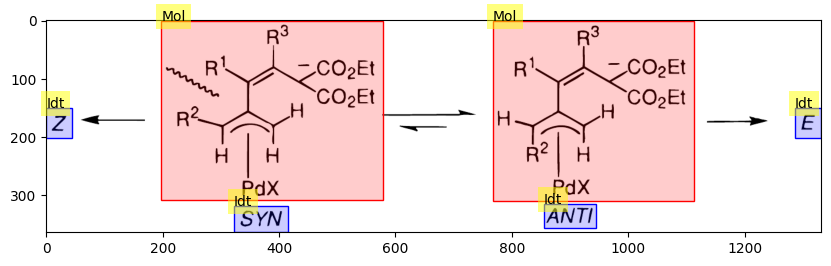

141
-------
[{'image_id': 34, 'category_id': 2, 'bbox': [583.3016508254127, 603.6409945760682, 294.68534267133566, 84.98186068892129], 'score': -0.0853874608874321}, {'image_id': 34, 'category_id': 1, 'bbox': [317.6128064032016, 533.4972365471174, 234.66933466733371, 62.724706698965726], 'score': -0.08135563880205154}, {'image_id': 34, 'category_id': 2, 'bbox': [193.53476738369184, 341.95082039113584, 433.59879939969994, 39.118634285376494], 'score': -0.082189179956913}, {'image_id': 34, 'category_id': 1, 'bbox': [930.5852926463232, 505.844408862627, 314.9154577288644, 100.49442256070863], 'score': -0.08126002550125122}, {'image_id': 34, 'category_id': 2, 'bbox': [353.3526763381691, 649.5042209796131, 160.4922461230615, 39.11863428537636], 'score': -0.08350781351327896}, {'image_id': 34, 'category_id': 2, 'bbox': [1107.935967983992, 57.32903300443107, 59.34167083541769, 46.537685615361696], 'score': -0.09074056148529053}, {'image_id': 34, 'category_id': 2, 'bbox': [193.53476738369184, 

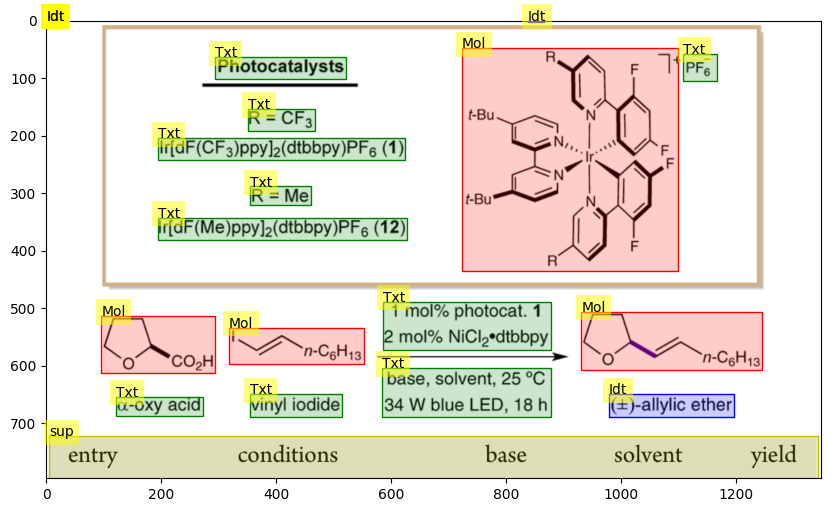

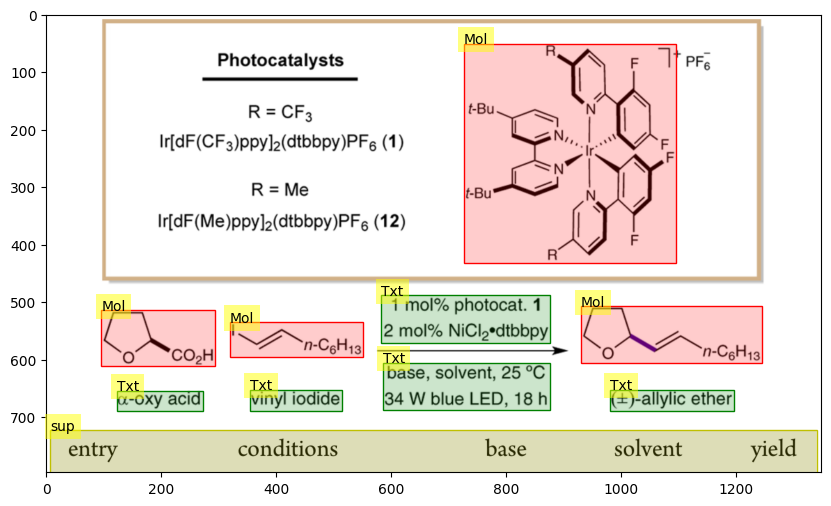

0


0.7356105610561057

In [87]:
evaluate_single_image(141, 0)
evaluate_single_image(0,0)

-------
[{'image_id': 1514, 'category_id': 1, 'bbox': [1623.0195097548774, 696.1370407425935, 280.9804902451225, 234.26773190516838], 'score': -0.08159825950860977}, {'image_id': 1514, 'category_id': 1, 'bbox': [0.0, 1277.997139092422, 283.83791895947974, 284.74004812863967], 'score': -0.0819796472787857}, {'image_id': 1514, 'category_id': 2, 'bbox': [797.2226113056528, 385.6846805755819, 173.3506753376689, 109.51540312639973], 'score': -0.08009732514619827}, {'image_id': 1514, 'category_id': 2, 'bbox': [1530.6293146573287, 1556.0710322481502, 109.53476738369169, 59.9953947562015], 'score': -0.08366845548152924}, {'image_id': 1514, 'category_id': 1, 'bbox': [1042.9614807403702, 1502.7417924648598, 280.0280140070035, 242.83850258462581], 'score': -0.08111581951379776}, {'image_id': 1514, 'category_id': 1, 'bbox': [1623.0195097548774, 1289.4248333316987, 266.6933466733366, 219.03080625279947], 'score': -0.08133509010076523}, {'image_id': 1514, 'category_id': 2, 'bbox': [1250.601300650325

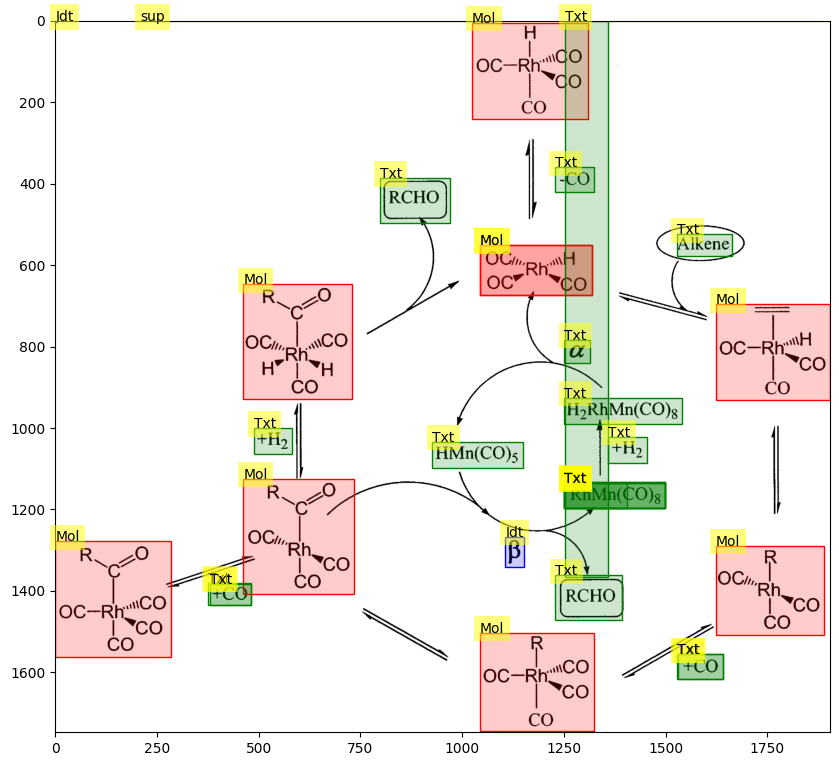

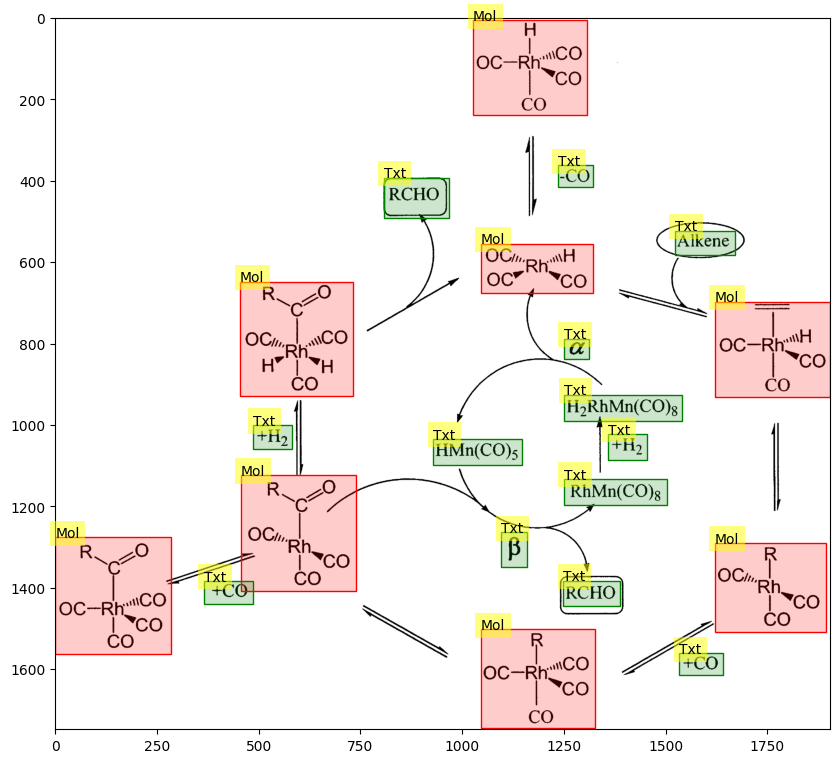

129


0.8806380638063808

In [73]:
evaluate_single_image(129, 0)